### Install python libraries

In [5]:
!pip install obspy numpy pandas matplotlib scikit-learn tensorflow

   ---------------------------------------- 0.0/14.1 MB ? eta -:--:--
   ------ --------------------------------- 2.4/14.1 MB 15.0 MB/s eta 0:00:01
   -------------------- ------------------- 7.3/14.1 MB 21.6 MB/s eta 0:00:01
   -------------------------------- ------- 11.5/14.1 MB 20.1 MB/s eta 0:00:01
   ---------------------------------------- 14.1/14.1 MB 18.9 MB/s eta 0:00:00
   ---------------------------------------- 0.0/376.0 MB ? eta -:--:--
    --------------------------------------- 7.6/376.0 MB 39.3 MB/s eta 0:00:10
   - -------------------------------------- 16.0/376.0 MB 38.7 MB/s eta 0:00:10
   -- ------------------------------------- 24.1/376.0 MB 39.2 MB/s eta 0:00:09
   --- ------------------------------------ 32.5/376.0 MB 38.9 MB/s eta 0:00:09
   ---- ----------------------------------- 41.2/376.0 MB 39.7 MB/s eta 0:00:09
   ----- ---------------------------------- 50.1/376.0 MB 39.8 MB/s eta 0:00:09
   ------ --------------------------------- 59.2/376.0 MB 40.6 MB/

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
aext-project-filebrowser-server 4.1.0 requires anaconda-cloud-auth>=0.7.1, which is not installed.
aext-toolbox 4.1.0 requires anaconda-cloud-auth>=0.7.1, which is not installed.
aext-project-filebrowser-server 4.1.0 requires sqlalchemy>=2.0.29, but you have sqlalchemy 1.4.54 which is incompatible.


In [103]:
import os
import numpy as np
import matplotlib.pyplot as plt

#### Connect to the Raspberry Shake FDSN web Service and Download waveform data for one station to test

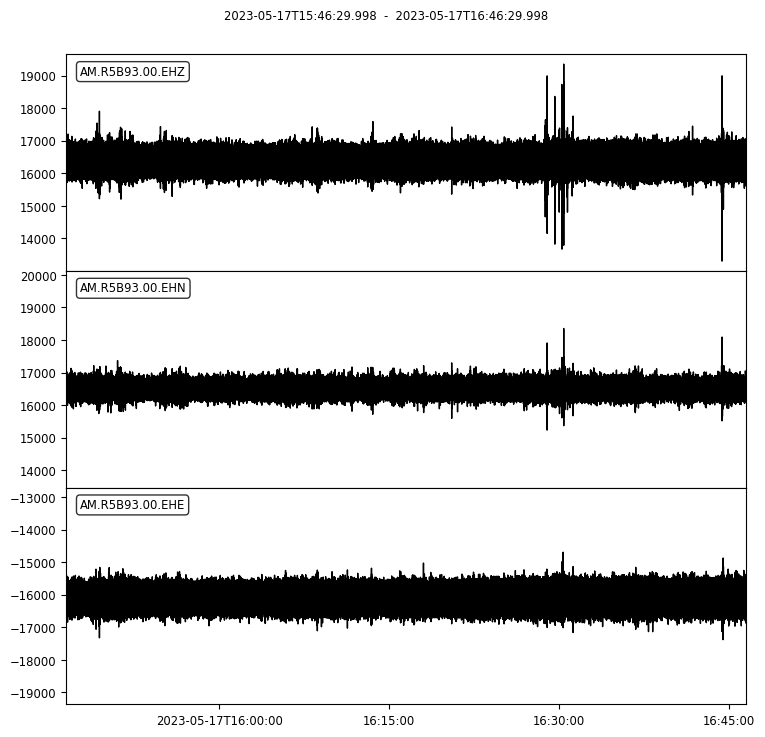

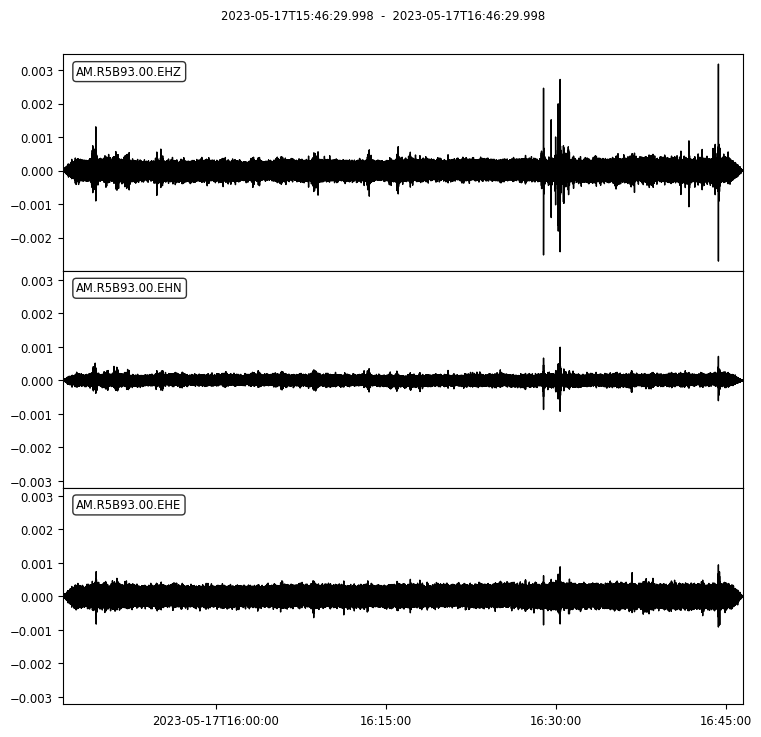

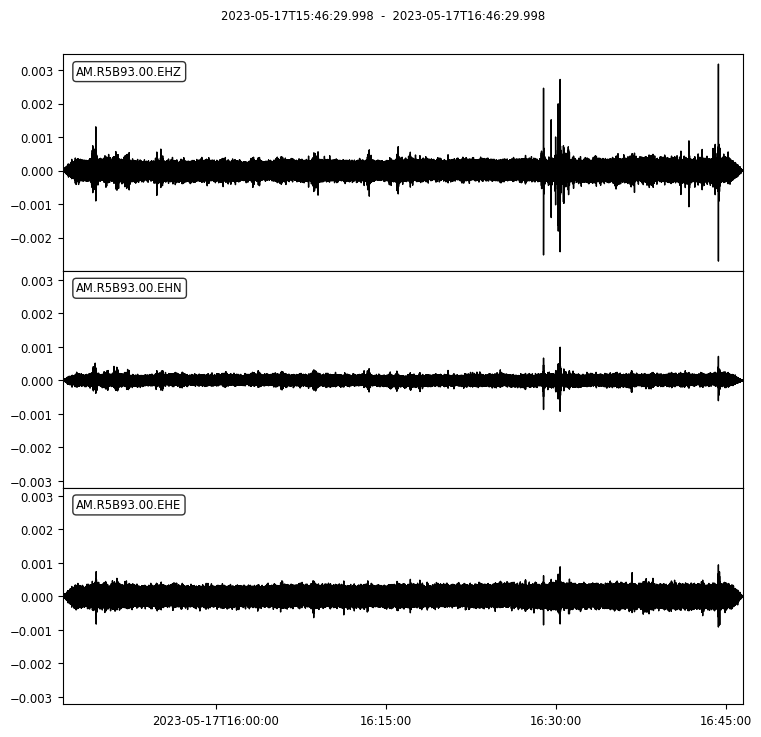

In [30]:
from obspy.clients.fdsn import Client
from obspy.core import UTCDateTime, Stream

# Connect to Raspberry Shake server
rs = Client('RASPISHAKE')

# Set Raspberry Shake station
stn = 'R5B93'

# down the response info
inv = rs.get_stations(network='AM', station=stn, level='RESP')

# Choose date start time and end time
start = UTCDateTime(2023, 5, 17, 15, 46, 30)  # Start time
end = UTCDateTime(2023, 5, 17, 16, 46, 30)    # 1 hour later

# Set FDSN server location and channel names (3-component 3D stations)
channels = ['EHZ', 'EHE', 'EHN']

# Download waveforms and put into a single Stream 
stream = Stream()
for ch in channels:
    trace = rs.get_waveforms('AM', stn, '00', ch, start, end)
    stream += trace


# Plot raw data counts for all channels
stream.plot()

# Attach response info to stream (for unit conversion)
stream.attach_response(inv)

# Remove the reponse, plot and convert raw counts to acceleration (m/s/s)
resp_removed = stream.remove_response(output='ACC', inventory=inv)

# Plot converted waveform (in real-world units) # All channels in acceleration units (m/s/s)
resp_removed.plot()

In [32]:
trace

1 Trace(s) in Stream:
AM.R5B93.00.EHN | 2023-05-17T15:46:29.998000Z - 2023-05-17T16:46:29.998000Z | 100.0 Hz, 360001 samples

In [36]:
3600 * 100

360000

In [38]:
inv

Inventory created at 2025-06-13T14:41:10.518165Z
	Sending institution: SeisComP (RS)
	Contains:
		Networks (1):
			AM
		Stations (1):
			AM.R5B93 (Raspberry Shake Citizen Science Station)
		Channels (3):
			AM.R5B93.00.EHZ, AM.R5B93.00.EHN, AM.R5B93.00.EHE

Waveforms were accessed using the Raspberry Shake FDSN web services through the ObsPy client (Beyreuther et al., 2010; Raspberry Shake, 2023).

#### Connecting to all 20 Rasberry stations

###### Function to download waveform for a station and duration

In [749]:
def download_station_data(station_code, start_time, duration_days=2, channels=['EHZ', 'EHE', 'EHN']):
    rs = Client('RASPISHAKE')
    end_time = start_time + duration_days * 24 * 60 * 60

    # Get response info
    inv = rs.get_stations(network='AM', station=station_code, level='RESP')

    # Download waveform data
    stream = Stream()
    for ch in channels:
        trace = rs.get_waveforms('AM', station_code, '00', ch, start_time, end_time)
        stream += trace

    # Plot raw waveform
    print("Raw waveform (in counts):")
    stream.plot()

    # Convert to acceleration
    stream.attach_response(inv)
    stream_acc = stream.remove_response(output='ACC', inventory=inv)

    print("Converted waveform (acceleration):")
    stream_acc.plot()

    # Save full converted waveform
    full_fname = f"{station_code}_full_2days.mseed"
    stream_acc.write(full_fname, format="MSEED")
    print(f"Full converted waveform saved: {full_fname}")

    # raw and converted
    return stream, stream_acc 

In [797]:
def trim_and_save_waveform(stream_acc, station_code, eq_time):
    # Trim 10 minutes around the earthquake time
    trim_start = eq_time - 300
    trim_end = eq_time + 300
    eq_stream = stream_acc.copy().trim(starttime=trim_start, endtime=trim_end)

    # Format time for filename
    time_str = eq_time.strftime("%Y%m%dT%H%M%S")

    # Save trimmed waveform
    trimmed_fname = f"{station_code}_EQ_{time_str}_10min.mseed"
    eq_stream.write(trimmed_fname, format="MSEED")
    print(f"Trimmed 10-minute waveform saved: {trimmed_fname}")

    # Plot trimmed waveform
    eq_stream.plot(title=f"{station_code} EQ at {eq_time}", size=(800, 600))

    # Show trace summary
    print(f"\nTrace Summary for Station {station_code} (10-minute trimmed window)")
    for tr in eq_stream:
        print(f"Channel: {tr.stats.channel}")
        print(f"  Sample Rate: {tr.stats.sampling_rate} Hz")
        print(f"  Number of Samples: {tr.stats.npts}")
        print(f"  Start Time: {tr.stats.starttime}")
        print(f"  End Time:   {tr.stats.endtime}")
        print("-" * 40)

    return eq_stream

##### Station 1

Raw waveform (in counts):


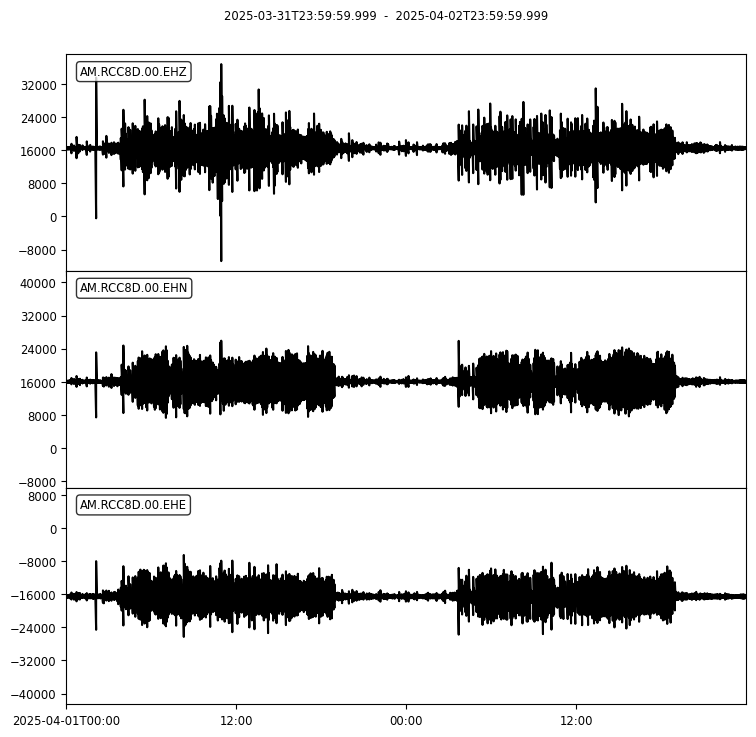

Converted waveform (acceleration):


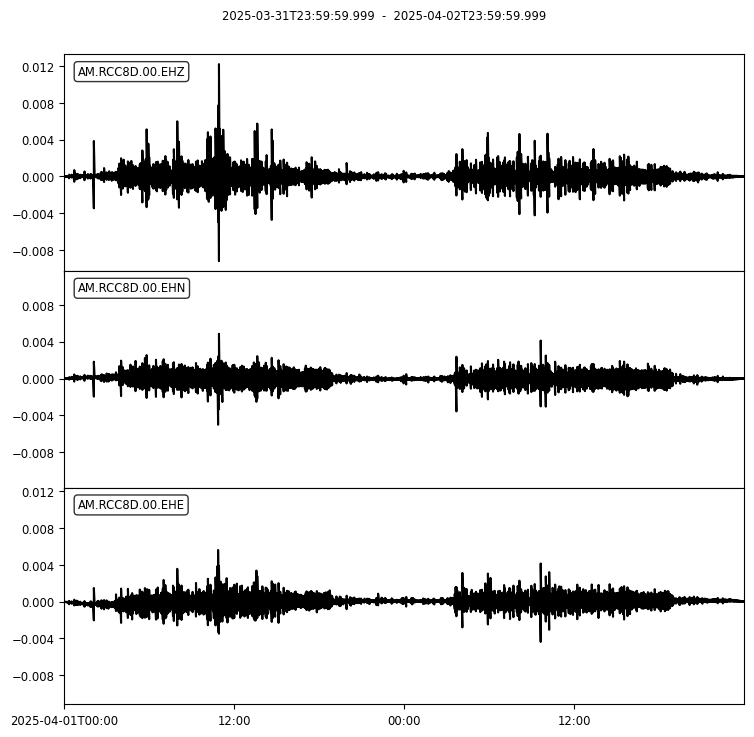

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: RCC8D_full_2days.mseed
Trimmed 10-minute waveform saved: RCC8D_EQ_trimmed_10min.mseed


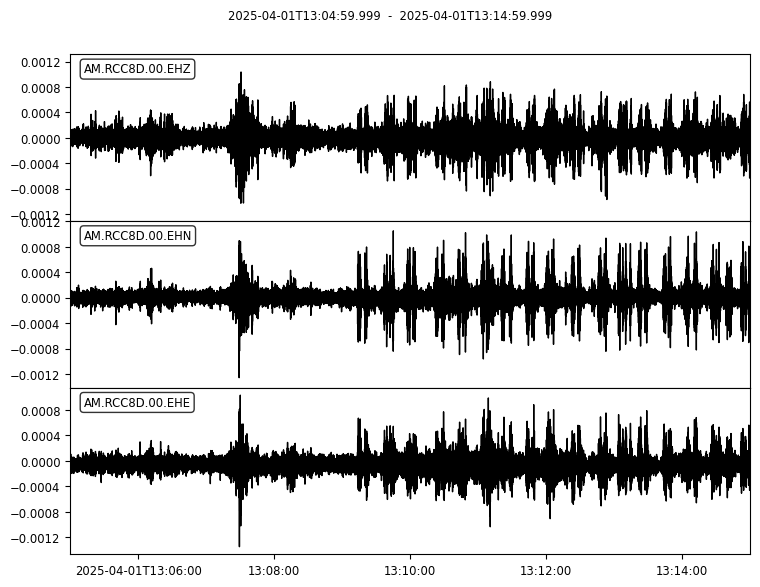


Trace Summary for Station RCC8D (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2025-04-01T13:04:59.999000Z
  End Time:   2025-04-01T13:14:59.999000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2025-04-01T13:04:59.999000Z
  End Time:   2025-04-01T13:14:59.999000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2025-04-01T13:04:59.999000Z
  End Time:   2025-04-01T13:14:59.999000Z
----------------------------------------


In [769]:
# Download 2-day data
start = UTCDateTime(2025, 4, 1, 0, 0, 0)
stream_raw, stream_acc = download_station_data("RCC8D", start, channels=['EHZ', 'EHE', 'EHN'])

# Set the earthquake time
eq_time = UTCDateTime(2025, 4, 1, 13, 10, 0)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "RCC8D", eq_time)

##### Station 2

Raw waveform (in counts):


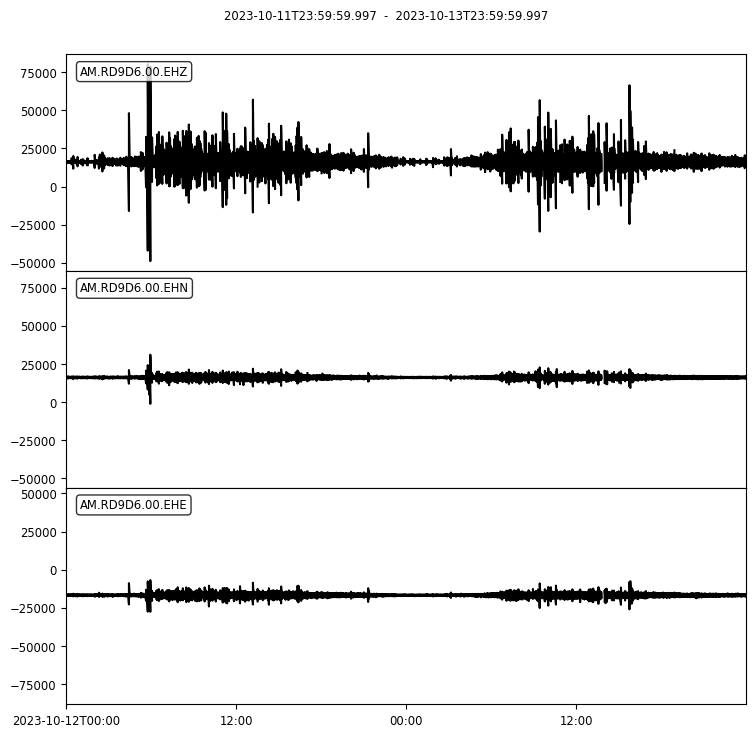

Converted waveform (acceleration):


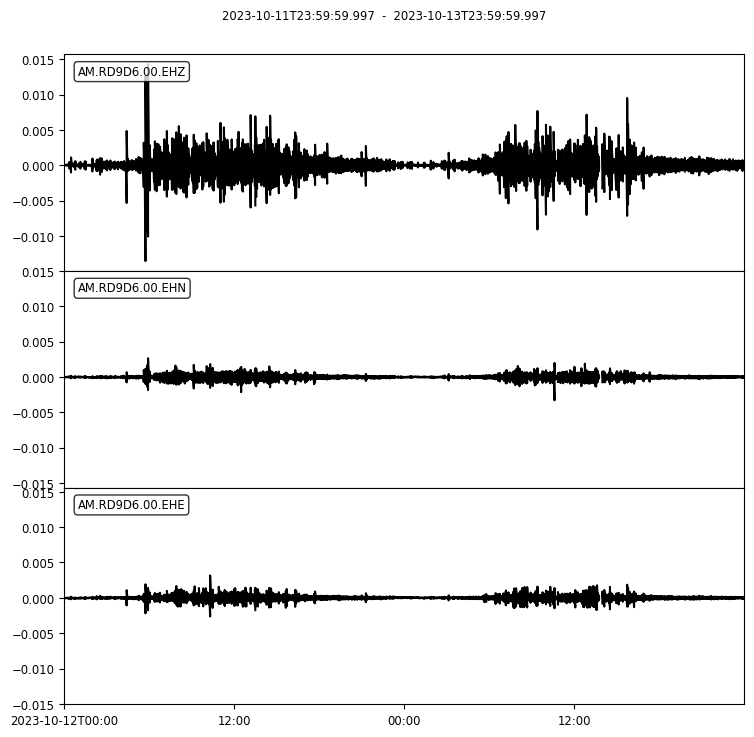

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: RD9D6_full_2days.mseed
Trimmed 10-minute waveform saved: RD9D6_EQ_trimmed_10min.mseed


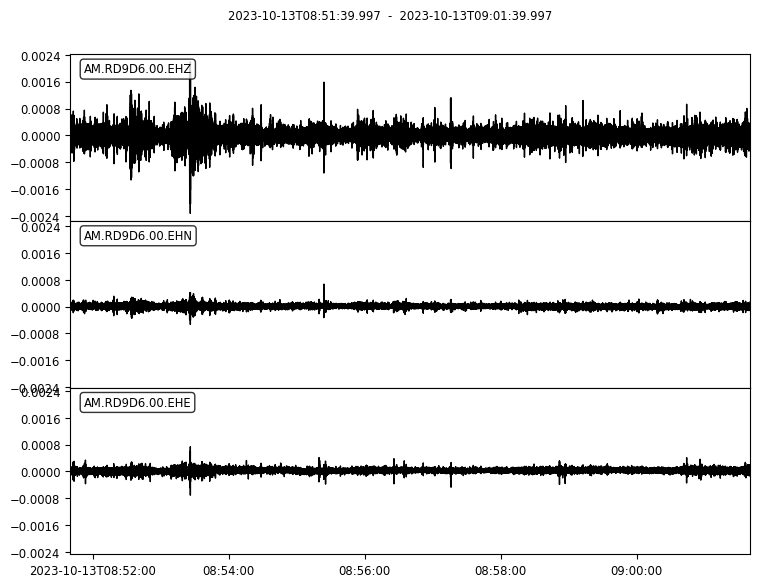


Trace Summary for Station RD9D6 (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-10-13T08:51:39.997000Z
  End Time:   2023-10-13T09:01:39.997000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-10-13T08:51:39.997000Z
  End Time:   2023-10-13T09:01:39.997000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-10-13T08:51:39.997000Z
  End Time:   2023-10-13T09:01:39.997000Z
----------------------------------------


In [773]:
# Download 2-day data
start = UTCDateTime(2023, 10, 12, 0, 0, 0)
stream_raw, stream_acc = download_station_data("RD9D6", start, channels=['EHZ', 'EHE', 'EHN'])

# Set the earthquake time
eq_time = UTCDateTime(2023, 10, 13, 8, 56, 40)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "RD9D6", eq_time)

##### Station 3

#### Earthquake distance 29.6km, Mag 4.3

Raw waveform (in counts):


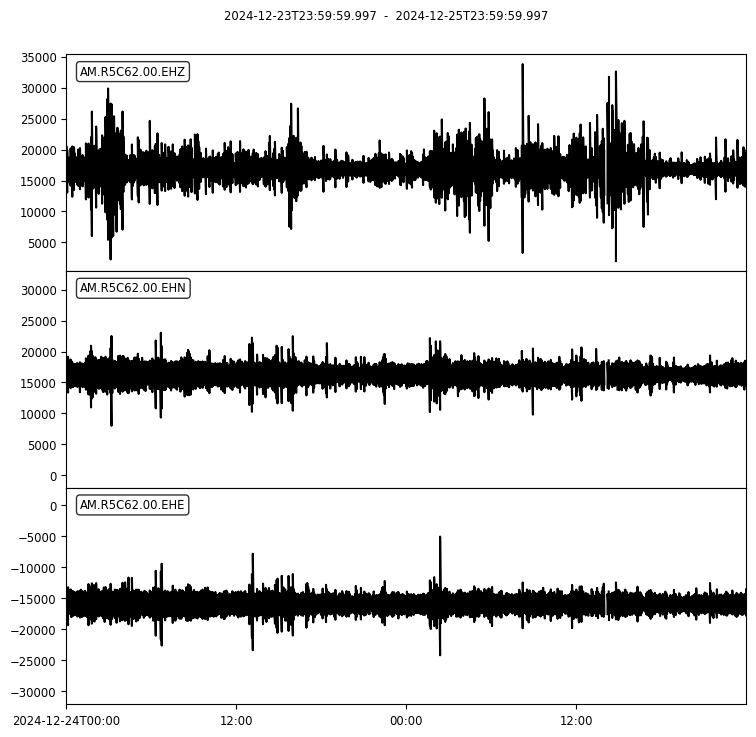

Converted waveform (acceleration):


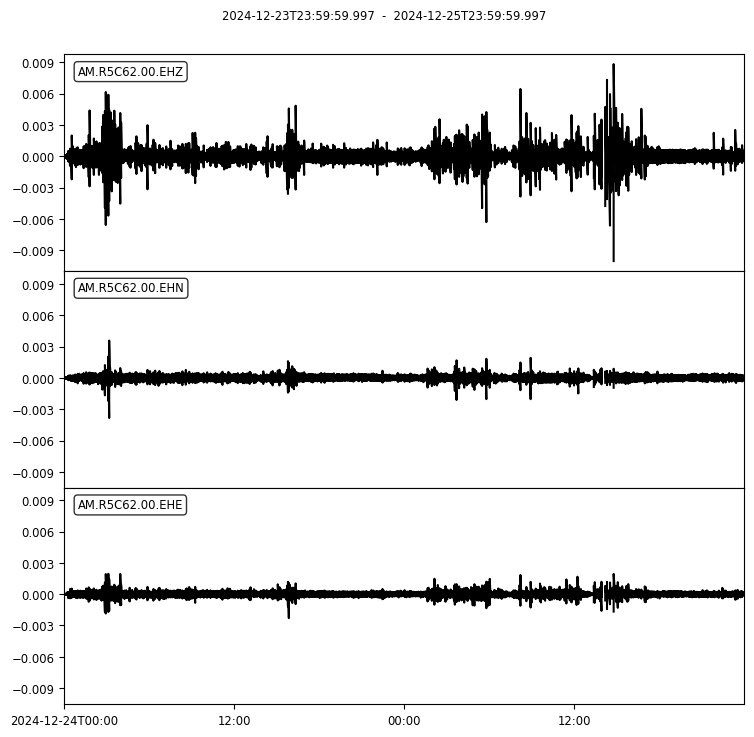

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R5C62_full_2days.mseed
Trimmed 10-minute waveform saved: R5C62_EQ_trimmed_10min.mseed


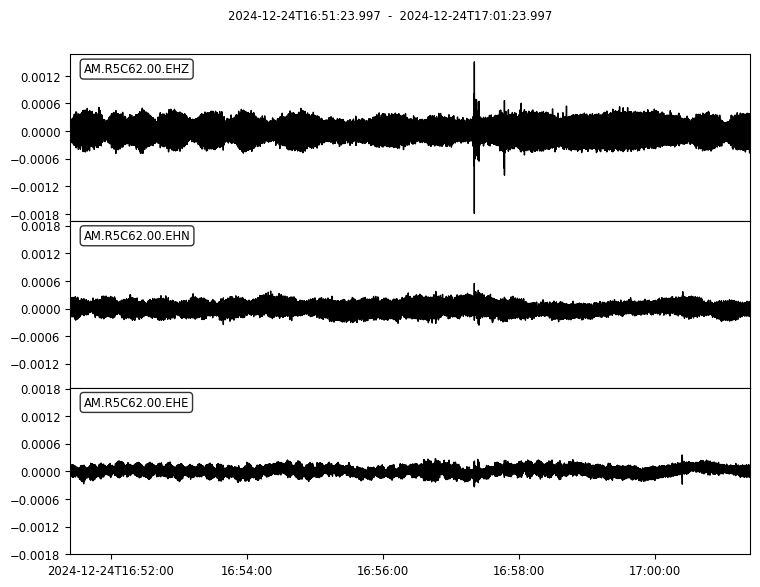


Trace Summary for Station R5C62 (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-12-24T16:51:23.997000Z
  End Time:   2024-12-24T17:01:23.997000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-12-24T16:51:23.997000Z
  End Time:   2024-12-24T17:01:23.997000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-12-24T16:51:23.997000Z
  End Time:   2024-12-24T17:01:23.997000Z
----------------------------------------


In [776]:
# Download 2-day data
start = UTCDateTime(2024, 12, 24, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R5C62", start, channels=['EHZ', 'EHE', 'EHN'])

# Set the earthquake time
eq_time = UTCDateTime(2024, 12, 24, 16, 56, 24)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R5C62", eq_time)

##### Station 4

Raw waveform (in counts):


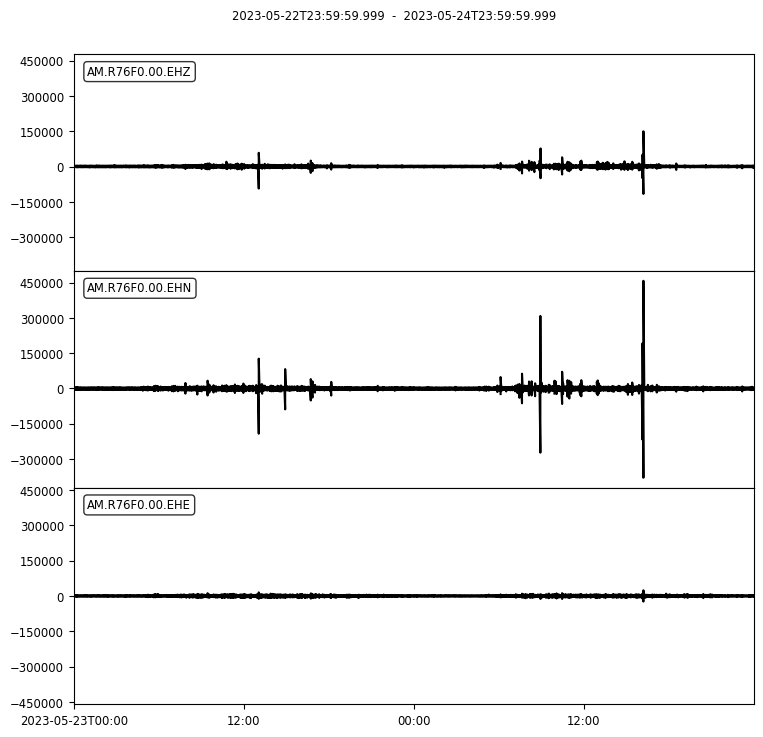

Converted waveform (acceleration):


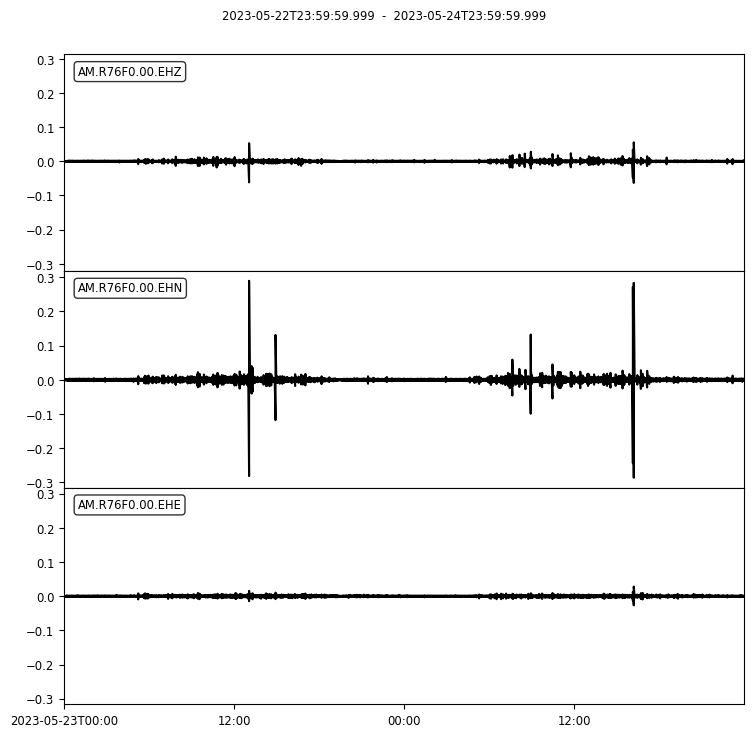

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R76F0_full_2days.mseed
Trimmed 10-minute waveform saved: R76F0_EQ_trimmed_10min.mseed


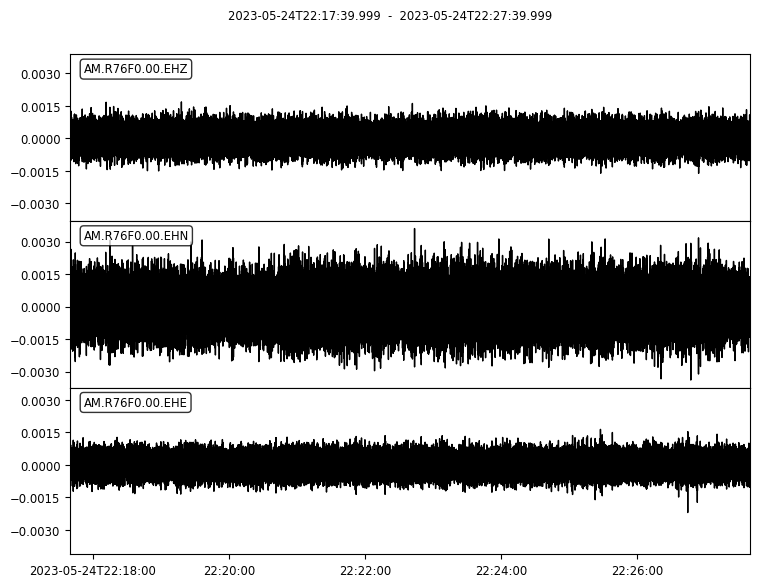


Trace Summary for Station R76F0 (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-05-24T22:17:39.999000Z
  End Time:   2023-05-24T22:27:39.999000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-05-24T22:17:39.999000Z
  End Time:   2023-05-24T22:27:39.999000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-05-24T22:17:39.999000Z
  End Time:   2023-05-24T22:27:39.999000Z
----------------------------------------


In [781]:
# Download 2-day data
start = UTCDateTime(2023, 5, 23, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R76F0", start, channels=['EHZ', 'EHE', 'EHN'])

# Set the earthquake time
eq_time = UTCDateTime(2023, 5, 24, 22, 22, 40)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R76F0", eq_time)

##### Station 5

Raw waveform (in counts):


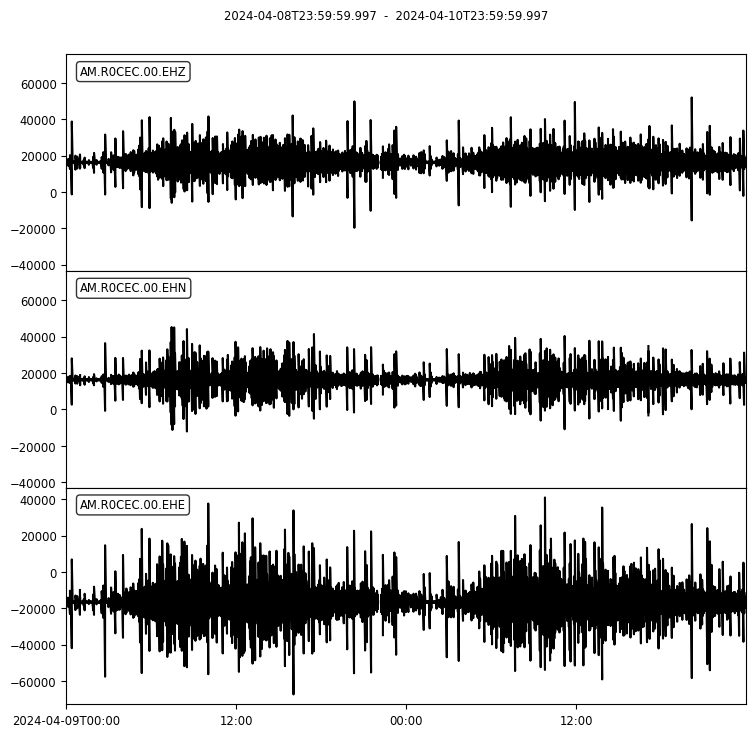

Converted waveform (acceleration):


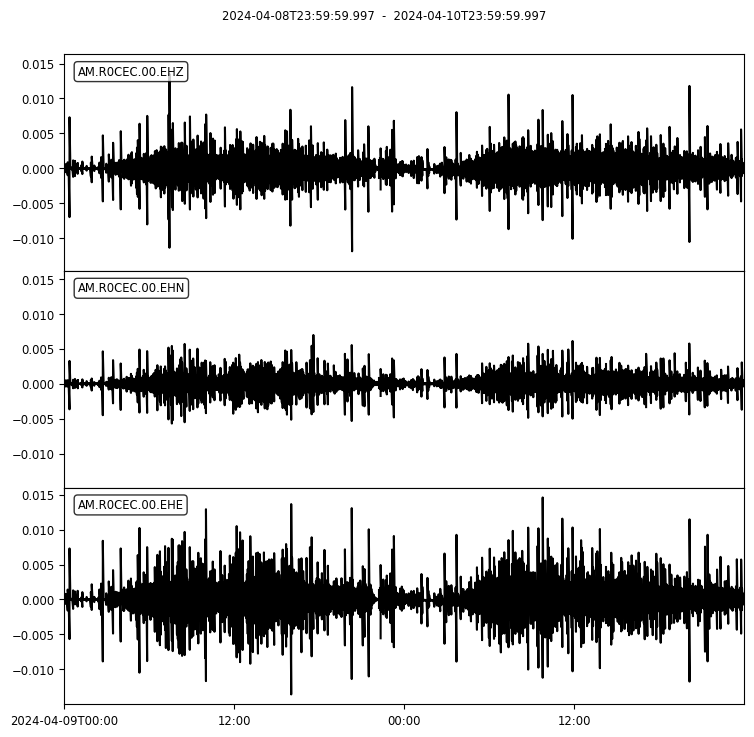

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R0CEC_full_2days.mseed
Trimmed 10-minute waveform saved: R0CEC_EQ_trimmed_10min.mseed


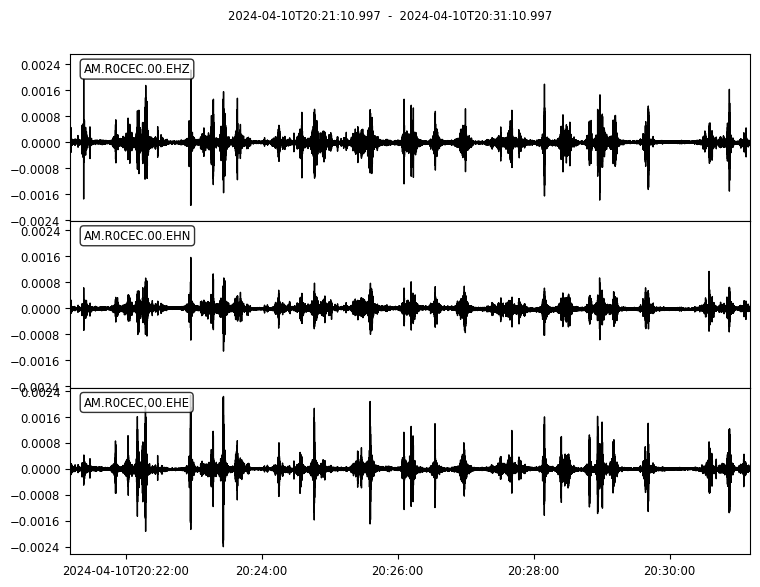


Trace Summary for Station R0CEC (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-04-10T20:21:10.997000Z
  End Time:   2024-04-10T20:31:10.997000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-04-10T20:21:10.997000Z
  End Time:   2024-04-10T20:31:10.997000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-04-10T20:21:10.997000Z
  End Time:   2024-04-10T20:31:10.997000Z
----------------------------------------


In [784]:
# Download 2-day data
start = UTCDateTime(2024, 4, 9, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R0CEC", start, channels=['EHZ', 'EHE', 'EHN'])

# Set the earthquake time
eq_time = UTCDateTime(2024, 4, 10, 20, 26, 11)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R0CEC", eq_time)

##### Station 6

Raw waveform (in counts):


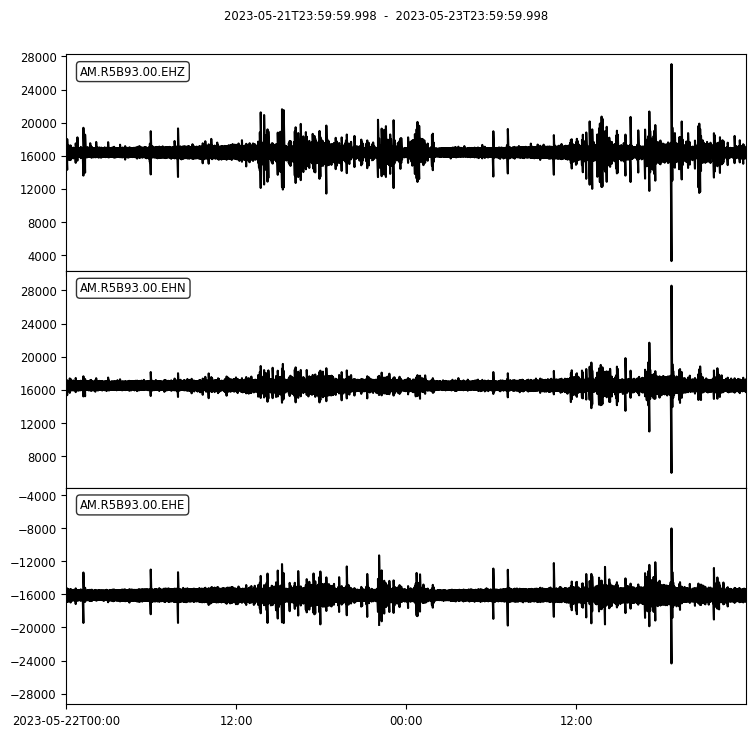

Converted waveform (acceleration):


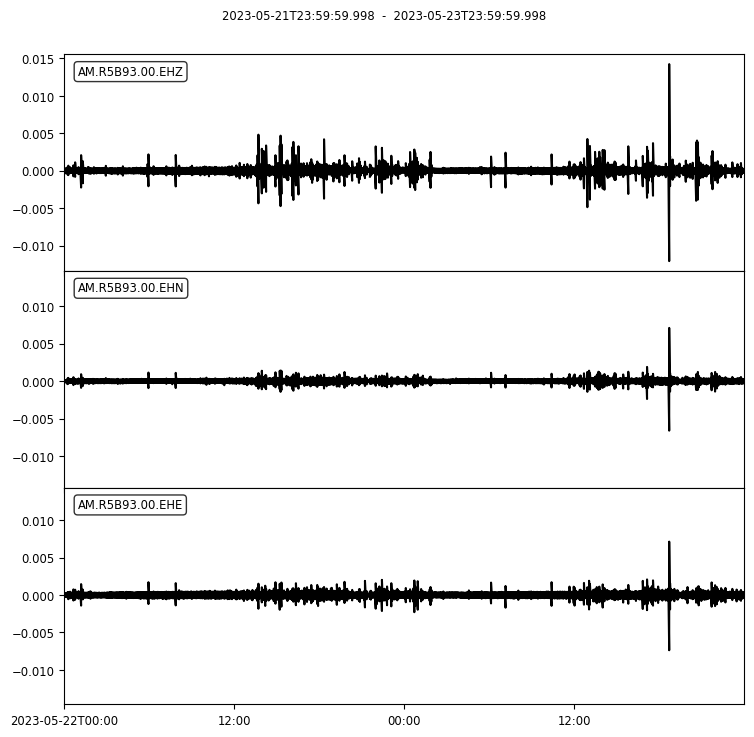

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R5B93_full_2days.mseed
Trimmed 10-minute waveform saved: R5B93_EQ_trimmed_10min.mseed


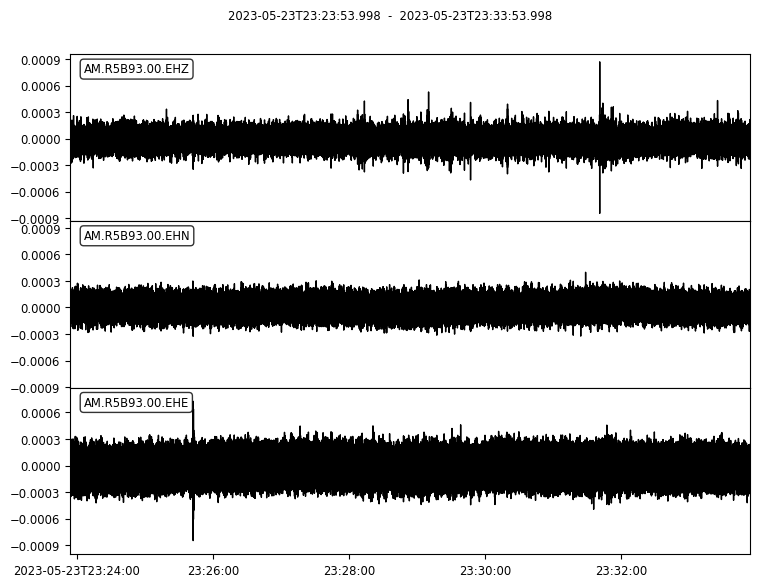


Trace Summary for Station R5B93 (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-05-23T23:23:53.998000Z
  End Time:   2023-05-23T23:33:53.998000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-05-23T23:23:53.998000Z
  End Time:   2023-05-23T23:33:53.998000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-05-23T23:23:53.998000Z
  End Time:   2023-05-23T23:33:53.998000Z
----------------------------------------


In [787]:
# Download 2-day data
start = UTCDateTime(2023, 5, 22, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R5B93", start, channels=['EHZ', 'EHE', 'EHN'])

# Set the earthquake time
eq_time = UTCDateTime(2023, 5, 23, 23, 28, 54)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R5B93", eq_time)

##### Station 7

#### Earthquake distance 25.36km, Mag 3.3

Raw waveform (in counts):


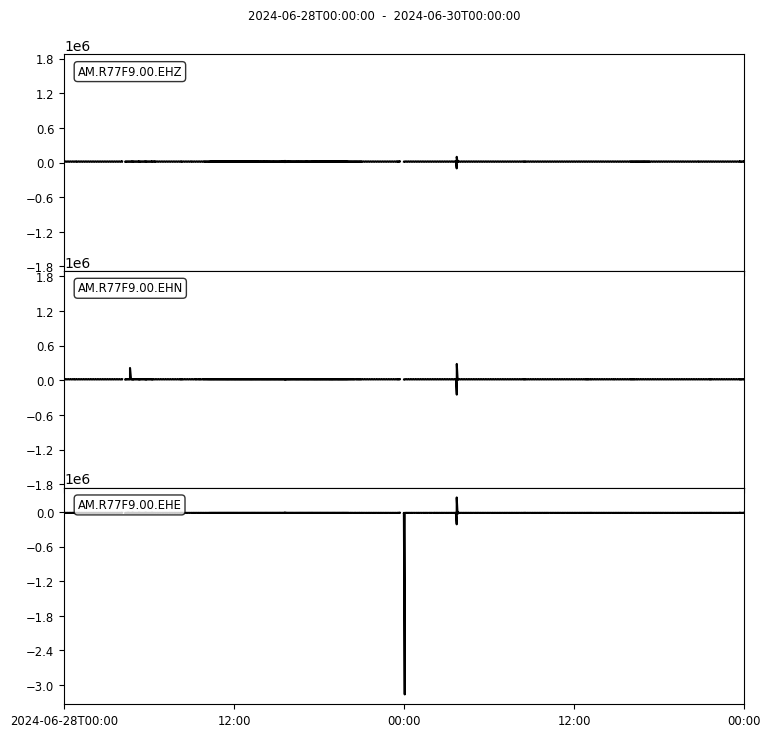

Converted waveform (acceleration):


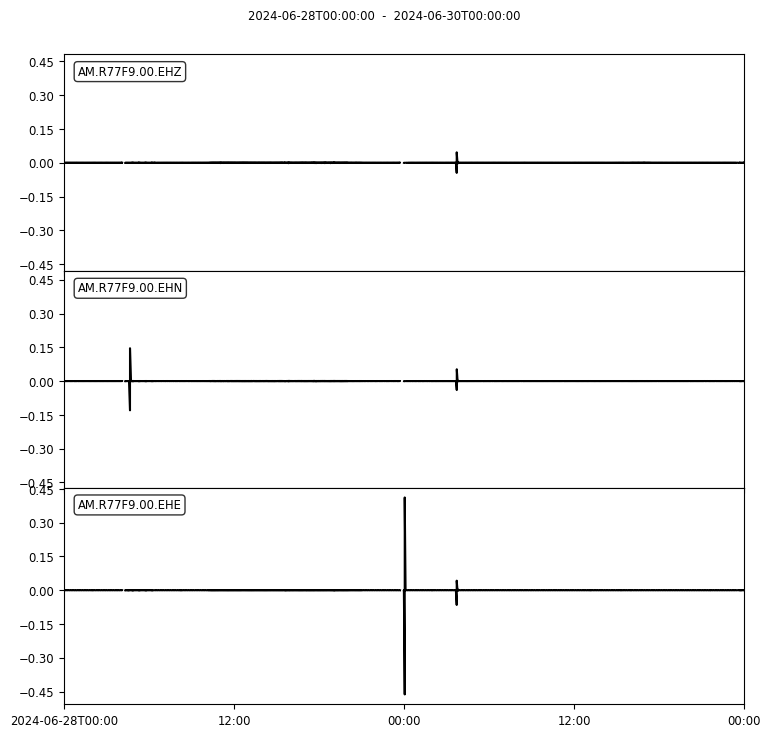

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R77F9_full_2days.mseed
Trimmed 10-minute waveform saved: R77F9_EQ_trimmed_10min.mseed


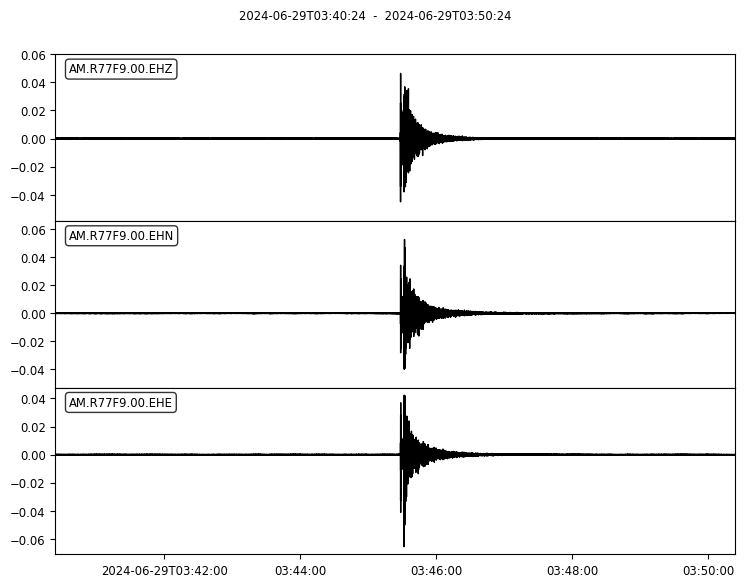


Trace Summary for Station R77F9 (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-06-29T03:40:24.000000Z
  End Time:   2024-06-29T03:50:24.000000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-06-29T03:40:24.000000Z
  End Time:   2024-06-29T03:50:24.000000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-06-29T03:40:24.000000Z
  End Time:   2024-06-29T03:50:24.000000Z
----------------------------------------


In [790]:
# Download 2-day data
start = UTCDateTime(2024, 6, 28, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R77F9", start, channels=['EHZ', 'EHE', 'EHN'])

# Set the earthquake time
eq_time = UTCDateTime(2024, 6, 29, 3, 45, 24)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R77F9", eq_time)

##### Station 8

#### Earthquake distance for event 1 (14.6km, Mag 1.8, depth 5.0km), event 2 (44.63km, Mag 1.7, depth 5.0km)

Raw waveform (in counts):


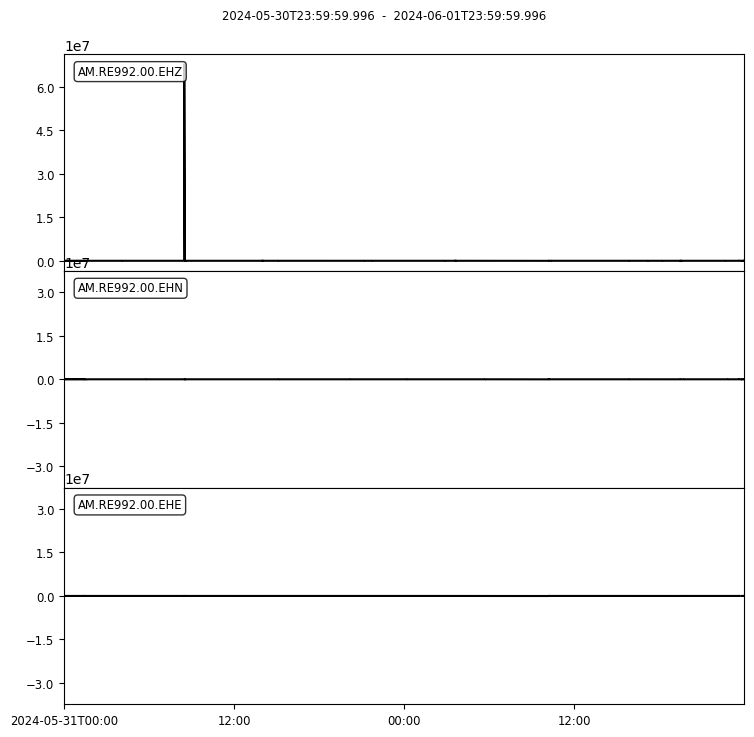

Converted waveform (acceleration):


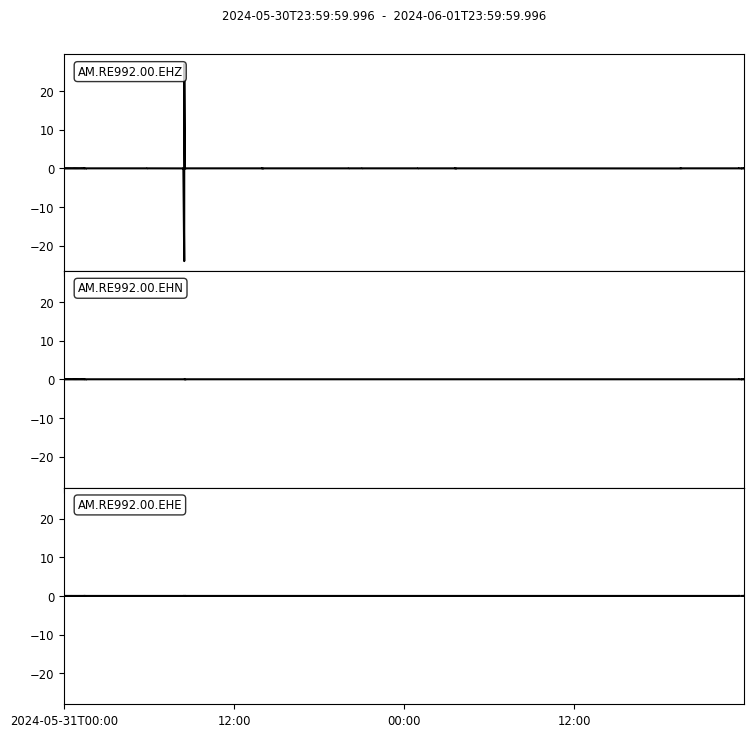

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: RE992_full_2days.mseed
Trimmed 10-minute waveform saved: RE992_EQ_20240601T111409_10min.mseed


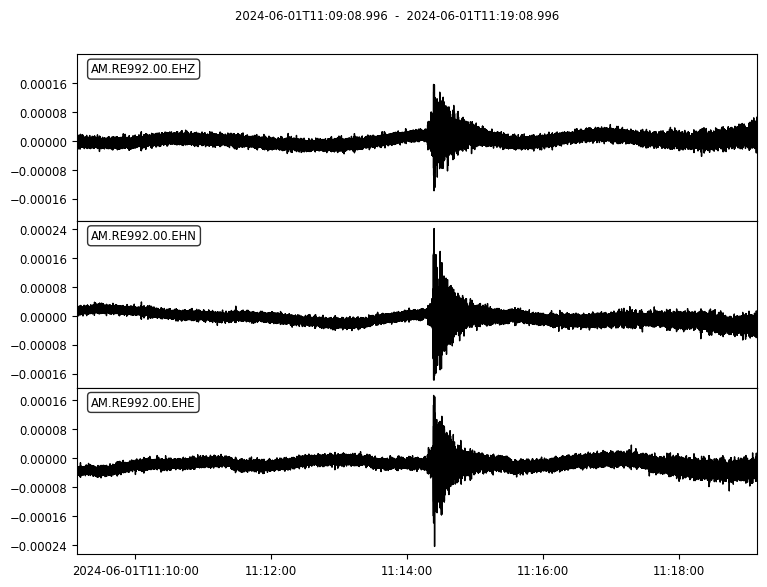


Trace Summary for Station RE992 (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-06-01T11:09:08.996000Z
  End Time:   2024-06-01T11:19:08.996000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-06-01T11:09:08.996000Z
  End Time:   2024-06-01T11:19:08.996000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-06-01T11:09:08.996000Z
  End Time:   2024-06-01T11:19:08.996000Z
----------------------------------------


In [801]:
# First event waveform

# Download 2-day data
start = UTCDateTime(2024, 5, 31, 0, 0, 0)
stream_raw, stream_acc = download_station_data("RE992", start, channels=['EHZ', 'EHE', 'EHN'])

# Then trim and save
eq_time1 = UTCDateTime(2024, 6, 1, 11, 14, 9)
eq_stream1 = trim_and_save_waveform(stream_acc, "RE992", eq_time1)

Raw waveform (in counts):


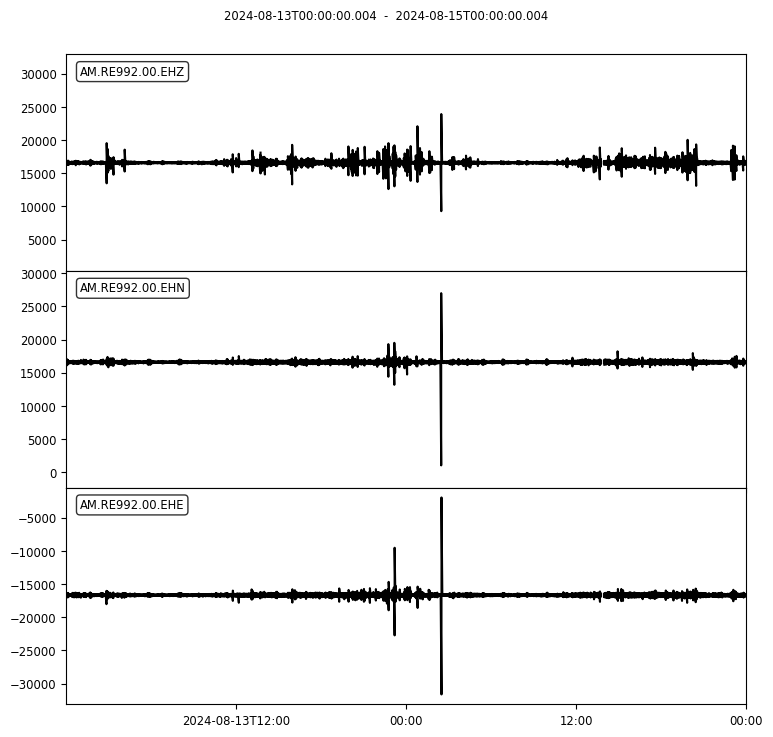

Converted waveform (acceleration):


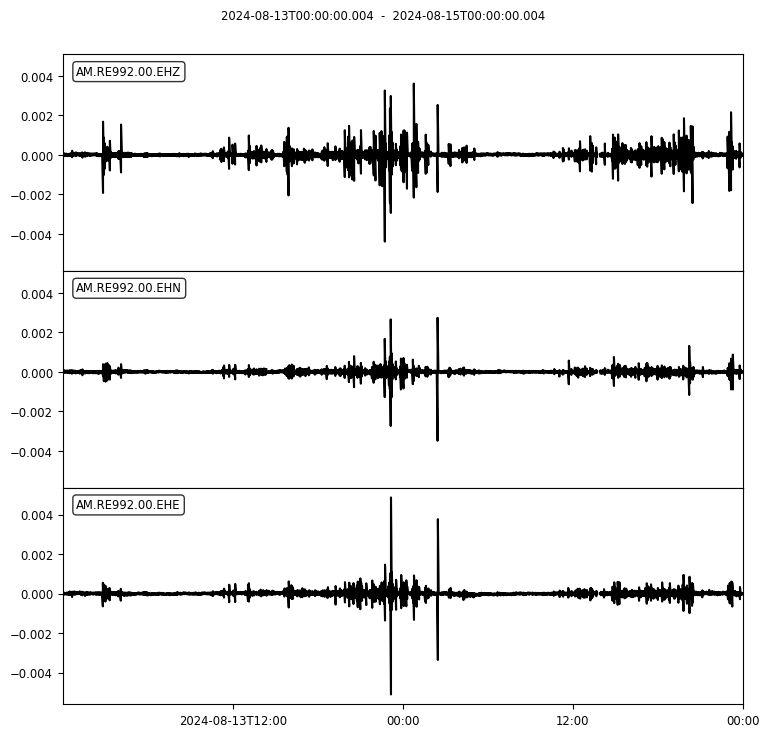

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: RE992_full_2days.mseed
Trimmed 10-minute waveform saved: RE992_EQ_20240814T022653_10min.mseed


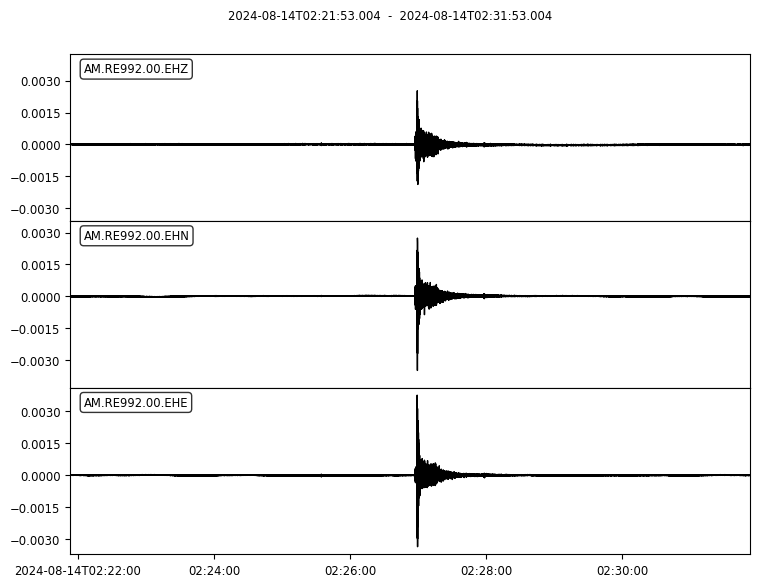


Trace Summary for Station RE992 (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-08-14T02:21:53.004000Z
  End Time:   2024-08-14T02:31:53.004000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-08-14T02:21:53.004000Z
  End Time:   2024-08-14T02:31:53.004000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-08-14T02:21:53.004000Z
  End Time:   2024-08-14T02:31:53.004000Z
----------------------------------------


In [803]:
# Second event

# Download 2-day data
start = UTCDateTime(2024, 8, 13, 0, 0, 0)
stream_raw2, stream_acc2 = download_station_data("RE992", start, channels=['EHZ', 'EHE', 'EHN'])

eq_time2 = UTCDateTime(2024, 8, 14, 2, 26, 53)
eq_stream2 = trim_and_save_waveform(stream_acc2, "RE992", eq_time2)

##### Station 9

#### Earthquake distance 16.8km, Mag 3.9, depth 11.6km

Raw waveform (in counts):


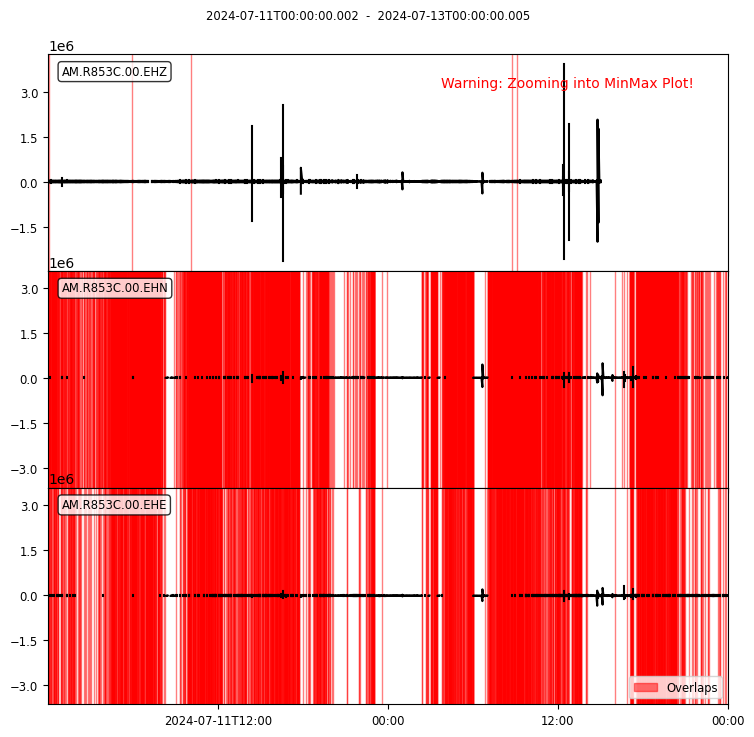

Converted waveform (acceleration):


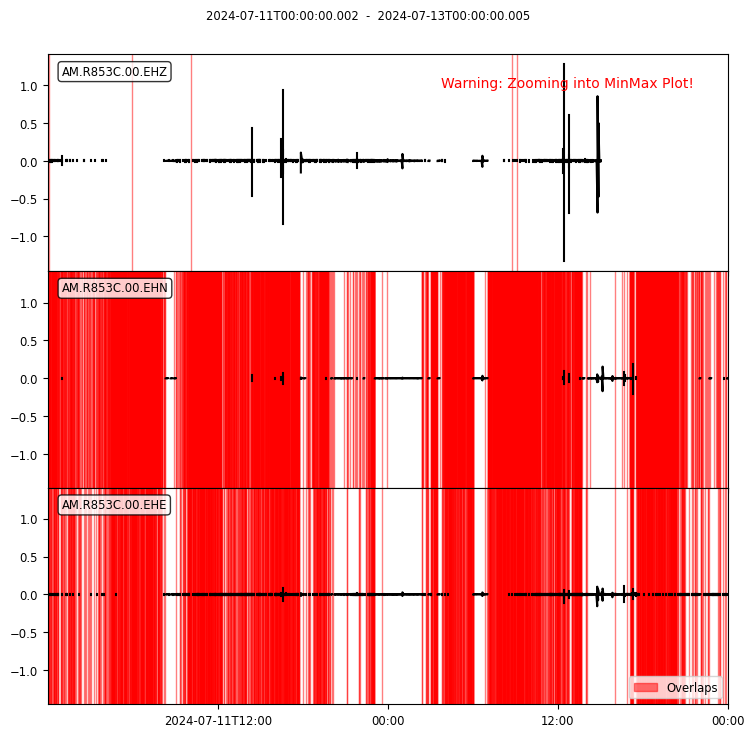

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R853C_full_2days.mseed
Trimmed 10-minute waveform saved: R853C_EQ_20240712T063946_10min.mseed


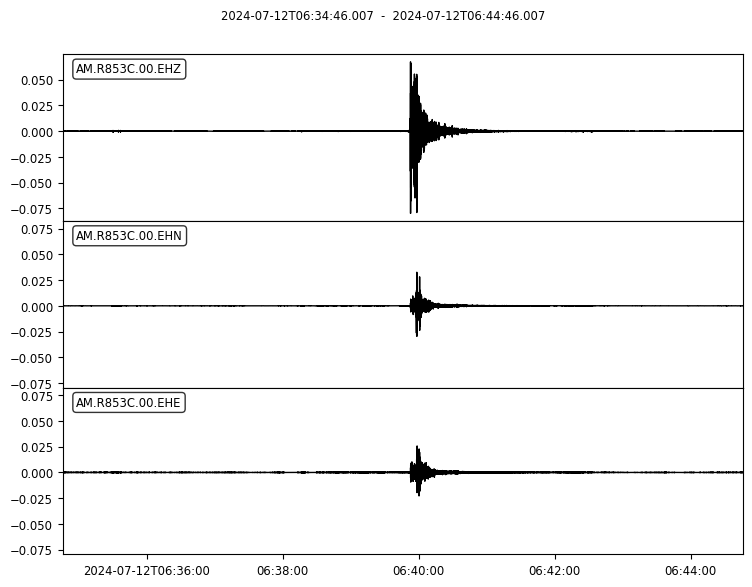


Trace Summary for Station R853C (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-07-12T06:34:46.007000Z
  End Time:   2024-07-12T06:44:46.007000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-07-12T06:34:46.007000Z
  End Time:   2024-07-12T06:44:46.007000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-07-12T06:34:46.007000Z
  End Time:   2024-07-12T06:44:46.007000Z
----------------------------------------


In [810]:
# Download 2-day data
start = UTCDateTime(2024, 7, 11, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R853C", start, channels=['EHZ', 'EHE', 'EHN'])

# Set the earthquake time
eq_time = UTCDateTime(2024, 7, 12, 6, 39, 46)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R853C", eq_time)

##### Station 10

Raw waveform (in counts):


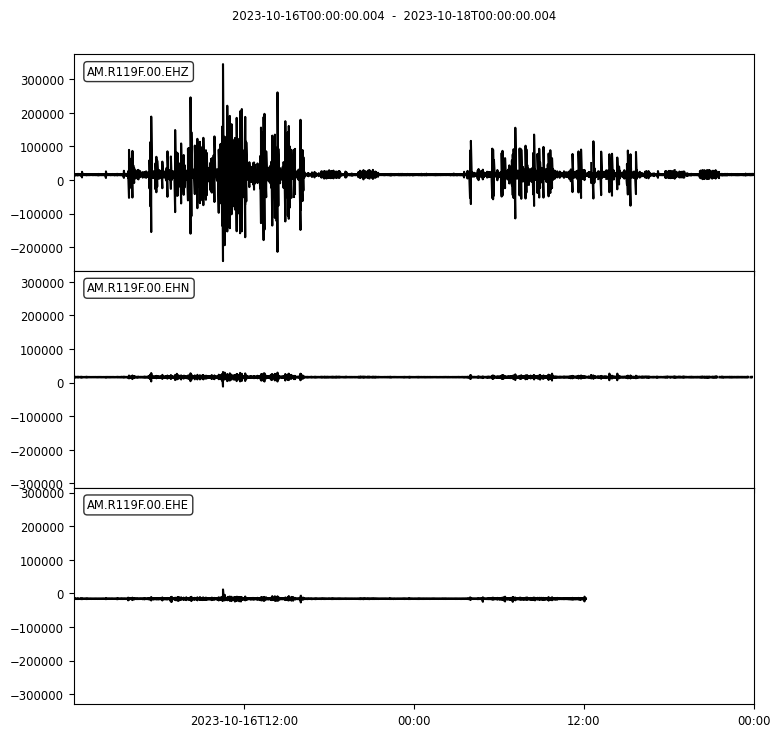

Converted waveform (acceleration):


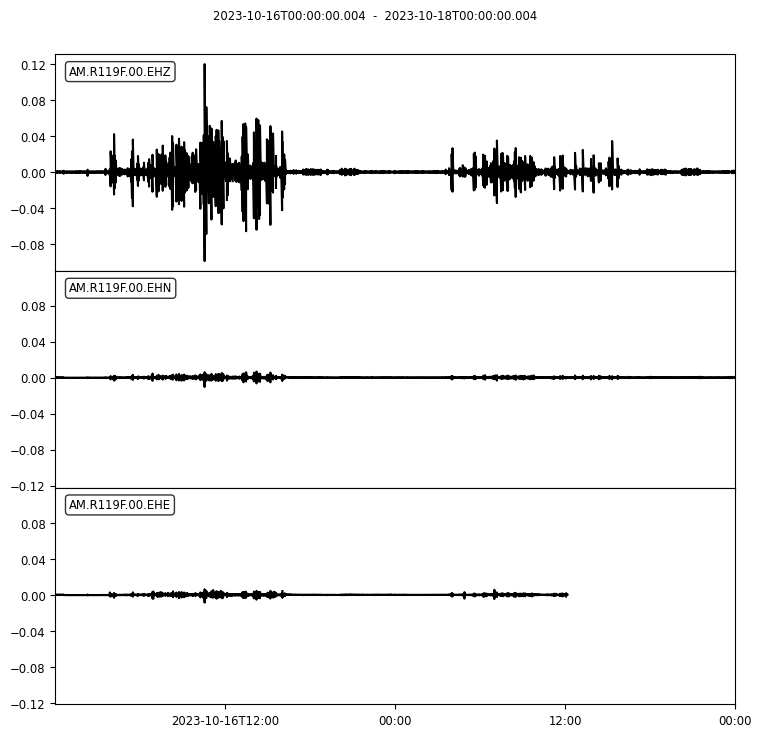

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R119F_full_2days.mseed
Trimmed 10-minute waveform saved: R119F_EQ_20231017T080517_10min.mseed


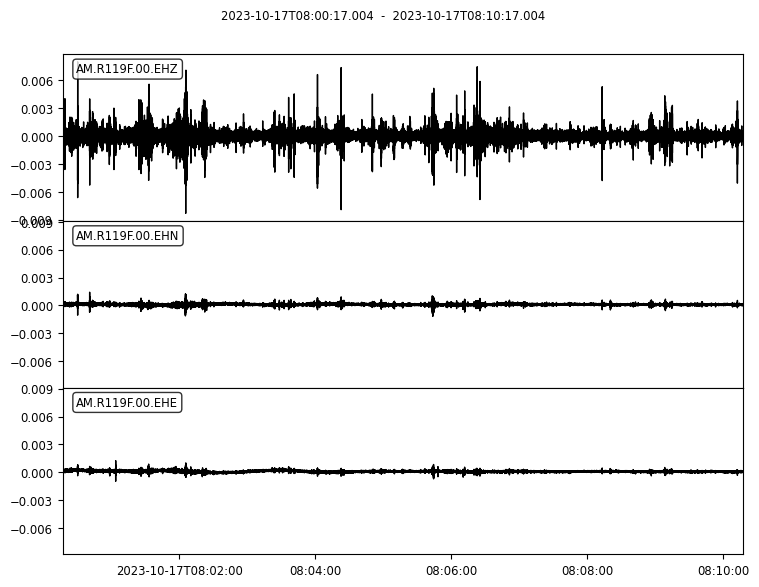


Trace Summary for Station R119F (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-10-17T08:00:17.004000Z
  End Time:   2023-10-17T08:10:17.004000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-10-17T08:00:17.004000Z
  End Time:   2023-10-17T08:10:17.004000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-10-17T08:00:17.004000Z
  End Time:   2023-10-17T08:10:17.004000Z
----------------------------------------


In [813]:
# First event waveform

# Download 2-day data
start = UTCDateTime(2023, 10, 16, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R119F", start, channels=['EHZ', 'EHE', 'EHN'])

# Then trim and save
eq_time1 = UTCDateTime(2023, 10, 17, 8, 5, 17)
eq_stream1 = trim_and_save_waveform(stream_acc, "R119F", eq_time1)

Raw waveform (in counts):


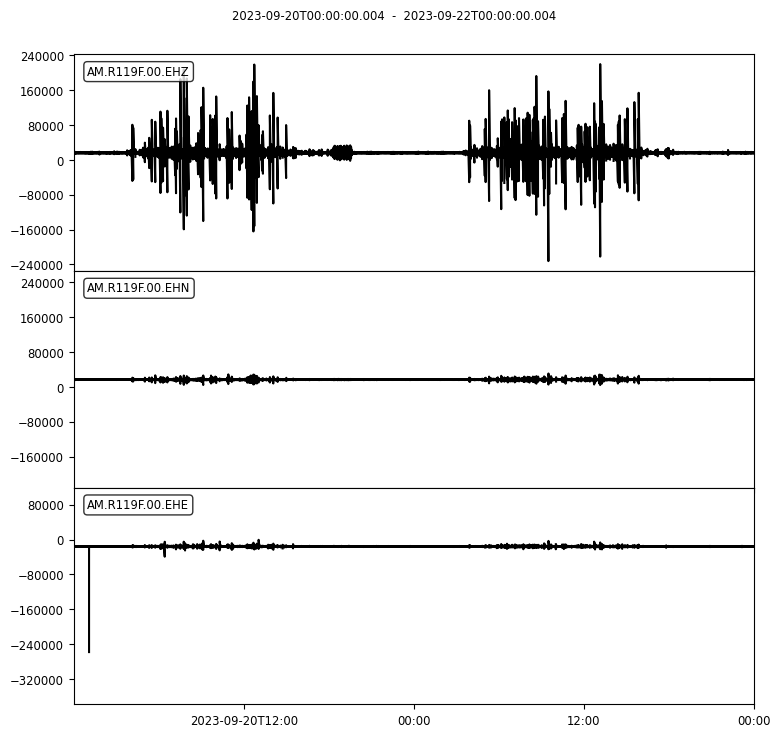

Converted waveform (acceleration):


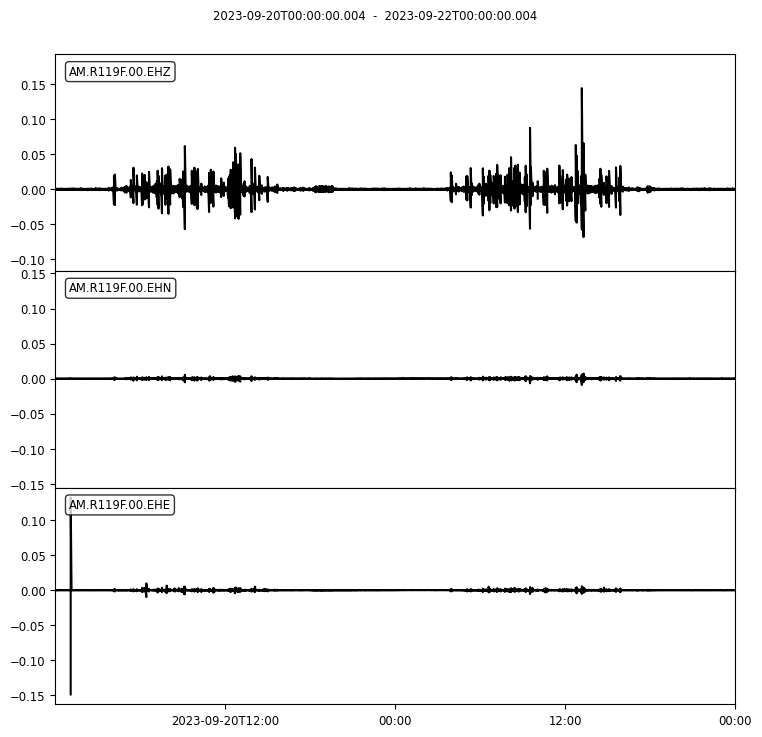

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R119F_full_2days.mseed
Trimmed 10-minute waveform saved: R119F_EQ_20230921T132653_10min.mseed


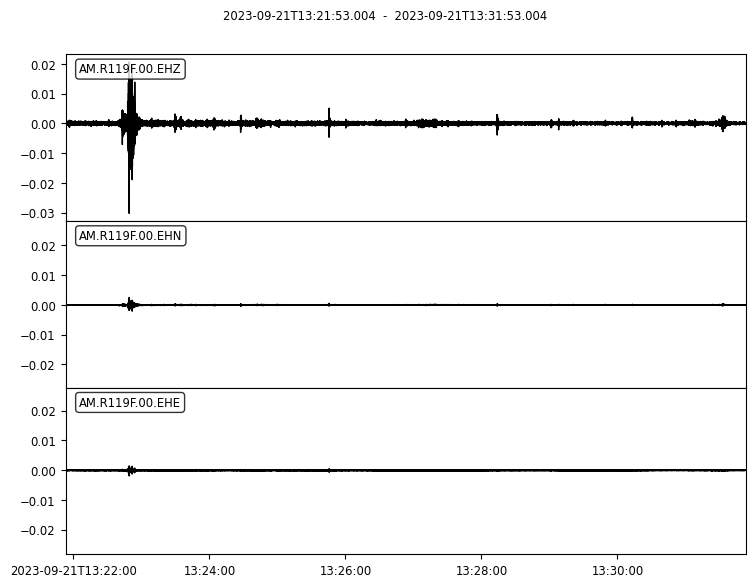


Trace Summary for Station R119F (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-09-21T13:21:53.004000Z
  End Time:   2023-09-21T13:31:53.004000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-09-21T13:21:53.004000Z
  End Time:   2023-09-21T13:31:53.004000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-09-21T13:21:53.004000Z
  End Time:   2023-09-21T13:31:53.004000Z
----------------------------------------


In [823]:
# Second event waveform

# Download 2-day data
start = UTCDateTime(2023, 9, 20, 0, 0, 0)
stream_raw2, stream_acc2 = download_station_data("R119F", start, channels=['EHZ', 'EHE', 'EHN'])

eq_time2 = UTCDateTime(2023, 9, 21, 13, 26, 53)
eq_stream2 = trim_and_save_waveform(stream_acc2, "R119F", eq_time2)

##### Station 11

Raw waveform (in counts):


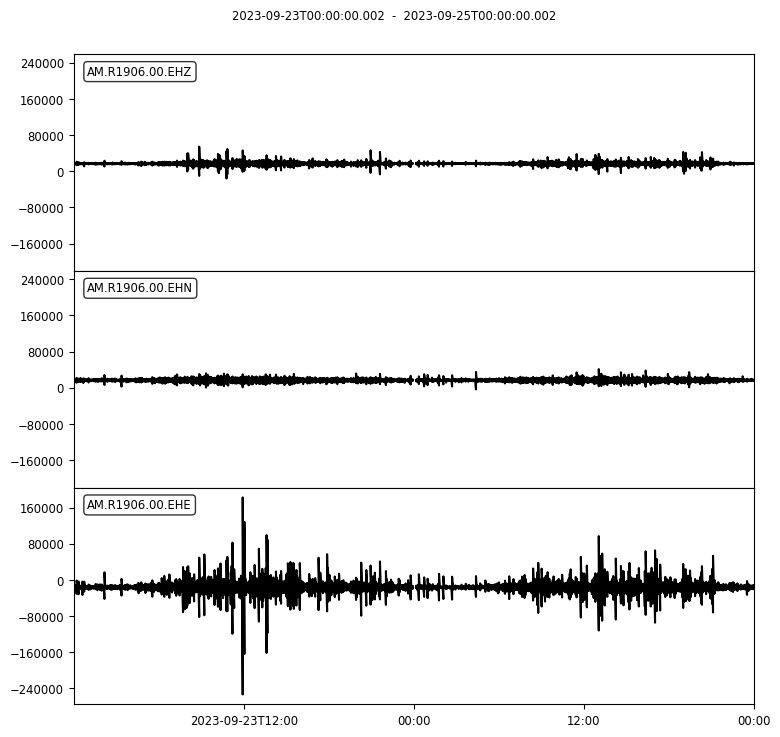

Converted waveform (acceleration):


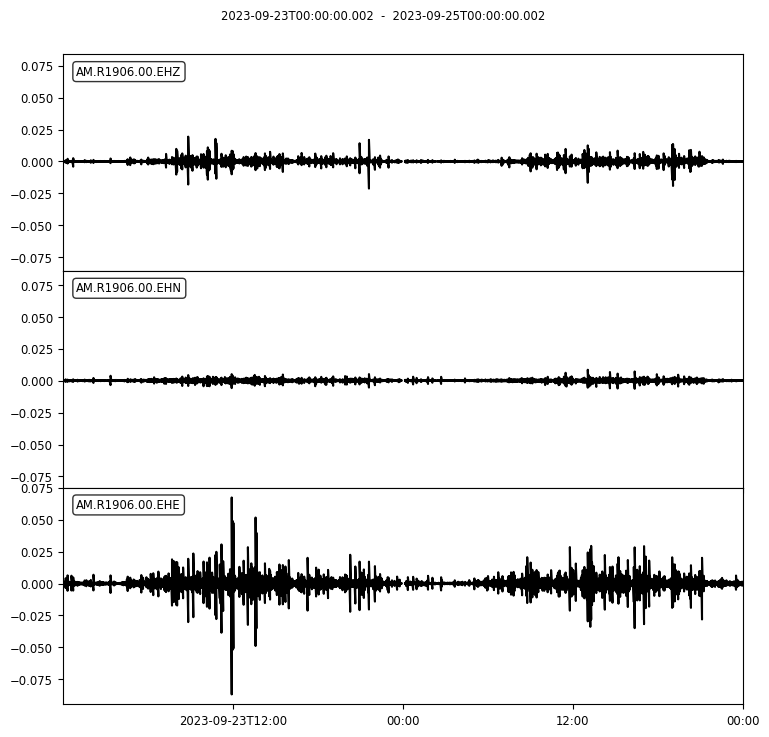

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R1906_full_2days.mseed
Trimmed 10-minute waveform saved: R1906_EQ_20230924T205322_10min.mseed


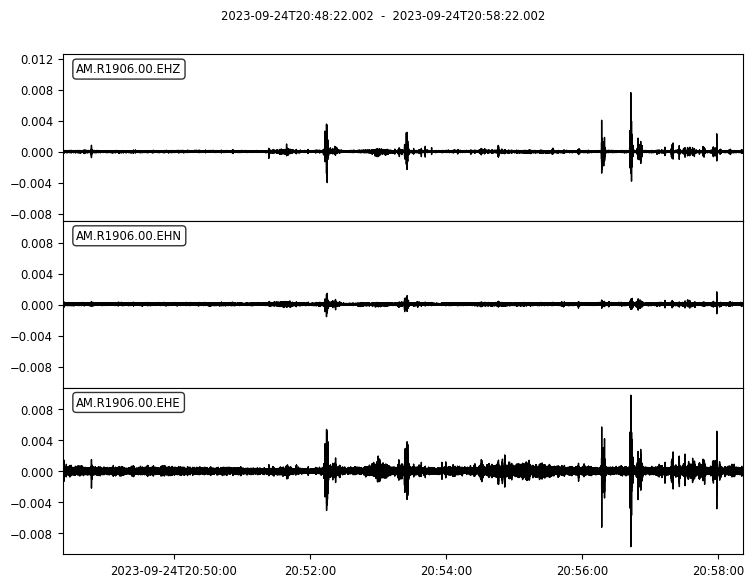


Trace Summary for Station R1906 (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-09-24T20:48:22.002000Z
  End Time:   2023-09-24T20:58:22.002000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-09-24T20:48:22.002000Z
  End Time:   2023-09-24T20:58:22.002000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-09-24T20:48:22.002000Z
  End Time:   2023-09-24T20:58:22.002000Z
----------------------------------------


In [828]:
# Download 2-day data
start = UTCDateTime(2023, 9, 23, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R1906", start, channels=['EHZ', 'EHE', 'EHN'])

# Set the earthquake time
eq_time = UTCDateTime(2023, 9, 24, 20, 53, 22)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R1906", eq_time)

##### Station 12

#### Earthquake distance 14.5km, Mag 4.2, depth 10.0km

Raw waveform (in counts):


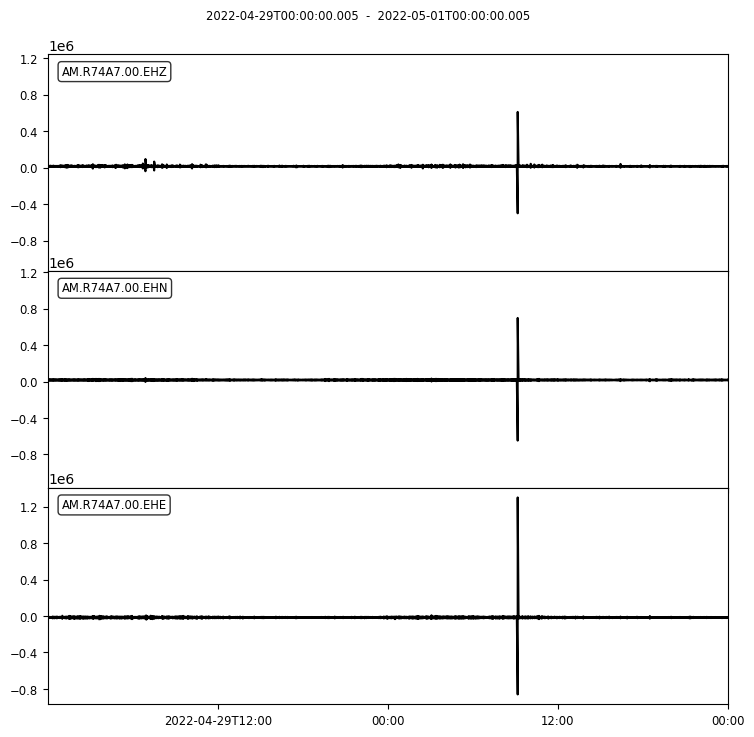

Converted waveform (acceleration):


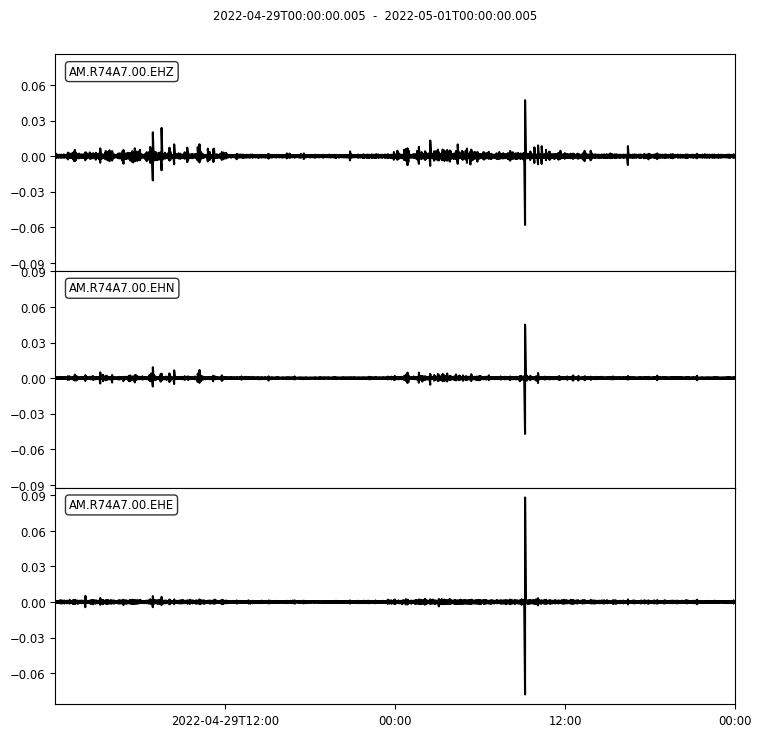

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R74A7_full_2days.mseed
Trimmed 10-minute waveform saved: R74A7_EQ_20220430T090645_10min.mseed


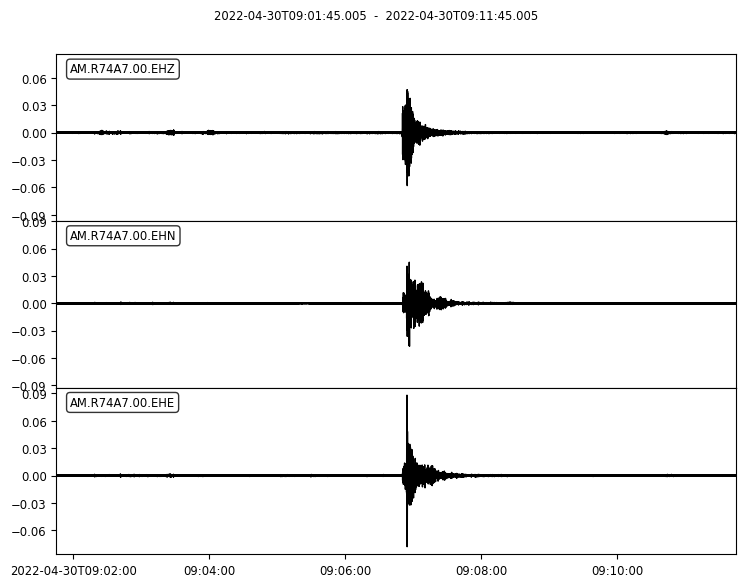


Trace Summary for Station R74A7 (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2022-04-30T09:01:45.005000Z
  End Time:   2022-04-30T09:11:45.005000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2022-04-30T09:01:45.005000Z
  End Time:   2022-04-30T09:11:45.005000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2022-04-30T09:01:45.005000Z
  End Time:   2022-04-30T09:11:45.005000Z
----------------------------------------


In [837]:
# Download 2-day data
start = UTCDateTime(2022, 4, 29, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R74A7", start, channels=['EHZ', 'EHE', 'EHN'])

# Set the earthquake time
eq_time = UTCDateTime(2022, 4, 30, 9, 6, 45)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R74A7", eq_time)

##### Station 13

Raw waveform (in counts):


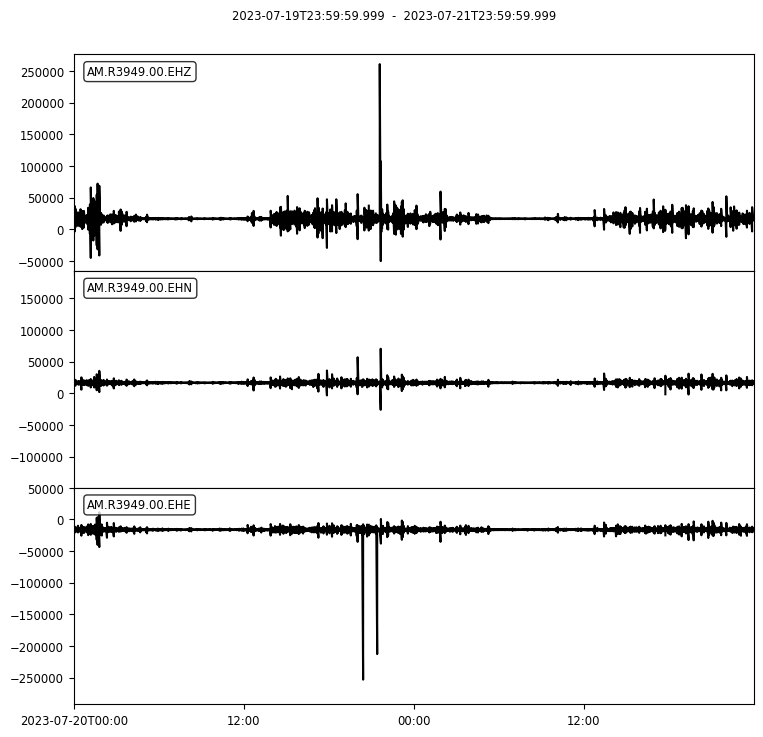

Converted waveform (acceleration):


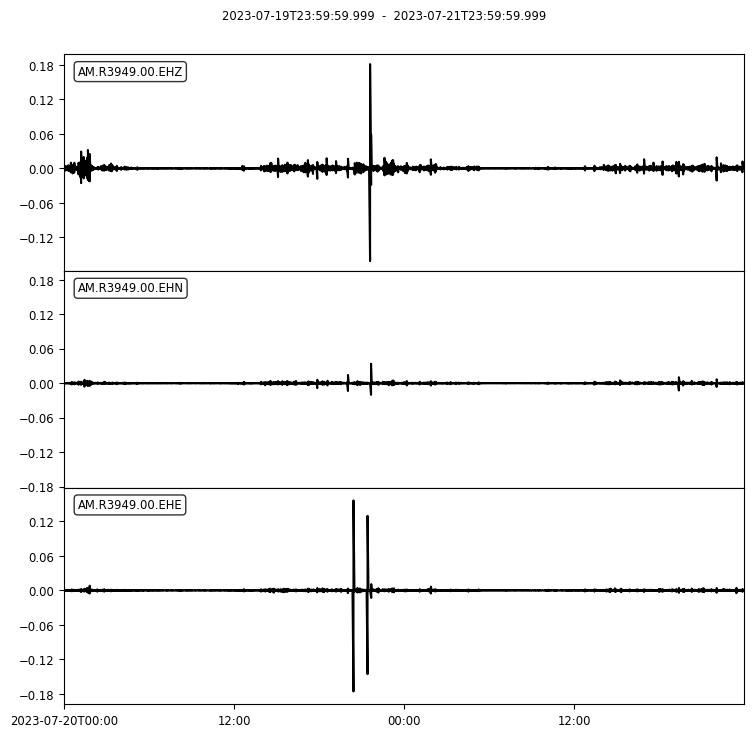

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R3949_full_2days.mseed
Trimmed 10-minute waveform saved: R3949_EQ_20230721T031559_10min.mseed


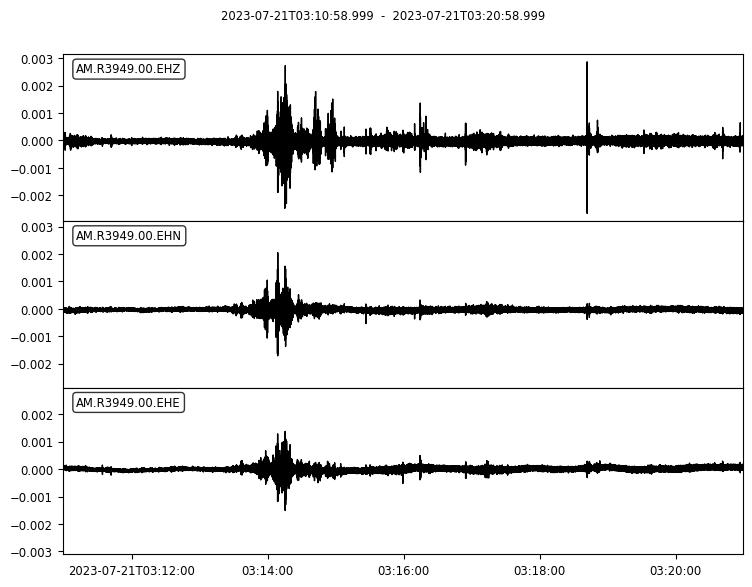


Trace Summary for Station R3949 (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-07-21T03:10:58.999000Z
  End Time:   2023-07-21T03:20:58.999000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-07-21T03:10:58.999000Z
  End Time:   2023-07-21T03:20:58.999000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-07-21T03:10:58.999000Z
  End Time:   2023-07-21T03:20:58.999000Z
----------------------------------------


In [840]:
# Download 2-day data
start = UTCDateTime(2023, 7, 20, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R3949", start, channels=['EHZ', 'EHE', 'EHN'])

# Set the earthquake time
eq_time = UTCDateTime(2023, 7, 21, 3, 15, 59)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R3949", eq_time)

##### Station 14

#### Earthquake distance 42.9km, Mag 4.8

Raw waveform (in counts):


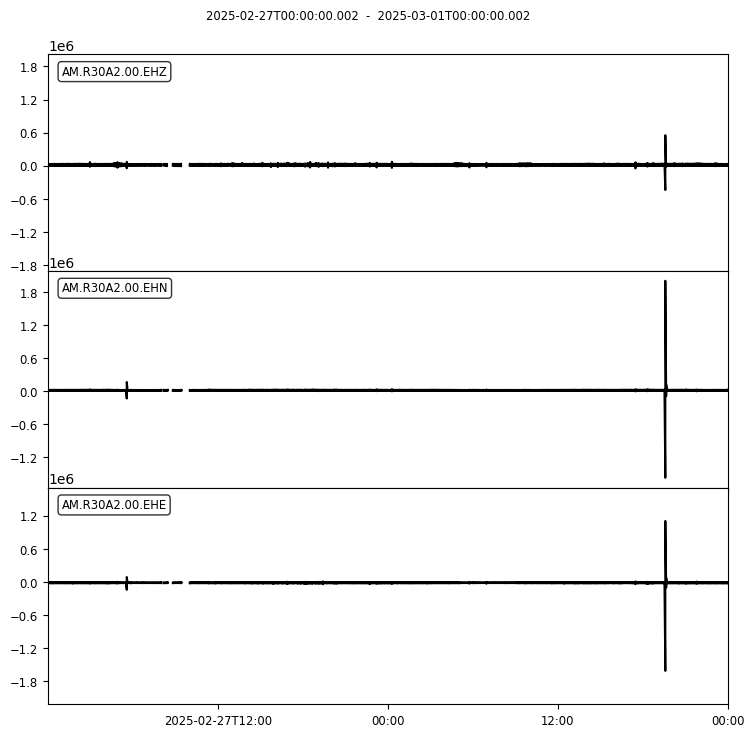

Converted waveform (acceleration):


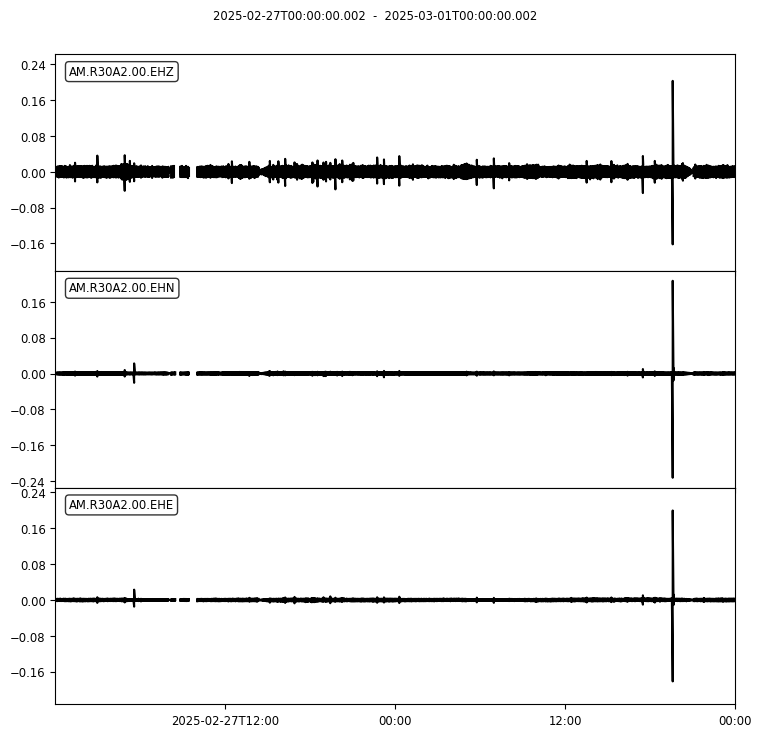

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R30A2_full_2days.mseed
Trimmed 10-minute waveform saved: R30A2_EQ_20250228T193324_10min.mseed


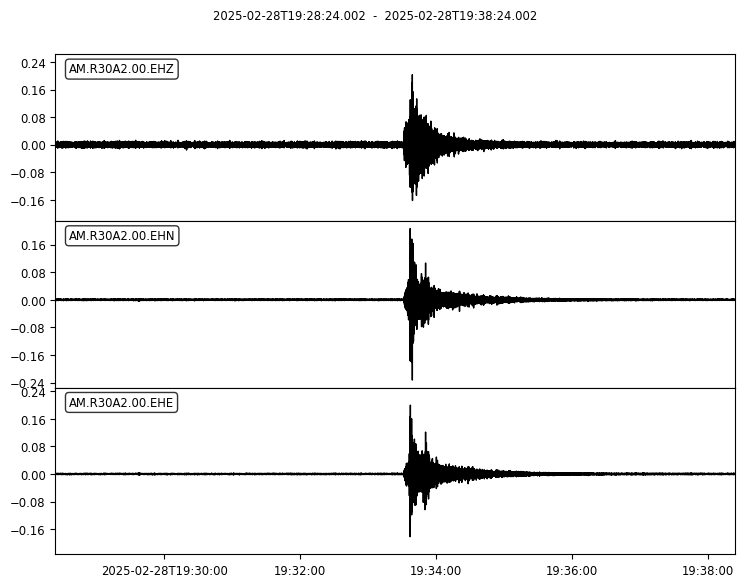


Trace Summary for Station R30A2 (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2025-02-28T19:28:24.002000Z
  End Time:   2025-02-28T19:38:24.002000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2025-02-28T19:28:24.002000Z
  End Time:   2025-02-28T19:38:24.002000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2025-02-28T19:28:24.002000Z
  End Time:   2025-02-28T19:38:24.002000Z
----------------------------------------


In [843]:
# Download 2-day data
start = UTCDateTime(2025, 2, 27, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R30A2", start, channels=['EHZ', 'EHE', 'EHN'])

# Set the earthquake time
eq_time = UTCDateTime(2025, 2, 28, 19, 33, 24)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R30A2", eq_time)

##### Station 15

Raw waveform (in counts):


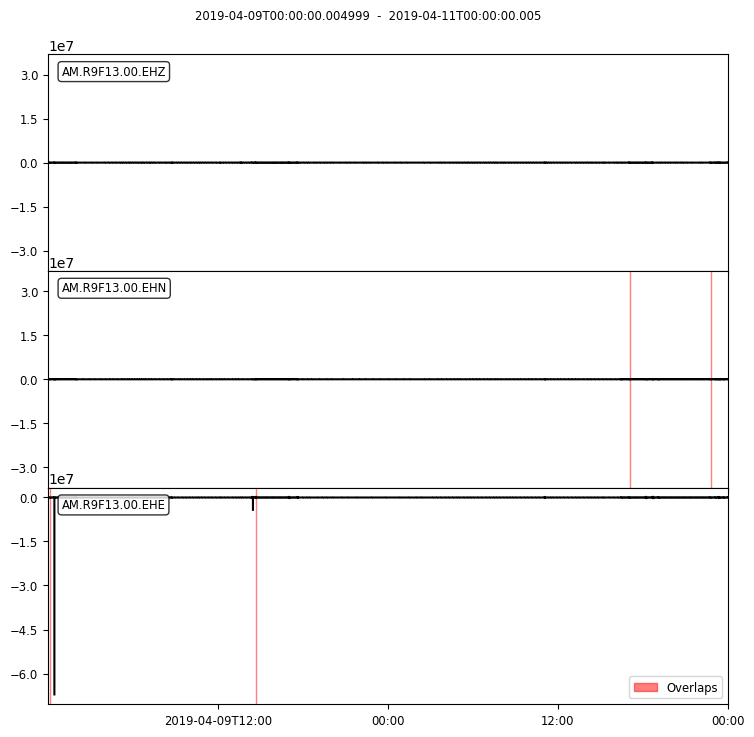

Converted waveform (acceleration):


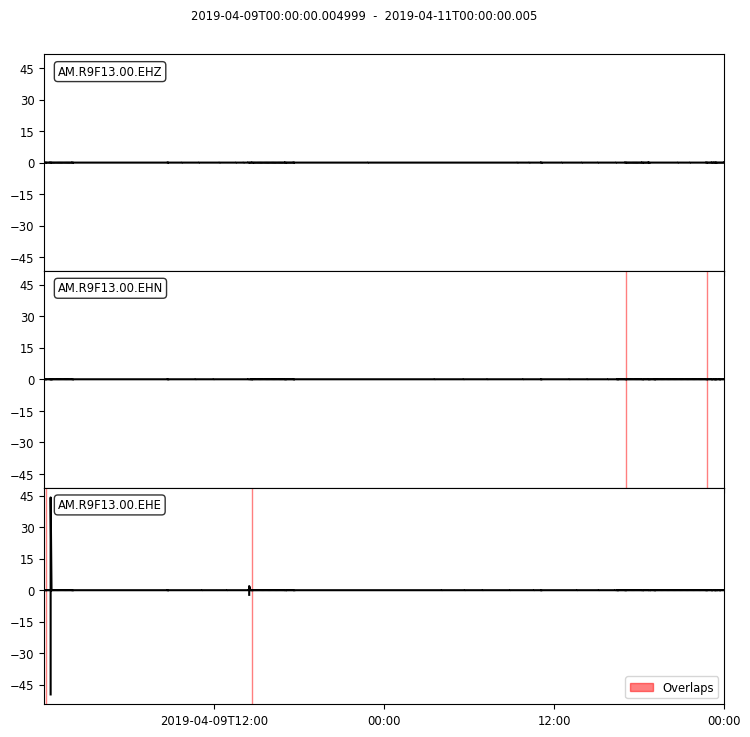

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R9F13_full_2days.mseed
Trimmed 10-minute waveform saved: R9F13_EQ_20190410T161508_10min.mseed


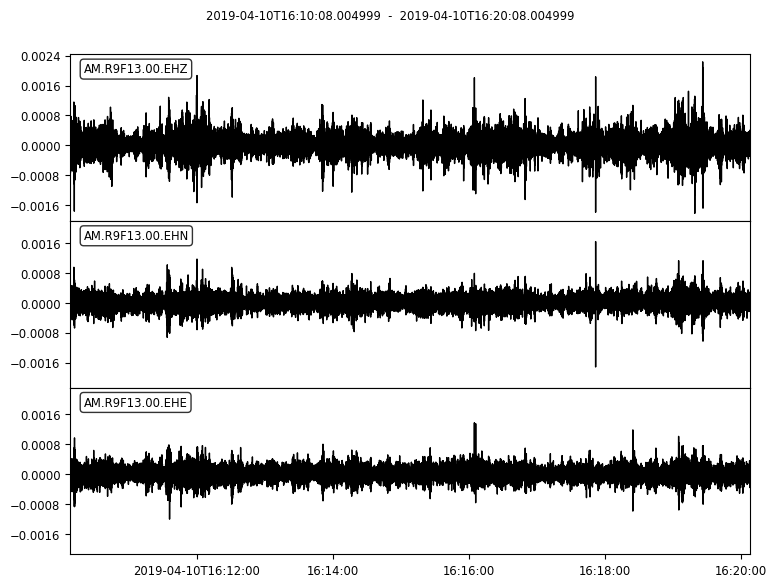


Trace Summary for Station R9F13 (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2019-04-10T16:10:08.004999Z
  End Time:   2019-04-10T16:20:08.004999Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2019-04-10T16:10:08.004999Z
  End Time:   2019-04-10T16:20:08.004999Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2019-04-10T16:10:08.004999Z
  End Time:   2019-04-10T16:20:08.004999Z
----------------------------------------


In [846]:
# Download 2-day data
start = UTCDateTime(2019, 4, 9, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R9F13", start, channels=['EHZ', 'EHE', 'EHN'])

# Set the earthquake time
eq_time = UTCDateTime(2019, 4, 10, 16, 15, 8)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R9F13", eq_time)

##### Station 16

#### Earthquake distance 82.818km, Mag 4.4, depth 10.0km

Raw waveform (in counts):


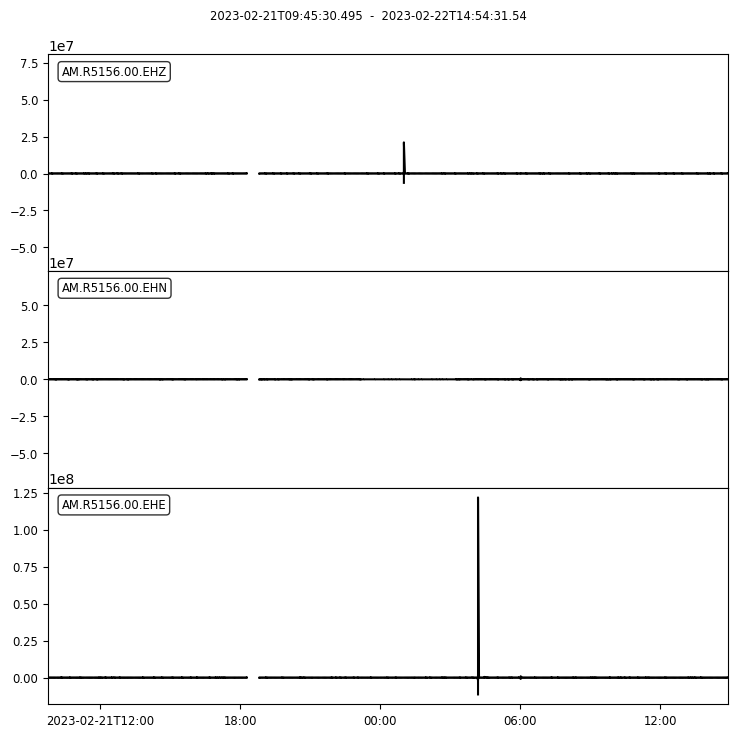

Converted waveform (acceleration):


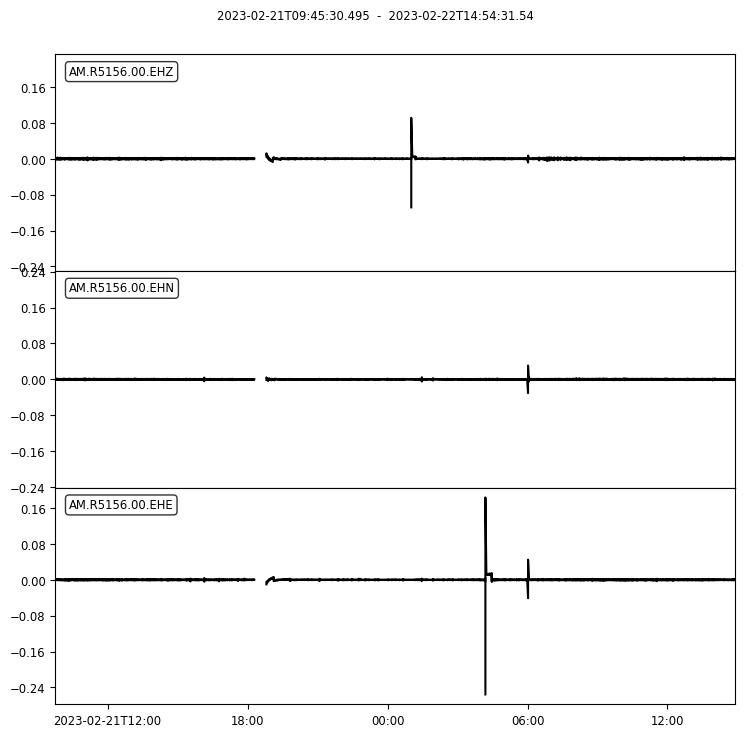

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R5156_full_2days.mseed
Trimmed 10-minute waveform saved: R5156_EQ_20230222T060119_10min.mseed


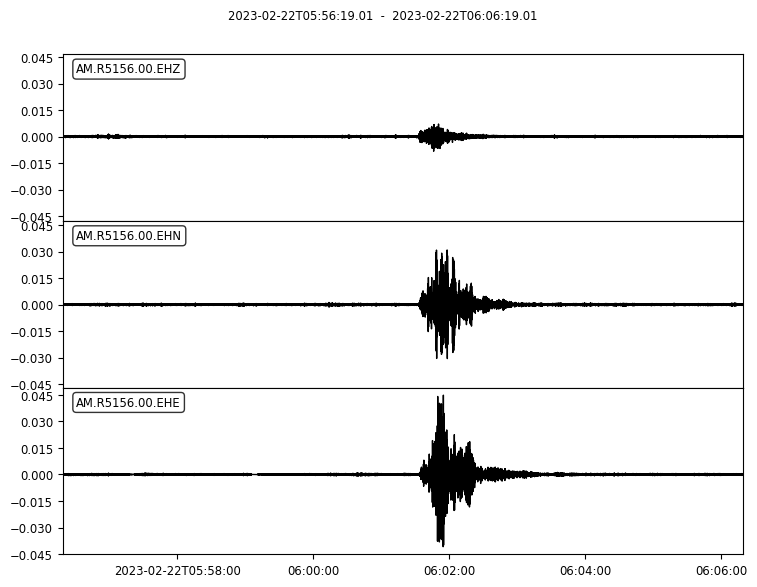


Trace Summary for Station R5156 (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-02-22T05:56:19.010000Z
  End Time:   2023-02-22T06:06:19.010000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 6269
  Start Time: 2023-02-22T05:56:19.010000Z
  End Time:   2023-02-22T05:57:21.690000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 10399
  Start Time: 2023-02-22T05:57:21.710000Z
  End Time:   2023-02-22T05:59:05.690000Z
----------------------------------------
Channel: EHE
  Sample Rate: 100.0 Hz
  Number of Samples: 43331
  Start Time: 2023-02-22T05:59:05.710000Z
  End Time:   2023-02-22T06:06:19.010000Z
----------------------------------------
Channel: EHN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-02-22T05:56:19.010000Z
  End Time:   2023-02-22T06:06:19.010000Z
-------------------------------------

In [851]:
# Download 2-day data
start = UTCDateTime(2023, 2, 21, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R5156", start, channels=['EHZ', 'EHE', 'EHN'])

# Set the earthquake time
eq_time = UTCDateTime(2023, 2, 22, 6, 1, 19)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R5156", eq_time)

##### Station 17

Raw waveform (in counts):


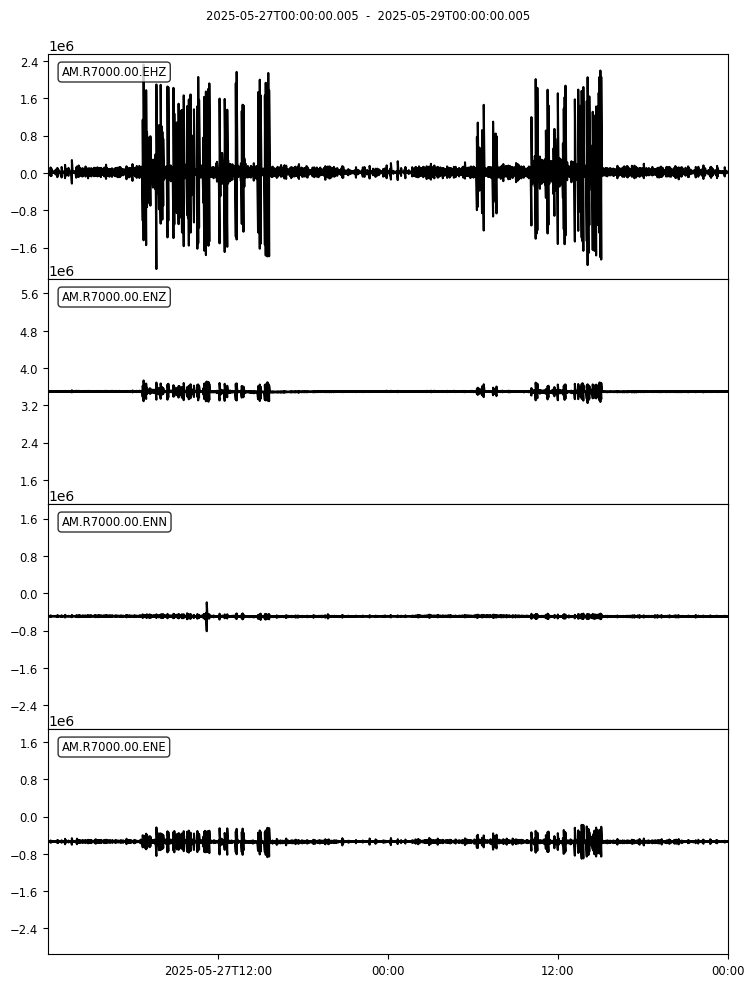

Converted waveform (acceleration):


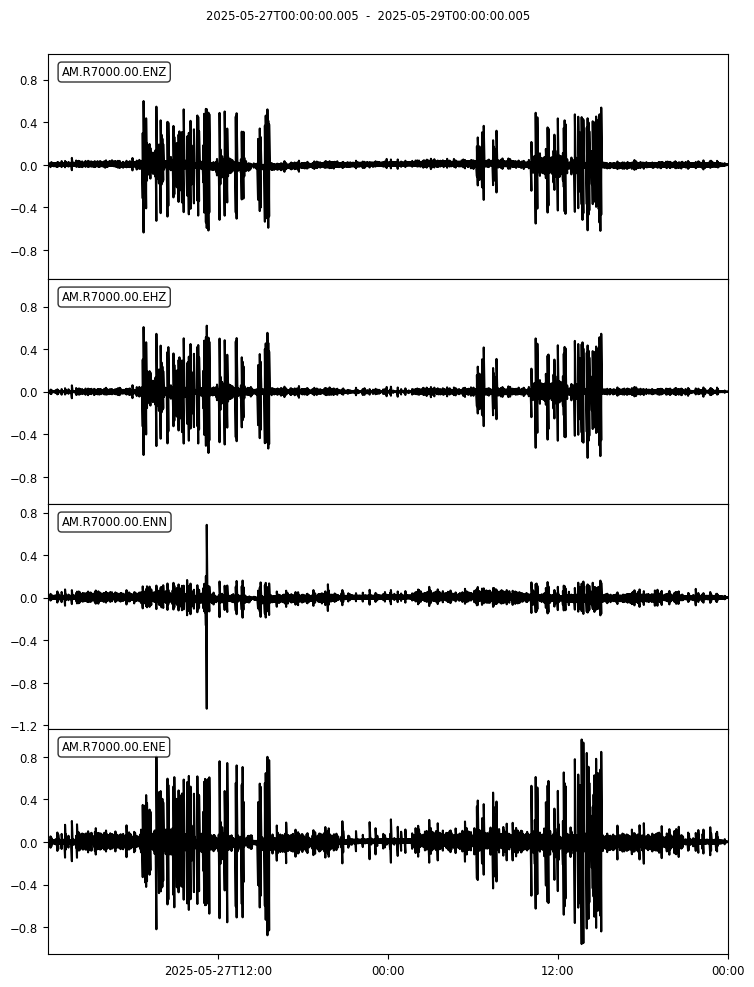

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R7000_full_2days.mseed
Trimmed 10-minute waveform saved: R7000_EQ_20250528T124439_10min.mseed


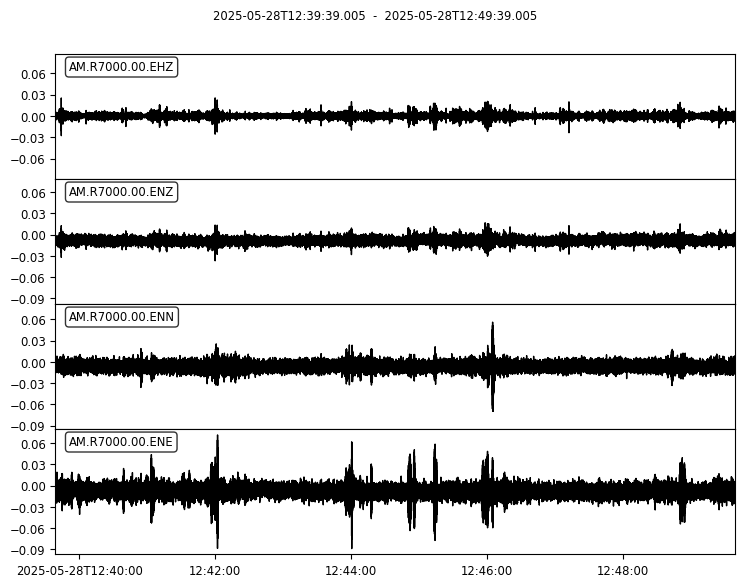


Trace Summary for Station R7000 (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2025-05-28T12:39:39.005000Z
  End Time:   2025-05-28T12:49:39.005000Z
----------------------------------------
Channel: ENE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2025-05-28T12:39:39.005000Z
  End Time:   2025-05-28T12:49:39.005000Z
----------------------------------------
Channel: ENN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2025-05-28T12:39:39.005000Z
  End Time:   2025-05-28T12:49:39.005000Z
----------------------------------------
Channel: ENZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2025-05-28T12:39:39.005000Z
  End Time:   2025-05-28T12:49:39.005000Z
----------------------------------------


In [854]:
# Download 2-day data
start = UTCDateTime(2025, 5, 27, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R7000", start, channels=['EHZ', 'ENE', 'ENN', 'ENZ'])

# Set the earthquake time
eq_time = UTCDateTime(2025, 5, 28, 12, 44, 39)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R7000", eq_time)

##### Station 18

#### Earthquake distance 85.3km, Mag 4.2, depth 5.0km

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/headers.py:805: InternalMSEEDWarning: AM_R47BB_00_ENZ_D: Warning: Data integrity check for Steim2 failed, Last sample=3660547, Xn=3660214
  warnings.warn(_w, InternalMSEEDWarning)


Raw waveform (in counts):


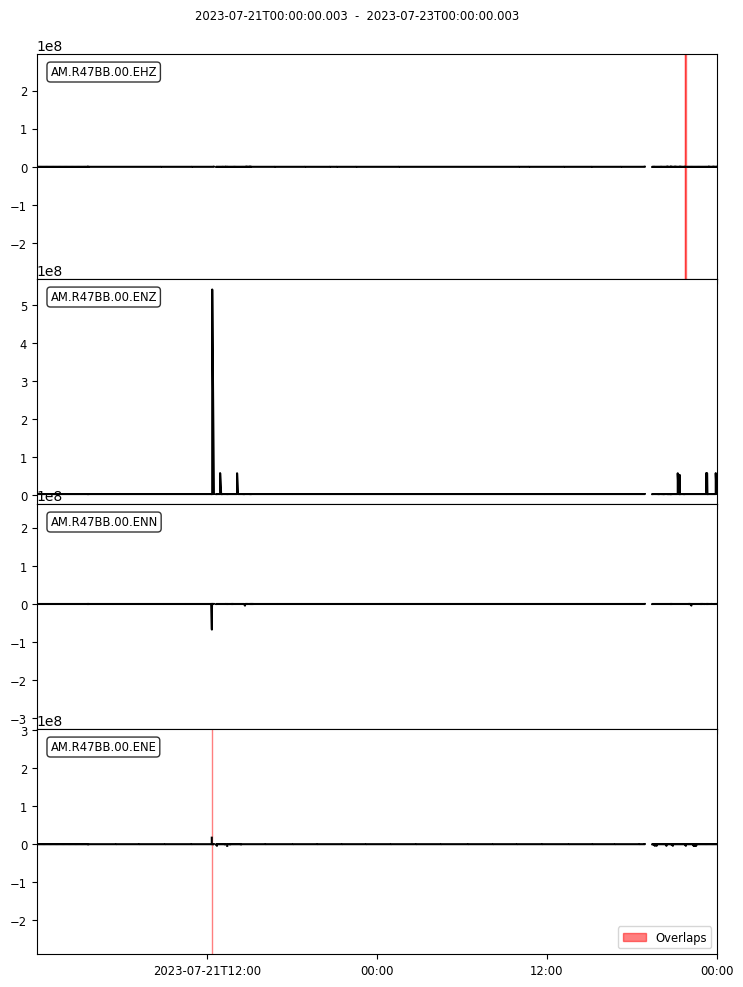

Converted waveform (acceleration):


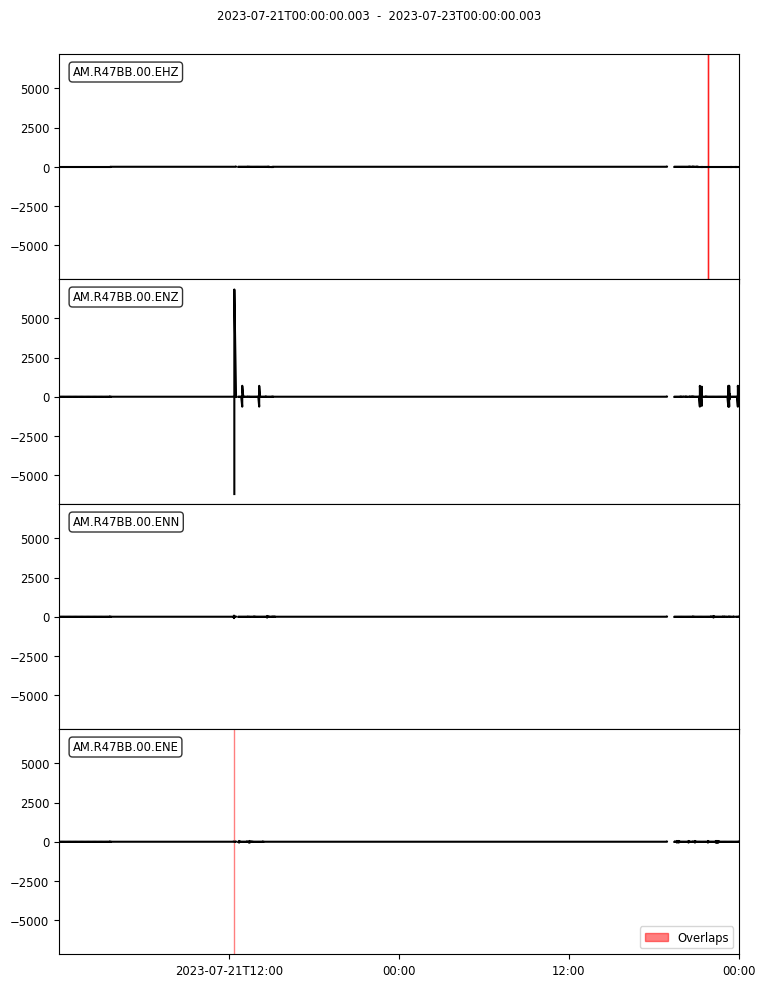

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R47BB_full_2days.mseed
Trimmed 10-minute waveform saved: R47BB_EQ_20230722T164652_10min.mseed


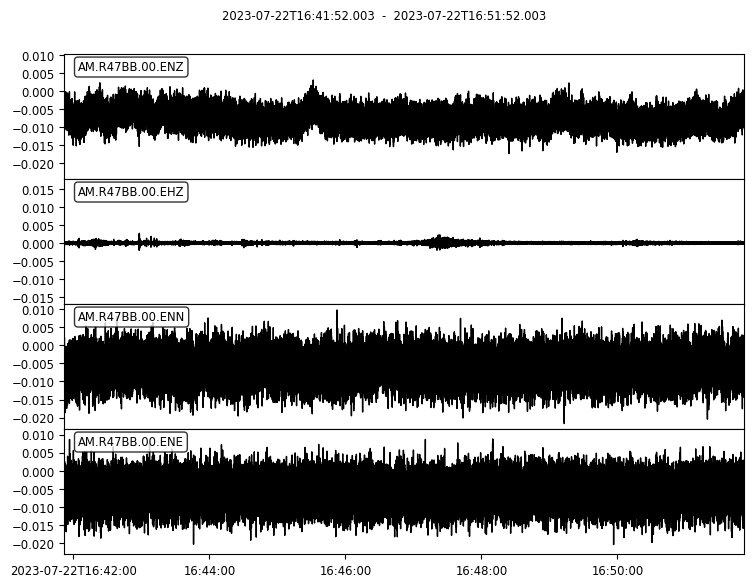


Trace Summary for Station R47BB (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-07-22T16:41:52.003000Z
  End Time:   2023-07-22T16:51:52.003000Z
----------------------------------------
Channel: ENE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-07-22T16:41:52.003000Z
  End Time:   2023-07-22T16:51:52.003000Z
----------------------------------------
Channel: ENN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-07-22T16:41:52.003000Z
  End Time:   2023-07-22T16:51:52.003000Z
----------------------------------------
Channel: ENZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2023-07-22T16:41:52.003000Z
  End Time:   2023-07-22T16:51:52.003000Z
----------------------------------------


In [857]:
# Download 2-day data
start = UTCDateTime(2023, 7, 21, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R47BB", start, channels=['EHZ', 'ENE', 'ENN', 'ENZ'])

# Set the earthquake time
eq_time = UTCDateTime(2023, 7, 22, 16, 46, 52)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R47BB", eq_time)

##### Station 19

Raw waveform (in counts):


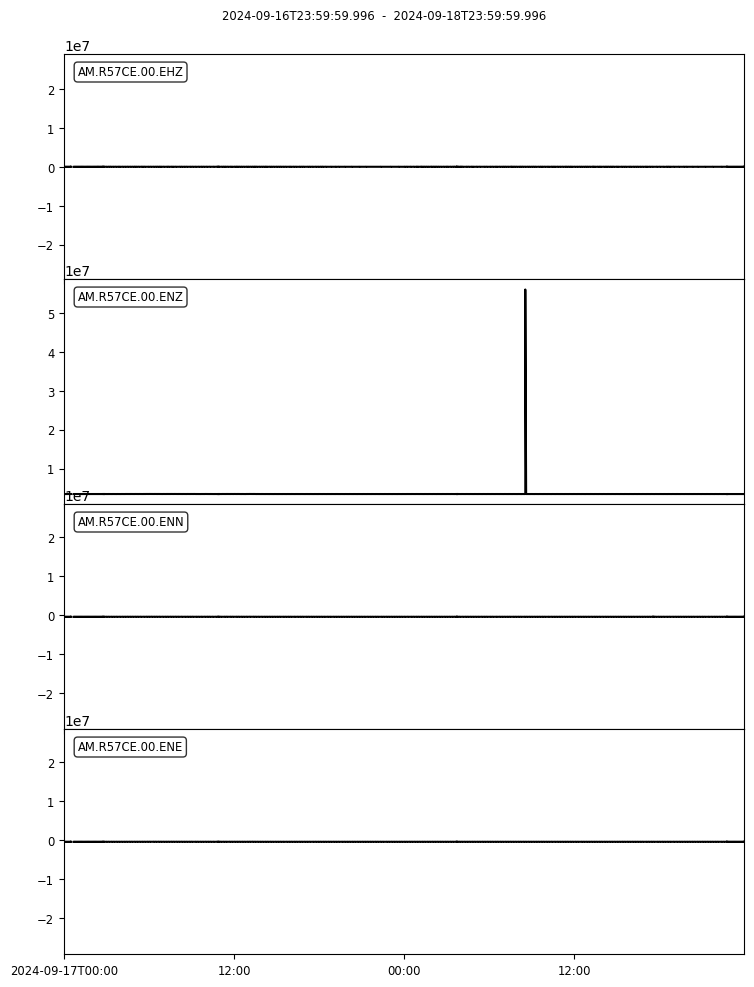

Converted waveform (acceleration):


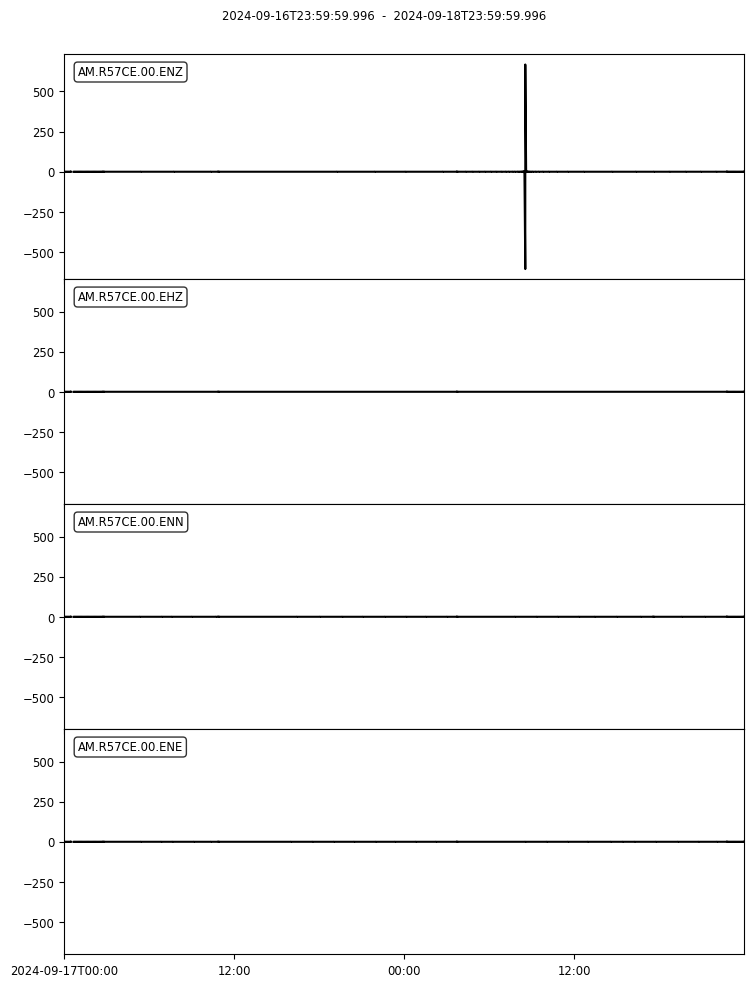

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R57CE_full_2days.mseed
Trimmed 10-minute waveform saved: R57CE_EQ_20240918T101939_10min.mseed


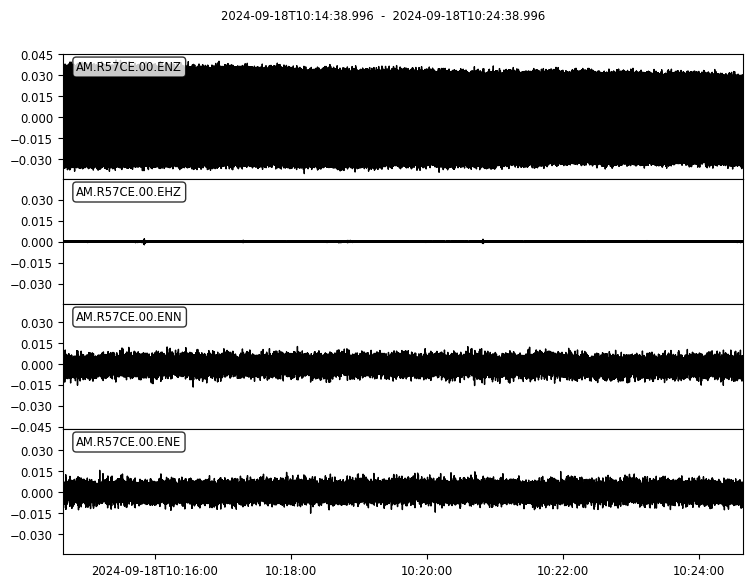


Trace Summary for Station R57CE (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-09-18T10:14:38.996000Z
  End Time:   2024-09-18T10:24:38.996000Z
----------------------------------------
Channel: ENE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-09-18T10:14:38.996000Z
  End Time:   2024-09-18T10:24:38.996000Z
----------------------------------------
Channel: ENN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-09-18T10:14:38.996000Z
  End Time:   2024-09-18T10:24:38.996000Z
----------------------------------------
Channel: ENZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2024-09-18T10:14:38.996000Z
  End Time:   2024-09-18T10:24:38.996000Z
----------------------------------------


In [860]:
# Download 2-day data
start = UTCDateTime(2024, 9, 17, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R57CE", start, channels=['EHZ', 'ENE', 'ENN', 'ENZ'])

# Set the earthquake time
eq_time = UTCDateTime(2024, 9, 18, 10, 19, 39)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R57CE", eq_time)

##### Station 20

#### Earthquake distance 13.19km, Mag 2.3, depth 11.3km

Raw waveform (in counts):


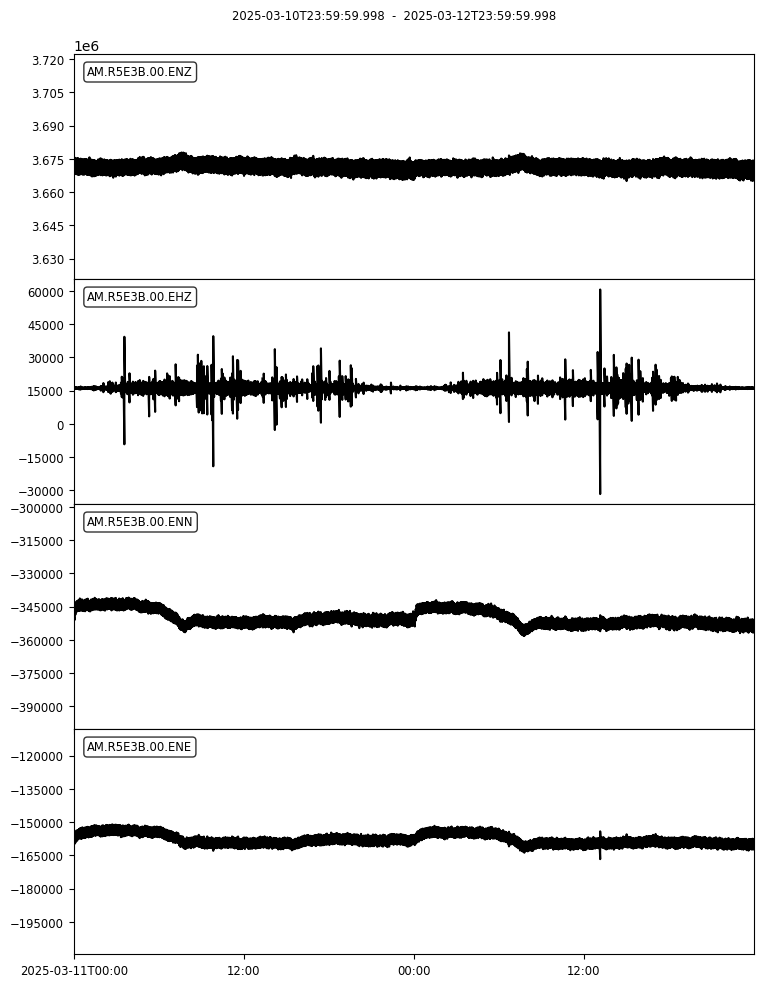

Converted waveform (acceleration):


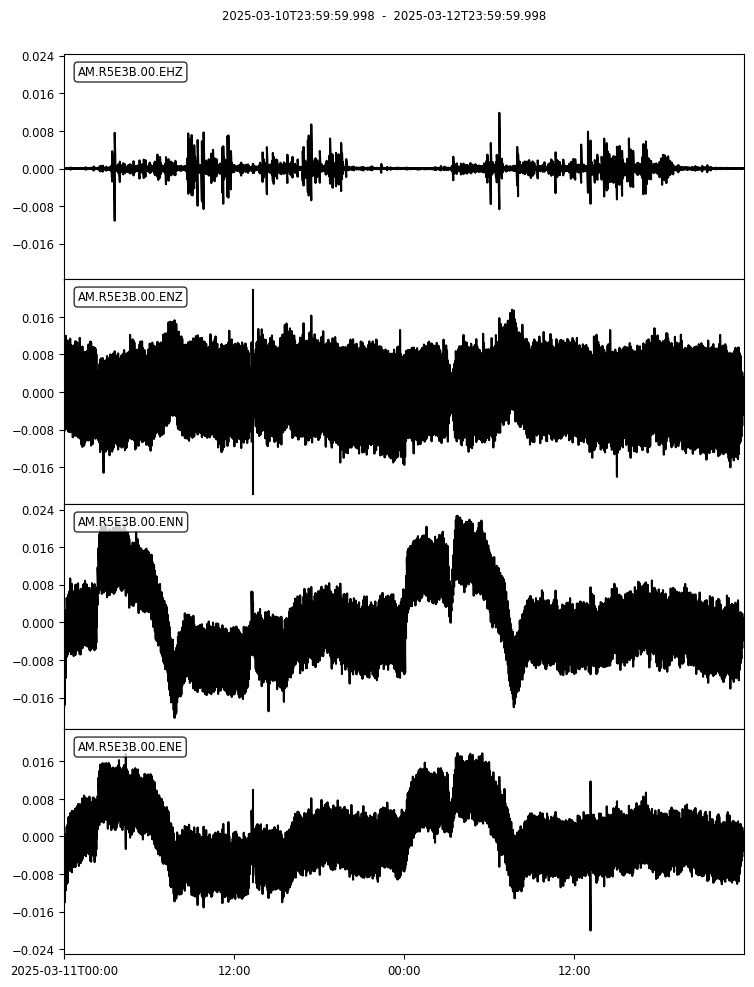

/opt/anaconda3/lib/python3.12/site-packages/obspy/io/mseed/core.py:773: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


Full converted waveform saved: R5E3B_full_2days.mseed
Trimmed 10-minute waveform saved: R5E3B_EQ_20250312T131039_10min.mseed


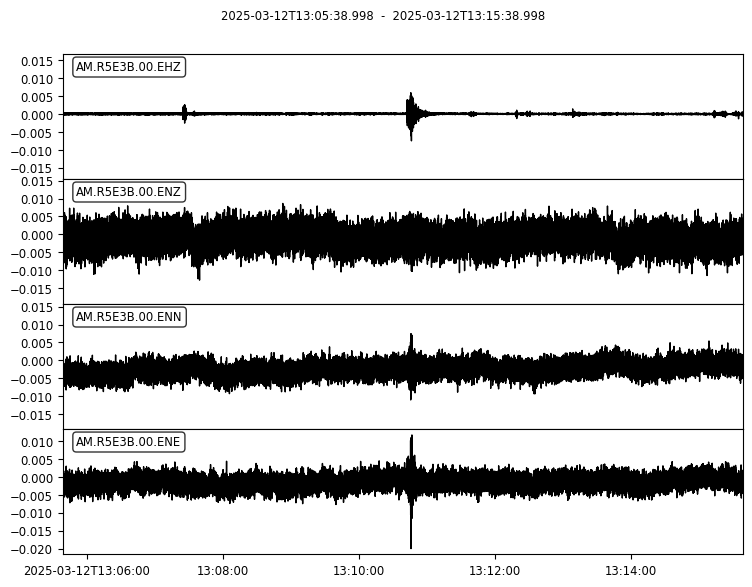


Trace Summary for Station R5E3B (10-minute trimmed window)
Channel: EHZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2025-03-12T13:05:38.998000Z
  End Time:   2025-03-12T13:15:38.998000Z
----------------------------------------
Channel: ENE
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2025-03-12T13:05:38.998000Z
  End Time:   2025-03-12T13:15:38.998000Z
----------------------------------------
Channel: ENN
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2025-03-12T13:05:38.998000Z
  End Time:   2025-03-12T13:15:38.998000Z
----------------------------------------
Channel: ENZ
  Sample Rate: 100.0 Hz
  Number of Samples: 60001
  Start Time: 2025-03-12T13:05:38.998000Z
  End Time:   2025-03-12T13:15:38.998000Z
----------------------------------------


In [863]:
# Download 2-day data
start = UTCDateTime(2025, 3, 11, 0, 0, 0)
stream_raw, stream_acc = download_station_data("R5E3B", start, channels=['EHZ', 'ENE', 'ENN', 'ENZ'])

# Set the earthquake time
eq_time = UTCDateTime(2025, 3, 12, 13, 10, 39)

# Trim and save 10 minutes around quake time
eq_stream = trim_and_save_waveform(stream_acc, "R5E3B", eq_time)

## Segmentation

### Waveform Segmentation
Each 10-minute MiniSEED file was segmented into non-overlapping windows of 2500 samples (25 s at 100 Hz).  
For each segment, three versions were saved:
1. **Raw** (2500 samples)  
2. **Mean-binned** (downsampled to 500 values)  
3. **Std-binned** (500 values of within-bin variability)  

These representations provide multiple input views (raw shape, average trend, variability) for downstream anomaly detection models.

In [1365]:
from obspy import read, Stream
from pathlib import Path
from glob import glob

def segment_long_binned_all_versions(mseed_file,
                                      raw_folder="segments_2500_raw",
                                      mean_folder="segments_2500_mean",
                                      std_folder="segments_2500_std",
                                      raw_segment_length=2500,
                                      binned_length=500):
    """
    Segments chunks of waveform (2500 samples at 100 Hz),
    and saves 3 versions:
    1. Raw segments (2500 samples)
    2. Binned mean (500 samples)
    3. Binned std (500 samples)

    Args:
        mseed_file (str): Path to 10-min .mseed file.
        raw_folder (str): Save folder for raw 2500-sample segments.
        mean_folder (str): Save folder for mean-binned segments (500).
        std_folder (str): Save folder for std-binned segments (500).
        raw_segment_length (int): Segment size before binning.
        binned_length (int): Number of bins to reduce to (500).
    """
    for folder in [raw_folder, mean_folder, std_folder]:
        os.makedirs(folder, exist_ok=True)

    stream = read(mseed_file)
    base = Path(mseed_file).stem

    for ch in set(tr.stats.channel for tr in stream):
        traces = stream.select(channel=ch)
        if not traces:
            continue
        merged = Stream(traces).merge(method=1, fill_value='interpolate')[0]
        data = merged.data

        n_segments = len(data) // raw_segment_length
        segments = [data[i * raw_segment_length:(i + 1) * raw_segment_length] for i in range(n_segments)]
        # shape: (n_segments, 2500)
        segments = np.array(segments)
        
        # Save raw segments
        raw_file = f"{raw_folder}/{base}_{ch}_segments.npy"
        np.save(raw_file, segments)
        print(f" Saved RAW segments: {raw_file}")

        # Binning factor
        factor = raw_segment_length // binned_length

        # Mean binning
        mean_binned = segments.reshape(n_segments, binned_length, factor).mean(axis=2)
        mean_file = f"{mean_folder}/{base}_{ch}_segments.npy"
        np.save(mean_file, mean_binned)
        print(f" Saved MEAN-binned segments: {mean_file}")

        # Std binning
        std_binned = segments.reshape(n_segments, binned_length, factor).std(axis=2)
        std_file = f"{std_folder}/{base}_{ch}_segments.npy"
        np.save(std_file, std_binned)
        print(f" Saved STD-binned segments: {std_file}")

# Run it on all 10-minute .mseed files
files = sorted(glob("*10min.mseed"))
print(f"Found {len(files)} files to process.\n")

for f in files:
    print(f" Processing {f}")
    try:
        segment_long_binned_all_versions(f)
    except Exception as e:
        print(f" Failed: {e}")

Found 22 files to process.

 Processing R0CEC_EQ_trimmed_10min.mseed
 Saved RAW segments: segments_2500_raw/R0CEC_EQ_trimmed_10min_EHZ_segments.npy
 Saved MEAN-binned segments: segments_2500_mean/R0CEC_EQ_trimmed_10min_EHZ_segments.npy
 Saved STD-binned segments: segments_2500_std/R0CEC_EQ_trimmed_10min_EHZ_segments.npy
 Saved RAW segments: segments_2500_raw/R0CEC_EQ_trimmed_10min_EHE_segments.npy
 Saved MEAN-binned segments: segments_2500_mean/R0CEC_EQ_trimmed_10min_EHE_segments.npy
 Saved STD-binned segments: segments_2500_std/R0CEC_EQ_trimmed_10min_EHE_segments.npy
 Saved RAW segments: segments_2500_raw/R0CEC_EQ_trimmed_10min_EHN_segments.npy
 Saved MEAN-binned segments: segments_2500_mean/R0CEC_EQ_trimmed_10min_EHN_segments.npy
 Saved STD-binned segments: segments_2500_std/R0CEC_EQ_trimmed_10min_EHN_segments.npy
 Processing R119F_EQ_20230921T132653_10min.mseed
 Saved RAW segments: segments_2500_raw/R119F_EQ_20230921T132653_10min_EHZ_segments.npy
 Saved MEAN-binned segments: segment

In [1367]:
# count all saved segment files in each different folders 

folders = ["segments_2500_raw", "segments_2500_mean", "segments_2500_std"]

for folder in folders:
    files = [f for f in os.listdir(folder) if f.endswith(".npy")]
    print(f" {folder}: {len(files)} segment files")

 segments_2500_raw: 70 segment files
 segments_2500_mean: 70 segment files
 segments_2500_std: 70 segment files


### Visualize Sample Segments

#### Func to Plot Random Segments from a .npy File

In [1378]:
import random

def plot_random_segments_from_folders(base_folders, num_segments =3):
    """
    Plot random segments from each folder to compare raw and binned versions.

    Parameters:
    - base_folders: list of folder names to compare (["segments_2500_raw", "segments_2500_mean", "segments_2500_std"])
    - num_segments: how many random segment files to display
    """
    # Pick random filenames from the raw folder (assuming all folders have same file names)
    raw_folder = base_folders[0]
    filenames = [f for f in os.listdir(raw_folder) if f.endswith(".npy")]
    sample_files = random.sample(filenames, min(num_segments, len(filenames)))

    for fname in sample_files:
        print(f"\n Viewing segment file: {fname}")
        plt.figure(figsize=(10 * len(base_folders), 8.5))

        for idx, folder in enumerate(base_folders):
            path = os.path.join(folder, fname)
            # shape: (n_segments, length)
            data = np.load(path)

            # Plot first few segments (first 3)
            for i in range(min(3, data.shape[0])):
                plt.subplot(3, len(base_folders), i * len(base_folders) + idx + 1)
                plt.plot(data[i])
                plt.title(f"{folder}\nSegment {i}")
                plt.xlabel("Sample Index")
                plt.ylabel("Amplitude")
                plt.grid(True)

        plt.tight_layout()
        plt.show()


 Viewing segment file: RE992_EQ_20240814T022653_10min_EHE_segments.npy


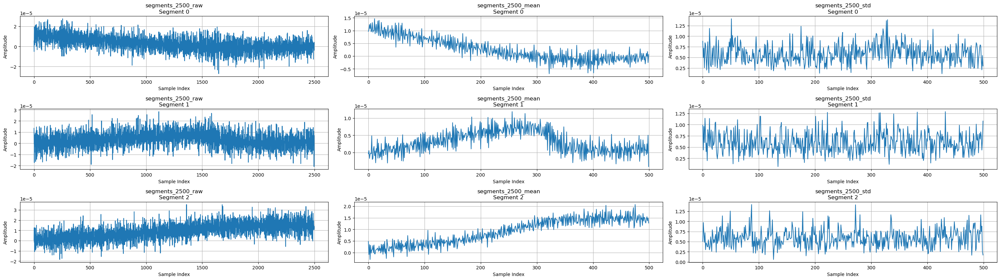


 Viewing segment file: R30A2_EQ_20250228T193324_10min_EHZ_segments.npy


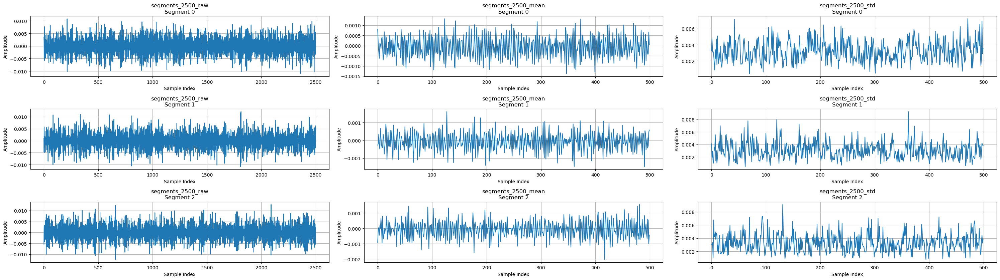


 Viewing segment file: RCC8D_EQ_trimmed_10min_EHN_segments.npy


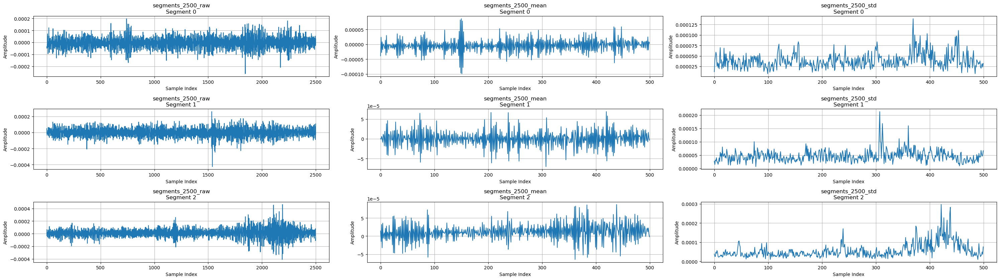

In [1380]:
plot_random_segments_from_folders(["segments_2500_raw", "segments_2500_mean", "segments_2500_std"], num_segments=3)

### Autoencoder Training

##### Load Non-Earthquake Segments Into a Single Dataset and Prepare for Training

In [1383]:
import os
import numpy as np
from sklearn.model_selection import train_test_split

# dir to load from
segment_dir = "segments_2500_std"  

# List of non-earthquake base filenames to match against
non_eq_filenames = [
    "RCC8D_EQ_trimmed_10min",
    "RD9D6_EQ_trimmed_10min",
    "R76F0_EQ_trimmed_10min",
    "R0CEC_EQ_trimmed_10min",
    "R5B93_EQ_trimmed_10min",
    "R119F_EQ_20230921T132653_10min",
    "R119F_EQ_20231017T080517_10min",
    "R1906_EQ_20230924T205322_10min",
    "R3949_EQ_20230721T031559_10min",
    "R9F13_EQ_20190410T161508_10min",
    "R7000_EQ_20250528T124439_10min",
    "R57CE_EQ_20240918T101939_10min"
]

# Filter and collect file paths
non_eq_files = []
for fname in os.listdir(segment_dir):
    for base in non_eq_filenames:
        if fname.startswith(base) and fname.endswith(".npy"):
            non_eq_files.append(os.path.join(segment_dir, fname))

print(f"Found {len(non_eq_files)} non-earthquake .npy segment files")

# Load and stack all segments
all_segments = []
for fname in non_eq_files:
    segments = np.load(fname)
    all_segments.append(segments)

X = np.vstack(all_segments).astype("float32")
print(f"Total segments loaded: {X.shape[0]} (each of length {X.shape[1]})")

# Per-segment normalization 
means = X.mean(axis=1, keepdims=True)
stds = X.std(axis=1, keepdims=True) + 1e-8
X_norm = (X - means) / stds

# Split into train/test
X_train, X_test = train_test_split(X_norm, test_size=0.2, random_state=42)

print(f"Training samples: {X_train.shape[0]}")
print(f"Testing samples: {X_test.shape[0]}")

Found 38 non-earthquake .npy segment files
Total segments loaded: 912 (each of length 500)
Training samples: 729
Testing samples: 183


#### Double check segment shape

In [1386]:
segment_dir = "segments_2500_std"

# Get only .npy files
segment_files = [f for f in os.listdir(segment_dir) if f.endswith(".npy")]

total_segments = 0

for fname in sorted(segment_files):
    path = os.path.join(segment_dir, fname)
    data = np.load(path)
    print(f"{fname}: shape = {data.shape}")
    total_segments += data.shape[0]

print(f"\n Total segments across all files: {total_segments}")

R0CEC_EQ_trimmed_10min_EHE_segments.npy: shape = (24, 500)
R0CEC_EQ_trimmed_10min_EHN_segments.npy: shape = (24, 500)
R0CEC_EQ_trimmed_10min_EHZ_segments.npy: shape = (24, 500)
R119F_EQ_20230921T132653_10min_EHE_segments.npy: shape = (24, 500)
R119F_EQ_20230921T132653_10min_EHN_segments.npy: shape = (24, 500)
R119F_EQ_20230921T132653_10min_EHZ_segments.npy: shape = (24, 500)
R119F_EQ_20231017T080517_10min_EHE_segments.npy: shape = (24, 500)
R119F_EQ_20231017T080517_10min_EHN_segments.npy: shape = (24, 500)
R119F_EQ_20231017T080517_10min_EHZ_segments.npy: shape = (24, 500)
R1906_EQ_20230924T205322_10min_EHE_segments.npy: shape = (24, 500)
R1906_EQ_20230924T205322_10min_EHN_segments.npy: shape = (24, 500)
R1906_EQ_20230924T205322_10min_EHZ_segments.npy: shape = (24, 500)
R30A2_EQ_20250228T193324_10min_EHE_segments.npy: shape = (24, 500)
R30A2_EQ_20250228T193324_10min_EHN_segments.npy: shape = (24, 500)
R30A2_EQ_20250228T193324_10min_EHZ_segments.npy: shape = (24, 500)
R3949_EQ_20230721T0

#### Func to view segments shape in pandas

In [1395]:
def view_all_segments_in_pandas(folder="segments_2500_mean"):
    """
    Load and display all .npy segment files in a folder as pandas DataFrames.
    Shows segment shapes and waveform data for inspection.

    Parameters:
    - folder: Path to the folder containing segment .npy files.
    """

    files = sorted([f for f in os.listdir(folder) if f.endswith(".npy")])
    
    if not files:
        print(f"No .npy files found in folder '{folder}'")
        return

    for f in files:
        path = os.path.join(folder, f)
        segments = np.load(path)
        df = pd.DataFrame(segments)
        print(f"\n {f} | shape: {df.shape}")
        display(df.head())

In [1397]:
view_all_segments_in_pandas(folder="segments_2500_mean")


 R0CEC_EQ_trimmed_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000002,-0.000009,0.000001,0.000011,-0.000001,-0.000009,0.000012,-0.000005,1.871939e-06,0.000007,-0.000029,-1.044681e-05,0.000024,0.000005,-0.000007,0.000025,-0.000003,-0.000005,-0.000005,1.248792e-05,-0.000012,-0.000001,-0.000017,0.000013,0.000011,-0.000025,0.000005,-0.000003,0.000008,-0.000014,0.000005,-0.000035,0.000052,-0.000004,-0.000010,0.000002,-5.588535e-07,-0.000003,-0.000006,0.000004,-0.000014,0.000010,-0.000026,0.000014,-3.915466e-06,-0.000003,-0.000013,0.000006,-0.000006,-0.000003,-0.000007,4.388106e-06,-0.000005,-0.000017,0.000016,-0.000004,-0.000016,0.000011,-6.845113e-06,-2.870373e-08,-0.000014,0.000013,-0.000013,6.336790e-07,0.000006,-0.000020,0.000007,0.000007,-0.000010,0.000002,-0.000006,-0.000002,-0.000001,-0.000007,-2.890255e-08,-0.000006,6.817077e-06,-0.000013,0.000003,-0.000003,-0.000011,-0.000002,0.000011,-3.994649e-06,-7.885889e-07,-0.000025,0.000010,0.000003,0.000014,-1.751923e-05,0.000001,-0.000006,-3.834874e-07,-0.000001,-0.000001,-0.000002,-0.000005,1.651170e-06,1.328981e-06,7.685494e-07,-0.000012,4.215750e-06,-1.145503e-05,-0.000003,2.909051e-06,-0.000006,-0.000002,-0.000004,-0.000006,0.000010,-0.000009,-9.155404e-07,-0.000007,-0.000002,-0.000005,-0.000003,-0.000001,-6.040500e-06,-6.952590e-06,0.000002,-0.000010,-0.000003,0.000002,-0.000002,-0.000005,-0.000009,0.000002,-0.000012,-0.000007,0.000007,-0.000007,0.000007,-9.908053e-06,-0.000003,-0.000007,-0.000001,-9.132643e-07,-5.186603e-07,-0.000011,0.000008,-5.299817e-07,-0.000025,2.265528e-05,-0.000003,-0.000031,-0.000011,0.000027,-0.000007,-0.000022,0.000015,-0.000009,-0.000009,0.000002,-0.000003,-0.000011,-0.000007,0.000003,0.000008,-0.000018,-0.000016,0.000013,-0.000010,-0.000006,4.693423e-07,-0.000003,-0.000024,0.000006,0.000018,-0.000030,0.000022,-0.000021,0.000002,0.000004,0.000005,-0.000013,-4.494846e-06,-0.000007,0.000005,-0.000003,-0.000003,-0.000003,0.000004,-0.000010,0.000001,-0.000011,8.185257e-08,-0.000012,0.000008,-0.000007,-0.000006,0.000002,-8.159972e-07,-0.000005,-0.000004,0.000003,7.015269e-07,-0.000010,2.881631e-07,0.000011,9.072697e-07,-0.000013,-0.000002,0.000008,-0.00000


 R0CEC_EQ_trimmed_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000017,-0.000020,-0.000022,0.000004,-2.246906e-05,-0.000005,-1.101479e-05,-7.064602e-06,-0.000013,-0.000021,8.818532e-06,-0.000004,-2.346931e-06,-0.000023,-0.000045,0.000019,-0.000019,2.540027e-05,-0.000042,-0.000011,-0.000013,0.000018,-2.239807e-05,-0.000011,-0.000004,-6.300075e-06,-0.000015,0.000005,-0.000025,0.000005,-0.000039,0.000017,-0.000009,-0.000012,-0.000008,-0.000011,-0.000009,-0.000019,-0.000007,-0.000022,0.000005,-0.000020,-8.669521e-06,-0.000004,-0.000012,-0.000017,-0.000013,-1.042124e-05,-0.000012,-0.000011,-0.000017,-0.000004,-1.589304e-05,-0.000011,-0.000009,-8.660729e-06,0.000004,-0.000027,0.000005,-0.000013,0.000004,-0.000018,-0.000002,-0.000014,-0.000012,-0.000012,9.182877e-07,-0.000009,-2.132761e-06,-1.972096e-05,2.654217e-06,-0.000015,-0.000003,-0.000016,-5.163856e-08,-0.000024,0.000007,-0.000025,1.484283e-05,-0.000024,0.000003,-1.797998e-05,-9.306027e-06,-0.000005,-5.864472e-06,-0.000017,-0.000016,-0.000010,-1.365989e-05,-0.000002,-0.000014,-0.000014,-0.000006,-0.000009,-0.000003,-0.000016,-0.000004,-0.000015,-0.000002,-0.000016,-0.000004,-0.000017,-0.000004,-0.000012,-0.000007,-0.000018,0.000002,-0.000017,-0.000004,-1.533728e-05,-1.046465e-05,-0.000010,-0.000007,-0.000020,-0.000009,-0.000011,-9.932130e-06,-0.000014,-0.000011,-1.187972e-05,-0.000014,-0.000010,-0.000012,-8.599870e-06,-0.000023,-5.729792e-07,-0.000022,-1.898578e-06,-0.000025,-0.000005,-0.000006,-0.000036,-3.447629e-06,-0.000014,-8.683286e-08,-0.000013,-0.000004,-0.000011,-0.000007,-0.000029,1.808735e-05,-0.000027,-0.000015,-0.000015,-0.000021,0.000005,-0.000014,-6.868327e-06,-0.000001,-0.000022,-0.000011,-1.272446e-05,-0.000005,-0.000014,-0.000006,-0.000017,-3.292630e-07,-1.360900e-05,-0.000013,-0.000009,-0.000005,-0.000021,-0.000007,-0.000007,-0.000017,-0.000017,0.000009,-0.000042,0.000025,-0.000040,1.745198e-05,-0.000027,-2.506753e-07,-0.000020,-0.000010,-0.000011,-0.000007,-1.509047e-05,-1.052185e-05,-1.087708e-05,-1.291409e-05,-5.589792e-06,-0.000017,-0.000003,-0.000016,-0.000019,0.000002,-0.000018,-0.000015,-0.000014,-0.000012,-0.000009,-1.379712e-05,-0.000012,-2.101833e-05,-


 R0CEC_EQ_trimmed_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000034,-0.000036,0.000034,-8.730431e-06,-0.000005,-1.616930e-07,-1.835311e-06,0.000007,0.000006,-0.000005,7.254022e-06,-0.000003,-0.000017,0.000053,3.355427e-06,-0.000055,5.285636e-05,-0.000027,0.000006,9.954961e-07,0.000022,-0.000038,0.000031,3.903004e-06,-0.000015,0.000020,-1.649098e-07,-0.000024,0.000021,-1.289256e-06,0.000020,-0.000011,-0.000003,-0.000016,-7.290731e-07,7.984647e-07,-4.378721e-07,3.622590e-07,0.000010,-5.069492e-07,-0.000015,0.000006,2.839902e-06,-0.000009,-2.909862e-07,-0.000003,0.000004,-0.000006,-0.000002,-0.000003,0.000010,-1.639011e-05,0.000002,2.310085e-05,-0.000013,3.142713e-07,0.000003,0.000007,-0.000009,0.000006,0.000004,4.706227e-07,0.000009,0.000007,-0.000009,1.821940e-05,-1.364085e-06,-0.000010,0.000015,0.000003,0.000004,5.023590e-06,-0.000011,0.000014,-0.000007,-0.000003,-0.000004,0.000006,-0.000001,-0.000002,0.000005,-9.141608e-07,-0.000004,-0.000017,0.000007,0.000015,-8.164660e-06,-1.982480e-06,-0.000008,-7.328543e-06,4.597441e-06,8.311100e-07,0.000003,1.577425e-06,-6.643091e-06,-0.000008,-0.000002,0.000003,-6.494087e-06,0.000008,0.000012,-3.284223e-06,-0.000002,0.000003,-0.000003,1.005579e-05,-3.679169e-07,0.000004,-0.000003,-0.000004,7.113124e-06,-1.353569e-07,0.000004,1.620020e-07,1.683355e-05,0.000005,-0.000004,0.000010,5.219845e-07,0.000017,0.000010,0.000007,0.000003,0.000006,0.000003,0.000022,4.329797e-06,-5.008689e-06,0.000017,0.000011,-0.000005,2.304983e-05,-0.000006,0.000016,-0.000010,0.000002,-0.000011,0.000015,1.062847e-06,0.000004,-1.641656e-05,0.000008,-0.000019,0.000014,0.000021,-2.569111e-06,-0.000018,0.000003,0.000009,-1.532865e-05,7.367456e-07,0.000004,-0.000008,-0.000003,-0.000005,4.456863e-07,-0.000016,-0.000005,0.000002,0.000004,-0.000018,0.000005,-0.000007,6.765887e-07,-0.000002,0.000019,-0.000012,-5.424469e-06,0.000002,4.818820e-07,-8.442946e-07,0.000008,-0.000023,0.000007,0.000006,1.373908e-05,-7.313752e-07,0.000003,-0.000005,-3.699323e-07,0.000008,-0.000004,0.000003,-0.000001,0.000005,0.000006,-9.868419e-07,0.000005,-7.210462e-07,0.000007,0.000003,0.000001,4.731858e-07,0.000004,3.444049e-06,0.000001,0.000005,1.


 R119F_EQ_20230921T132653_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000026,-0.000028,-0.000053,-0.000023,-0.000029,-0.000036,-0.000039,-0.000016,-0.000017,-0.000026,-0.000051,-0.000037,-0.000028,-0.000013,-0.000043,-0.000035,-0.000022,-0.000026,-0.000037,-0.000024,-0.000026,-0.000039,-0.000030,-0.000029,-0.000039,-0.000042,-0.000029,-0.000013,-0.000042,-0.000032,-0.000054,-0.000016,-0.000058,-0.000042,-0.000009,-0.000045,-0.000043,-0.000032,-0.000007,-0.000053,-0.000032,-0.000055,-0.000048,-0.000017,-0.000026,-0.000052,-0.000045,-0.000054,-0.000035,-0.000035,-0.000043,-0.000028,-0.000054,-0.000033,-0.000034,-0.000046,-0.000038,-0.000064,-0.000023,-0.000030,-0.000044,-0.000042,-0.000033,-0.000066,-0.000039,-0.000013,-0.000050,-0.000045,-0.000051,-0.000042,-0.000041,-0.000032,-0.000049,-0.000034,-0.000051,-0.000035,-0.000023,-0.000038,-0.000054,-0.000044,-0.000032,-0.000029,-0.000049,-0.000016,-0.000072,-0.000035,-0.000030,-0.000029,-0.000033,-0.000028,-0.000044,-0.000026,-0.000033,-0.000051,-0.000025,-0.000044,-0.000031,-4.969063e-05,-0.000017,-0.000025,-0.000066,-0.000027,-0.000033,-0.000030,-0.000041,-0.000060,-0.000013,-0.000028,-0.000058,-0.000042,-0.000025,-0.000040,-0.000024,-0.000053,-0.000055,-0.000051,-0.000027,-0.000027,-0.000058,-0.000055,-0.000036,-0.000040,-0.000051,-0.000033,-0.000037,-0.000031,-0.000078,-0.000047,-4.531257e-05,-0.000035,-0.000063,-0.000031,-0.000047,-0.000044,-5.654547e-05,-0.000046,-0.000052,-0.000052,-0.000030,-0.000070,-0.000060,-0.000033,-0.000036,-0.000046,-0.000033,-0.000059,-0.000052,-0.000047,-0.000048,-0.000044,-0.000049,-0.000036,-0.000042,-0.000059,-0.000055,-0.000056,-0.000053,-0.000023,-0.000030,-0.000072,-0.000056,-0.000043,-0.000025,-0.000065,-0.000038,-0.000044,-0.000052,-0.000058,-0.000042,-0.000042,-0.000042,-0.000055,-0.000050,-0.000041,-0.000022,-0.000052,-0.000069,-0.000036,-0.000051,-0.000032,-0.000052,-0.000058,-0.000054,-0.000044,-0.000038,-0.000036,-0.000054,-0.000064,-0.000043,-5.464806e-05,-0.000033,-0.000058,-0.000042,-0.000036,-0.000062,-0.000045,-0.000043,-0.000060,-0.000054,-0.000073,-0.000044,-0.000041,-0.000061,-0.000046,-0.000048,-0.000048,-0.000046,-0.000052,-0.000029,-


 R119F_EQ_20230921T132653_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000084,-0.000050,-0.000034,-0.000078,-0.000097,-0.000057,-0.000060,-0.000060,-0.000078,-0.000069,-0.000060,-0.000067,-0.000050,-0.000051,-0.000070,-0.000050,-0.000093,-0.000068,-0.000038,-0.000086,-0.000033,-0.000074,-0.000052,-0.000033,-0.000061,-0.000078,-0.000069,-0.000066,-0.000058,-0.000053,-0.000047,-0.000059,-0.000053,-0.000057,-0.000060,-0.000047,-0.000054,-0.000028,-0.000059,-0.000052,-0.000065,-0.000044,-0.000093,-0.000057,-0.000028,-0.000062,-0.000056,-0.000042,-0.000040,-0.000067,-0.000069,-0.000046,-0.000025,-0.000073,-0.000054,-0.000046,-0.000061,-0.000063,-0.000044,-0.000063,-0.000045,-0.000056,-0.000057,-0.000039,-0.000056,-0.000055,-0.000060,-0.000071,-0.000066,-0.000051,-0.000027,-0.000068,-0.000048,-0.000068,-0.000038,-0.000081,-0.000056,-0.000068,-0.000072,-0.000049,-0.000050,-0.000047,-0.000057,-0.000082,-0.000049,-0.000059,-0.000076,-0.000053,-0.000059,-0.000060,-0.000075,-0.000038,-0.000053,-0.000077,-0.000064,-0.000055,-0.000040,-0.000078,-0.000042,-0.000048,-0.000058,-0.000084,-0.000056,-0.000049,-0.000058,-0.000028,-0.000055,-0.000066,-0.000051,-0.000070,-0.000057,-0.000042,-0.000059,-0.000034,-0.000073,-0.000050,-0.000065,-0.000055,-0.000051,-0.000028,-0.000080,-0.000031,-0.000059,-0.000042,-0.000079,-0.000048,-0.000035,-0.000059,-0.000058,-0.000043,-0.000044,-0.000056,-0.000051,-0.000047,-0.000058,-0.000053,-0.000040,-0.000037,-0.000047,-0.000085,-0.000040,-0.000048,-0.000042,-0.000029,-0.000052,-0.000041,-0.000061,-0.000054,-0.000050,-0.000044,-0.000034,-0.000061,-0.000057,-0.000052,-0.000048,-0.000038,-0.000037,-0.000030,-0.000087,-0.000006,-0.000090,-0.000048,-0.000035,-0.000053,-0.000039,-0.000046,-0.000037,-0.000044,-0.000061,-0.000052,-0.000048,-0.000038,-0.000055,-0.000033,-0.000050,-0.000057,-0.000060,-0.000057,-0.000031,-0.000046,-0.000060,-0.000040,-0.000039,-0.000064,-0.000053,-0.000065,-0.000056,-0.000046,-0.000051,-0.000073,-0.000041,-0.000065,-0.000057,-0.000059,-0.000043,-0.000064,-0.000076,-0.000042,-0.000058,-0.000046,-0.000073,-0.000066,-0.000053,-0.000055,-0.000048,-0.000060,-0.000064,-0.000050,-0.000058,-0.000051,-0.0000


 R119F_EQ_20230921T132653_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000018,-0.000026,-0.000048,0.000049,-0.000004,-0.000080,-0.000005,-0.000010,0.000062,-0.000023,0.000044,-0.000037,-0.000042,-0.000038,0.000005,0.000043,-0.000013,-0.000039,0.000040,-0.000034,-0.000055,0.000089,-0.000021,-0.000107,-0.000023,0.000058,0.000028,-0.000082,0.000045,-0.000002,0.000048,-0.000066,-0.000048,0.000046,-0.000028,6.096220e-07,-0.000002,0.000053,-0.000050,-0.000096,0.000074,-0.000035,0.000022,-0.000025,-0.000019,0.000019,-0.000026,-0.000026,0.000045,0.000063,-0.000041,-0.000029,0.000034,-0.000088,-0.000022,0.000072,-0.000004,-0.000008,-0.000056,-0.000020,0.000038,0.000038,0.000015,-0.000051,-0.000042,0.000045,-0.000148,-0.000003,0.000082,-0.000018,-0.000081,0.000093,0.000048,-0.000049,-0.000029,-0.000010,-0.000033,0.000005,0.000074,-0.000016,-0.000019,-0.000049,-0.000021,0.000082,-0.000064,0.000071,-0.000104,-0.000036,0.000034,0.000005,0.000030,-0.000129,-0.000025,0.000096,0.000034,-0.000046,-0.000048,0.000006,-0.000078,0.000012,0.000009,-0.000017,0.000005,0.000029,0.000044,-0.000044,-0.000022,0.000008,-0.000024,0.000076,-0.000114,0.000023,0.000031,-0.000089,-0.000035,0.000098,0.000025,0.000003,-0.000019,-0.000012,-0.000036,0.000011,-0.000008,-0.000043,0.000043,0.000038,-8.495391e-05,0.000024,0.000062,-0.000143,0.000156,0.000011,-0.000083,-0.000057,0.000014,0.000017,-0.000014,-0.000080,0.000021,0.000066,-0.000016,-0.000067,0.000054,-0.000091,0.000019,0.000028,1.826677e-07,-0.000017,0.000030,-0.000051,0.000011,0.000060,-0.000028,-0.000071,0.000053,-0.000032,0.000029,-0.000047,-0.000007,-0.000018,0.000021,0.000028,-0.000065,-0.000065,0.000058,0.000010,0.000009,0.000014,-0.000081,-0.000055,0.000017,0.000011,-0.000036,0.000039,0.000022,-0.000004,0.000045,-0.000063,-0.000056,0.000044,-0.000046,0.000052,0.000021,-0.000088,0.000057,-0.000070,-0.000012,-0.000031,0.000063,-0.000058,0.000049,0.000059,-0.000068,0.000046,-0.000042,-0.000076,6.154846e-07,0.000023,0.000049,-0.000042,-0.000041,-0.000009,-0.000037,0.000090,-0.000018,-0.000049,9.929209e-07,0.000033,0.000020,-0.000037,0.000033,-0.000042,-0.000026,0.000080,0.000044,-0.000105,-0.000014,0.000042,-0.00004


 R119F_EQ_20231017T080517_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000165,0.000162,0.000157,0.000113,0.000128,0.000166,0.000166,0.000159,0.000130,0.000170,0.000104,0.000162,0.000186,0.000127,0.000131,0.000207,0.000107,0.000164,0.000114,0.000162,0.000161,0.000213,0.000152,0.000132,0.000114,0.000157,0.000193,0.000166,0.000140,0.000186,0.000147,0.000125,0.000148,0.000190,0.000175,0.000144,0.000155,0.000157,0.000158,0.000211,0.000158,0.000145,0.000183,0.000161,0.000133,0.000187,0.000176,0.000157,0.000141,0.000196,0.000263,0.000112,0.000152,0.000169,0.000154,0.000184,0.000217,0.000190,0.000132,0.000165,0.000184,0.000187,0.000189,0.000153,0.000182,0.000228,0.000151,0.000130,0.000163,0.000229,0.000273,0.000119,0.000116,0.000238,0.000213,0.000153,0.000184,0.000209,0.000216,0.000140,0.000160,0.000246,0.000209,0.000153,0.000203,0.000204,0.000198,0.000214,0.000160,0.000205,0.000210,0.000187,0.000185,0.000169,0.000214,0.000210,0.000217,0.000243,0.000150,0.000172,0.000233,0.000185,0.000145,0.000239,0.000158,0.000242,0.000207,0.000187,0.000142,0.000231,0.000239,0.000162,0.000153,0.000231,0.000181,0.000197,0.000211,0.000279,0.000113,0.000178,0.000181,0.000255,0.000233,0.000195,0.000162,0.000200,0.000194,0.000162,0.000225,0.000288,0.000185,0.000124,0.000166,0.000272,0.000256,0.000211,0.000173,0.000171,0.000218,0.000202,0.000232,0.000287,0.000214,0.000098,0.000239,0.000211,0.000302,0.000167,0.000169,0.000210,0.000208,0.000225,0.000238,0.000260,0.000203,0.000135,0.000259,0.000234,0.000234,0.000223,0.000198,0.000245,0.000195,0.000205,0.000273,0.000246,0.000200,0.000201,0.000250,0.000239,0.000241,0.000220,0.000249,0.000241,0.000185,0.000226,0.000289,0.000231,0.000206,0.000216,0.000265,0.000227,0.000238,0.000243,0.000241,0.000249,0.000242,0.000223,0.000254,0.000214,0.000257,0.000232,0.000262,0.000194,0.000264,0.000217,0.000231,0.000243,0.000280,0.000243,0.000192,0.000209,0.000226,0.000262,0.000283,0.000281,0.000176,0.000204,0.000211,0.000260,0.000269,0.000223,0.000244,0.000217,0.000222,0.000216,0.000246,0.000277,0.000221,0.000209,0.000204,0.000230,0.000259,0.000311,0.000215,0.000201,0.000230,0.000229,0.000193,0.000270,0.000294,0.000230,0.000186,0.000233,0


 R119F_EQ_20231017T080517_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,1.256699e-04,0.000126,0.000176,0.000168,0.000176,0.000164,0.000110,1.239912e-04,0.000142,0.00016,0.000184,0.000180,0.000075,0.000168,1.638308e-04,0.000141,0.000110,0.000156,0.000204,0.000062,0.000177,0.000136,0.000112,0.000142,0.000156,0.000173,1.136760e-04,0.000154,0.000079,0.000190,0.000092,0.000138,0.000174,0.000175,0.000077,0.000142,0.000147,0.000145,0.000097,0.000149,0.000154,0.000129,0.000086,0.000181,0.000048,0.000242,0.000115,0.000107,0.000108,0.000121,0.000142,0.000145,0.000101,0.000126,0.000134,0.000146,0.000116,0.000162,0.000109,0.000118,0.000065,0.000182,0.000157,0.000116,0.000112,0.000152,0.000106,0.000159,0.000113,0.000122,0.000163,0.000114,0.000069,0.000164,0.000120,0.000140,0.000145,0.000090,0.000158,0.000076,0.000208,0.000053,0.000102,0.000154,0.000150,0.000113,0.000074,0.000172,0.000126,0.000078,0.000162,0.000115,0.000123,0.000096,0.000131,0.000104,0.000106,0.000119,0.000154,0.000106,0.000104,0.000131,0.000117,0.000130,1.291428e-04,0.000083,0.000127,0.000146,0.000121,0.000126,1.033707e-04,0.000086,0.000136,0.000133,0.000126,0.000139,0.000126,0.000081,0.000135,0.000145,0.000097,0.000102,1.287325e-04,0.000128,0.000165,0.000101,0.000090,0.000131,0.000130,0.000084,0.000111,0.000178,0.000099,0.000073,0.000167,0.000082,0.000122,1.152088e-04,0.000166,0.000065,0.000125,0.000090,0.000129,0.000116,0.000117,0.000115,0.000103,0.000139,0.000094,0.000085,0.000150,0.000117,0.000088,0.000102,0.000125,0.000137,0.000104,0.000098,0.000135,0.000051,0.000162,0.000115,0.000134,0.000108,0.000100,1.021204e-04,0.000109,0.000139,0.000095,0.000150,0.000109,0.000129,0.000098,0.000139,0.000164,0.000091,0.000112,0.000132,0.000129,0.000080,0.000159,0.000155,0.000105,0.000133,0.000119,0.000154,0.000110,0.000084,0.000159,0.000139,0.000131,0.000148,0.000129,0.000117,0.000124,0.000118,0.000158,0.000133,0.000145,0.000087,0.000134,0.000170,0.000162,0.000102,0.000101,0.000148,0.000128,0.000161,0.000116,0.000136,0.000121,0.000108,0.000158,0.000159,0.000173,0.000093,0.000116,0.000142,0.000137,0.000129,0.000146,0.000151,0.000113,0.000122,0.000116,0.000170,0.000120,0.000159,1.581776e-04,0.00009


 R119F_EQ_20231017T080517_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000240,0.000036,-0.000121,-0.000084,-0.000027,0.000025,-0.000029,0.000066,0.000074,-0.000125,-0.000017,-0.000070,0.000047,0.000049,-0.000021,0.000098,-0.000069,0.000116,-0.000175,1.549953e-05,0.000018,0.000002,0.000101,-0.000112,-0.000016,-0.000010,0.000040,0.000091,-0.000057,-0.000051,0.000050,0.000013,-0.000073,-0.000068,0.000079,0.000065,0.000055,-0.000144,0.000207,0.000107,-0.000090,-0.000198,-0.000182,0.000119,0.000181,-0.000040,-0.000041,-0.000025,-0.000054,-8.331446e-08,0.000098,-0.000016,6.961527e-05,-0.000009,-0.000190,0.000067,-0.000105,0.000113,0.000094,-4.979676e-07,0.000060,-0.000077,0.000007,0.000021,0.000085,-0.000057,-0.000060,0.000009,-0.000020,0.000094,-0.000054,0.000008,0.000073,-0.000082,-0.000034,0.000241,-0.000140,0.000025,-0.000102,0.000118,-0.000162,0.000121,-0.000010,0.000031,-0.000109,0.000118,0.000024,-0.000032,0.000061,-0.000105,-0.000044,-0.000025,0.000075,-0.000015,-0.000027,0.000090,-0.000019,-0.000036,-0.000025,0.000039,-0.000026,-0.000047,0.000013,0.000053,-4.928227e-07,-0.000072,0.000109,-0.000146,-0.000027,0.000090,-0.000009,0.000033,-0.000014,-0.000065,0.000024,0.000030,0.000020,0.000129,-0.000317,-0.000025,0.000196,-0.000075,3.785634e-05,0.000104,-1.330434e-04,0.000066,0.000140,0.000015,-0.000220,-0.000025,0.000094,-0.000029,-0.000040,0.000097,-0.000249,0.000217,-0.000031,0.000017,0.000090,-0.000122,-0.000034,3.749149e-05,0.000032,0.000020,-0.000068,-0.000070,0.000218,-0.000174,-0.000082,0.000152,-0.000032,0.000080,-0.000012,-0.000103,-0.000011,-0.000184,0.000252,-0.000010,0.000147,-0.000188,-0.000115,0.000238,0.000049,-0.000080,0.000014,-0.000004,-0.000096,0.000036,-2.137640e-05,-0.000186,0.000269,-0.000021,0.000047,-0.000138,-0.000029,0.000063,-0.000106,0.000095,0.000011,0.000154,-1.762228e-04,0.000080,-0.000056,0.000019,-0.000051,0.000033,0.000057,-8.049035e-05,0.000019,-0.000088,0.000052,-0.000106,-0.000008,0.000010,0.000214,-0.000043,-0.000098,-0.000020,-0.000031,0.000018,0.000047,-0.000036,-0.000022,0.000111,-0.000027,-0.000141,0.000041,0.000057,0.000042,-0.000063,-0.000089,0.000039,0.000077,-0.000142,0.000014,0.000071,-0.0000


 R1906_EQ_20230924T205322_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000028,0.000089,0.000015,0.000108,0.000007,0.000056,0.000051,0.000024,0.000061,-0.000025,0.000009,9.552173e-05,0.000052,8.038409e-07,0.000061,9.934491e-05,-0.000037,0.000076,0.000017,0.000035,0.000097,0.000311,-0.000207,-0.000092,0.000127,-0.000020,0.000052,0.000047,0.000077,0.000060,0.000018,0.000046,1.078745e-04,-0.000033,-0.000036,0.000069,0.000053,0.000042,1.132836e-04,1.113382e-07,-0.000010,0.000032,0.000069,-0.000002,0.000016,0.000105,0.000041,0.000048,0.000035,0.000064,0.000046,-0.000079,0.000051,0.000152,-0.000051,0.000053,0.000022,7.416675e-05,0.000052,7.889504e-05,-0.000060,0.000088,0.000038,0.000065,-0.000014,0.000021,-0.000062,0.000099,0.000102,-0.000035,0.000075,0.000038,-0.000009,-0.000021,0.000071,0.000084,0.000064,0.000034,-0.000026,0.000010,0.000113,-0.000039,0.000065,0.000015,0.000068,0.000051,0.000005,0.000006,0.000072,0.000032,-0.000013,0.000073,0.000066,-0.000008,0.000032,0.000051,0.000003,0.000070,0.000013,0.000037,0.000099,2.390301e-05,-0.000029,-0.000009,0.000070,0.000065,-0.000030,-0.000005,0.000108,0.000037,0.000035,0.000060,0.000030,-0.000034,0.000051,3.981535e-05,0.000006,0.000023,0.000046,0.000012,0.000074,0.000017,-0.000072,0.000060,0.000071,0.000042,0.000109,-0.000008,0.000008,-0.000022,0.000119,0.000006,-0.000020,0.000076,-0.000017,0.000078,0.000012,0.000014,0.000032,0.000062,-0.000032,0.000031,0.000099,0.000017,0.000050,-0.000019,0.000046,0.000066,0.000053,-0.000054,0.000050,-0.000002,0.000120,0.000037,-0.000072,0.000002,0.000089,-0.000013,0.000064,-0.000036,0.000040,0.000084,-0.000012,0.000066,-0.000005,0.000038,0.000035,3.835472e-05,-0.000020,-0.000029,0.000067,-0.000006,0.000038,0.000077,-2.348054e-05,0.000028,0.000065,0.000002,9.884937e-05,2.543718e-05,-0.000021,0.000008,0.000078,0.000087,-0.000044,0.000003,-0.000013,0.000008,0.000098,0.000072,-0.000017,0.000076,0.000014,-0.000035,0.000069,0.000005,-0.000034,0.000099,0.000031,0.000012,0.000072,4.033629e-07,0.000023,0.000112,-0.000063,0.000094,0.000025,-0.000021,0.000061,0.000099,-0.000063,0.000022,0.000045,-0.000017,0.000078,0.000075,0.000012,-0.000064,0.000078,0.000092,-0.000004,0.


 R1906_EQ_20230924T205322_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000024,0.000095,0.000045,-0.000016,0.000065,0.000081,0.000023,0.000003,0.000047,0.000088,0.000054,0.000019,3.495976e-05,0.000038,0.000076,0.000025,0.000048,0.000061,0.000022,0.000076,-0.000010,0.000077,0.000010,0.000096,0.000059,0.000009,-0.000003,0.000071,0.000124,0.000044,-0.000021,0.000050,0.000088,0.000045,0.000021,0.000078,0.000032,0.000020,0.000063,0.000080,0.000044,0.000042,0.000020,0.000061,0.000061,0.000054,0.000012,0.000032,0.000085,0.000094,0.000007,0.000024,0.000056,0.000072,0.000012,0.000099,0.000029,0.000022,0.000074,0.000039,0.000083,-0.000002,0.000061,0.000065,0.000017,0.000079,0.000119,0.000015,-0.000008,0.000049,0.000053,0.000074,0.000070,3.088772e-07,0.000062,0.000100,-0.000002,0.000005,0.000125,0.000064,0.000016,0.000017,0.000054,0.000100,0.000050,-0.000029,0.000059,0.000130,0.000027,-0.000038,0.000123,0.000040,0.000050,0.000009,0.000055,0.000036,0.000081,0.000038,0.000034,0.000078,0.000032,0.000025,0.000061,0.000042,0.000034,0.000081,0.000077,0.000047,-0.000043,0.000054,0.000157,0.000028,-0.000039,0.000047,0.000152,-1.997480e-05,0.000033,0.000066,0.000065,0.000069,0.000029,-0.000020,0.000119,0.000103,-0.000029,0.000063,0.000033,0.000095,0.000059,0.000004,0.000031,0.000125,0.000031,-0.000011,0.000085,0.000067,0.000056,0.000011,0.000093,0.000032,0.000034,0.000081,0.000023,0.000098,0.000053,0.000015,0.000029,0.000078,0.000105,0.000015,6.314739e-07,0.000072,0.000146,-0.000017,0.000031,0.000091,0.000065,0.000011,0.000052,0.000075,0.000052,0.000054,0.000026,0.000100,-0.000017,0.000074,0.000095,0.000011,0.000040,0.000069,0.000057,0.000018,0.000095,0.000060,-0.000005,0.000087,-0.000003,0.000102,0.000033,0.000055,0.000003,0.000069,0.000109,0.000053,-0.000019,0.000045,0.000105,-0.000009,0.000054,0.000090,0.000045,0.000025,0.000025,0.000090,0.000049,0.000061,0.000008,0.000074,0.000080,-0.000004,0.000077,0.000035,0.000047,0.000065,0.000047,0.000054,0.000042,0.000035,0.000111,0.000032,0.000043,0.000050,0.000048,0.000068,0.000033,0.000046,0.000051,0.000051,0.000096,0.000034,0.000018,0.000040,0.000084,0.000072,0.000054,0.000032,0.000020,0.000068,0.000078,0.000025


 R1906_EQ_20230924T205322_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000007,-0.000009,1.376541e-06,0.000012,-0.000004,0.000011,9.835814e-06,-0.000006,0.000019,8.230058e-07,-0.000007,0.000032,6.495845e-06,-0.000024,0.000011,0.000021,-0.000014,0.000025,0.000002,-0.000013,-2.205382e-06,0.000041,-0.000027,-0.000016,0.000058,-0.000027,2.429290e-05,-0.000018,-0.000005,0.000038,0.000003,-0.000039,0.000052,-0.000015,-0.000026,0.000052,-0.000008,-0.000026,0.000031,-0.000015,-0.000023,0.000038,0.000008,-0.000025,0.000012,0.000035,-0.000028,0.000023,0.000003,-0.000015,0.000023,-0.000008,-0.000002,0.000028,-0.000015,-0.000018,0.000021,0.000018,-0.000035,3.546222e-05,0.000011,-0.000022,0.000027,-2.727018e-06,-0.000015,0.000034,-0.000015,0.000004,0.000047,-2.719663e-05,-0.000022,0.000027,-0.000005,0.000013,1.108985e-05,-0.000001,-2.007068e-07,0.000033,-0.000020,-1.225993e-05,0.000043,-0.000019,0.000029,-1.224155e-05,0.000005,0.000013,0.000008,-2.321910e-05,0.000033,-0.000001,-0.000011,4.522485e-07,3.548862e-05,-2.298660e-05,0.000012,0.000018,-0.000020,0.000022,0.000005,-0.000009,0.000019,-4.108187e-06,0.000018,-0.000004,0.000029,-1.105096e-05,-0.000007,0.000016,-8.517025e-07,7.946395e-07,0.000006,-0.000006,0.000034,-0.000017,0.000020,1.482744e-05,5.388005e-07,-7.834794e-06,1.321337e-05,-0.000009,0.000014,0.000025,-0.000033,0.000028,0.000020,-0.000035,2.590052e-05,-0.000018,0.000011,0.000025,9.259799e-06,-0.000019,0.000014,0.000011,-0.000020,0.000051,-0.000031,0.000023,-0.000006,0.000030,-0.000013,0.000019,0.000008,-0.000027,0.000015,-0.000006,0.000034,-0.000017,5.389907e-06,0.000026,0.000008,-0.000016,0.000013,0.000010,-0.000006,2.265320e-05,-0.000006,-0.000004,0.000016,0.000008,0.000025,-0.000015,0.000003,1.794891e-05,0.000007,0.000013,0.000006,8.474156e-07,0.000030,0.000003,-0.000021,0.000033,-0.000009,-0.000008,0.000045,0.000006,-1.568508e-05,0.000009,0.000016,-0.000007,0.000039,-0.000030,0.000007,0.000020,-8.542157e-06,0.000035,0.000001,-0.000003,0.000014,0.000031,-7.783547e-05,0.000075,0.000005,-0.000033,0.000046,0.000014,-0.000021,0.000025,9.228211e-06,-0.000011,0.000022,-0.000004,0.000022,0.000019,-0.000020,0.000007,0.000008,0.000025,-0.000020


 R30A2_EQ_20250228T193324_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000302,0.000176,0.000479,0.000265,0.000296,0.000145,-0.000053,0.000019,0.000408,0.000354,-0.000082,0.000430,0.000024,0.000080,0.000617,0.000092,-0.000082,0.000289,0.000416,0.000156,0.000322,-0.000067,0.000184,0.000292,0.000240,0.000136,0.000165,0.000195,0.000043,0.000252,0.000389,-0.000060,0.000576,-0.000199,0.000583,-0.000014,0.000107,0.000473,-0.000136,0.000477,0.000311,-0.000397,0.000576,0.000119,0.000185,0.000162,0.000204,0.000237,0.000179,0.000233,0.000090,0.000067,0.000496,0.000218,0.000131,5.112027e-07,0.000238,0.000188,0.000223,0.000344,0.000130,0.000065,0.000085,0.000233,0.000499,0.000106,-0.000122,0.000517,0.000002,0.000350,0.000113,0.000212,0.000022,0.000320,0.000233,0.000398,-0.000021,-0.000073,0.000192,0.000433,0.000222,0.000116,0.000321,0.000177,-0.000071,0.000312,0.000256,0.000254,0.000184,0.000186,0.000015,0.000324,0.000389,-0.000077,0.000198,0.000306,0.000054,0.000212,0.000205,0.000125,0.000332,-0.000155,0.000478,0.000373,0.000061,0.000218,0.000084,0.000238,0.000368,-0.000224,0.000573,0.000088,0.000081,0.000016,0.000396,0.000212,0.000255,0.000001,0.000237,0.000168,0.000314,0.000261,0.000034,0.000293,-0.000042,0.000446,0.000263,-0.000007,0.000177,0.000145,0.000495,-0.000066,-0.000026,0.000388,0.000035,0.000361,0.000364,0.000013,0.000224,0.000121,0.000217,0.000131,0.000421,0.000237,-0.000128,0.000396,0.000073,0.000263,-0.000022,0.000320,0.000166,0.000368,0.000076,0.000005,0.000135,0.000380,0.000261,0.000161,0.000060,0.000169,0.000358,0.000318,-0.000016,0.000110,0.000181,0.000294,0.000382,-0.000080,-0.000026,0.000266,0.000332,0.000347,0.000141,-0.000041,0.000189,0.000187,0.000553,0.000182,-0.000112,0.000268,0.000207,0.000174,0.000170,0.000181,0.000268,0.000010,0.000161,0.000421,0.000092,0.000013,0.000341,0.000119,0.000484,0.000124,0.000109,0.000151,0.000219,0.000207,0.000379,0.000101,-0.000117,0.000307,0.000145,0.000210,0.000334,-0.000017,0.000187,0.000204,0.000559,0.000064,-0.000156,0.000211,0.000448,0.000435,0.000080,-0.000125,0.000138,0.000411,0.000054,0.000404,-0.000043,0.000084,0.000177,0.000554,0.000039,0.000168,0.000205,0.000218,0.000182,0.000271,


 R30A2_EQ_20250228T193324_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000339,-0.000185,-0.000136,-0.000063,0.000358,-0.000603,-0.000141,-0.000255,0.000160,0.000167,-0.000472,-0.000281,-0.000027,-0.000336,0.000380,0.000028,-0.000428,-0.000318,-0.000166,0.000139,0.000076,-0.000476,0.000153,-0.000236,-0.000279,0.000062,-0.000016,-0.000386,-0.000026,-0.000129,0.000180,-0.000530,0.000181,-0.000438,0.000035,0.000095,-0.000283,-0.000009,-0.000298,-0.000221,0.000235,-0.000442,-0.000046,0.000020,-0.000184,-0.000069,-0.000272,0.000057,-0.000323,0.000080,-0.000077,-0.000154,-0.000164,-0.000162,-0.000182,-0.000042,-0.000073,0.000017,-0.000211,-0.000304,0.000020,-0.000058,-0.000194,-0.000067,-0.000047,0.000119,-0.000563,0.000090,-0.000348,0.000100,0.000135,-0.000105,-0.000507,-0.000076,-0.000091,0.000153,-0.000138,-0.000398,-0.000013,-0.000161,-0.000055,-0.000145,1.783911e-05,-0.000323,-0.000084,0.000040,-0.000184,-0.000215,0.000065,-0.000291,-0.000048,-0.000017,0.000135,-0.000429,-0.000287,0.000010,-0.000094,-0.000015,0.000045,-0.000432,0.000026,-0.000452,0.000191,-0.000034,-0.000339,-0.000021,0.000120,-0.000308,-0.000044,-0.000281,0.000082,-0.000258,0.000003,0.000106,-0.000491,-0.000177,-0.000019,0.000046,-0.000273,0.000118,-0.000060,-0.000350,-0.000296,0.000266,-0.000296,0.000024,-0.000108,-0.000164,-0.000030,-0.000229,-0.000182,-0.000081,-0.000148,0.000105,-0.000196,-0.000042,-0.000346,-0.000064,0.000074,-0.000216,-0.000012,-0.000064,-0.000369,0.000064,-0.000140,-2.345251e-07,-0.000371,0.000226,-0.000246,-0.000297,-0.000006,0.000023,-0.000165,-0.000094,-0.000067,0.000017,-0.000230,-0.000325,0.000212,-0.000355,0.000087,-0.000026,-0.000171,-0.000181,-0.000153,-0.000012,-0.000025,-0.000353,0.000223,-0.000309,-0.000260,0.000053,-0.000016,-0.000246,-0.000028,-0.000219,0.000213,-0.000424,-0.000030,0.000009,-0.000343,0.000037,0.000163,-0.000280,-0.000028,-0.000470,-0.000040,0.000087,-0.000028,-0.000080,-0.000466,-0.000061,0.000062,0.000038,-0.000107,-0.000345,-0.000057,0.000133,-0.000217,-0.000023,-0.000351,-0.000105,-0.000036,0.000287,-0.000250,-0.000555,0.000032,-0.000017,0.000039,0.000069,-0.000368,-0.000245,-0.000071,0.000227,-0.000178,-0.000203,-0


 R30A2_EQ_20250228T193324_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000800,0.000051,-0.000319,-0.000625,0.000121,0.000058,-0.000143,0.000323,0.000405,-0.000075,-0.000712,-0.000458,0.000679,-0.000406,-0.000434,0.000445,0.000353,-0.000612,-0.000138,-0.000404,0.000172,-0.000475,0.000518,0.000192,-0.000404,0.000273,-0.000165,-0.000537,0.000363,-0.000303,0.000090,-0.000524,0.000413,0.000650,-0.000986,-0.000469,0.000482,-0.000083,0.000100,-0.000188,-0.000149,-0.000244,-0.000590,0.000798,0.000228,-0.000928,0.000427,0.000214,-0.000994,0.000496,0.000486,-0.000132,-0.001112,0.000241,0.000261,-0.000568,0.000240,0.000595,-0.000833,-0.000537,0.000639,0.000330,-0.000608,0.000064,-0.000515,0.000445,-0.000422,0.000189,0.000289,-0.000453,0.000160,0.000264,-0.000289,-0.000604,0.000290,6.795518e-05,-0.000654,0.000770,0.000188,-0.000429,-0.000277,-0.000199,-0.000621,-0.000330,0.000765,0.000453,-0.000656,-0.000769,0.000651,0.000147,-0.000503,0.000253,-0.000356,-0.000449,0.000578,-0.000182,0.000745,-0.001040,0.000210,0.000536,-0.000820,0.000407,0.000143,-0.001197,-0.000359,0.000235,0.000610,-0.000376,-0.000294,0.000544,-0.000395,-0.000374,0.000909,0.000198,-0.000743,-0.000251,-0.000448,-0.000014,0.000480,-0.000313,0.000417,-0.000672,-0.000911,0.001320,0.000247,-0.001074,-0.000496,0.000518,0.000187,0.000332,-0.000375,-0.000511,0.000081,0.000314,0.000114,-0.000328,-0.000718,0.000466,-0.000392,0.000084,0.000894,-0.001006,-0.001107,0.001217,0.000134,-0.000245,-0.000537,0.000289,0.000182,-0.000680,0.000356,-0.000022,-0.000634,0.000208,0.000244,0.000269,-0.000435,-0.000357,0.000531,-0.000410,-0.000529,-0.000527,0.000361,0.000651,-0.000056,-0.000529,-0.000315,0.000038,0.000960,-0.000479,-0.000798,-0.000078,0.000820,-0.000199,-0.000388,-0.000659,-0.000394,0.000162,0.001025,-0.000338,-0.000799,0.000284,0.000913,-0.000211,-0.000923,0.000388,0.000443,-0.000947,0.000281,-0.000287,-0.000731,0.000109,0.000755,-0.000058,-0.001097,-0.000257,0.000823,-0.000251,-0.000586,0.000832,0.000167,-0.000555,-0.000217,0.000708,-0.000264,-0.001178,0.000396,0.000676,-0.000771,-0.000271,0.000312,0.000168,-0.000357,0.000076,-0.000097,-0.000319,-0.000594,0.000910,0.000271,-0.000465,-0.0001


 R3949_EQ_20230721T031559_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000080,0.000024,0.000039,0.000061,0.000065,0.000013,0.000057,0.000040,0.000066,0.000055,0.000015,0.000058,0.000041,0.000054,0.000048,0.000037,0.000048,0.000054,0.000029,0.000060,0.000042,0.000020,0.000064,0.000047,0.000031,0.000032,0.000070,0.000029,0.000016,0.000077,0.000024,0.000037,0.000042,0.000065,0.000018,0.000025,0.000070,0.000034,0.000022,0.000058,0.000034,0.000042,4.240063e-05,0.000031,6.806585e-05,0.000027,0.000016,6.472731e-05,0.000060,-0.000002,0.000069,0.000044,0.000008,0.000068,0.000052,0.000031,0.000004,0.000082,0.000057,1.524287e-05,0.000017,0.000077,6.013132e-05,-0.000019,0.000067,0.000060,0.000038,0.000009,0.000046,0.000070,0.000020,0.000016,0.000074,0.000028,0.000017,0.000049,0.000034,0.000033,0.000035,0.000036,0.000042,0.000024,0.000025,0.000053,0.000012,0.000058,0.000004,0.000041,0.000038,0.000011,0.000036,0.000049,0.000012,0.000024,0.000038,0.000026,0.000024,0.000042,0.000010,0.000035,0.000005,0.000045,0.000044,0.000005,2.028764e-05,0.000031,0.000036,0.000023,0.000018,0.000038,0.000007,0.000048,0.000019,0.000050,-0.000023,0.000046,0.000053,-0.000027,0.000059,0.000022,0.000017,0.000032,1.711101e-05,0.000045,0.000018,-0.000003,0.000065,0.000013,-0.000007,0.000061,0.000026,-0.000013,0.000049,0.000033,0.000018,0.000005,0.000044,3.845172e-05,-0.000006,0.000046,1.709785e-05,0.000045,0.000010,-8.219700e-07,0.000060,0.000057,-0.000020,0.000025,0.000032,0.000059,0.000014,0.000006,0.000038,0.000042,0.000013,0.000020,0.000033,0.000043,0.000015,0.000018,0.000052,0.000030,-0.000011,0.000059,0.000036,0.000003,0.000037,0.000030,0.000043,0.000013,0.000021,0.000053,0.000024,0.000014,0.000033,0.000040,0.000018,0.000043,0.000050,-1.682851e-05,0.000047,0.000049,0.000031,0.000012,0.000036,0.000046,0.000021,0.000032,0.000026,0.000045,0.000018,0.000029,0.000052,0.000030,-0.000007,6.124858e-05,0.000039,3.172693e-07,0.000057,0.000046,0.000006,0.000028,0.000050,0.000037,3.084159e-05,0.000010,0.000039,0.000057,0.000021,0.000015,0.000072,0.000012,0.000005,0.000063,0.000043,9.551604e-06,0.000024,0.000061,0.000023,0.000028,0.000064,-0.000007,0.000032,0.000071,0.000003,0.000032


 R3949_EQ_20230721T031559_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000064,-0.000018,-0.000050,-0.000093,-0.000025,-0.000035,-0.000082,-0.000052,-0.000023,-5.216012e-05,-0.000073,-0.000056,-0.000026,-0.000060,-0.000069,-0.000051,-0.000035,-0.000051,-0.000083,-0.000059,-0.000005,-0.000082,-0.000091,-0.000004,-0.000056,-0.000076,-0.000067,-0.000017,-0.000074,-0.000069,-0.000036,-0.000066,-0.000057,-0.000051,-0.000028,-0.000076,-0.000059,-0.000042,-0.000067,-0.000046,-0.000061,-0.000045,-0.000069,-0.000040,-0.000054,-0.000058,-0.000041,-0.000074,-0.000040,-0.000045,-0.000062,-0.000057,-4.076223e-05,-0.000072,-0.000035,-0.000049,-0.000078,-0.000044,-0.000053,-0.000041,-0.000073,-0.000054,-2.999925e-05,-0.000051,-0.000116,-0.000017,-0.000024,-9.262045e-05,-0.000058,-0.000049,-0.000053,-0.000056,-0.000083,-0.000049,-0.000014,-0.000080,-0.000073,-0.000045,-0.000051,-0.000052,-0.000082,-0.000035,-0.000040,-0.000097,-0.000033,-0.000064,-0.000050,-0.000062,-0.000051,-0.000060,-0.000045,-0.000077,-0.000038,-0.000057,-0.000027,-0.000090,-0.000071,-1.637335e-05,-0.000055,-0.000077,-0.000046,-0.000043,-0.000051,-0.000078,-0.000045,-0.000020,-0.000095,-0.000053,-0.000036,-0.000055,-0.000059,-7.196387e-05,-0.000034,-0.000037,-0.000051,-0.000063,-0.000090,0.000011,-0.000084,-0.000043,-0.000062,-0.000037,-0.000078,-0.000025,-0.000063,-0.000059,-0.000070,-0.000045,-0.000041,-0.000047,-6.410722e-05,-0.000069,-0.000043,-0.000040,-0.000055,-0.000062,-0.000054,-0.000074,-0.000005,-0.000077,-0.000041,-0.000076,-0.000026,-0.000082,-0.000034,-0.000059,-0.000054,-0.000073,-0.000015,-0.000066,-0.000070,-0.000053,-0.000048,-0.000031,-0.000079,-0.000063,-0.000048,-0.000042,-0.000064,-0.000062,-0.000055,-0.000053,-0.000048,-0.000064,-0.000066,-0.000028,-0.000072,-0.000060,-4.726378e-05,-0.000055,-0.000064,-0.000055,-0.000055,-0.000048,-0.000066,-0.000046,-0.000073,-0.000056,-0.000051,-0.000040,-0.000078,-0.000059,-0.000036,-0.000067,-0.000072,-0.000064,0.000009,-0.000112,-0.000062,-0.000042,-0.000051,-0.000063,-0.000078,-0.000033,-4.304640e-05,-0.000091,-0.000048,-0.000056,-0.000073,-0.000052,-0.000038,-0.000073,-0.000062,-0.000058,-0.000064,-0.000049,-5.537231e-05


 R3949_EQ_20230721T031559_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000018,-0.000010,-0.000044,0.000021,-0.000032,-0.000049,-0.000003,-0.000031,0.000010,-0.000041,-0.000005,-0.000028,-0.000013,-0.000036,-0.000022,-0.000039,-0.000003,-0.000029,-0.000022,-0.000036,-0.000010,-0.000017,-0.000027,-0.000015,-0.000042,-0.000020,-0.000010,-0.000027,-0.000006,-0.000043,-0.000001,-0.000042,-0.000016,-0.000006,-0.000034,0.000010,-0.000043,-0.000009,-0.000032,-0.000026,-0.000034,-0.000044,0.000021,-0.000026,-0.000015,-3.527264e-05,-0.000012,-0.000033,-0.000044,0.000008,-0.000045,-0.000014,-0.000023,-0.000026,-0.000025,-0.000007,-0.000048,-0.000006,-0.000037,3.812869e-07,-0.000016,-3.870989e-05,-9.666723e-06,-0.000039,-0.000014,-0.000034,-0.000015,-0.000012,-0.000046,-0.000018,-0.000025,-0.000018,-0.000015,-0.000030,-0.000027,-0.000010,-0.000028,-0.000038,-0.000003,-0.000036,-0.000008,-0.000019,-0.000021,-0.000036,-0.000010,-0.000041,-0.000008,-0.000037,-0.000035,-0.000012,-0.000041,0.000005,-0.000036,-0.000019,-0.000002,-0.000055,-0.000002,-0.000041,-0.000015,-0.000024,-0.000017,-0.000035,-1.160587e-05,-0.000015,-0.000031,-0.000023,-0.000013,-0.000048,-0.000004,-0.000039,-0.000009,-0.000046,-0.000013,-0.000037,-0.000010,7.390215e-07,-0.000039,-0.000036,-0.000023,-1.851611e-05,-0.000020,-0.000023,-0.000024,-0.000019,-0.000039,-0.000011,-0.000046,-0.000023,0.000003,-0.000045,-0.000017,-0.000014,-0.000034,-0.000039,-0.000016,-0.000015,-0.000050,-0.000028,-0.000013,0.000002,-0.000013,-0.000041,-0.000019,-0.000017,-0.000075,0.000005,-0.000040,-0.000004,-0.000030,-0.000017,-0.000028,-0.000039,-0.000017,-0.000023,-0.000017,-0.000037,-0.000037,-0.000002,-0.000046,-0.000007,-0.000034,0.000009,-0.000046,-0.000010,-0.000055,-0.000029,-0.000008,-0.000048,0.000002,-0.000046,-0.000006,-0.000030,-0.000029,-0.000022,-0.000027,-0.000017,-0.000030,-0.000013,-0.000056,0.000005,-0.000048,-0.000006,-0.000042,-0.000025,0.000007,-0.000042,-0.000039,-0.000024,-0.000042,0.000006,-0.000028,-0.000038,-0.000006,-0.000040,-0.000006,-0.000025,-0.000025,-0.000033,-0.000029,-0.000008,-0.000036,-0.000023,-0.000036,-0.000029,-0.000027,-0.000016,-0.000034,-0.000007,-0.000047,-0.00


 R47BB_EQ_20230722T164652_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000037,-0.000103,0.000019,-0.000002,-0.000092,-0.000008,0.000050,-0.000139,0.000010,-0.000041,0.000013,-0.000021,-0.000053,-0.000025,0.000015,-0.000049,0.000019,-0.000029,-0.000112,-0.000014,-0.000020,-0.000041,0.000006,-0.000046,-0.000030,-0.000008,-0.000030,-0.000027,-0.000052,0.000016,-0.000043,-0.000106,6.046457e-05,-0.000114,-0.000016,0.000011,-0.000009,-0.000052,-0.000032,0.000008,-0.000041,-0.000080,0.000033,-0.000019,-0.000090,-0.000038,-0.000037,-0.000024,0.000027,-0.000057,-0.000040,-0.000046,-0.000003,-0.000044,-0.000054,-9.327238e-07,-0.000106,0.000017,-0.000008,-0.000069,-0.000035,-0.000021,-0.000027,0.000001,-0.000095,0.000047,-0.000065,-0.000067,-0.000017,-3.599938e-05,-0.000035,-0.000037,0.000003,-0.000037,-0.000044,-0.000034,-0.000022,-0.000059,-0.000019,-0.000061,-0.000011,4.854756e-06,-0.000047,-0.000039,-0.000094,0.000034,-0.000067,-0.000034,-0.000041,-0.000021,-0.000019,-0.000051,-0.000014,0.000010,-0.000091,-0.000032,-0.000055,2.362920e-05,-0.000053,-0.000008,-0.000061,-0.000010,-0.000062,0.000040,-0.000127,0.000038,-0.000037,-0.000025,-0.000056,-0.000034,-0.000069,-0.000010,-0.000003,-1.591993e-05,-0.000098,0.000025,-0.000076,-9.048979e-06,-0.000041,-0.000017,-0.000028,-0.000086,-0.000046,0.000010,-0.000041,-0.000081,0.000049,-0.000059,-0.000070,0.000022,-0.000046,0.000010,-0.000102,-0.000036,-0.000024,-3.997157e-05,-0.000031,-0.000050,0.000042,-0.000065,-0.000060,0.000054,-0.000084,-0.000072,-0.000020,-0.000049,-5.130325e-06,-1.092860e-04,-0.000040,0.000069,-0.000087,-0.000064,0.000038,-0.000048,-0.000076,0.000007,-0.000059,-0.000002,-0.000135,0.000017,-0.000063,-0.000033,-0.000011,-0.000007,-0.000016,-0.000043,-8.222424e-05,-0.000008,-0.000056,-0.000022,-0.000024,-0.000014,-0.000121,0.000056,-0.000116,0.000043,-0.000053,-0.000013,-0.000049,-0.000062,-7.973022e-07,-7.454530e-05,-0.000022,-0.000037,-0.000040,5.888587e-07,-0.000061,-0.000077,0.000015,-0.000043,-0.000047,-0.000055,-0.000045,0.000008,-0.000014,-0.000085,0.000019,-0.000099,-0.000005,-0.000045,-0.000008,-0.000046,-0.000065,-0.000006,-0.000039,-0.000021,-0.000063,3.618651e-05,-0.000089


 R47BB_EQ_20230722T164652_10min_ENE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.008392,-0.007824,-0.010075,-0.004436,-0.007122,-0.009514,-0.004922,-0.003218,-0.005027,-0.005123,-0.003949,-0.004966,-0.006080,-0.006142,-0.003435,-0.003866,-0.005234,-0.005985,-0.009583,-0.006921,-0.003675,-0.009864,-0.006650,-0.008233,-0.010406,-0.005803,-0.004402,-0.005856,-0.007737,-0.006075,-0.007540,-0.009491,-0.007858,-0.005891,-0.007096,-0.007485,-0.005963,-0.005792,-0.004313,-0.007247,-0.006324,-0.004971,-0.005125,-0.005667,-0.003567,-0.005827,-0.003448,-0.001915,-0.006910,-0.008690,-0.006329,-0.005675,-0.006961,-0.006433,-0.006066,-0.004489,-0.004451,-0.005412,-0.007050,-0.006326,-0.005659,-0.006269,-0.006671,-0.006827,-0.008395,-0.007188,-0.005200,-0.005147,-0.006767,-0.007262,-0.001871,-0.004768,-0.006120,-0.006917,-0.008055,-0.005981,-0.004725,-0.005243,-0.004991,-0.004350,-0.006862,-0.005135,-0.005462,-0.006736,-0.007035,-0.005643,-0.005841,-0.007216,-0.005512,-0.002736,-0.004030,-0.004294,-0.001883,-0.006621,-0.004428,-0.005467,-0.006797,-0.006897,-0.006320,-0.006441,-0.005428,-0.007992,-0.004792,-0.009171,-0.005606,-0.005657,-0.005951,-0.005095,-0.006725,-0.004619,-0.007323,-0.002840,-0.007571,-0.004394,-0.006691,-0.005948,-0.004796,-0.005376,-0.006321,-0.006676,-0.007572,-0.003986,-0.003098,-0.002426,-0.008052,-0.003226,-0.006343,-0.009026,-0.004043,-0.005351,-0.007825,-0.003677,-0.004437,-0.003832,-0.007799,-0.003889,-0.008272,-0.004324,-0.005649,-0.005535,-0.006339,-0.006873,-0.009253,-0.004465,-0.004960,-0.006291,-0.002472,-0.002964,-0.004650,-0.003943,-0.006586,-0.004801,-0.004717,-0.003873,-0.005560,-0.005033,-0.005145,-0.005309,-0.003237,-0.000638,-0.004974,-0.006064,-0.004196,-0.008245,-0.001248,-0.007240,-0.007176,-0.005920,-0.005737,-0.006036,-0.003492,-0.008158,-0.005920,-0.004844,-0.006983,-0.007325,-0.004378,-0.006891,-0.005780,-0.006218,-0.004107,-0.003702,-0.004339,-0.008460,-0.005858,-0.003471,-0.005317,-0.001929,-0.006108,-0.005555,-0.004642,-0.002302,-0.006941,-0.006972,-0.004311,-0.005039,-0.005401,-0.004580,-0.002110,-0.005282,-0.006717,-0.006976,-0.005678,-0.003190,-0.005016,-0.005033,-0.002685,-0.005032,-0.003528,-0.008747,-0.0065


 R47BB_EQ_20230722T164652_10min_ENN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.005145,-0.007252,-0.007646,-0.007150,-0.008200,-0.009950,-0.006326,-0.006999,-0.010943,-0.010545,-0.005032,-0.009598,-0.011398,-0.007491,-0.006968,-0.007900,-0.011007,-0.008221,-0.008763,-0.007776,-0.005394,-0.007908,-0.009393,-0.010096,-0.008190,-0.005533,-0.005699,-0.007391,-0.009856,-0.007218,-0.007304,-0.008997,-0.008490,-0.013044,-0.009143,-0.009274,-0.007817,-0.008045,-0.006051,-0.009511,-0.011464,-0.009418,-0.008397,-0.006668,-0.006970,-0.007240,-0.003038,-0.006863,-0.009682,-0.009101,-0.010601,-0.008367,-0.009057,-0.009996,-0.006713,-0.007455,-0.010783,-0.010239,-0.008423,-0.005011,-0.007725,-0.003895,-0.005341,-0.007274,-0.006162,-0.007362,-0.005436,-0.006030,-0.005332,-0.005399,-0.005279,-0.005582,-0.007594,-0.007969,-0.008132,-0.005471,-0.005569,-0.006079,-0.004264,-0.004805,-0.009675,-0.008387,-0.006018,-0.011105,-0.009370,-0.008577,-0.006619,-0.007931,-0.010572,-0.003227,-0.008401,-0.006313,-0.010002,-0.007093,-0.008476,-0.007734,-0.007223,-0.008290,-0.004338,-0.004596,-0.006251,-0.006660,-0.003500,-0.006517,-0.007532,-0.004041,-0.006959,-0.002828,-0.006072,-0.004141,-0.006801,-0.004077,-0.007267,-0.004299,-0.009677,-0.006792,-0.007672,-0.007660,-0.007882,-0.008746,-0.009485,-0.007043,-0.005808,-0.005987,-0.005218,-0.006422,-0.004830,-0.007270,-0.006445,-0.008974,-0.009447,-0.004783,-0.006601,-0.004559,-0.010575,-0.007999,-0.007719,-0.004302,-0.008734,-0.007529,-0.007944,-0.010253,-0.006034,-0.006058,-0.007042,-0.009027,-0.007499,-0.010405,-0.006658,-0.009062,-0.008847,-0.007585,-0.007106,-0.006692,-0.006435,-0.007430,-0.005599,-0.007368,-0.006430,-0.006880,-0.010543,-0.008693,-0.007243,-0.010488,-0.006212,-0.009741,-0.007851,-0.004913,-0.006186,-0.008548,-0.010816,-0.009436,-0.008055,-0.006986,-0.006490,-0.008506,-0.007468,-0.008375,-0.005579,-0.007480,-0.005955,-0.004327,-0.010049,-0.010721,-0.008302,-0.002440,-0.007041,-0.005894,-0.008782,-0.004322,-0.005236,-0.005459,-0.008184,-0.006531,-0.008935,-0.007337,-0.006705,-0.010982,-0.005258,-0.009418,-0.008039,-0.009734,-0.009823,-0.007171,-0.009647,-0.008207,-0.009673,-0.008529,-0.006748,-0.009459,-0.0081


 R47BB_EQ_20230722T164652_10min_ENZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.005481,-0.004920,-0.006817,-0.007816,-0.006424,-0.005938,-0.003906,-0.002879,-0.003471,-0.005613,-0.003498,-0.003796,-0.005709,-0.004606,-0.003941,-0.005618,-0.005644,-0.003397,-0.006142,-0.006469,-0.003874,-0.005906,-0.005173,-0.005740,-0.004270,-0.004620,-0.003910,-0.006317,-0.003641,-0.004582,-0.005707,-0.008339,-0.004703,-0.005811,-0.005871,-0.006893,-0.005306,-0.005708,-0.004611,-0.004586,-0.005828,-0.004413,-0.004454,-0.004603,-0.006489,-0.003667,-0.001513,-0.003466,-0.004531,-0.006886,-0.004851,-0.004927,-0.005419,-0.006627,-0.004451,-0.004863,-0.005360,-0.005284,-0.005101,-0.005495,-0.006224,-0.005099,-0.005239,-0.006119,-0.005646,-0.005064,-0.007736,-0.004894,-0.006515,-0.004721,-0.005589,-0.005440,-0.006878,-0.004795,-0.007138,-0.003657,-0.004245,-0.004484,-0.006976,-0.005380,-0.004932,-0.006544,-0.005662,-0.006017,-0.006854,-0.007434,-0.007629,-0.006188,-0.006196,-0.004029,-0.007026,-0.005025,-0.006062,-0.006414,-0.007167,-0.007036,-0.006021,-0.008129,-0.008241,-0.005197,-0.007612,-0.007357,-0.007071,-0.007179,-0.006729,-0.007292,-0.006550,-0.007175,-0.007205,-0.008021,-0.008133,-0.007545,-0.007533,-0.006621,-0.006619,-0.007033,-0.007658,-0.006004,-0.007267,-0.007558,-0.007213,-0.006190,-0.006595,-0.006648,-0.006918,-0.007515,-0.007004,-0.008336,-0.006821,-0.006788,-0.007838,-0.005789,-0.008861,-0.006309,-0.008997,-0.007301,-0.010504,-0.005824,-0.008622,-0.007429,-0.007547,-0.007632,-0.007204,-0.006646,-0.006945,-0.007719,-0.005642,-0.006471,-0.006698,-0.006601,-0.007379,-0.008494,-0.009212,-0.007795,-0.007074,-0.008500,-0.008653,-0.007483,-0.005967,-0.006372,-0.008628,-0.008517,-0.007351,-0.006076,-0.006982,-0.008646,-0.009283,-0.008476,-0.009449,-0.007541,-0.007936,-0.009586,-0.007559,-0.007501,-0.006757,-0.008921,-0.006732,-0.007370,-0.008717,-0.007399,-0.006828,-0.004965,-0.008428,-0.007946,-0.008793,-0.005902,-0.006983,-0.006161,-0.007862,-0.005901,-0.007558,-0.008113,-0.009399,-0.008170,-0.006409,-0.006381,-0.006663,-0.009929,-0.007980,-0.009208,-0.007216,-0.007747,-0.008729,-0.006005,-0.008663,-0.008359,-0.006961,-0.007476,-0.008489,-0.010004,-0.0094


 R5156_EQ_20230222T060119_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000096,-0.000061,0.000059,0.000041,-0.000071,-0.000213,-0.000044,-0.000054,-0.000009,-0.000106,-0.000058,-0.000201,-0.000085,0.000066,0.000055,-0.000073,-0.000111,-0.000166,-0.000187,-1.063739e-04,0.000083,0.000037,-3.033904e-06,-0.000039,-0.000243,-0.000123,-2.497638e-04,0.000065,0.000126,0.000019,-0.000163,-0.000120,-0.000208,-0.000095,0.000056,0.000059,-0.000130,-0.000048,-0.000100,-0.000073,-0.000212,-0.000063,0.000060,-0.000070,-0.000047,-0.000049,0.000024,-0.000154,-0.000139,-0.000209,-1.006242e-04,0.000077,0.000159,0.000036,-0.000283,-0.000295,-0.000081,0.000021,0.000068,0.000070,-0.000079,-0.000331,-0.000140,-0.000018,0.000108,0.000002,-0.000123,-0.000187,-0.000148,-0.000025,0.000081,0.000084,-0.000101,-0.000381,-0.000169,0.000057,0.000128,0.000002,-0.000067,-0.000198,-0.000168,-0.000138,0.000114,0.000062,-0.000016,-0.000300,-0.000127,-0.000162,0.000037,0.000147,0.000115,-0.000231,-3.443738e-04,-0.000197,2.575868e-05,0.000117,0.000246,-0.000064,-0.000400,-0.000283,-0.000061,0.000145,0.000033,-0.000020,-0.000031,-0.000241,-0.000248,0.000103,0.000120,-0.000044,-0.000277,-1.868454e-04,-0.000109,0.000089,0.000184,-0.000016,-0.000240,-0.000299,-0.000048,-0.000087,0.000058,0.000043,0.000016,-0.000082,-0.000309,-0.000029,-0.000039,0.000052,-0.000044,-0.000099,-2.690555e-04,-0.000031,0.000063,0.000178,-0.000145,-0.000315,-0.000193,-0.000111,0.000097,0.000211,0.000102,-0.000205,-0.000339,-0.000375,0.000063,0.000159,0.000181,0.000003,-0.000271,-0.000374,-0.000159,0.000206,0.000185,-0.000010,-0.000209,-0.000295,-0.000115,-0.000058,0.000214,0.000006,-0.000113,-0.000238,-0.000192,-0.000048,0.000101,0.000033,0.000046,-0.000283,-0.000144,-0.000206,0.000131,0.000061,-0.000045,-0.000140,-0.000185,-0.000094,0.000053,0.000027,-0.000190,-0.000168,-0.000061,1.160584e-04,-8.003669e-07,-0.000023,-0.000108,-0.000197,-0.000207,-0.000083,0.000013,0.000171,0.000071,-0.000077,-0.000388,-0.000236,-0.000071,0.000201,0.000054,0.000081,-0.000169,-0.000293,-0.000216,-0.000021,0.000064,0.000085,-0.000062,-0.000095,-0.000164,-0.000091,3.007034e-05,-0.000054,-0.000163,-0.000171,0.000013,1.007616


 R5156_EQ_20230222T060119_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000435,0.000060,-0.000163,-0.000306,0.000052,0.000055,0.000024,0.000162,1.258889e-04,-0.000013,-0.000101,0.000007,-0.000104,0.000062,0.000083,0.000104,0.000027,-4.435392e-05,0.000031,-0.000066,-0.000049,0.000025,0.000185,0.000048,0.000169,-0.000113,-0.000179,-0.000161,0.000062,0.000314,0.000221,-0.000087,-0.000143,-0.000133,-0.000110,0.000214,0.000117,0.000238,-0.000041,-0.000146,-0.000112,-0.000082,-0.000070,0.000269,0.000294,0.000056,-0.000240,-0.000108,-0.000114,0.000126,0.000117,0.000149,0.000028,-7.954071e-05,-0.000105,0.000042,-0.000016,0.000151,0.000049,0.000024,-0.000119,0.000075,0.000011,-0.000010,-0.000114,0.000161,0.000056,0.000119,-0.000049,-0.000012,-0.000048,-0.000199,0.000125,0.000137,0.000222,-0.000063,-0.000014,-0.000176,-0.000033,-0.000030,0.000276,0.000094,0.000037,-0.000171,0.000032,-0.000100,0.000089,0.000043,0.000126,-0.000073,0.000082,-0.000059,0.000129,-0.000186,0.000064,0.000047,-0.000010,0.000082,0.000072,0.000030,-0.000141,-0.000048,0.000104,0.000101,0.000004,0.000057,0.000009,-0.000071,-0.000119,0.000024,0.000178,0.000175,0.000020,-1.862917e-04,-0.000137,-0.000051,0.000255,0.000224,0.000053,-0.000145,-0.000172,-0.000117,0.000100,0.000116,0.000249,0.000025,-0.000100,-0.000167,-0.000012,0.000009,0.000142,0.000237,0.000038,-0.000183,-0.000179,0.000007,0.000128,0.000134,0.000163,-0.000090,-7.219166e-05,-0.000105,0.000122,-0.000027,0.000020,0.000090,0.000084,-0.000034,-0.000043,0.000005,-0.000017,-0.000021,0.000166,0.000062,0.000083,-0.000166,-5.194947e-07,-0.000118,0.000088,0.000059,0.000256,0.000003,-0.000054,-0.000226,-0.000082,0.000062,0.000267,0.000157,0.000187,-0.000353,-0.000257,-0.000085,0.000185,0.000282,0.000243,0.000026,-0.000161,-0.000375,-0.000016,0.000138,0.000200,0.000099,0.000190,-0.000069,-0.000218,-0.000077,-0.000041,0.000169,0.000089,0.000180,-0.000077,-0.000082,-0.000096,0.000067,-0.000030,0.000135,0.000059,0.000236,-0.000208,-0.000122,-0.000072,0.000091,1.222570e-05,0.000166,0.000181,-0.000065,-0.000082,-0.000053,-0.000064,-0.000051,0.000082,0.000276,0.000075,-0.000067,-0.000192,-0.000081,-0.000021,0.000264,0.000212,-0.000059


 R5156_EQ_20230222T060119_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000036,-0.000078,0.000102,0.000005,-0.000032,-0.000007,-0.000136,0.000148,-0.000023,-0.000039,0.000011,-0.000044,0.000047,-0.000111,0.000125,-0.000054,0.000002,-0.000048,0.000015,-0.000005,0.000008,-0.000003,-0.000062,0.000047,0.000016,-0.000054,-0.000052,0.000077,-0.000012,-0.000126,0.000087,0.000031,-0.000010,-0.000069,0.000055,-0.000038,-0.000051,0.000005,0.000056,-0.000048,0.000097,-0.000104,-0.000083,0.000079,-0.000027,-0.000029,0.000024,0.000041,0.000069,-0.000254,0.000119,0.000005,-0.000048,0.000069,-0.000092,-0.000026,0.000056,0.000037,-0.000056,-0.000059,0.000064,-0.000007,-0.000027,-0.000023,0.000012,-0.000038,-0.000025,0.000043,-0.000071,0.000043,0.000025,-0.000036,-0.000014,-0.000041,0.000064,-0.000065,0.000014,-0.000028,1.601995e-06,-0.000050,0.000064,0.000004,-0.000067,-0.000053,0.000118,-0.000078,-0.000004,-0.000048,0.000101,-0.000107,-0.000049,0.000015,0.000149,-0.000248,0.000094,-0.000003,0.000021,-0.000107,0.000142,-0.000101,0.000004,-2.375573e-05,0.000055,-0.000063,-0.000124,0.000190,-0.000093,0.000018,-0.000113,0.000039,0.000085,-5.756818e-05,-0.000010,-6.670355e-05,0.000068,0.000009,-0.000162,0.000109,-2.098415e-07,-0.000047,-0.000085,0.000033,0.000091,-0.000160,0.000077,-0.000017,-3.098032e-08,0.000004,-0.000047,0.000092,-0.000141,0.000093,-0.000109,-0.000042,0.000148,-0.000125,0.000042,-0.000018,-0.000054,-4.402959e-05,0.000115,-0.000088,0.000075,-0.000183,0.000124,-0.000045,0.000006,-0.000047,-0.000015,-0.000092,0.000104,-0.000005,0.000021,-0.000101,-0.000015,0.000128,-0.000102,-0.000068,0.000045,-0.000037,0.000014,-0.000051,0.000061,-0.000056,0.000023,-0.000036,-0.000029,0.000032,-0.000002,-0.000067,-0.000032,0.000120,-0.000107,-0.000010,-0.000028,0.000051,-0.000084,-0.000085,0.000161,-0.000071,0.000035,-0.000044,0.000057,-0.000134,-0.000065,0.000120,-0.000053,0.000044,-0.000149,0.000065,0.000060,-0.000055,-0.000031,-0.000117,0.000213,0.000001,-0.000197,0.000037,0.000008,0.000030,-0.000039,-0.000054,0.000017,-0.000014,0.000010,-0.000003,-0.000074,0.000040,-0.000032,0.000108,-0.000126,-0.000077,0.000060,-0.000021,0.000052,-0.000117,0.000123,-0.


 R57CE_EQ_20240918T101939_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000009,-0.000049,0.000059,-0.000029,-0.000003,0.000082,-0.000041,-0.000002,0.000035,-0.000003,-0.000044,0.000094,-0.000047,-0.000030,0.000080,-0.000008,-0.000028,0.000030,0.000023,-0.000080,0.000068,0.000050,-0.000055,-0.000018,0.000064,-0.000027,0.000004,-9.860554e-07,0.000063,-0.000067,0.000035,0.000011,-6.445983e-06,0.000040,-0.000003,-0.000025,0.000009,8.864580e-05,-0.000041,-0.000015,0.000020,0.000069,-0.000044,-0.000007,0.000088,-0.000098,3.399888e-05,0.000019,0.000025,-0.000057,0.000010,0.000064,-0.000030,-0.000014,0.000042,0.000030,-0.000094,0.000087,0.000104,-0.000122,-0.000045,0.000170,-0.000108,0.000038,-0.000042,0.000082,-0.000059,-0.000030,0.000040,0.000070,-0.000084,0.000066,0.000028,-0.000028,-0.000087,0.000174,-0.000061,-0.000104,0.000101,0.000073,-0.000084,0.000045,0.000031,-0.000029,-0.000019,0.000085,0.000024,-0.000105,0.000106,0.000042,-0.000128,0.000027,0.000090,-0.000018,-0.000073,0.000144,-0.000051,-0.000090,0.000115,0.000029,-0.000142,0.000139,-2.420374e-05,0.000010,-0.000004,-0.000016,0.000048,-5.666134e-05,0.000021,0.000102,-0.000129,0.000042,0.000158,-0.000144,1.267339e-05,0.000078,-0.000024,-0.000024,0.000025,-0.000005,0.000023,-0.000070,0.000153,-0.000134,0.000055,0.000015,-0.000010,-0.000014,0.000075,-0.000010,-0.000017,-0.000071,0.000197,-0.000104,-0.000048,0.000145,-0.000047,-0.000106,0.000149,0.000054,-0.000093,0.000012,0.000011,1.000718e-04,-0.000182,0.000131,0.000019,-0.000117,0.000065,0.000074,-0.000091,0.000028,9.472772e-05,-0.000024,-5.249028e-05,0.000069,-0.000007,-0.000052,0.000085,-0.000067,0.000093,-0.000038,-0.000020,0.000089,-0.000017,-0.000039,0.000080,-0.000076,0.000093,-1.255066e-04,0.000094,-0.000009,-0.000021,0.000006,0.000048,-0.000062,0.000066,-0.000035,0.000027,-0.000016,-0.000025,0.000110,-0.000074,0.000002,0.000123,-0.000038,-0.000090,0.000130,-0.000014,-0.000078,0.000059,0.000036,-0.000035,-0.000005,0.000029,0.000034,-0.000011,-0.000007,0.000041,0.000024,-0.000033,-0.000016,0.000145,-0.000143,-0.000016,0.000154,-0.000091,-0.000024,0.000104,-0.000064,-0.000029,0.000092,-0.000040,-0.000003,0.000046,0.000022,-0.00005


 R57CE_EQ_20240918T101939_10min_ENE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.001996,0.001453,0.000163,-0.001489,-0.001891,-0.001666,-0.003605,0.002155,-0.000600,0.000500,-0.001029,-0.001654,-0.002452,-0.003090,-0.001968,0.000367,-0.001990,-0.003177,-0.000561,-0.001385,0.001053,-0.000195,0.001817,0.003259,0.001562,0.001733,-0.000137,0.002315,0.001203,-0.001398,-0.001708,-0.000016,0.000882,0.000530,0.000228,-0.000149,-0.000983,0.004336,-0.002916,0.001058,-0.001501,-0.001279,0.001122,-0.003498,0.001177,-0.001720,0.002440,0.003907,0.000019,-0.002164,-0.000039,-0.002906,-0.000855,0.003647,0.001397,-0.001129,-0.003525,0.000989,0.000887,-0.002105,0.001362,-0.000824,-0.001513,0.000373,-0.000028,0.001635,-0.001569,-0.000188,0.000017,0.002230,0.000351,0.001514,-0.002603,-0.002767,0.000361,0.000283,0.001403,-0.001627,-0.001412,0.000131,-0.002062,-0.000141,-0.000903,-0.001330,-0.000732,0.000444,-0.001099,0.001158,-0.000085,0.000266,-0.001328,-0.001655,-0.000571,-0.001015,0.001282,-0.002276,-0.000547,-0.001494,0.002817,0.001629,0.000233,-0.000369,0.004351,0.001727,0.003020,-0.001373,-0.000903,0.000141,0.003082,-0.000449,-0.001884,0.002295,0.001189,-0.001818,0.000610,0.000106,-0.002133,0.000612,-0.001165,-0.001083,0.000671,0.000252,-0.003362,-0.002095,-0.000687,0.002057,-0.003059,0.002242,0.006007,0.001724,0.000417,-0.001162,-0.002388,-0.003442,-0.001231,-0.003490,-0.000933,0.000045,-0.000295,-0.000057,0.001603,0.002886,0.000192,-0.001146,0.000116,0.001068,-0.001021,0.001076,0.001833,-0.002193,-0.002166,-0.000014,-0.000267,-0.001219,-0.000080,-0.000510,0.004123,-0.002821,-0.000062,-0.001475,-0.003480,-0.002524,-0.000235,-0.001088,-0.000493,-0.000510,-0.000095,-0.001099,-0.002894,0.001806,-0.001646,-0.000917,0.001096,-0.000245,-0.000606,0.002448,-0.002099,-0.003164,0.000523,-0.003713,-0.000018,0.000456,-0.000387,-0.002111,-0.001268,0.000415,-0.002637,-0.003854,0.000986,0.000921,-0.004509,-0.000059,0.000237,-0.000589,-0.000416,-0.001062,-0.004562,-0.002366,0.000939,-0.001075,0.001099,-0.000386,0.003224,-0.000183,0.002145,-0.000067,0.001762,0.002057,0.000779,0.001714,0.000318,0.002809,0.002051,0.001952,-0.000557,0.000727,-0.002444,-0.003486,0.001027,0.001017,-


 R57CE_EQ_20240918T101939_10min_ENN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.001043,0.001890,-0.000281,-0.001353,-0.000705,-0.002020,-0.001020,0.002435,-0.002614,-0.001015,-0.001869,-0.003641,-0.005186,-0.002676,0.000438,-0.001328,0.000402,-0.005043,-0.003118,-0.002724,-0.004013,-0.004565,-0.003126,-0.000550,-0.003173,-0.002483,-0.002968,-0.002205,-0.003097,-0.001469,-0.002044,0.000465,-0.000572,-0.002877,-0.004197,-0.002857,-0.004065,0.000528,-0.002360,-0.003166,-0.001488,-0.001979,-0.002859,0.000981,0.003557,-0.002214,-0.001357,0.000384,-0.002465,-0.001517,0.000929,-0.001235,-0.004987,-0.000500,-0.000411,-0.000796,-0.004689,-0.001396,-0.001139,-0.003359,0.001370,-0.001480,-0.002371,-0.000797,-0.000089,-0.000688,-0.003866,-0.002627,-0.001017,-0.004653,-0.000992,0.002432,-0.003406,-0.000640,-0.000621,-0.002279,0.000350,-0.003381,-0.002295,-0.002785,-0.000856,-0.002634,-0.001889,-0.003042,0.000711,-0.001195,-0.001027,-0.004598,-0.000388,-0.000459,-0.004555,-0.000658,-0.000488,-0.004427,-0.001690,-0.003950,-0.004836,-0.002853,-0.001295,-0.001515,-0.002087,-0.002783,0.001250,-0.001953,-0.001089,-0.001536,-0.003719,-0.000447,-0.001418,-0.000035,-0.003231,-0.001921,-0.000450,-0.000361,-0.000976,-0.003814,0.000655,0.001165,0.000871,-0.003475,-0.000086,-0.001684,-0.000370,0.000112,-0.005219,-0.001771,-0.002878,-0.003138,-0.000911,0.000632,0.000453,-0.004327,-0.000171,0.000543,-0.001692,-0.007009,-0.002063,-0.001835,-0.003179,-0.004676,0.000572,-0.002969,-0.004134,0.000029,-0.002528,-0.002699,-0.003382,-0.001665,-0.001678,-0.000842,-0.000701,0.000639,-0.000600,-0.004334,-0.002312,-0.005823,-0.000010,-0.003269,-0.002022,-0.002079,-0.001843,-0.004231,-0.001479,-0.004386,-0.000094,-0.002865,-0.002012,-0.001962,-0.003492,-0.000607,-0.001614,-0.000993,-0.002437,-0.003946,-0.001911,-0.000543,-0.005482,-0.004149,-0.000219,-0.001740,-0.001339,-0.003230,-0.004457,-0.004425,-0.004776,-0.001468,-0.002985,-0.005362,-0.002376,-0.003236,-0.001604,0.001396,-0.002721,-0.002482,-0.000036,-0.002811,-0.005021,-0.003911,-0.001683,-0.002488,-0.000436,-0.003271,-0.000393,-0.004206,-0.003597,-0.003065,-0.004324,-0.001418,-0.001296,-0.001566,-0.005391,-0.000278,-0.000786,-0.


 R57CE_EQ_20240918T101939_10min_ENZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.005543,0.007446,-0.005143,0.006483,-0.005199,0.007022,-0.005870,0.007036,-0.005916,0.005923,-0.006417,0.006310,-0.007521,0.006369,-0.007201,0.005523,-0.005509,0.006903,-0.007081,0.006287,-0.003981,0.005483,-0.005730,0.007960,-0.006669,0.008803,-0.006683,0.007651,-0.004388,0.007231,-0.006904,0.008513,-0.006208,0.007420,-0.007269,0.007665,-0.006000,0.006912,-0.005536,0.006198,-0.004329,0.006138,-0.004581,0.007379,-0.007457,0.006101,-0.004855,0.007964,-0.004349,0.007811,-0.006178,0.007307,-0.006637,0.007652,-0.006885,0.007975,-0.008406,0.008608,-0.007054,0.006064,-0.005711,0.006677,-0.006835,0.006745,-0.006377,0.008051,-0.006004,0.007017,-0.006608,0.007062,-0.005970,0.008225,-0.006052,0.006882,-0.007132,0.007651,-0.006502,0.007896,-0.005238,0.006278,-0.009057,0.007602,-0.004985,0.005902,-0.006513,0.005827,-0.005578,0.007797,-0.005239,0.007473,-0.005727,0.007745,-0.006335,0.005681,-0.006768,0.006844,-0.005584,0.005930,-0.004884,0.007614,-0.005898,0.007669,-0.007373,0.008654,-0.005501,0.008065,-0.006948,0.008342,-0.006688,0.005854,-0.007242,0.006692,-0.005142,0.007460,-0.006815,0.007353,-0.005558,0.008155,-0.007137,0.006449,-0.007379,0.008020,-0.005692,0.005623,-0.005024,0.007114,-0.006570,0.007299,-0.004115,0.006066,-0.006448,0.006285,-0.005570,0.007008,-0.006169,0.004764,-0.007512,0.007101,-0.005524,0.006540,-0.006234,0.006213,-0.007111,0.008757,-0.005854,0.008805,-0.005016,0.005617,-0.006411,0.009010,-0.005471,0.008741,-0.004551,0.008076,-0.004755,0.008284,-0.006655,0.007963,-0.006204,0.007679,-0.006325,0.007333,-0.005146,0.005206,-0.005938,0.007031,-0.005821,0.005920,-0.005538,0.008397,-0.006659,0.008789,-0.005599,0.007040,-0.005960,0.006840,-0.006345,0.006441,-0.006734,0.006214,-0.006351,0.007503,-0.004690,0.004708,-0.006006,0.007463,-0.006149,0.008110,-0.007230,0.007089,-0.005762,0.007075,-0.005807,0.006793,-0.006817,0.008410,-0.006821,0.006700,-0.006000,0.006520,-0.007146,0.007440,-0.005513,0.006464,-0.005763,0.007080,-0.004748,0.008007,-0.004896,0.006986,-0.007961,0.006847,-0.008031,0.005899,-0.006236,0.007843,-0.006189,0.006532,-0.004886,0.007483,-0.006749,0.00792


 R5B93_EQ_trimmed_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000072,-0.000028,-0.000002,-0.000072,-0.000068,-0.000039,-0.000017,-0.000035,-0.000083,-0.000044,0.000004,-0.000045,-0.000081,-0.000038,-0.000030,-0.000018,-0.000079,-0.000058,-1.397797e-05,-0.000017,-0.000062,-0.000054,-0.000043,-0.000004,-0.000063,-0.000084,-2.396871e-05,-0.000017,-0.000038,-0.000062,-0.000055,-0.000008,-0.000024,-0.000094,-0.000035,-2.812849e-05,-0.000020,-0.000057,-6.075122e-05,-3.190368e-05,2.820617e-07,-0.000074,-0.000062,-0.000030,-0.000018,-0.000044,-0.000075,-0.000038,-0.000008,-0.000041,-0.000076,-0.000038,-0.000026,-0.000001,-0.000092,-5.896932e-05,-0.000031,-2.000839e-06,-0.000066,-5.429555e-05,-0.000047,-0.000008,-0.000052,-0.000074,-0.000020,-3.091108e-05,-0.000059,-0.000051,-4.557430e-05,-0.000008,-0.000033,-0.000082,-0.000050,-0.000005,-0.000039,-0.000062,-0.000071,-0.000018,-0.000001,-0.000072,-0.000077,-0.000018,-0.000028,-0.000038,-0.000076,-0.000045,-0.000009,-0.000040,-0.000077,-0.000031,-0.000033,-0.000023,-0.000055,-0.000071,-0.000009,-0.000031,-0.000071,-6.244404e-05,-0.000022,-0.000018,-0.000042,-0.000091,-0.000013,-0.000025,-0.000054,-0.000062,-0.000046,-0.000012,-0.000026,-0.000093,-4.002518e-05,-0.000008,-0.000039,-0.000062,-7.186779e-05,-0.000016,-0.000022,-0.000062,-0.000082,0.000002,-0.000037,-0.000036,-0.000081,-0.000037,-1.147517e-05,-0.000045,-0.000088,-0.000025,-0.000026,-0.000023,-0.000071,-0.000065,-7.454252e-06,-0.000033,-0.000079,-0.000047,-3.628559e-05,-0.000026,-0.000051,-0.000078,-0.000011,-8.695009e-06,-0.000066,-0.000067,-0.000044,-0.000021,-0.000025,-0.000100,-0.000029,-0.000006,-0.000036,-0.000064,-0.000058,-0.000036,-0.000007,-0.000086,-0.000056,-0.000024,-0.000022,-0.000062,-0.000039,-0.000057,0.000003,-0.000071,-0.000067,-4.190460e-05,-0.000017,-0.000043,-0.000070,-0.000066,0.000014,-0.000036,-0.000089,-0.000044,-2.024136e-05,-0.000028,-0.000062,-0.000074,-0.000026,-0.000009,-0.000063,-0.000053,-3.699962e-05,-0.000019,-0.000039,-0.000073,-5.458710e-05,-0.000009,-0.000062,-0.000052,-0.000045,-0.000021,-0.000019,-0.000083,-0.000054,-0.000015,-0.000022,-0.000073,-0.000056,-0.000037,0.000003,-0.000057,-0.00


 R5B93_EQ_trimmed_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000029,0.000019,0.000003,0.000001,-0.000019,0.000024,-0.000015,0.000039,-0.000028,0.000011,2.217621e-06,0.000011,-0.000019,0.000016,-1.330826e-05,0.000021,-0.000010,-6.849082e-07,0.000022,0.000006,-1.062800e-05,-0.000004,-0.000005,1.622920e-05,0.000014,-0.000034,2.122765e-05,0.000003,0.000018,-0.000014,-0.000008,4.021985e-07,0.000032,-0.000033,0.000014,-0.000003,0.000009,1.971494e-07,0.000010,-0.000019,4.475398e-05,-0.000043,0.000025,-1.503575e-05,0.000016,-0.000010,0.000011,-0.000018,0.000042,-1.715597e-05,-0.000008,0.000005,0.000003,0.000015,-0.000011,-0.000009,0.000014,0.000016,-2.152608e-05,0.000023,-2.620064e-05,0.000037,-0.000017,-3.536645e-06,-0.000011,0.000035,-0.000030,0.000032,-0.000031,3.436170e-05,-4.709828e-07,-0.000009,-0.000006,0.000014,-0.000015,0.000018,-2.809191e-05,0.000022,0.000010,-0.000004,-0.000013,2.210682e-05,-0.000010,0.000014,-0.000021,-1.664806e-06,0.000024,-0.000003,-0.000015,0.000016,5.519161e-06,6.640721e-07,0.000002,-3.281136e-05,0.000035,-0.000003,0.000003,-0.000006,0.000012,-0.000001,0.000026,-4.015022e-05,0.000030,-0.000005,0.000010,-0.000013,0.000011,-6.080612e-06,0.000032,-0.000021,0.000025,3.306664e-07,-0.000003,-0.000003,-0.000005,9.030831e-06,0.000023,-0.000006,-0.000014,0.000031,-0.000009,0.000031,-0.000033,0.000008,9.288536e-07,3.431847e-05,-5.227051e-05,0.000053,-0.000036,0.000060,-0.000028,7.642072e-06,-0.000013,0.000020,-0.000027,3.234209e-05,-0.000014,0.000020,0.000002,-0.000017,0.000018,0.000009,-7.235993e-06,-0.000004,0.000010,-8.672006e-08,0.000026,-0.000036,0.000024,0.000002,0.000017,-1.262500e-05,0.000004,-0.000017,4.067188e-05,-0.000039,0.000027,-0.000008,0.000016,-0.000002,0.000007,-0.000022,3.741257e-05,-0.000027,0.000002,0.000004,0.000017,-9.557997e-06,1.899842e-05,-0.000022,0.000039,1.658243e-07,-0.000017,-0.000003,0.000003,0.000009,0.000016,-0.000018,0.000007,0.000028,-1.904537e-05,0.000019,-0.000024,0.000011,0.000008,-0.000008,-1.403904e-05,0.000038,-2.114489e-05,0.000025,-0.000026,0.000021,0.000009,-0.000004,-2.860338e-05,0.000033,-0.000009,0.000020,-0.000023,0.000002,0.000024,-0.000006,-0.000007,0.000003,1.23


 R5B93_EQ_trimmed_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000018,-0.000020,-0.000008,-5.155975e-06,-0.000007,-0.000026,-0.000024,0.000029,-0.000031,-0.000006,-0.000021,5.103712e-06,-0.000016,-0.000016,-0.000031,0.000026,-0.000035,0.000012,-0.000038,9.788161e-06,-0.000021,-0.000005,-4.618220e-05,0.000032,-0.000032,-0.000006,-0.000013,-0.000019,0.000014,-0.000019,-0.000025,-0.000015,8.500842e-06,-0.000020,0.000003,-0.000053,0.000031,-0.000023,-0.000003,-0.000039,0.000013,-0.000022,0.000006,-0.000025,2.204998e-07,-0.000009,-1.995356e-05,-0.000008,-0.000006,-0.000016,-0.000004,-0.000015,-0.000020,0.000011,-3.231833e-05,-0.000004,-0.000026,0.000019,-2.251591e-05,-0.000010,-0.000043,0.000017,0.000004,-1.963663e-05,-0.000017,-0.000019,0.000003,-0.000003,-0.000035,-0.000004,-0.000006,-0.000005,-0.000012,-0.000022,0.000002,0.000003,-3.417525e-05,-0.000011,-0.000005,-0.000004,-0.000023,-0.000017,1.830629e-06,0.000007,-0.000028,-1.619250e-05,-1.498459e-05,-0.000005,-0.000003,-0.000029,-0.000026,0.000015,-0.000006,-0.000023,-7.001079e-07,-3.361337e-05,0.000017,-0.000033,-0.000014,-0.000006,5.698868e-07,-3.215874e-05,4.808335e-07,-0.000024,0.000009,-0.000020,-0.000025,0.000002,-0.000006,-0.000021,-0.000017,-0.000021,0.000005,0.000007,-4.268540e-05,0.000009,-0.000022,0.000005,-0.000030,-0.000009,-0.000019,0.000011,-0.000037,-3.303344e-07,-0.000013,4.262061e-06,-0.000004,-0.000033,-0.000022,0.000014,-1.642627e-05,-0.000023,-0.000011,-7.128391e-06,0.000012,-0.000031,-0.000018,3.064753e-07,2.171003e-07,-0.000017,-0.000009,-0.000031,0.000009,-0.000022,-0.000014,-0.000007,0.000002,-0.000034,9.278929e-08,-0.000011,-0.000005,-1.512116e-05,-0.000028,-0.000012,0.000005,-0.000007,-0.000013,-0.000045,0.000018,-0.000017,-1.029865e-05,-0.000039,0.000009,-6.239946e-06,0.000004,-0.000042,-0.000008,-0.000002,-0.000010,-0.000029,-0.000003,-0.000010,-0.000011,-0.000012,-0.000028,0.000022,-0.000033,-0.000012,-0.000015,-0.000005,-0.000006,-2.146374e-07,-0.000059,0.000033,-2.299116e-05,-0.000002,-0.000039,0.000005,-0.000019,0.000010,-0.000042,-0.000006,-0.000005,-0.000012,-0.000004,-0.000028,-0.000013,0.000006,-0.000024,-0.000024,0.000010,-0.000028,-0.000003,


 R5C62_EQ_trimmed_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000008,0.000008,-0.000005,-0.000010,-0.000008,-0.000019,0.000002,-0.000004,5.431598e-06,-0.000005,-0.000006,1.334287e-07,-0.000031,0.000005,0.000008,-0.000003,-0.000010,-0.000020,0.000023,-0.000005,-0.000011,-0.000012,-0.000010,0.000027,-0.000011,-0.000005,-0.000002,0.000004,2.785369e-05,-0.000014,-0.000015,-0.000015,0.000008,0.000038,1.488078e-07,-3.494923e-06,-0.000028,0.000016,0.000036,-0.000011,-0.000028,-0.000006,0.000034,0.000047,-0.000016,4.901414e-06,-0.000004,-0.000008,0.000025,-0.000014,0.000036,-0.000024,-4.426727e-08,0.000046,-0.000007,0.000013,-0.000016,1.693192e-05,0.000018,4.763529e-07,-0.000006,4.402352e-06,0.000029,1.607698e-05,-0.000016,-0.000010,0.000015,0.000015,0.000002,-0.000012,0.000027,0.000012,-0.000009,0.000004,-0.000026,0.000042,0.000005,0.000018,-0.000020,0.000011,0.000029,-0.000022,-0.000006,-3.903261e-06,0.000025,0.000032,-0.000027,0.000009,0.000002,0.000020,0.000015,-0.000004,7.711618e-07,0.000005,0.000022,0.000016,-0.000037,-0.000007,0.000042,0.000023,1.130648e-05,-0.000021,-9.009644e-07,0.000018,0.000009,0.000016,0.000011,-1.419494e-05,-0.000027,2.582843e-05,1.427433e-05,0.000021,-0.000003,-0.000027,0.000009,0.000002,0.000002,-0.000006,0.000019,0.000032,-0.000016,-0.000036,-1.546363e-05,-0.000008,0.000035,0.000006,-0.000007,-0.000003,6.835455e-07,-0.000009,-0.000009,-0.000027,-0.000003,0.000015,0.000002,0.000006,-0.000043,-0.000006,-1.745003e-05,-0.000022,0.000010,-0.000001,-0.000008,-0.000023,-0.000025,-3.007120e-05,-0.000012,-0.000003,0.000003,-0.000035,-0.000017,-0.000025,-0.000025,-0.000030,-0.000030,0.000004,-0.000023,-0.000017,-0.000035,-0.000050,-0.000010,-0.000033,-0.000015,-0.000046,-0.000008,1.750193e-07,-0.000057,-0.000048,-0.000037,-0.000011,-0.000015,-0.000066,-0.000024,-0.000034,-0.000025,-0.000012,-0.000057,-0.000026,-0.000049,-0.000023,-0.000027,-7.418118e-05,-0.000018,-0.000043,-0.000003,-0.000030,-0.000058,-0.000023,-0.000055,-4.874377e-05,-0.000043,-0.000052,1.194167e-05,-0.000062,-0.000040,-0.000013,-0.000076,-3.793934e-05,-0.000088,-0.000026,-0.000033,-0.000020,-0.000017,-0.000081,-0.000048,-0.000069,-0.000050,-0.0


 R5C62_EQ_trimmed_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000006,0.000002,0.000023,0.000070,0.000014,0.000017,-6.428092e-07,0.000021,0.000051,-0.000034,0.000018,0.000012,0.000053,0.000068,-0.000021,0.000018,-0.000004,0.000016,0.000068,1.243190e-05,0.000008,0.000011,0.000035,0.000052,-0.000021,7.418757e-06,0.000041,2.751804e-05,0.000042,-0.000018,0.000034,0.000031,0.000013,0.000022,6.015143e-07,0.000052,-0.000008,0.000016,0.000015,-0.000003,0.000034,0.000033,0.000027,4.008426e-06,-0.000002,0.000034,-0.000004,-0.000006,0.000035,0.000006,0.000065,-0.000006,0.000035,0.000013,-0.000022,0.000038,-0.000015,2.433657e-05,0.000041,0.000008,0.000042,-0.000003,0.000001,2.471480e-05,7.002496e-07,0.000017,0.000003,0.000036,0.000023,-0.000020,0.000050,0.000002,-0.000017,2.518993e-05,1.765375e-05,0.000036,-0.000028,0.000021,0.000042,-0.000022,-9.964135e-06,-0.000007,0.000047,-7.026563e-07,-0.000020,0.000051,-0.000030,0.000033,-0.000010,-0.000023,0.000038,-0.000021,0.000047,-0.000006,-0.000051,0.000056,-0.000022,-0.000012,0.000032,0.000011,0.000029,-0.000071,0.000027,0.000010,-0.000010,0.000015,-0.000024,7.098362e-05,-0.000023,-0.000022,0.000023,-0.000026,0.000045,-0.000021,0.000025,-1.569056e-07,-0.000009,0.000054,-0.000030,0.000004,0.000027,-0.000059,0.000044,9.315167e-08,0.000023,0.000036,-0.000049,0.000029,-0.000039,0.000022,0.000018,-0.000031,0.000054,-0.000004,0.000009,0.000004,-0.000042,0.000007,-8.822718e-06,0.000037,0.000004,-2.990950e-05,0.000072,-0.000020,-0.000018,0.000002,-0.000028,0.000040,0.000008,0.000029,9.929241e-06,-0.000014,0.000013,-0.000030,0.000024,0.000015,0.000026,5.647881e-05,-0.000027,1.948088e-05,-0.000035,-0.000005,7.715162e-05,-0.000007,0.000016,-0.000006,0.000049,0.000031,-3.633422e-05,0.000021,0.000014,0.000009,0.000034,-0.000011,0.000040,0.000024,0.000015,2.484320e-05,-0.000046,0.000041,0.000043,0.000032,0.000015,-0.000015,0.000045,0.000018,-0.000004,0.000042,0.000032,-0.000004,0.000023,0.000036,0.000036,-0.000017,0.000031,0.000008,4.086252e-05,-0.000004,0.000002,0.000070,3.779511e-06,0.000021,0.000015,0.000017,0.000047,-0.000009,0.000019,0.000026,0.000007,0.000058,1.179800e-06,2.514232e-05,0.000024,-0.000005,


 R5C62_EQ_trimmed_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000014,7.636025e-05,0.000021,0.000015,0.000024,-0.000002,-0.000009,-0.000022,0.000028,0.000040,0.000023,0.000067,0.000022,0.000027,-6.820434e-06,0.000006,0.000026,-0.000005,0.000020,0.000045,0.000021,0.000021,0.000004,0.000039,0.000011,0.000017,0.000058,-0.000010,0.000011,-0.000025,0.000017,4.079761e-05,-0.000003,0.000042,0.000021,0.000018,0.000030,-0.000012,0.000032,0.000004,-6.157133e-06,0.000056,-0.000002,0.000030,0.000003,0.000028,0.000027,7.838375e-06,0.000047,0.000007,-9.859245e-07,0.000032,-0.000004,0.000021,0.000006,2.679714e-05,0.000039,0.000004,0.000035,2.736726e-05,0.000029,0.000020,-0.000040,5.318072e-05,-0.000015,0.000021,0.000036,0.000031,0.000048,-0.000016,0.000048,0.000023,-0.000037,0.000046,-0.000026,0.000056,0.000015,0.000025,0.000057,-0.000010,0.000019,0.000003,0.000005,0.000056,-0.000029,0.000063,0.000009,0.000008,0.000032,-0.000007,0.000024,0.000013,0.000032,0.000060,-0.000008,0.000046,0.000001,0.000004,0.000009,0.000003,0.000056,-0.000018,3.641825e-05,0.000066,-0.000008,0.000039,-0.000028,0.000034,0.000030,-2.174134e-05,0.000070,-0.000015,0.000007,0.000023,-0.000002,0.000094,-0.000006,0.000044,0.000028,-0.000050,3.406816e-05,-0.000017,0.000045,4.409957e-05,0.000009,0.000073,-0.000007,0.000023,0.000020,-0.000015,0.000037,0.000005,0.000054,0.000004,-0.000002,0.000028,-0.000007,0.000057,0.000016,0.000042,0.000056,-0.000042,0.000027,1.065946e-05,0.000001,3.677599e-05,1.204471e-06,0.000093,3.908808e-06,0.000006,4.345336e-05,-0.000036,0.000060,0.000003,0.000035,0.000048,-0.000032,0.000033,0.000003,0.000016,0.000061,-4.008281e-06,0.000067,0.000003,-0.000004,0.000045,-0.000016,0.000042,-1.080036e-06,0.000027,0.000049,-2.014616e-07,0.000069,0.000004,0.000012,0.000018,-0.000013,7.276186e-05,-0.000023,0.000028,0.000026,-0.000009,0.000055,1.865274e-05,0.000046,0.000018,-0.000028,0.000054,-0.000025,0.000030,0.000028,1.103683e-05,0.000078,-0.000034,0.000049,0.000021,-0.000030,0.000066,-0.000002,0.000064,0.000024,-0.000015,0.000043,-0.000037,0.000025,0.000044,0.000036,0.000061,-0.000013,0.000057,-0.000021,-0.000022,0.000035,-0.000002,0.000056,0.000017,0.000043,0


 R5E3B_EQ_20250312T131039_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000092,-0.000009,-0.000008,0.000088,-0.000037,0.000099,0.000012,-0.000019,0.000056,0.000093,0.000019,-0.000010,-0.000067,0.000091,0.000080,0.000027,0.000026,-0.000008,-2.156105e-05,0.000082,0.000079,0.000026,-0.000027,0.000040,0.000046,0.000045,0.000024,-0.000008,0.000046,-0.000021,0.000124,0.000110,-1.017348e-04,0.000030,0.000009,0.000058,0.000071,0.000009,-0.000027,0.000071,0.000052,-6.001922e-07,0.000024,0.000013,3.988257e-05,0.000068,-0.000006,0.000069,0.000027,-0.000055,0.000080,0.000086,-0.000004,-0.000018,0.000014,0.000064,0.000124,-0.000079,-0.000017,0.000096,0.000029,0.000054,0.000072,-0.000033,-0.000044,0.000123,0.000031,0.000060,-0.000014,-0.000013,0.000061,0.000071,0.000004,0.000053,-0.000031,0.000024,0.000098,0.000013,0.000022,-0.000002,0.000026,0.000067,0.000072,-0.000039,-0.000025,1.138561e-04,0.000015,0.000039,-2.825667e-05,0.000061,0.000056,-0.000031,0.000072,0.000045,0.000001,-0.000009,0.000116,-0.000052,0.000089,-0.000020,0.000045,0.000028,0.000048,0.000075,-0.000013,-8.618933e-05,6.406904e-05,0.000147,0.000009,-0.000046,0.000089,-0.000037,0.000093,0.000052,-0.000001,-0.000026,0.000051,0.000071,0.000028,0.000033,-0.000033,0.000030,0.000059,0.000051,0.000066,-0.000069,0.000010,0.000078,0.000069,0.000026,0.000044,-0.000061,0.000067,0.000079,-0.000013,0.000006,7.270123e-05,0.000017,0.000028,0.000057,-0.000019,0.000032,0.000009,6.115200e-05,0.000083,-0.000038,-0.000005,0.000078,0.000024,0.000055,0.000026,-0.000023,0.000027,0.000085,0.000011,0.000065,-0.000026,0.000003,0.000032,9.841361e-05,5.791773e-07,0.000011,-0.000033,0.000060,0.000119,-7.134760e-07,-0.000014,0.000056,-0.000029,0.000061,0.000087,-0.000017,0.000028,0.000057,-0.000023,0.000037,0.000085,-0.000046,0.000043,0.000064,0.000011,0.000045,-0.000021,0.000054,0.000022,0.000041,0.000034,0.000066,-0.000029,0.000009,0.000083,-0.000011,0.000043,0.000080,-0.000026,0.000026,0.000049,0.000023,0.000008,0.000044,0.000011,7.204964e-05,-0.000024,0.000072,-0.000004,0.000033,0.000041,0.000065,-0.000049,0.000046,0.000093,0.000006,-0.000003,0.000066,-0.000032,0.000067,0.000015,0.000066,0.000010,-0.000021,0.0000


 R5E3B_EQ_20250312T131039_10min_ENE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000589,-0.001633,-0.002090,-0.000764,-0.003827,-0.003354,-0.002235,-0.003170,-0.001320,-0.002997,-0.002387,-0.001741,-0.002288,-0.002396,-0.001056,-0.003510,-0.001435,-0.002213,-0.002142,-0.002610,-0.001694,-0.002773,-0.001749,-0.001847,-0.002843,-0.003598,-0.001815,-0.001536,-0.001995,-0.002643,-0.004105,-0.001884,-0.001857,-0.001521,-0.003244,-0.002749,0.000056,-0.002726,-0.003132,-0.001220,-0.003971,-0.002841,-0.002118,-0.001618,-0.002789,-0.002410,-0.000484,-0.001846,-0.001039,-0.000932,-0.001668,-0.000853,-0.001028,-0.002198,-0.000840,-0.001595,-0.001302,-0.001327,-0.000794,-0.001599,-0.000622,0.000615,-0.001155,-0.001557,-0.000572,-0.000292,-0.000814,-0.001675,-0.001624,-0.001581,-0.001978,-0.000281,0.000428,-0.001159,0.000043,-0.001246,-0.000874,-0.001221,-0.002692,-0.001811,-0.002814,-0.001142,-0.003496,-0.002005,-0.003054,-0.002908,-0.002752,-0.004571,-0.003506,-0.001471,-0.002514,-0.000524,-0.002914,-0.001088,-0.001801,-0.001481,-0.001130,-0.001647,-0.001289,-0.002144,-0.001151,-0.002672,-0.002829,-0.002759,-0.002699,-0.002446,-0.003497,-0.002855,-0.003262,-0.002703,-0.002398,-0.001794,-0.002694,-0.002356,-0.002395,-0.001986,-0.001908,-0.001272,-0.001782,-0.001790,-0.001147,-0.001777,-0.001954,-0.002659,-0.001829,-0.002101,-0.005256,-0.002919,-0.000915,-0.002003,-0.002354,-0.002252,-0.002811,-0.002990,-0.002417,0.000126,-0.002515,-0.001510,-0.001614,-0.003147,-0.001544,-0.002313,-0.002790,-0.003520,-0.003684,-0.002688,-0.002135,-0.001500,-0.001983,-0.002417,-0.002658,-0.003513,-0.003959,-0.004613,-0.004160,-0.003995,-0.001806,-0.002524,-0.001480,-0.004321,-0.002347,-0.002168,-0.003271,-0.002420,-0.001162,-0.001524,-0.000644,-0.001938,-0.003095,-0.001935,-0.001201,-0.002915,-0.003109,-0.002468,-0.001047,-0.001913,-0.002723,-0.002502,-0.001704,-0.003184,-0.003639,-0.002536,-0.002385,-0.002830,-0.001328,-0.002170,-0.002172,-0.001851,-0.001907,-0.001641,-0.000648,-0.001675,-0.001647,-0.003451,-0.003168,-0.003186,-0.003063,-0.003274,-0.001579,-0.002916,-0.002582,-0.002747,-0.001844,-0.001490,-0.001975,-0.002797,-0.002609,-0.002116,-0.001502,-0.002644,-0.001532,-0


 R5E3B_EQ_20250312T131039_10min_ENN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.002079,-0.002727,-0.001119,-0.003295,-0.003052,-0.003289,-0.003264,-0.003482,-0.001995,-0.003259,-0.002181,-0.002106,-0.003894,-0.003341,-0.002674,-0.004415,-0.005484,-0.004130,-0.003364,-0.002795,-0.004856,-0.003964,-0.005001,-0.004057,-0.003183,-0.004804,-0.003666,-0.003665,-0.003260,-0.004157,-0.004555,-0.004796,-0.004211,-0.003868,-0.003082,-0.004239,-0.003231,-0.003269,-0.003211,-0.002876,-0.004488,-0.003345,-0.003513,-0.002895,-0.003978,-0.003240,-0.002509,-0.002160,-0.001892,-0.002893,-0.003571,-0.002657,-0.002836,-0.001806,-0.002460,-0.002827,-0.002836,-0.003639,-0.002564,-0.005234,-0.002986,-0.003714,-0.003668,-0.004208,-0.004324,-0.003163,-0.003161,-0.003739,-0.003577,-0.003337,-0.002511,-0.001641,-0.002073,-0.001088,-0.002391,-0.003510,-0.004223,-0.003142,-0.003973,-0.003668,-0.004359,-0.003230,-0.004761,-0.003428,-0.004747,-0.005065,-0.002695,-0.004243,-0.003227,-0.003510,-0.003986,-0.002982,-0.002827,-0.004248,-0.003567,-0.002470,-0.001194,-0.002529,-0.002982,-0.003350,-0.003985,-0.004661,-0.004237,-0.005170,-0.003463,-0.003118,-0.004048,-0.004756,-0.004003,-0.002799,-0.003345,-0.002795,-0.003483,-0.002767,-0.003311,-0.003769,-0.004017,-0.004347,-0.002555,-0.002474,-0.004208,-0.005116,-0.004991,-0.002747,-0.003323,-0.002110,-0.003461,-0.003309,-0.004090,-0.002815,-0.002409,-0.002929,-0.002898,-0.003310,-0.003947,-0.003724,-0.003631,-0.004360,-0.005263,-0.003846,-0.002913,-0.004693,-0.003147,-0.002681,-0.005312,-0.004149,-0.004833,-0.002788,-0.004127,-0.004583,-0.002541,-0.004036,-0.003399,-0.003916,-0.004798,-0.002638,-0.002339,-0.003027,-0.003510,-0.004475,-0.004545,-0.003866,-0.003521,-0.005259,-0.004570,-0.002850,-0.002851,-0.002861,-0.003055,-0.005492,-0.002787,-0.004366,-0.003348,-0.003918,-0.004756,-0.002552,-0.004285,-0.003843,-0.003198,-0.002944,-0.004815,-0.003188,-0.003323,-0.003045,-0.003903,-0.004056,-0.003470,-0.002999,-0.004094,-0.003787,-0.003169,-0.002389,-0.003361,-0.003861,-0.004186,-0.005733,-0.004616,-0.003492,-0.003366,-0.003667,-0.003264,-0.003574,-0.002626,-0.004136,-0.004611,-0.004605,-0.004141,-0.004622,-0.005000,-0.003941,-0.0056


 R5E3B_EQ_20250312T131039_10min_ENZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.003139,-0.001709,-0.002173,-0.001208,-0.002001,-0.000671,-0.004533,-0.001079,-0.000855,-0.003338,-0.003407,-0.000315,-0.003148,-0.000778,-0.001606,0.000247,-0.001628,-0.000560,-0.000572,-0.001178,-0.001371,-0.003091,-0.000874,-0.005632,-0.001342,-0.002727,-0.003729,-0.001069,-0.002624,-0.002053,0.000794,-0.000196,-0.001181,-0.001973,-0.000901,-0.002002,-0.000371,-0.000765,0.000618,-0.003015,-0.002737,-0.000336,-0.001706,-0.001929,-0.002384,-0.002429,-0.000804,-0.000649,-0.002301,-0.001494,-0.001186,-0.002966,-0.002694,-0.001137,-0.000607,-0.000687,-0.000292,-0.001586,-0.001795,-0.001633,-0.001813,-0.004919,-0.002217,0.002365,-0.003101,-0.002442,-0.003359,-0.005169,-0.004156,-0.003664,0.000375,-0.000087,-0.002495,-0.001511,-0.004018,-0.001279,0.000654,-0.001303,-0.000752,-0.001636,0.000233,-0.001615,0.000177,-0.001897,-0.001771,-0.000183,-0.000701,-0.002962,-0.000200,-0.002566,-0.001885,-0.001739,-0.001660,0.000202,-0.000809,-0.001647,-0.002297,-0.001808,-0.000575,-0.001488,-0.001904,-0.002736,0.000037,-0.001937,-0.003499,-0.002557,-0.003523,-0.001447,-0.001918,-0.002597,-0.001161,-0.002220,0.000731,-0.000288,-0.001957,-0.000839,-0.001392,0.000051,-0.001130,-0.003311,-0.003584,0.000216,-0.004268,-0.000240,0.000156,-0.001754,-0.000831,-0.001969,-0.001627,-0.001819,-0.001162,-0.000945,-0.000994,-0.000067,-0.001580,-0.001849,0.000407,-0.002398,-0.000065,0.000204,-0.000955,0.001072,-0.002692,-0.002616,-0.000144,-0.002349,-0.002626,-0.000809,-0.001462,-0.001379,-0.003255,-0.003080,-0.002970,-0.003422,-0.001731,-0.000835,-0.002590,-0.003263,-0.000716,-0.004340,-0.000787,-0.001848,-0.000538,-0.001335,-0.004394,-0.002453,0.001789,-0.002324,-0.002315,-0.004971,-0.002552,-0.000967,-0.001191,-0.003296,-0.002034,0.000803,-0.001966,-0.001408,-0.001518,-0.001786,-0.001532,-0.002348,0.000244,-0.001513,-0.002240,0.000350,-0.001037,-0.001206,0.000001,-0.002995,-0.002345,-0.002722,-0.002539,-0.000307,-0.003249,-0.000140,-0.000863,-0.000116,0.000073,-0.001112,-0.003332,-0.001330,-0.001263,0.002217,-0.000960,-0.000299,0.000481,-0.000920,-0.000854,-0.002169,-0.004576,-0.004329,-0.001915,-0


 R7000_EQ_20250528T124439_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000622,0.000292,-0.000056,0.000948,-1.271915e-03,0.000037,-0.000380,0.000432,0.000015,-0.000284,0.000184,-0.000285,0.000382,-0.000365,-0.000180,-0.000497,0.000160,0.000043,-0.000132,-0.000299,-0.000343,0.000159,0.001241,-0.000697,0.000176,-0.000652,-0.000230,0.000496,0.000006,-0.000425,-0.000786,-0.000081,0.000699,-0.000072,-0.000373,-0.000221,-0.000177,0.000652,-0.000318,0.000063,0.000055,-0.000710,0.000666,-0.000227,-0.000338,-0.000232,-0.000003,-0.000015,-0.000173,-0.000091,0.000236,-0.000032,-0.000031,0.000209,-0.000728,0.000035,0.000070,0.000297,-0.000073,-0.000975,0.000312,0.000031,0.001383,-0.001550,0.000214,-0.000589,0.000822,-0.000404,-1.992042e-04,-0.000632,0.000433,-0.000327,0.000483,-0.000566,0.000060,-0.000647,0.001575,-0.000464,-0.000601,-0.001342,0.002355,-0.001204,0.001136,-0.002414,0.000015,0.000557,0.000212,-0.000689,0.000276,-0.000943,0.001308,-0.000308,0.000001,0.000093,-0.000869,-0.000126,0.000769,-0.000053,-0.000342,-0.000352,-0.000626,0.000719,-0.001309,0.001678,0.003811,-0.003413,-0.001802,0.001465,-0.000152,-0.000846,-0.000146,0.000464,-0.000377,-0.000700,0.001382,-0.001320,0.000626,-0.000839,0.000708,-0.001305,0.000298,0.000165,-0.000186,-0.000098,0.000748,-0.000687,-0.000037,0.000327,-0.000919,-0.001535,0.001539,-0.000360,0.001341,-0.000841,-0.000095,0.000339,-0.001095,-0.000145,-0.000088,0.000612,-0.000379,0.000025,0.001116,0.000217,-0.000402,0.000235,-0.000405,-0.000234,-0.000351,-0.000209,-0.000226,0.000459,-0.002103,0.001167,-0.001107,0.001669,0.000007,0.000234,-0.000304,-0.000269,0.000943,-0.001217,0.000664,-0.001712,-0.000517,0.000878,-0.000437,-0.000770,0.000762,0.000110,-0.000387,0.000182,-0.000464,-0.000230,-0.000005,0.000673,0.000514,-0.000122,-0.000569,-0.000165,0.000696,-0.000567,-0.000140,-0.000010,0.000299,-0.000354,0.000373,-0.000620,0.000282,-0.001204,0.000427,0.000515,-0.000620,-0.000041,-0.000486,-0.000488,0.000103,0.000284,-0.000365,0.000465,0.000277,0.000248,-0.000591,-0.000089,0.000042,0.000215,-0.000178,-0.000345,-0.000385,0.000059,-0.000425,0.000410,0.000274,-0.000527,0.000286,-0.000658,0.000818,-0.000885,-0.000179,-0.


 R7000_EQ_20250528T124439_10min_ENE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.006892,-0.010309,-0.004529,-0.009734,-0.006387,-0.010796,-0.009839,-0.005896,-0.011722,-0.005441,-0.010808,-0.000190,-0.014121,-0.004673,-0.018452,-0.005154,-0.008761,-0.007054,-0.008028,-0.007441,-0.011073,-0.007879,-0.006802,-0.011519,-0.005704,-0.008732,-0.001689,-0.014609,0.002403,-0.015805,0.001105,-0.013454,-0.007579,-0.009164,-0.005565,-0.010963,-0.010008,-0.008150,-0.010000,-0.004885,-0.014095,-0.001880,-0.013742,-0.004118,-0.010114,-0.006325,-0.004312,-0.007394,-0.007535,-0.013663,-0.006596,-0.010395,-0.005011,-0.012332,-0.005314,-0.012817,-0.006449,-0.011836,-0.007188,-0.004093,-0.011124,-0.008098,-0.009834,-0.004758,-0.009365,-0.009106,-0.005943,-0.012279,-0.002273,-0.016148,-0.002536,-0.017672,-0.004148,-0.010333,-0.004039,-0.014628,-0.002113,-0.011717,-0.000676,-0.014203,-0.001255,-0.014092,-0.001378,-0.008869,-0.003876,-0.011284,-0.005607,-0.011784,-0.002230,-0.009214,-0.006218,-0.011819,-0.003611,-0.015127,0.000811,-0.012313,-0.000788,-0.012375,-0.007169,-0.009188,-0.008477,-0.006418,-0.005721,-0.003747,-0.011013,-0.007043,-0.012179,-0.004432,-0.004625,-0.010720,-0.004030,-0.006813,-0.006172,-0.005905,-0.012088,0.003309,-0.018777,0.006421,-0.013669,-0.001030,-0.012147,-0.010580,-0.006211,-0.013530,-0.000738,-0.014145,0.000786,-0.017221,-0.003003,-0.013050,-0.006731,-0.009383,-0.011903,-0.010643,-0.006896,-0.013786,-0.005487,-0.009634,-0.009840,-0.011120,-0.008762,-0.010203,-0.008042,-0.007596,-0.008237,-0.013189,-0.012519,-0.008621,-0.012650,-0.008955,-0.010301,-0.004435,-0.005032,-0.006575,-0.003697,-0.008098,-0.006941,-0.008597,-0.008628,-0.002280,-0.018048,0.001487,-0.017338,-0.003373,-0.013700,-0.002102,-0.005295,-0.011217,-0.005846,-0.017793,-0.005109,-0.013548,-0.008115,-0.010716,-0.010672,-0.012454,-0.003540,-0.004654,-0.008237,-0.006674,-0.007462,-0.010005,-0.009068,-0.010258,-0.005505,-0.011639,-0.002688,-0.011121,-0.003068,-0.013068,0.000345,-0.019996,0.001406,-0.013794,-0.000984,-0.008858,-0.004342,-0.003256,-0.008034,-0.006278,-0.010755,-0.000223,-0.011023,-0.002109,-0.011858,-0.005445,-0.008128,-0.004464,-0.013389,-0.001797,-0.011035,-0.002


 R7000_EQ_20250528T124439_10min_ENN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.005026,-0.001925,-0.006905,-0.002799,-0.007218,-0.006739,-0.003600,-0.003018,-0.006066,-0.010291,-0.005557,-0.005414,-0.004787,-0.006708,-0.009133,-0.005076,-0.003577,-0.005714,-0.004516,-0.003305,-0.009627,-0.003842,-0.009683,-0.003143,-0.006921,-0.004610,-0.004461,-0.006833,-0.000652,-0.010030,-0.002319,-0.008119,-0.005093,-0.004906,-0.003793,-0.007169,-0.008981,-0.004991,-0.008398,-0.003323,-0.005838,-0.005983,-0.002905,-0.008199,-0.004866,-0.009980,-0.001759,-0.010006,-0.007230,-0.007824,-0.006619,-0.003355,-0.007783,-0.003117,-0.010595,-0.006346,-0.005882,-0.006418,-0.003752,-0.005041,-0.010469,-0.006891,-0.003984,-0.002564,-0.005977,-0.002032,-0.003932,-0.004320,-0.002931,-0.010037,-0.003873,-0.002700,-0.007845,-0.000229,-0.005620,-0.002017,-0.005226,-0.005445,-0.003713,0.001770,-0.006915,-0.004938,-0.005351,-0.002599,-0.007978,-0.005303,-0.007162,-0.000508,-0.004694,-0.001421,-0.012352,-0.002030,-0.009403,-0.002609,-0.003180,-0.006349,-0.001394,-0.006510,-0.004850,-0.008493,-0.004745,-0.004273,-0.005811,-0.003580,-0.005730,-0.004713,-0.008651,-0.004875,-0.005801,-0.010338,-0.004272,-0.008330,-0.005328,-0.007278,-0.008092,-0.002870,-0.010631,0.000546,-0.007385,-0.006446,-0.008948,-0.009937,-0.002457,-0.007874,-0.005234,-0.004578,-0.010412,-0.001436,-0.009206,0.000484,-0.010926,0.001745,-0.012031,-0.002409,-0.005653,-0.008640,-0.001192,-0.009039,-0.004593,-0.008167,-0.004926,-0.006637,-0.007522,-0.004360,-0.009320,-0.005501,-0.013347,-0.005932,-0.009869,-0.006619,-0.004919,-0.008967,0.001398,-0.009457,0.001008,-0.006477,-0.002335,-0.005853,-0.007935,-0.005560,-0.010328,-0.001160,-0.011197,-0.006907,-0.003901,-0.009757,-0.001875,-0.011882,-0.005322,-0.012197,-0.007479,-0.004749,-0.011315,-0.005175,-0.012456,-0.003038,-0.009236,-0.005205,-0.008099,-0.004856,-0.004918,-0.008943,-0.004284,-0.012590,-0.006124,-0.008292,-0.004867,-0.004687,-0.001939,-0.002484,-0.008882,-0.004350,-0.009298,-0.005222,-0.006207,-0.001065,-0.004683,-0.005619,-0.002717,-0.005843,-0.004482,-0.003775,-0.007133,-0.004177,-0.006030,-0.005482,-0.006470,-0.004688,-0.008073,-0.003975,-0.006321,-0.


 R7000_EQ_20250528T124439_10min_ENZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.008645,-0.009597,-0.008660,-0.008052,-0.009469,-0.010038,-0.010107,-0.008793,-0.009979,-0.008838,-0.009801,-0.008646,-0.007419,-0.009371,-0.013016,-0.008335,-0.007720,-0.009664,-0.009920,-0.006640,-0.009676,-0.007879,-0.006209,-0.009799,-0.008729,-0.008480,-0.009276,-0.008185,-0.005721,-0.007617,-0.008298,-0.008992,-0.009695,-0.009998,-0.009822,-0.009058,-0.010109,-0.010238,-0.008773,-0.011401,-0.010089,-0.009535,-0.009319,-0.009668,-0.011183,-0.009393,-0.009373,-0.009805,-0.011785,-0.011419,-0.008247,-0.010246,-0.011152,-0.009257,-0.010994,-0.009539,-0.010280,-0.008131,-0.008548,-0.009519,-0.009002,-0.009086,-0.007195,-0.008827,-0.007959,-0.009570,-0.008990,-0.009401,-0.007965,-0.010528,-0.009284,-0.008909,-0.005428,-0.008798,-0.009112,-0.008427,-0.007477,-0.008612,-0.008204,-0.009489,-0.007478,-0.009456,-0.007551,-0.010350,-0.009874,-0.008527,-0.009671,-0.009060,-0.008079,-0.010895,-0.007572,-0.009461,-0.008486,-0.008520,-0.007575,-0.009690,-0.006457,-0.009581,-0.009065,-0.008610,-0.008256,-0.008431,-0.011642,-0.007412,-0.005679,-0.014276,-0.010985,-0.004283,-0.007582,-0.010760,-0.007572,-0.007396,-0.009803,-0.011201,-0.008237,-0.008039,-0.009543,-0.008552,-0.008214,-0.009155,-0.011498,-0.010147,-0.009313,-0.008830,-0.010627,-0.009442,-0.009046,-0.006676,-0.010037,-0.011845,-0.007191,-0.010522,-0.010679,-0.010710,-0.008708,-0.007227,-0.010264,-0.008217,-0.009880,-0.012010,-0.012469,-0.010484,-0.008036,-0.009960,-0.009282,-0.008778,-0.011458,-0.008872,-0.008880,-0.009939,-0.010025,-0.009725,-0.009682,-0.006515,-0.008249,-0.007239,-0.006474,-0.008105,-0.008323,-0.010880,-0.006029,-0.009478,-0.011073,-0.011145,-0.008463,-0.007406,-0.009176,-0.009203,-0.008813,-0.010139,-0.009879,-0.008368,-0.011772,-0.009462,-0.010021,-0.008862,-0.006558,-0.009842,-0.008627,-0.006341,-0.007251,-0.008675,-0.008134,-0.008718,-0.008465,-0.008112,-0.005049,-0.006793,-0.006119,-0.009245,-0.007909,-0.006877,-0.010011,-0.008850,-0.008754,-0.009432,-0.006845,-0.006864,-0.008299,-0.007671,-0.006274,-0.007952,-0.011074,-0.008538,-0.009544,-0.009212,-0.010728,-0.009669,-0.012450,-0.009054,-0.0085


 R74A7_EQ_20220430T090645_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000028,0.000102,-0.000045,0.000034,-0.000057,0.000030,-0.000096,-0.000056,-0.000050,0.000027,0.000113,0.000115,0.000061,0.000022,-0.000108,-0.000188,-0.000013,0.000019,-0.000024,0.000078,-0.000052,-0.000034,0.000101,0.000033,-0.000075,0.000113,-0.000024,-0.000097,-0.000056,-0.000023,-0.000146,0.000157,0.000169,-0.000037,0.000044,0.000020,-0.000202,-0.000084,-0.000003,0.000046,0.000115,0.000006,0.000082,-0.000075,-0.000047,0.000052,6.617428e-07,-0.000022,-0.000025,-0.000096,-0.000123,0.000051,0.000054,0.000175,0.000022,0.000042,-0.000040,-0.000157,-0.000086,0.000126,-0.000125,0.000028,0.000080,-0.000005,-0.000021,0.000054,0.000094,-0.000139,-0.000094,0.000041,0.000021,-0.000063,-0.000019,0.000039,0.000020,-0.000004,0.000062,0.000056,-0.000092,-0.000024,-0.000015,-0.000047,-0.000088,0.000067,-0.000065,0.000114,0.000046,0.000063,0.000068,-0.000089,-0.000178,0.000033,-0.000175,-0.000028,0.000116,0.000107,0.000031,0.000133,-0.000096,-0.000128,0.000086,-0.000078,-0.000066,0.000060,-0.000073,0.000003,0.000098,-0.000042,-0.000009,0.000015,0.000128,-0.000230,0.000103,0.000039,-0.000115,-0.000083,0.000096,-0.000189,0.000191,0.000122,0.000023,-0.000042,-0.000167,-0.000135,0.000059,-0.000032,0.000167,0.000130,-0.000050,-0.000100,-0.000109,-0.000042,0.000030,0.000211,0.000129,-0.000086,-0.000139,-0.000199,-0.000101,0.000088,0.000105,0.000084,0.000120,-0.000002,-0.000067,-0.000196,-0.000072,0.000098,-0.000053,0.000160,-0.000025,-0.000074,-8.750116e-07,-0.000030,0.000040,1.075076e-04,0.000023,0.000106,-0.000128,-0.000204,-0.000130,0.000060,0.000017,0.000213,0.000074,0.000045,-0.000002,-0.000085,-0.000261,-0.000084,0.000036,0.000103,0.000171,0.000083,-0.000056,-0.000049,-0.000043,-0.000139,-0.000017,0.000133,0.000034,-0.000061,0.000017,0.000027,-0.000092,0.000086,1.043812e-04,-0.000002,-4.143921e-05,-0.000146,-0.000140,-0.000013,0.000054,0.000194,0.000115,0.000005,-0.000032,-0.000097,-0.000034,-0.000109,0.000006,0.000114,0.000078,0.000007,-0.000013,-0.000016,-0.000028,0.000058,-0.000076,-0.000007,0.000011,-0.000088,0.000077,0.000064,-0.000027,0.000144,-0.000102,-0.000107,0.000031,-0.


 R74A7_EQ_20220430T090645_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000121,-0.000100,-0.000074,0.000081,0.000052,0.000089,0.000002,-0.000043,-0.000090,-0.000030,-0.000116,0.000018,-0.000014,0.000070,0.000062,0.000081,-0.000096,-0.000061,-0.000188,-0.000063,-0.000025,0.000107,0.000091,5.622656e-05,-0.000088,0.000012,-0.000114,-0.000020,-0.000049,0.000045,-0.000023,0.000102,-0.000118,6.852343e-05,-0.000094,-0.000016,-0.000030,0.000040,0.000021,0.000053,-0.000063,-0.000063,-0.000105,-0.000071,0.000038,0.000051,0.000132,-0.000007,-0.000061,-0.000091,-0.000100,-0.000090,0.000065,-0.000021,0.000177,-0.000080,0.000072,-0.000135,-0.000136,-0.000106,0.000043,0.000029,0.000197,-0.000012,0.000003,-0.000158,-0.000150,-0.000021,0.000110,0.000036,0.000097,-0.000113,-0.000011,-0.000094,0.000011,-0.000028,0.000104,-0.000078,0.000059,-0.000078,0.000042,-0.000019,-0.000003,-0.000011,-0.000085,-0.000074,-0.000051,0.000097,0.000070,0.000063,-0.000072,-0.000104,-0.000131,-0.000058,0.000044,0.000185,0.000080,0.000023,-0.000152,-0.000103,-0.000191,0.000054,0.000013,0.000129,0.000099,0.000054,-0.000105,-0.000101,-0.000229,0.000048,0.000050,0.000184,0.000020,0.000018,-0.000107,-0.000111,-0.000069,-0.000036,-0.000053,0.000237,-0.000089,0.000211,-0.000081,-0.000147,-0.000004,-0.000233,0.000015,0.000164,-0.000096,0.000215,-0.000115,-0.000068,-0.000021,-0.000132,0.000131,0.000004,-0.000053,0.000047,-0.000117,-0.000004,0.000112,-0.000037,0.000167,-0.000185,-0.000066,-0.000169,-0.000062,0.000099,0.000113,0.000076,0.000007,-0.000208,-0.000011,-0.000107,0.000041,0.000019,0.000079,-0.000074,0.000010,-0.000087,-0.000016,-0.000037,0.000126,-0.000055,0.000077,-0.000125,-0.000060,-0.000072,0.000039,0.000080,0.000067,-0.000062,-0.000042,-0.000179,2.580603e-05,0.000012,0.000046,0.000061,-0.000023,-0.000129,-0.000073,-0.000109,0.000072,0.000089,0.000065,5.017785e-05,-0.000182,-0.000075,-0.000058,0.000013,0.000082,-0.000015,-0.000018,0.000048,-0.000131,0.000050,-0.000175,0.000015,-0.000041,0.000016,0.000060,0.000058,-0.000095,0.000002,-0.000183,0.000062,0.000026,0.000055,0.000083,-0.000173,-0.000052,-0.000084,0.000017,0.000069,0.000085,-0.000049,-0.000010,-0.000124,-0.000049,


 R74A7_EQ_20220430T090645_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000004,0.000033,0.000016,0.000051,0.000047,-0.000005,0.000007,-0.000064,0.000048,-0.000068,0.000072,-2.962706e-09,0.000021,0.000050,0.000087,-0.000058,0.000038,0.000020,-0.000012,-0.000067,-0.000011,0.000076,-0.000078,0.000095,-0.000018,0.000060,0.000050,-0.000039,0.000014,0.000088,-0.000113,0.000158,-0.000200,0.000173,-0.000073,0.000101,-0.000090,0.000003,-0.000016,0.000108,-0.000007,-0.000043,0.000093,-0.000148,0.000175,-0.000039,0.000082,0.000014,-0.000015,0.000011,0.000021,-0.000105,0.000088,-0.000102,0.000135,0.000057,-0.000050,0.000029,0.000015,0.000040,-0.000008,0.000005,-0.000013,0.000049,-0.000030,0.000039,-0.000055,0.000041,0.000102,-0.000013,0.000016,-4.046627e-05,0.000001,0.000044,-0.000028,0.000060,0.000017,-0.000037,0.000121,-0.000080,0.000016,0.000051,-0.000008,0.000077,-0.000081,0.000082,-0.000066,-0.000012,0.000148,-0.000032,-0.000003,0.000085,-0.000074,-0.000075,-0.000010,0.000071,-0.000004,0.000089,0.000073,-0.000022,-0.000006,0.000066,-0.000107,0.000125,-0.000063,0.000025,0.000045,-0.000083,0.000032,0.000014,-0.000018,0.000146,-0.000065,0.000056,0.000096,-0.000091,-0.000007,0.000045,-0.000124,0.000184,-0.000049,0.000131,-0.000172,0.000135,-0.000104,0.000029,0.000083,-0.000015,-2.287499e-07,0.000117,-0.000056,0.000083,-0.000095,0.000108,-0.000076,-0.000004,-0.000035,0.000080,-0.000043,0.000046,0.000017,-0.000008,0.000122,-0.000003,0.000036,-0.000060,-0.000019,0.000001,-0.000073,0.000161,-3.853845e-05,0.000092,-0.000032,-0.000038,0.000040,0.000166,-0.000025,-0.000147,-0.000120,0.000171,0.000134,0.000030,-0.000104,-0.000080,0.000024,0.000308,-0.000036,-0.000202,-0.000114,0.000204,0.000141,0.000033,-0.000238,0.000019,0.000119,0.000160,-0.000080,-0.000105,-0.000058,0.000099,0.000150,0.000027,-0.000237,0.000121,0.000122,0.000198,-0.000216,-0.000075,-0.000031,0.000075,0.000050,-0.000031,-0.000068,7.918207e-05,0.000130,0.000032,-0.000025,-0.000036,0.000014,-0.000010,0.000161,-0.000116,-0.000007,-0.000033,0.000054,8.976915e-05,-0.000013,-0.000024,0.000037,0.000032,0.000126,-0.000138,-0.000042,1.221800e-04,-0.000132,0.000198,-0.000025,-0.000050,0.000113,-0.00


 R76F0_EQ_trimmed_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000072,2.007863e-05,-0.000093,0.000024,-0.000033,0.000158,-0.000106,-0.000006,0.000022,-0.000087,5.092533e-05,0.000091,-0.000081,0.000010,0.000096,-0.000068,0.000009,-0.000016,0.000035,0.000030,-0.000019,-0.000067,0.000072,0.000050,-0.000038,-0.000056,0.000016,0.000028,0.000062,-0.000062,-0.000015,0.000038,-0.000069,0.000069,-0.000025,0.000043,-0.000065,0.000141,-0.000115,-0.000026,-0.000015,0.000007,0.000048,-0.000004,-0.000011,0.000012,0.000020,0.000049,-0.000089,-0.000040,0.000019,0.000038,-8.188491e-07,0.000013,-6.809412e-06,-0.000196,0.000102,0.000016,0.000006,-0.000027,0.000004,0.000165,-0.000190,0.000097,0.000010,-0.000164,0.000118,-0.000027,0.000040,0.000061,0.000016,-0.000037,-0.000045,0.000106,-0.000010,-0.000120,0.000036,0.000156,-0.000049,-0.000084,0.000031,-0.000039,0.000063,-0.000066,0.000032,-0.000023,0.000034,0.000083,-0.000109,-0.000029,0.000040,0.000083,-0.000079,0.000020,-0.000021,-0.000018,0.000087,0.000133,-0.000150,-0.000071,0.000085,0.000021,0.000001,0.000074,-0.000040,-0.000062,0.000084,0.000010,-0.000060,-0.000004,0.000088,0.000030,-0.000130,0.000031,0.000007,-0.000032,0.000127,-0.000092,-0.000096,0.000148,-0.000046,0.000033,-0.000040,0.000044,-0.000006,-0.000007,0.000023,0.000010,-0.000052,0.000167,-0.000194,0.000020,8.141783e-05,-0.000014,0.000058,-0.000064,-0.000060,0.000042,-0.000016,0.000061,0.000023,-0.000155,0.000101,-0.000009,-0.000044,0.000053,-0.000057,0.000028,-0.000071,0.000160,-0.000041,-8.144067e-05,0.000069,-5.542332e-07,-0.000061,0.000003,-0.000016,0.000095,-0.000066,0.000075,-0.000063,-0.000050,-0.000009,0.000130,-0.000041,-0.000065,0.000088,-0.000040,-3.563679e-05,0.000026,0.000019,-0.000141,0.000056,1.139417e-05,-0.000012,0.000090,-0.000059,-0.000038,-0.000018,0.000022,0.000031,-0.000113,0.000114,0.000048,-0.000038,-0.000022,-0.000016,0.000088,-0.000112,0.000132,-0.000113,-0.000043,0.000076,0.000028,-0.000064,-0.000082,0.000100,-0.000068,0.000071,0.000032,-0.000039,-0.000100,0.000111,0.000063,-0.000154,0.000043,-0.000037,0.000064,0.000033,-0.000102,0.000076,-0.000051,0.000155,-0.000025,-0.000178,0.000147,-0.000080,0.000009,0.


 R76F0_EQ_trimmed_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000241,0.000022,0.000150,-0.000044,-0.000139,0.000201,-0.000070,-7.296201e-07,0.000066,-0.000083,-0.000039,0.000104,0.000143,-0.000107,-0.000236,0.000159,0.000190,-0.000232,0.000059,-0.000086,0.000036,-0.000005,0.000050,-0.000049,0.000046,-0.000070,0.000177,-0.000069,-0.000088,0.000028,-0.000101,0.000075,0.000092,-0.000241,0.000147,0.000062,0.000030,-0.000035,-0.000009,-0.000044,-0.000151,0.000218,0.000043,-0.000015,-0.000080,0.000162,-0.000122,-0.000105,0.000136,-1.259065e-04,0.000010,0.000096,0.000040,-0.000156,0.000128,0.000060,-0.000101,-0.000152,0.000226,-0.000098,-0.000119,0.000169,-0.000007,-0.000017,-0.000006,0.000005,0.000062,0.000013,-0.000107,-0.000045,0.000107,0.000188,-0.000252,-0.000066,0.000052,0.000078,0.000107,-0.000181,-0.000001,0.000040,0.000025,0.000042,-0.000019,-0.000167,0.000099,0.000107,-0.000144,0.000006,-0.000048,0.000071,0.000052,0.000012,0.000087,-0.000185,0.000068,0.000033,0.000001,-0.000024,-0.000130,4.020787e-04,-0.000193,-0.000119,0.000042,-0.000202,0.000262,-0.000125,-0.000061,0.000091,0.000121,-0.000131,0.000049,-0.000041,-0.000025,0.000132,-0.000056,-5.559651e-05,0.000012,0.000089,0.000087,-0.000392,0.000234,0.000079,-0.000097,0.000049,0.000138,-0.000166,-0.000102,0.000134,0.000254,-0.000289,-4.458011e-05,0.000155,-0.000201,0.000102,6.280724e-07,-7.250256e-05,0.000019,-0.000035,-0.000005,0.000008,-0.000063,0.000124,-0.000110,0.000080,0.000095,-0.000064,-0.000021,0.000092,-0.000004,-0.000109,0.000142,-0.000068,-0.000065,0.000053,0.000307,-0.000383,0.000028,0.000150,-0.000047,0.000003,-0.000045,-0.000140,0.000115,0.000019,0.000093,-0.000150,-0.000221,0.000247,0.000107,-0.000035,-0.000030,-0.000039,-2.217944e-04,0.000277,0.000042,-0.000196,0.000051,0.000157,0.000008,-0.000176,0.000043,0.000089,-0.000012,0.000012,-0.000058,-0.000130,0.000246,-0.000099,-1.487809e-05,-0.000112,0.000136,-1.973468e-07,-0.000134,-0.000040,0.000154,-0.000104,0.000203,-0.000035,-0.000265,-0.000011,0.000307,-0.000163,-0.000026,0.000040,0.000213,-0.000292,0.000057,0.000107,-0.000082,-0.000082,0.000202,-0.000117,0.000037,0.000025,-0.000011,-0.000167,0.000070,0.000


 R76F0_EQ_trimmed_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000087,-0.000037,0.000116,-0.000076,0.000070,-0.000138,0.000200,-0.000036,-0.000083,0.000049,0.000030,-0.000079,0.000096,0.000067,-0.000107,0.000052,-0.000011,0.000080,-0.000226,0.000027,0.000027,0.000078,-0.000005,-0.000139,0.000065,-0.000013,0.000056,0.000037,-0.000174,0.000126,3.741764e-05,-0.000108,0.000077,0.000031,-0.000071,0.000140,-0.000074,0.000011,-0.000108,0.000129,-0.000068,0.000027,-0.000060,0.000035,0.000045,-0.000046,0.000007,-0.000065,0.000061,-0.000012,-0.000036,-0.000025,-0.000012,0.000099,-0.000095,0.000038,0.000122,-0.000226,9.438199e-05,0.000023,-0.000023,-0.000089,0.000170,0.000076,-0.000131,0.000041,-0.000041,0.000158,-0.000112,0.000022,-0.000116,0.000119,-9.283077e-05,-0.000003,-0.000066,0.000091,0.000035,-0.000035,-0.000139,0.000111,0.000037,-0.000018,0.000026,-0.000109,0.000027,-0.000020,0.000164,-0.000167,0.000135,-0.000059,0.000067,-0.000096,-0.000020,0.000161,-0.000066,0.000006,0.000011,0.000034,-0.000169,0.000107,0.000057,-0.000103,9.397614e-05,-0.000132,0.000159,-0.000085,-0.000112,0.000079,2.697159e-05,0.000066,-0.000088,0.000032,-0.000058,0.000099,-0.000099,-0.000060,0.000035,0.000094,0.000077,-0.000151,0.000034,0.000083,-0.000038,0.000019,-0.000051,-8.277222e-06,0.000088,-0.000012,0.000057,-0.000193,0.000030,0.000048,0.000093,-0.000141,0.000020,-0.000039,0.000068,-0.000041,0.000047,0.000005,-0.000026,0.000068,-0.000080,0.000002,0.000067,-1.082913e-05,-1.542037e-05,0.000074,-0.000134,0.000109,0.000013,0.000010,-0.000087,-0.000036,0.000146,-0.000068,0.000071,-0.000145,0.000110,-0.000081,0.000065,-0.000059,0.000007,3.168047e-05,-0.000021,0.000034,-8.059976e-05,0.000017,-0.000050,0.000110,-0.000022,-0.000054,0.000065,0.000021,-0.000007,-0.000162,0.000003,0.000199,-0.000076,0.000017,-0.000028,0.000052,0.000006,-0.000099,0.000061,-0.000022,0.000117,-0.000014,-0.000165,0.000072,0.000002,0.000092,-0.000195,1.320747e-04,-0.000107,0.000064,-0.000037,-0.000040,0.000046,-0.000060,0.000131,0.000007,-0.000109,0.000016,0.000136,-0.000087,-0.000062,0.000155,-0.000115,0.000091,-0.000085,-0.000085,0.000060,-0.000032,0.000238,-0.000260,0.000025,0.000035


 R77F9_EQ_trimmed_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000014,0.000036,0.000037,0.000023,0.000014,-0.000003,0.000031,0.000045,0.000015,0.000018,8.234551e-06,0.000024,0.000037,0.000034,2.767925e-05,6.174875e-06,0.000003,0.000034,0.000030,0.000021,0.000005,0.000026,0.000035,0.000019,0.000011,0.000021,0.000017,0.000041,0.000018,0.000007,0.000023,0.000026,0.000031,0.000013,8.034142e-06,0.000034,0.000021,0.000024,0.000033,0.000010,0.000013,0.000020,0.000038,0.000024,0.000007,0.000015,0.000027,0.000023,0.000022,0.000019,0.000022,1.955864e-05,0.000022,0.000017,0.000022,0.000019,0.000033,0.000013,0.000017,0.000022,0.000037,0.000025,0.000009,0.000011,0.000031,0.000017,0.000037,0.000023,1.367839e-05,0.000019,0.000025,0.000032,0.000020,0.000010,0.000027,0.000020,0.000024,0.000027,0.000022,0.000014,0.000019,0.000033,2.186848e-05,-8.928548e-07,0.000033,0.000032,8.526098e-06,0.000017,0.000013,0.000033,0.000025,2.680930e-05,0.000021,0.000015,0.000023,0.000036,0.000023,-0.000002,0.000005,2.863568e-05,0.000042,0.000023,0.000015,0.000006,0.000010,0.000037,0.000032,1.803227e-05,0.000004,1.805732e-05,0.000026,0.000022,0.000010,0.000025,0.000017,0.000021,0.000023,0.000017,0.000025,0.000020,0.000030,0.000009,0.000017,1.715025e-05,0.000029,0.000016,0.000027,0.000015,0.000014,0.000012,0.000039,0.000025,0.000006,-0.000004,0.000042,0.000028,0.000022,0.000013,0.000017,0.000019,0.000021,0.000027,0.000017,0.000009,0.000025,0.000024,0.000018,0.000017,0.000024,0.000022,0.000010,0.000018,0.000027,0.000019,0.000019,0.000030,0.000015,0.000011,0.000023,0.000022,0.000035,0.000013,0.000012,2.266388e-05,0.000018,0.000035,0.000010,0.000005,0.000024,0.000028,0.000031,0.000013,0.000005,0.000030,0.000013,0.000015,0.000019,0.000026,0.000020,0.000014,0.000022,0.000021,0.000021,0.000019,0.000022,1.189845e-05,0.000019,0.000019,0.000029,0.000026,0.000002,2.544838e-05,0.000014,0.000024,0.000029,0.000017,0.000012,0.000017,0.000027,0.000020,0.000010,0.000021,0.000032,0.000007,0.000018,0.000024,1.518279e-05,0.000016,0.000022,0.000019,0.000016,0.000014,0.000041,0.000011,0.000017,0.000014,0.000018,0.000029,0.000028,0.000019,0.000011,0.000003,3.471831e-05,0.000033,0.000008,0.


 R77F9_EQ_trimmed_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000065,-0.000059,-0.000037,-0.000044,-0.000060,-7.667574e-05,-0.000040,-0.000050,-0.000037,-0.000062,-0.000039,-0.000087,-0.000020,-0.000060,-0.000036,-0.000071,-0.000063,-0.000028,-0.000043,-0.000063,-0.000041,-0.000078,-0.000022,-0.000050,-0.000047,-0.000053,-0.000072,-0.000022,-0.000055,-0.000058,-0.000054,-0.000056,-0.000037,-0.000056,-0.000047,-0.000051,-0.000063,-0.000038,-0.000045,-0.000058,-0.000063,-0.000035,-0.000048,-0.000037,-0.000071,-0.000047,-4.981536e-05,-0.000045,-0.000044,-0.000040,-0.000085,-0.000021,-0.000057,-0.000047,-0.000055,-0.000060,-0.000030,-0.000060,-0.000057,-0.000040,-0.000068,-0.000034,-0.000059,-0.000051,-0.000059,-0.000051,-0.000040,-0.000040,-0.000075,-0.000047,-0.000055,-0.000036,-0.000036,-0.000063,-0.000053,-0.000053,-0.000042,-0.000030,-0.000074,-0.000064,-0.000034,-0.000052,-0.000032,-0.000071,-0.000049,-0.000048,-0.000052,-0.000046,-0.000038,-0.000091,-0.000011,-0.000068,-0.000039,-0.000055,-0.000064,-0.000037,-0.000059,-0.000039,-0.000034,-0.000092,-0.000032,-0.000048,-0.000031,-0.000049,-0.000086,-0.000030,-0.000029,-0.000047,-0.000054,-0.000066,-0.000056,-0.000019,-0.000048,-0.000047,-0.000075,-0.000043,-0.000040,-0.000044,-0.000063,-0.000031,-0.000078,-0.000025,-0.000056,-0.000043,-0.000059,-0.000062,-0.000035,-0.000031,-0.000080,-0.000030,-0.000061,-0.000035,-0.000060,-0.000062,-0.000022,-0.000061,-0.000047,-0.000035,-0.000088,-0.000019,-0.000052,-0.000044,-0.000061,-0.000058,-0.000029,-0.000056,-0.000057,-0.000052,-0.000048,-0.000051,-0.000043,-0.000062,-0.000049,-0.000052,-0.000055,-0.000024,-0.000063,-0.000068,-0.000029,-0.000068,-0.000011,-0.000076,-0.000048,-0.000064,-0.000030,-0.000036,-0.000044,-0.000086,-0.000022,-0.000054,-0.000026,-0.000062,-0.000072,-0.000038,-0.000052,-0.000031,-0.000035,-0.000094,-0.000035,-0.000047,-0.000019,-0.000055,-0.000070,-0.000050,-0.000032,-0.000040,-0.000052,-0.000057,-0.000062,-0.000027,-0.000030,-0.000059,-0.000060,-0.000053,-0.000028,-0.000042,-0.000050,-0.000041,-0.000072,-0.000022,-0.000050,-0.000031,-0.000069,-0.000067,-0.000033,-0.000023,-0.000062,-0.000043,-0.000070,-0.000040


 R77F9_EQ_trimmed_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000004,4.709693e-06,0.000019,-0.000013,-0.000029,-0.000013,0.000014,5.391086e-06,-0.000016,-0.000028,-0.000008,7.704823e-07,0.000027,-0.000032,0.000003,-0.000022,3.782924e-07,-8.856352e-07,-4.086294e-06,-2.356196e-05,-1.016023e-05,-0.000005,0.000040,-0.000019,-0.000005,-0.000037,0.000021,1.887857e-05,0.000002,-0.000029,-0.000022,0.000002,0.000005,0.000007,-0.000025,-0.000018,0.000017,-8.091888e-06,5.984023e-06,-1.882200e-05,-0.000034,0.000013,-8.798572e-07,0.000001,-0.000025,-0.000020,-5.636506e-06,0.000010,-0.000004,-0.000002,-0.000025,0.000015,-0.000005,-4.109818e-06,-0.000004,-0.000012,-0.000015,0.000013,-2.027929e-05,6.059834e-06,-5.791378e-07,-0.000016,-0.000003,-0.000001,-1.667755e-05,9.135429e-07,-0.000023,0.000003,1.990050e-07,-0.000002,-4.480691e-07,-2.437707e-05,4.527308e-06,2.792582e-06,-0.000007,0.000003,-0.000025,3.178119e-07,-0.000004,-2.657105e-06,-9.550201e-07,-0.000012,-0.000005,-0.000018,1.267413e-05,0.000005,-0.000015,-0.000024,-0.000010,0.000003,1.512337e-05,-1.588081e-05,-0.000014,-0.000005,0.000016,0.000017,-0.000023,-0.000033,-0.000015,-0.000006,0.000021,-0.000011,-9.681168e-06,-0.000017,-0.000011,7.754945e-06,0.000014,-0.000022,-0.000013,0.000005,8.233787e-06,3.673033e-07,-2.849649e-05,-2.343198e-05,2.266274e-05,0.000008,0.000002,-0.000038,-0.000016,0.000030,-0.000009,0.000008,-0.000025,-0.000021,0.000015,-0.000009,-0.000005,-6.154218e-07,-0.000024,0.000005,-2.740824e-07,0.000012,-0.000033,-0.000019,-0.000013,0.000022,0.000003,-0.000007,-0.000016,-0.000006,0.000008,7.978457e-06,-0.000027,-2.914202e-06,-0.000009,9.539605e-06,-0.000015,-0.000005,4.580743e-06,-0.000007,-7.802637e-06,5.258583e-07,-0.000009,0.000005,-0.000026,0.000004,-0.000005,-0.000005,-0.000006,-0.000022,0.000012,-0.000006,-0.000012,-0.000015,-0.000005,0.000009,-0.000013,-0.000010,-0.000002,0.000001,0.000012,-0.000021,0.000004,-3.225995e-06,-0.000008,-0.000014,-0.000002,-0.000009,-0.000001,-0.000005,-0.000007,-8.307586e-07,0.000002,-0.000006,0.000004,-0.000027,-0.000008,1.995500e-06,-3.234627e-06,0.000010,-0.000021,-0.000022,0.000008,-0.000006,0.000021,-0.000026,-0.000017,0.00000


 R853C_EQ_20240712T063946_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-1.325964e-05,-0.000016,-2.316872e-06,-0.000017,-0.000006,-0.000012,-0.000002,-0.000016,-0.000017,-0.000008,-1.080602e-05,-0.000009,-0.000009,-0.000009,-0.000007,-0.000020,-0.000007,-0.000020,-0.000007,-0.000009,-0.000003,-0.000012,-0.000008,-0.000011,-6.658914e-06,-0.000024,3.529264e-06,-0.000016,3.375677e-06,-1.752927e-05,-0.000008,-0.000008,-6.298303e-07,-0.000021,-0.000005,-0.000010,-0.000007,-7.583893e-06,-1.111185e-05,-0.000012,-1.147486e-05,-0.000009,-0.000001,-0.000013,-0.000019,-0.000007,-0.000011,-7.482800e-06,-8.763389e-07,-0.000023,-6.643338e-08,-0.000020,5.904722e-07,-1.724948e-05,-0.000010,8.926083e-07,-0.000026,-1.201810e-06,-0.000020,-0.000002,-1.800631e-05,-0.000002,-0.000016,-0.000007,-0.000016,0.000001,-0.000015,-1.454598e-05,-0.000006,-1.156987e-05,-0.000015,-7.010206e-06,-1.578759e-05,-0.000008,-0.000024,0.000004,-1.976414e-05,-0.000012,-0.000016,-0.000003,-0.000012,-0.000007,-0.000022,-1.478419e-05,-0.000012,-0.000004,-0.000012,-1.809367e-05,-0.000008,-1.462174e-05,-0.000007,-0.000020,-0.000007,-0.000024,-4.328692e-06,-0.000017,-1.032613e-05,-3.617937e-06,-0.000019,-0.000003,-1.862261e-05,-0.000004,-0.000018,-0.000021,-0.000009,-0.000006,-0.000006,-0.000012,-0.000005,-0.000018,-0.000014,-0.000017,-0.000015,-5.208700e-06,-0.000015,-0.000002,-0.000022,-0.000003,-0.000013,-0.000011,-0.000019,-2.193763e-06,-0.000018,-0.000009,-0.000006,-0.000015,-0.000009,-1.525071e-05,-0.000006,-0.000016,-0.000002,-0.000015,-0.000016,-1.067120e-05,5.259754e-07,-0.000019,0.000002,-0.000018,-0.000009,-1.075639e-05,-1.002290e-05,-0.000014,-0.000007,-0.000018,-0.000003,-1.195517e-05,-0.000007,-0.000003,-0.000023,-5.869307e-07,-0.000027,0.000005,-0.000016,-1.219553e-05,-0.000005,-0.000018,-1.080592e-05,-0.000005,-0.000018,-0.000003,-1.039337e-05,-0.000017,-0.000004,-0.000018,-0.000009,-0.000020,0.000003,-0.000010,-1.896664e-05,-0.000006,-0.000008,-0.000013,-0.000018,-0.000004,-0.000012,-1.000153e-05,-1.355838e-05,-0.000003,-1.590881e-05,-0.000018,-0.000002,-0.000022,-0.000004,-0.000004,-0.000026,4.252698e-06,-0.000021,3.881289e-07,-0.000025,-0.000005,-1.129006e-05,-0.000004


 R853C_EQ_20240712T063946_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000014,-0.000007,-0.000010,-9.102681e-06,-0.000012,-1.311754e-05,-0.000009,-0.000005,-0.000014,-0.000005,-0.000014,-0.000014,-0.000002,-0.000012,-7.529235e-06,-0.000018,-0.000005,-0.000011,-0.000009,-0.000010,-0.000017,-0.000002,-0.000018,-0.000004,-0.000017,2.368837e-07,-0.000014,-0.000013,-9.988276e-06,-0.000011,-0.000004,-0.000013,-5.512075e-06,-0.000012,-0.000015,-6.814752e-06,-0.000014,-0.000005,-0.000013,-4.179991e-06,-0.000019,-2.341739e-07,-0.000018,-0.000004,-0.000011,-0.000016,1.761872e-07,-0.000018,-0.000004,-0.000014,-0.000013,-0.000005,-0.000009,-0.000011,-0.000011,-0.000007,-0.000013,-0.000005,-0.000012,-0.000008,-0.000012,-0.000007,-0.000007,-0.000015,-0.000010,-0.000009,-0.000018,0.000002,-0.000009,-0.000017,1.741282e-07,-0.000024,3.087975e-07,-0.000016,-0.000004,-0.000017,-0.000007,-0.000014,-0.000007,-0.000008,-0.000018,-0.000001,-0.000024,0.000003,-0.000013,-0.000008,-0.000012,-0.000021,0.000004,-0.000024,-0.000003,-8.120159e-06,-0.000011,-0.000005,-0.000019,-0.000005,-0.000012,-0.000014,-0.000008,-0.000010,-0.000005,-0.000010,-0.000014,-0.000008,-0.000016,-0.000008,-0.000006,-1.207851e-05,-0.000008,-0.000012,-0.000015,-6.656098e-06,-0.000008,-0.000020,4.319830e-08,-0.000010,-0.000015,-0.000002,-1.562607e-05,-0.000012,-0.000014,-0.000007,-0.000007,-0.000014,-1.052725e-05,-0.000007,-0.000015,-0.000011,-5.853705e-06,-0.000020,0.000003,-0.000021,-0.000011,-0.000016,-0.000007,-0.000005,-0.000021,-0.000002,-0.000016,-0.000008,-0.000009,-1.733982e-05,-0.000012,-0.000012,-0.000014,-0.000006,-0.000012,-0.000012,-0.000013,-0.000011,-0.000021,-0.000007,-0.000012,-0.000005,-0.000018,-0.000007,-0.000009,-0.000021,-0.000013,-0.000007,-0.000019,5.305433e-08,-0.000020,-0.000006,-0.000011,-0.000022,0.000005,-0.000026,-4.428699e-06,-0.000009,-0.000016,-0.000002,-0.000028,-0.000004,-0.000005,-0.000019,-0.000005,-0.000022,-0.000005,-0.000010,-0.000010,-0.000011,-0.000009,-0.000006,-0.000012,-0.000016,-0.000008,6.887361e-08,-0.000015,-0.000011,-0.000005,-0.000011,-0.000004,-0.000010,-0.000013,-0.000003,-0.000010,-0.000007,-0.000005,-0.000011,-0.000003,-0.000009,-0.0000


 R853C_EQ_20240712T063946_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000001,0.000003,-0.000002,1.165355e-06,0.000005,4.812836e-06,7.749755e-07,0.000007,0.000011,-0.000011,0.000009,-0.000004,0.000009,-1.916671e-06,-0.000009,0.000010,-0.000005,-1.589826e-06,-5.147296e-06,0.000010,-7.297673e-06,0.000006,0.000006,6.850274e-08,-0.000002,1.490566e-06,0.000003,2.668319e-07,-0.000002,-9.506883e-06,-0.000001,0.000001,-0.000004,0.000012,-0.000009,0.000005,2.411267e-06,9.156946e-06,-7.354812e-08,-0.000007,-0.000003,6.892208e-06,-8.373817e-06,3.914999e-07,-1.529449e-07,-0.000004,0.000009,0.000003,3.961736e-08,0.000006,0.000002,-0.000002,0.000011,7.323388e-06,-0.000002,-8.964523e-06,0.000017,-0.000004,0.000008,-1.877681e-07,-4.733582e-06,6.939704e-07,-6.942464e-06,0.000004,5.435190e-06,0.000004,0.000002,7.191754e-07,0.000001,-0.000004,-3.635156e-08,0.000004,3.880948e-07,0.000006,-0.000003,-0.000003,0.000013,-2.537014e-07,-3.881367e-06,-0.000003,-0.000017,0.000009,0.000004,-0.000001,0.000010,-0.000005,-0.000001,0.000022,0.000010,1.549004e-06,-0.000005,-2.821214e-06,-0.000010,0.000006,-0.000010,-0.000003,3.821323e-06,3.560365e-06,2.689563e-06,8.674723e-09,0.000003,-1.223263e-06,-0.000003,5.999784e-07,0.000007,0.000003,4.605912e-06,0.000001,-9.479393e-06,0.000004,3.487212e-06,0.000006,0.000003,2.621799e-06,0.000005,-4.318680e-06,-0.000002,-0.000002,-4.608767e-06,1.619033e-07,-2.754869e-07,1.279427e-05,-0.000002,0.000008,-0.000006,0.000008,0.000006,-1.431052e-05,2.242859e-07,-9.660187e-07,-0.000003,0.000016,0.000007,0.000006,-7.082884e-06,-0.000008,-0.000002,3.390364e-06,0.000001,-0.000011,-0.000008,0.000008,-2.879524e-06,0.000006,4.460899e-06,0.000007,-0.000010,-0.000007,-2.374275e-06,6.118400e-07,0.000004,-0.000003,0.000003,-4.511197e-06,0.000020,-4.516302e-06,-4.796294e-07,0.000012,0.000005,-1.077245e-05,0.000010,-0.000010,1.219320e-05,-4.043951e-06,-0.000003,7.062259e-07,-0.000007,0.000004,0.000002,0.000010,7.218075e-07,-7.851388e-06,0.000009,3.348731e-06,0.000003,-2.626491e-07,6.671619e-06,0.000002,6.848627e-07,-7.004233e-06,0.000006,-0.000007,-5.915380e-06,0.000002,0.000003,-0.000001,0.000004,1.323506e-06,-0.000001,1.919524e-07,-0.000002,1.392847e


 R9F13_EQ_20190410T161508_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000047,-0.000077,4.749265e-05,-0.000024,-0.000062,-0.000097,0.000045,-0.000115,0.000128,-0.000196,-7.687871e-05,0.000024,2.242331e-05,-2.046966e-05,-0.000270,0.000031,0.000118,-0.000094,0.000008,-0.000166,-0.000024,0.000010,0.000040,-0.000126,-0.000121,0.000140,-0.000105,-0.000135,-1.130679e-05,0.000096,4.112760e-07,-0.000157,0.000058,-0.000100,0.000004,-0.000100,0.000026,-0.000107,-0.000056,-0.000137,0.000002,0.000165,-0.000084,-0.000165,0.000003,0.000017,-8.109741e-05,-0.000021,-0.000059,0.000054,-0.000207,-0.000065,0.000173,-0.000056,-0.000173,-0.000054,0.000090,-0.000185,0.000159,-0.000094,-0.000095,-0.000051,-0.000164,0.000118,-2.847896e-05,-0.000077,-0.000136,0.000225,-0.000359,0.000245,-0.000180,-0.000038,0.000022,-0.000146,0.000060,-0.000011,-0.000240,0.000296,-0.000518,0.000398,-0.000257,0.000022,0.000002,-0.000248,0.000272,-0.000182,-0.000035,-0.000026,-0.000304,0.000283,-0.000120,0.000074,-0.000108,-0.000200,0.000121,-0.000091,-0.000031,-0.000012,-0.000114,0.000043,-0.000020,-0.000176,-0.000016,-0.000026,0.000071,0.000021,-0.000225,0.000039,-0.000091,0.000038,0.000029,-0.000179,-0.000036,-0.000069,0.000075,-0.000099,-0.000053,-0.000044,0.000072,-0.000198,0.000044,-0.000062,-0.000042,-0.000003,-0.000130,0.000036,0.000010,-0.000160,-0.000129,0.000202,-0.000099,-0.000005,-0.000200,0.000038,-0.000082,-0.000055,0.000048,0.000027,-0.000196,-0.000052,0.000042,-0.000001,-0.000108,-1.230715e-04,0.000034,0.000054,-0.000113,-0.000144,-0.000047,0.000067,-0.000023,-0.000009,-0.000205,-0.000067,0.000063,0.000004,-0.000134,-0.000034,-0.000051,0.000138,-0.000280,-0.000049,0.000087,-0.000075,-0.000150,-0.000045,0.000036,0.000037,-0.000145,-0.000134,0.000008,-5.379857e-06,-0.000055,-0.000112,0.000087,-0.000257,0.000101,-0.000145,0.000124,-0.000034,-0.000210,-0.000114,0.000116,-0.000019,-0.000144,-0.000094,-0.000052,0.000121,-0.000053,-1.074224e-04,-0.000101,-0.000017,-0.000066,-0.000024,-0.000064,-0.000093,4.119769e-05,-0.000012,-0.000127,-0.000139,0.000016,0.000017,0.000009,-0.000294,0.000071,0.000102,-0.000230,0.000043,0.000015,-1.526461e-04,-0.000083,0.000042,-0.000036,-0


 R9F13_EQ_20190410T161508_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,7.905728e-05,0.000115,-0.000012,-1.216583e-04,0.000064,0.000066,-0.000118,0.000110,-0.000023,0.000001,0.000116,-0.000138,-0.000081,0.000118,0.000049,-0.000173,0.000159,0.000010,-0.000048,0.000052,-0.000093,0.000156,-0.000135,0.000102,-0.000062,-0.000036,0.000063,-0.000015,-0.000017,0.000079,-0.000135,1.077083e-04,0.000075,-0.000115,-0.000015,0.000152,-0.000081,-0.000082,-0.000002,0.000176,-0.000105,-0.000018,-0.000106,0.000255,-0.000148,0.000058,0.000065,0.000036,-0.000222,0.000101,0.000120,-0.000077,-0.000138,0.000116,0.000093,-0.000083,-0.000078,0.000114,-0.000109,-0.000041,0.000172,-0.000025,0.000041,-0.000077,-0.000054,0.000031,0.000249,-0.000186,-0.000051,0.000161,-0.000124,-0.000011,0.000017,0.000053,-0.000017,0.000099,-0.000266,0.000377,-0.000381,0.000202,0.000039,-0.000026,0.000055,0.000009,-0.000121,0.000077,-0.000038,0.000008,-0.000019,0.000030,0.000003,1.513030e-07,-0.000009,2.290451e-05,-0.000044,0.000161,-0.000082,0.000043,-0.000141,0.000159,1.856393e-05,-0.000116,-0.000026,0.000070,0.000016,-0.000028,-6.894510e-07,0.000043,-0.000041,0.000094,0.000051,-0.000086,-0.000060,0.000082,0.000052,-0.000005,-0.000028,0.000022,-0.000110,-0.000016,0.000124,0.000029,-0.000061,0.000059,-0.000038,-0.000074,0.000088,-0.000054,9.919555e-05,-0.000006,-0.000098,0.000030,-0.000003,0.000034,0.000108,-0.000005,-0.000111,-0.000011,-4.710193e-05,0.000069,0.000127,-0.000051,-0.000023,0.000039,0.000002,-0.000037,-0.000113,0.000039,0.000133,0.000063,-0.000198,4.347822e-05,1.699797e-04,0.000049,-0.000175,-0.000097,0.000157,0.000119,-0.000151,-0.000049,0.000166,-0.000047,-0.000098,0.000088,0.000090,0.000034,-0.000118,-0.000001,0.000090,0.000023,-0.000092,-0.000083,0.000089,0.000119,-0.000072,0.000118,-0.000073,-0.000100,0.000015,0.000156,0.000039,-1.026951e-04,0.000018,-0.000017,-0.000009,0.000157,-0.000096,-0.000008,-0.000009,0.000027,0.000135,-0.000060,-0.000071,-0.000034,0.000113,0.000098,-0.000144,0.000009,0.000178,-0.000131,-0.000106,0.000200,-0.000086,0.000030,0.000114,-0.000140,0.000044,0.000144,-0.000175,0.000114,-0.000020,-0.000008,0.000019,0.000037,-0.000069,0.000044,0.000097


 R9F13_EQ_20190410T161508_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000537,0.000505,-0.000144,0.000098,0.000154,-0.000239,0.000240,0.000001,0.000050,-0.000010,0.000059,0.000094,-0.000057,-0.000063,2.232255e-04,-0.000109,0.000127,-0.000003,-0.000035,0.000193,-0.000072,0.000140,-0.000106,1.791514e-04,3.063445e-05,0.000022,0.000004,0.000043,-0.000002,0.000043,0.000173,-0.000088,0.000015,0.000067,0.000051,0.000119,-0.000222,0.000227,-0.000047,0.000205,-0.000190,0.000167,0.000004,0.000148,-0.000071,2.144583e-08,0.000155,-0.000129,0.000295,-0.000097,0.000004,0.000040,0.000069,0.000078,-0.000112,0.000232,-0.000038,-0.000142,0.000245,0.000071,-0.000144,0.000275,-0.000129,-0.000077,0.000195,0.000053,0.000062,-0.000263,0.000213,0.000003,0.000017,-0.000025,0.000064,0.000328,-0.000402,0.000428,-0.000238,0.000351,-0.000174,-0.000004,0.000146,-0.000143,0.000251,-0.000120,-0.000004,0.000240,-0.000237,0.000262,-0.000018,-0.000161,0.000080,0.000190,-0.000077,0.000149,-0.000220,0.000346,-0.000030,-0.000101,0.000194,-0.000173,0.000260,-0.000122,0.000187,-0.000133,0.000113,0.000125,-0.000235,0.000314,-0.000042,0.000053,-0.000058,0.000157,-0.000117,0.000208,-0.000086,0.000158,-0.000052,0.000009,0.000121,-0.000048,-0.000069,0.000178,0.000112,-0.000090,0.000153,-0.000167,0.000279,-0.000101,0.000029,0.000015,0.000100,0.000019,-1.024921e-04,0.000268,-0.000197,0.000223,0.000018,-0.000098,0.000111,5.163855e-05,-0.000129,0.000241,-0.000117,0.000174,-0.000131,0.000156,-0.000018,0.000099,0.000112,-0.000051,-0.000079,0.000179,-0.000144,0.000195,-0.000042,0.000095,0.000034,-0.000203,0.000373,-0.000170,0.000003,0.000146,-0.000012,0.000127,-0.000030,-0.000104,0.000267,-0.000087,0.000064,-0.000013,0.000028,0.000186,-0.000255,0.000374,-0.000191,0.000090,-0.000039,0.000105,-0.000017,0.000146,-0.000095,0.000086,0.000024,0.000094,0.000042,-0.000287,3.882256e-04,-0.000047,-0.000016,0.000039,0.000029,0.000004,0.000184,-0.000081,0.000075,0.000061,-0.000131,0.000159,0.000055,0.000046,-0.000007,-0.000046,0.000008,0.000148,-0.000035,0.000108,0.000025,-0.000007,0.000099,-0.000005,-0.000089,0.000195,0.000057,-0.000029,2.821452e-05,0.000026,0.000070,-0.000088,0.000140,0.000021,-0.0


 RCC8D_EQ_trimmed_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000093,-8.426202e-07,-0.000081,-0.000032,-0.000049,-0.000055,-0.000032,-0.000084,-0.000016,-0.000047,-0.000080,8.371403e-07,-0.000094,-0.000019,-0.000066,-0.000018,-0.000080,-2.855889e-05,-0.000060,-0.000054,-0.000035,-0.000048,-0.000042,-0.000062,-0.000018,-0.000089,-0.000018,-0.000045,-0.000086,0.000014,-0.000103,-0.000007,-0.000067,-0.000046,-0.000058,-0.000040,-0.000055,-0.000046,-0.000045,-0.000036,-0.000068,-0.000019,-0.000077,-0.000037,-0.000048,-0.000050,-0.000041,-0.000055,-0.000042,-0.000055,-0.000042,-0.000052,-0.000056,-0.000032,-0.000065,-0.000042,-0.000040,-0.000060,-4.543318e-05,-0.000045,-0.000053,-0.000048,-0.000054,-0.000011,-0.000110,0.000015,-0.000097,-0.000044,-0.000038,-0.000050,-0.000039,-0.000064,-0.000036,-0.000065,-0.000038,-0.000046,-0.000073,-0.000015,-0.000067,-0.000050,-3.503690e-05,-0.000067,-0.000047,-0.000007,-0.000119,-8.338058e-07,-0.000042,-0.000092,-0.000002,-0.000086,-0.000022,-0.000064,-0.000054,-0.000024,-0.000079,-0.000032,-0.000053,-0.000046,-0.000047,-0.000058,-0.000022,-0.000078,-0.000030,-0.000051,-0.000057,-0.000045,-0.000046,-0.000044,-0.000052,-0.000055,-0.000038,-0.000060,-0.000035,-0.000074,-0.000006,-0.000083,-0.000046,-0.000025,-0.000078,-0.000017,-0.000073,-0.000027,-0.000066,-0.000048,-0.000046,-0.000047,-0.000052,-0.000056,-0.000031,-0.000051,-0.000087,0.000006,-0.000091,-0.000032,-0.000044,-0.000060,-0.000049,-0.000061,-0.000014,-0.000072,-0.000054,-0.000023,-0.000065,-0.000060,-0.000012,-0.000101,0.000015,-0.000113,0.000010,-0.000084,-0.000045,-0.000038,-0.000040,-0.000078,-0.000014,-0.000086,-0.000020,-0.000068,-0.000038,-0.000052,-0.000039,-0.000066,-0.000018,-0.000083,-0.000010,-0.000094,7.285273e-07,-0.000100,-0.000003,-0.000073,-0.000040,-0.000046,-0.000056,-0.000043,-0.000043,-0.000054,-0.000031,-0.000080,-0.000011,-0.000083,-0.000029,-0.000063,-0.000024,-0.000066,-0.000040,-0.000043,-0.000058,-0.000033,-0.000060,-0.000032,-0.000069,-0.000034,-0.000038,-0.000071,-0.000025,-0.000056,-0.000052,-0.000038,-0.000050,-0.000065,-0.000017,-0.000080,-0.000021,-0.000055,-0.000058,-0.000030,-0.000054,-0.000059,-0.000


 RCC8D_EQ_trimmed_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-3.895160e-05,2.362387e-05,-0.000027,8.034485e-06,-0.000018,0.000001,-0.000002,-0.000008,-0.000015,0.000014,-0.000036,0.000030,-0.000028,-0.000004,2.484653e-07,-0.000017,-0.000001,-0.000003,-0.000002,-0.000012,-0.000003,-0.000010,-0.000013,0.000004,-0.000013,-4.619162e-08,-0.000017,-0.000001,-0.000010,0.000001,-0.000037,3.521649e-05,-0.000046,0.000018,0.000005,-0.000038,2.930048e-05,-0.000036,1.536163e-05,-8.319420e-06,-2.207798e-05,0.000026,-0.000033,-6.387227e-07,0.000003,-0.000015,-2.502152e-06,-6.833445e-08,-0.000010,-0.000008,-0.000007,-1.370348e-06,-0.000015,5.738780e-06,-0.000005,-0.000011,-0.000011,-0.000003,0.000004,-0.000017,0.000001,-0.000004,-0.000015,0.000017,-0.000035,2.457768e-05,-0.000042,0.000010,-0.000002,-9.115470e-06,-0.000005,0.000004,-0.000018,-0.000002,-0.000021,0.000030,-0.000054,0.000024,0.000006,-0.000038,0.000032,-0.000052,4.186659e-05,-0.000038,0.000017,-0.000037,0.000021,-0.000017,-0.000004,-0.000009,0.000009,-0.000026,1.454246e-05,-2.780141e-05,0.000009,-0.000012,-0.000004,-1.765144e-07,-0.000022,0.000010,-0.000017,-0.000004,0.000004,-0.000012,-0.000014,0.000006,-0.000009,-0.000003,-0.000015,3.665775e-06,-1.658024e-05,-0.000003,-2.306436e-06,-0.000012,0.000004,-0.000019,1.596844e-06,7.647899e-06,-0.000051,0.000048,-0.000035,0.000009,-0.000022,4.202700e-06,-0.000021,0.000008,-0.000017,-9.526489e-07,0.000002,-0.000015,-0.000011,0.000020,-0.000037,0.000004,0.000002,-0.000032,0.000020,-2.616601e-05,0.000020,-0.000028,-0.000005,0.000004,-0.000015,-0.000015,0.000016,-0.000038,4.329782e-05,-0.000077,0.000082,-0.000097,0.000086,-0.000099,0.000078,-0.000078,0.000042,-0.000027,-3.564878e-06,-0.000005,-0.000009,0.000008,-2.146019e-05,0.000004,-0.000015,-0.000016,0.000011,-0.000007,-0.000025,0.000008,-0.000002,-0.000008,-0.000016,0.000005,-0.000013,-0.000014,0.000010,-0.000026,0.000005,-0.000008,0.000010,-3.054536e-05,0.000004,-0.000010,-0.000003,-0.000008,-0.000004,0.000002,-3.496275e-05,0.000021,-0.000027,0.000012,-0.000014,-8.955491e-06,-0.000006,-0.000010,0.000005,-0.000009,-0.000017,2.203204e-06,-0.000008,-0.000018,0.000018,-0.000026,0.000004,-4.56


 RCC8D_EQ_trimmed_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-4.302068e-06,0.000008,4.812381e-05,-2.397621e-05,0.000050,-0.000004,0.000028,-0.000015,0.000051,-1.226749e-05,0.000031,0.000003,0.000004,0.000027,0.000013,0.000030,0.000003,0.000035,-0.000031,0.000056,-2.396057e-05,5.040804e-05,-0.000005,0.000020,0.000014,-0.000004,0.000023,0.000022,0.000010,0.000007,0.000023,0.000005,0.000013,0.000017,0.000015,0.000011,0.000008,0.000029,0.000003,0.000033,0.000011,0.000002,0.000015,1.921715e-05,8.679468e-06,-0.000014,5.997075e-05,-0.000030,0.000062,-0.000025,0.000051,-0.000002,0.000020,-0.000001,1.581668e-05,0.000033,0.000010,1.286338e-05,0.000004,0.000017,0.000020,0.000012,-0.000002,0.000044,-0.000015,0.000049,-0.000018,0.000041,-0.000018,0.000043,-0.000009,0.000034,-0.000016,0.000047,-0.000002,0.000015,0.000005,3.303197e-05,-0.000015,0.000036,7.940597e-06,0.000027,-0.000027,6.809664e-05,-0.000040,0.000056,-0.000019,0.000031,-0.000013,0.000045,-0.000017,0.000043,-0.000008,0.000012,0.000016,0.000020,-1.310305e-07,0.000025,-7.346748e-07,0.000022,0.000004,0.000017,5.309459e-07,0.000045,-0.000020,2.958384e-05,0.000014,0.000005,0.000016,1.312984e-05,0.000006,6.786460e-06,0.000037,-0.000034,0.000052,0.000014,-0.000016,5.353515e-05,-0.000024,0.000041,-0.000022,0.000041,0.000009,-0.000003,2.428639e-05,1.394928e-05,-0.000011,0.000034,0.000004,0.000007,0.000027,-0.000010,0.000032,5.057345e-07,0.000023,-1.578734e-05,0.000062,-0.000046,0.000056,-0.000004,6.004856e-07,0.000039,-0.000024,0.000071,-0.000047,0.000062,-0.000037,0.000049,-0.000004,0.000021,0.000009,-0.000001,2.678281e-05,8.625484e-07,0.000036,-0.000014,0.000029,1.563340e-05,-0.000011,0.000019,0.000010,0.000016,0.000003,0.000041,-0.000020,0.000032,-0.000006,0.000031,-5.649865e-07,0.000014,-0.000002,0.000032,-0.000006,0.000037,-1.073756e-05,2.617612e-05,0.000002,0.000011,0.000007,1.344993e-05,0.000014,-5.300803e-07,0.000030,-4.727551e-06,2.699114e-05,-0.000005,0.000037,-0.000011,0.000026,-0.000006,0.000021,-0.000007,0.000046,-0.000008,0.000016,0.000006,0.000024,-0.000016,0.000038,-0.000008,0.000024,0.000010,0.000009,0.000009,0.000017,-0.000003,0.000021,4.004146e-06,0.000032,-0.000025,0.00


 RD9D6_EQ_trimmed_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000021,0.000020,0.000032,0.000001,5.990118e-06,-2.946950e-05,0.000049,0.000014,0.000045,-0.000052,3.687643e-06,-0.000024,6.140147e-05,0.000026,0.000014,0.000005,-0.000036,0.000039,0.000009,0.000025,0.000010,0.000003,-7.063657e-07,0.000042,0.000018,0.000012,0.000015,0.000034,0.000019,-0.000043,0.000018,0.000040,0.000045,-0.000014,0.000062,-0.000030,0.000065,-0.000008,-0.000014,-0.000034,0.000058,0.000018,0.000065,-0.000005,0.000004,-0.000010,1.749037e-06,3.128387e-05,5.332062e-05,-0.000013,0.000002,-0.000036,0.000018,5.130254e-05,-0.000023,0.000082,-0.000056,0.000005,0.000045,-0.000064,0.000093,0.000013,0.000008,-0.000016,0.000033,0.000026,-0.000024,-0.000009,-0.000015,0.000033,0.000068,-0.000022,4.878580e-05,-0.000035,0.000062,-0.000040,0.000032,-0.000026,0.000057,-0.000037,0.000045,0.000007,-0.000006,5.308082e-07,0.000042,-0.000006,0.000065,-0.000051,0.000015,0.000020,-1.505489e-06,0.000025,-1.221601e-05,-0.000008,0.000021,0.000028,0.000014,0.000017,-0.000005,0.000023,4.385806e-05,-0.000025,0.000015,-0.000002,0.000004,0.000048,0.000018,-0.000039,5.277436e-05,0.000011,-0.000002,-0.000015,-1.095472e-08,0.000033,-0.000003,0.000086,-0.000013,-0.000004,0.000024,0.000003,-3.102466e-07,-0.000013,0.000070,-0.000024,0.000043,-0.000008,-0.000007,6.115495e-05,-0.000033,0.000018,0.000046,0.000039,0.000002,0.000009,-0.000046,0.000044,0.000029,-0.000002,0.000002,0.000047,-0.000003,-0.000005,0.000020,0.000013,0.000034,0.000014,-0.000038,0.000035,0.000002,6.168536e-07,0.000019,0.000015,0.000008,3.633853e-08,0.000003,0.000005,0.000026,0.000003,0.000012,0.000048,-0.000016,-0.000021,0.000055,-0.000007,0.000027,-0.000035,0.000033,0.000034,-1.939807e-05,0.000001,-0.000011,0.000050,8.310264e-07,0.000030,0.000014,-0.000016,-0.000010,4.343570e-05,-0.000010,0.000035,0.000020,0.000019,-0.000021,0.000038,0.000015,-0.000009,0.000007,0.000019,3.335208e-05,0.000003,0.000019,0.000015,0.000037,-3.548365e-05,0.000021,-0.000002,0.000013,0.000043,0.000039,0.000010,-0.000004,6.665068e-06,0.000009,2.145741e-05,-8.626458e-07,-0.000002,0.000027,-0.000010,0.000073,0.000004,-0.000013,0.000034,-0.000037,0.00


 RD9D6_EQ_trimmed_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000048,0.000014,0.000020,-0.000035,2.991508e-05,0.000018,6.391794e-06,2.934175e-05,-3.157291e-07,0.000050,-0.000004,0.000016,0.000005,0.000026,-0.000030,2.773201e-05,0.000008,0.000039,0.000010,0.000015,-0.000008,0.000021,-0.000007,0.000011,0.000049,-2.449613e-07,-1.403070e-05,0.000015,0.000017,0.000031,1.679110e-05,-0.000004,3.776077e-05,-0.000028,0.000032,-0.000004,0.000029,0.000007,0.000021,0.000052,0.000002,-0.000005,2.548847e-07,0.000008,0.000058,0.000007,0.000015,-0.000011,0.000043,0.000041,-0.000008,-0.000001,0.000061,0.000023,-0.000041,0.000036,-0.000017,4.312624e-05,0.000015,0.000019,0.000031,1.170041e-05,0.000004,-0.000009,0.000024,0.000018,-0.000014,0.000047,1.168376e-05,0.000005,0.000012,-0.000016,0.000006,0.000023,0.000056,-0.000018,-0.000002,0.000037,-0.000007,0.000051,-0.000019,0.000043,-0.000032,0.000005,0.000048,-8.425690e-06,0.000017,0.000005,0.000012,1.304320e-05,0.000012,0.000032,1.213938e-05,0.000008,0.000024,0.000007,0.000016,0.000005,-0.000004,0.000017,0.000046,-0.000005,-0.000005,0.000017,0.000038,0.000017,0.000008,0.000021,0.000020,0.000005,-0.000007,1.676616e-05,0.000011,0.000021,4.422948e-05,0.000018,0.000022,0.000005,0.000009,-2.273348e-06,0.000073,-0.000036,0.000006,0.000021,0.000007,0.000040,-0.000005,0.000048,-0.000041,0.000040,2.080152e-05,0.000008,-0.000013,0.000039,0.000049,-0.000015,0.000016,-0.000002,-0.000014,0.000036,0.000025,0.000018,0.000011,0.000028,0.000015,0.000035,-6.692807e-07,0.000037,-0.000012,0.000026,-0.000010,0.000035,0.000005,0.000020,0.000026,0.000017,0.000005,0.000023,0.000036,0.000005,-0.000037,0.000077,-0.000006,8.906279e-06,0.000007,0.000026,0.000053,-0.000019,0.000018,-2.466003e-05,0.000018,0.000018,0.000030,4.596508e-05,1.998847e-07,0.000005,7.496613e-07,0.000020,-0.000023,5.164957e-05,0.000024,0.000014,0.000018,-1.212882e-05,-0.000009,0.000027,0.000037,-0.000019,0.000020,0.000027,0.000036,-0.000036,0.000006,0.000056,-2.228078e-07,0.000025,-0.000015,0.000041,0.000025,0.000008,0.000011,0.000011,0.000014,0.000042,2.463325e-05,-0.000023,0.000023,-0.000008,0.000030,0.000020,0.000003,0.000057,-3.965396e-05,0.000028,0.


 RD9D6_EQ_trimmed_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000026,-0.000025,0.000049,0.000030,-0.000105,-0.000065,0.000067,0.000097,-0.000092,-1.978296e-06,-0.000079,0.000120,-0.000040,-0.000006,0.000052,-0.000169,0.000080,0.000046,0.000048,-7.407581e-06,-0.000132,-0.000026,0.000116,-0.000019,0.000061,-0.000077,0.000023,-0.000056,-0.000002,0.000011,-0.000083,0.000125,0.000011,-0.000065,-0.000079,0.000127,-0.000018,-0.000047,3.983883e-05,-0.000014,-0.000053,2.098084e-05,0.000028,-2.104964e-07,-0.000078,0.000060,-0.000057,-0.000066,0.000060,0.000127,-0.000195,0.000098,0.000068,-0.000028,-0.000145,0.000076,-0.000167,0.000200,-0.000027,-0.000111,0.000088,0.000026,-0.000040,-0.000162,0.000238,-0.000062,-0.000145,0.000039,0.000002,0.000063,0.000018,-0.000097,-0.000043,0.000158,-0.000249,0.000074,0.000121,-0.000096,-0.000055,0.000020,0.000007,-0.000082,0.000121,-0.000113,0.000026,0.000002,0.000090,-0.000099,0.000005,8.188217e-07,0.000015,-0.000075,0.000047,-0.000046,0.000084,-0.000058,-0.000023,0.000082,-0.000059,-0.000101,0.000087,0.000018,-0.000006,-0.000006,-0.000075,0.000007,-0.000012,0.000071,-0.000082,0.000048,0.000038,-1.301930e-04,-0.000011,0.000173,-0.000128,0.000032,-0.000084,-0.000051,0.000104,0.000057,-0.000065,0.000027,-0.000114,0.000016,0.000069,-0.000018,0.000006,0.000010,-0.000016,-0.000132,0.000053,0.000034,-2.277401e-05,0.000062,-0.000096,0.000106,-0.000082,0.000017,-0.000030,0.000035,-0.000031,0.000046,-0.000076,0.000029,0.000034,-0.000080,0.000013,0.000042,0.000064,-0.000085,-0.000013,-0.000029,0.000041,-0.000037,0.000003,0.000046,-0.000041,-0.000031,0.000034,-0.000049,0.000122,-0.000191,0.000073,-0.000020,0.000039,-0.000010,-0.000069,0.000035,-0.000020,0.000028,-0.000117,0.000159,-0.000149,0.000071,-0.000002,-0.000020,-0.000036,0.000042,-0.000063,0.000027,-0.000017,-0.000026,0.000029,-6.594974e-05,0.000135,-0.000173,0.000095,-0.000114,0.000106,0.000034,-0.000107,-0.000003,-0.000033,0.000075,-0.000028,0.000028,-0.000111,4.532960e-05,0.000021,0.000076,-0.000169,0.000047,0.000050,-0.000092,0.000058,-0.000069,-0.000043,0.000167,-0.000036,-0.000131,0.000103,-0.000133,0.000118,-0.000073,6.154502e-05,-0.000101,0.000105,


 RE992_EQ_20240601T111409_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000036,-0.000031,-0.000036,-0.000039,-0.000037,-0.000035,-0.000037,-0.000032,-0.000035,-0.000038,-0.000039,-0.000032,-0.000033,-0.000038,-0.000036,-0.000034,-0.000039,-0.000033,-0.000037,-0.000032,-0.000040,-0.000036,-0.000034,-0.000036,-0.000037,-0.000036,-0.000033,-0.000038,-0.000037,-0.000034,-0.000035,-0.000037,-0.000037,-0.000035,-0.000036,-0.000031,-0.000038,-0.000037,-0.000037,-0.000034,-0.000035,-0.000038,-0.000034,-0.000036,-0.000032,-0.000038,-0.000033,-0.000040,-0.000032,-0.000038,-0.000032,-0.000041,-0.000029,-0.000042,-0.000032,-0.000040,-0.000031,-0.000037,-0.000034,-0.000034,-0.000036,-0.000037,-0.000032,-0.000035,-0.000037,-0.000036,-0.000033,-0.000033,-0.000036,-0.000039,-0.000035,-0.000036,-0.000033,-0.000032,-0.000038,-0.000036,-0.000036,-0.000034,-0.000036,-0.000034,-0.000034,-0.000035,-0.000034,-0.000038,-0.000032,-0.000036,-0.000036,-0.000035,-0.000033,-0.000036,-0.000037,-0.000035,-0.000032,-0.000036,-0.000034,-0.000037,-0.000033,-0.000037,-0.000030,-0.000038,-0.000033,-0.000035,-0.000037,-0.000032,-0.000033,-0.000035,-0.000040,-0.000028,-0.000031,-0.000038,-0.000035,-0.000033,-0.000035,-0.000034,-0.000035,-0.000033,-0.000036,-0.000033,-0.000034,-0.000035,-0.000034,-0.000034,-0.000032,-0.000034,-0.000035,-0.000033,-0.000036,-0.000032,-0.000038,-0.000030,-0.000036,-0.000031,-0.000032,-0.000032,-0.000037,-0.000033,-0.000037,-0.000031,-0.000030,-0.000037,-0.000037,-0.000031,-0.000033,-0.000036,-0.000035,-0.000028,-0.000032,-0.000034,-0.000036,-0.000034,-0.000032,-0.000031,-0.000036,-0.000034,-0.000027,-0.000033,-0.000039,-0.000030,-0.000032,-0.000031,-0.000036,-0.000036,-0.000031,-0.000032,-0.000035,-0.000032,-0.000031,-0.000032,-0.000033,-0.000034,-0.000037,-0.000032,-0.000030,-0.000033,-0.000037,-0.000032,-0.000027,-0.000034,-0.000032,-0.000036,-0.000033,-0.000034,-0.000029,-0.000037,-0.000031,-0.000033,-0.000031,-0.000032,-0.000035,-0.000030,-0.000030,-0.000035,-0.000033,-0.000036,-0.000033,-0.000026,-0.000033,-0.000037,-0.000032,-0.000028,-0.000037,-0.000033,-0.000030,-0.000032,-0.000032,-0.000033,-0.000036,-0.000030,-0.000033,-0.000029,-0.0000


 RE992_EQ_20240601T111409_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,1.379176e-05,0.000018,0.000014,0.000011,1.088532e-05,0.000016,0.000011,0.000016,0.000017,0.000012,0.000011,1.393399e-05,0.000015,0.000014,0.000012,0.000012,0.000013,0.000012,0.000015,0.000016,0.000011,1.522435e-05,0.000015,0.000014,1.235813e-05,0.000013,0.000017,0.000016,0.000012,0.000011,1.234004e-05,0.000021,9.938948e-06,1.747915e-05,0.000014,1.562014e-05,0.000015,1.357733e-05,1.287895e-05,0.000015,0.000014,0.000017,1.291923e-05,1.372971e-05,0.000014,0.000014,0.000018,0.000014,0.000015,1.529499e-05,0.000016,0.000012,0.000016,0.000014,1.727536e-05,0.000015,0.000012,0.000020,0.000011,0.000016,0.000014,0.000016,0.000013,0.000015,0.000013,0.000015,0.000015,0.000017,1.268674e-05,0.000017,0.000013,1.353250e-05,0.000014,0.000018,0.000015,0.000016,1.241071e-05,0.000016,0.000013,0.000014,1.785527e-05,0.000012,0.000016,1.573958e-05,1.453374e-05,0.000016,0.000017,0.000017,0.000013,1.339688e-05,0.000014,0.000017,0.000015,0.000019,1.251832e-05,0.000016,0.000017,1.229141e-05,0.000019,1.457019e-05,1.708331e-05,0.000013,0.000018,0.000017,1.723385e-05,0.000014,0.000017,0.000016,0.000018,0.000017,1.493559e-05,1.506480e-05,0.000017,1.492732e-05,1.679278e-05,0.000017,1.797364e-05,1.487847e-05,1.750349e-05,0.000016,1.605899e-05,1.477414e-05,0.000016,0.000017,0.000017,0.000016,0.000017,0.000013,0.000022,0.000016,1.507932e-05,1.442320e-05,0.000018,0.000017,1.650568e-05,0.000018,0.000012,1.896996e-05,0.000017,0.000018,1.591381e-05,0.000016,1.701929e-05,0.000018,1.606964e-05,0.000013,1.833548e-05,1.548579e-05,0.000019,0.000013,0.000014,1.477149e-05,0.000019,1.373960e-05,1.699316e-05,1.854140e-05,1.559517e-05,1.273101e-05,1.626026e-05,1.752607e-05,0.000017,1.863830e-05,0.000013,0.000014,0.000017,1.642476e-05,0.000016,1.365334e-05,0.000020,0.000017,1.555754e-05,0.000014,1.652196e-05,0.000017,1.823090e-05,1.386653e-05,1.883333e-05,0.000016,1.721289e-05,1.688305e-05,1.682123e-05,1.586706e-05,0.000017,0.000014,0.000022,0.000013,1.743901e-05,0.000019,0.000011,1.355425e-05,0.000021,1.799699e-05,0.000015,1.680736e-05,0.000016,0.000017,0.000018,0.000013,1.623404e-05,0.000021,1.382737e-05,1.631234e-05,1


 RE992_EQ_20240601T111409_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-9.982444e-08,-0.000003,-4.560223e-06,2.158283e-06,2.072843e-07,-4.833442e-07,2.056623e-07,-1.472331e-06,-0.000003,-0.000003,9.374775e-07,0.000001,0.000002,3.550922e-07,-0.000004,-0.000004,-1.948160e-06,-2.521076e-07,0.000002,7.259756e-07,-0.000004,-0.000002,-0.000002,-2.319782e-06,-0.000002,8.421425e-07,0.000002,-3.697293e-06,4.984800e-07,-0.000005,0.000001,-0.000003,-1.103653e-08,-0.000004,8.404552e-07,-1.438614e-06,-2.678988e-06,-0.000001,-0.000005,0.000002,-5.791965e-07,1.880170e-07,-0.000006,-8.725920e-07,-0.000002,1.814903e-06,-0.000003,-1.738053e-06,-2.984940e-07,-2.955575e-06,7.602230e-07,-0.000001,-0.000004,-4.350230e-06,8.969139e-07,-0.000004,3.235595e-06,-0.000006,0.000001,-4.655021e-06,-0.000001,-1.909400e-06,-9.302797e-07,-4.299683e-06,8.824412e-07,-1.435801e-07,-0.000006,5.265544e-07,-1.892083e-06,-0.000005,0.000001,-0.000002,-2.208152e-07,-1.027870e-06,-0.000002,-0.000005,3.749045e-07,-5.528656e-07,-2.457785e-06,-0.000002,-0.000003,-8.715536e-07,-0.000002,-0.000001,0.000002,-4.359086e-06,-0.000002,-1.326423e-06,-9.733443e-07,-4.240135e-06,-3.360663e-06,-2.366053e-06,-0.000002,-0.000002,-0.000004,-0.000001,0.000001,-0.000003,-0.000002,-0.000004,-3.085535e-06,-0.000001,-5.443332e-07,-0.000002,-8.675665e-07,-0.000007,-8.133120e-07,-0.000003,-2.042763e-06,-0.000002,-4.275356e-06,-2.179349e-06,-0.000003,-0.000002,-7.195028e-07,-1.047887e-06,-0.000005,-0.000003,-0.000002,-0.000003,-2.792970e-06,-0.000003,-0.000003,3.212237e-07,-0.000003,-4.824870e-06,-3.557592e-06,-0.000001,-0.000002,-3.828575e-06,-5.321599e-06,0.000001,-5.515768e-06,-0.000002,-0.000003,-0.000003,-0.000003,-0.000002,-9.748933e-07,-0.000004,-0.000004,-3.101130e-07,-0.000004,-8.693848e-07,-9.410405e-07,-0.000002,-0.000003,-5.083279e-06,-0.000003,-0.000007,7.297408e-07,9.071140e-08,-6.665912e-06,-0.000001,-0.000005,-0.000001,-4.713027e-06,-2.510978e-06,-3.208009e-06,-0.000004,-0.000005,-0.000003,-4.340129e-07,-0.000008,-0.000002,-0.000002,-2.276987e-06,-0.000002,-0.000003,-4.302076e-06,-0.000003,-0.000003,-0.000003,-3.442134e-06,-0.000006,2.254457e-07,-0.000003,-0.000007,-2.578658e-06,-0.000003,-2.


 RE992_EQ_20240814T022653_10min_EHE_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,9.686898e-06,1.040078e-05,0.000012,1.075462e-05,1.280928e-05,9.521441e-06,0.000010,0.000013,0.000009,9.935925e-06,0.000010,1.464687e-05,8.726182e-06,0.000011,0.000012,9.056669e-06,0.000011,0.000014,8.039190e-06,1.402053e-05,9.518528e-06,7.916396e-06,8.153715e-06,0.000013,1.079435e-05,8.676651e-06,1.011595e-05,7.237453e-06,1.101741e-05,1.131475e-05,6.775382e-06,1.057035e-05,0.000009,0.000008,0.000010,0.000012,7.300019e-06,9.465765e-06,0.000009,0.000011,9.113471e-06,6.547615e-06,1.199620e-05,8.126388e-06,0.000011,0.000007,0.000009,0.000010,0.000013,3.474561e-06,0.000012,9.120566e-06,0.000009,0.000006,1.302550e-05,0.000007,5.961007e-06,0.000008,1.203701e-05,0.000008,1.293200e-05,0.000005,0.000009,0.000010,0.000007,0.000006,0.000011,0.000008,0.000008,8.608022e-06,0.000005,0.000008,9.224786e-06,1.060609e-05,0.000004,0.000010,7.784040e-06,0.000008,7.939931e-06,9.581576e-06,6.331232e-06,8.045963e-06,7.084826e-06,0.000007,0.000007,8.456602e-06,0.000009,0.000006,4.811763e-06,7.016321e-06,9.393960e-06,0.000005,0.000008,0.000007,0.000006,1.077456e-05,0.000004,5.176857e-06,7.410057e-06,0.000008,6.484413e-06,0.000007,7.285961e-06,0.000006,0.000007,0.000007,0.000007,5.162522e-06,0.000007,7.766883e-06,0.000007,0.000006,0.000006,0.000010,0.000004,0.000005,0.000008,0.000007,0.000006,0.000006,0.000007,0.000003,0.000010,0.000005,0.000007,0.000006,0.000009,0.000005,0.000004,5.184126e-06,0.000006,0.000008,0.000005,0.000004,0.000006,0.000005,0.000004,0.000008,0.000003,0.000004,0.000006,4.173035e-06,0.000008,0.000002,0.000006,0.000003,0.000008,0.000003,0.000007,0.000004,0.000003,7.740596e-06,0.000003,0.000001,0.000007,0.000005,1.905108e-06,0.000005,0.000004,0.000007,0.000005,0.000005,0.000001,0.000005,0.000003,0.000006,0.000004,-7.200901e-07,0.000009,0.000003,0.000004,0.000005,9.296199e-07,0.000004,0.000008,0.000002,0.000002,0.000002,0.000004,0.000005,0.000003,0.000005,-0.000002,0.000006,0.000003,0.000006,7.868952e-07,0.000003,0.000004,0.000003,0.000003,0.000002,0.000005,0.000005,1.483253e-07,0.000005,0.000003,0.000003,0.000003,0.000002,7.406489e-07,0.000003,0.000005,0.000003,0.000002,0.000001


 RE992_EQ_20240814T022653_10min_EHN_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,-0.000016,-1.721722e-05,-1.487881e-05,-0.000018,-1.436343e-05,-1.569487e-05,-0.000016,-1.384356e-05,-1.364392e-05,-0.000018,-1.389493e-05,-1.721320e-05,-1.532673e-05,-0.000014,-1.723144e-05,-1.476439e-05,-1.481294e-05,-1.697004e-05,-1.422135e-05,-1.549510e-05,-0.000016,-9.989997e-06,-0.000019,-1.182401e-05,-0.000018,-0.000013,-1.815105e-05,-1.311630e-05,-1.341116e-05,-0.000015,-1.475883e-05,-1.447932e-05,-0.000014,-0.000014,-0.000015,-0.000015,-0.000016,-1.225513e-05,-0.000017,-1.162053e-05,-0.000015,-1.500733e-05,-0.000012,-0.000014,-1.687354e-05,-0.000014,-1.178480e-05,-1.564436e-05,-1.137424e-05,-0.000018,-1.138534e-05,-1.569360e-05,-1.161364e-05,-1.347534e-05,-1.500026e-05,-1.259791e-05,-8.654495e-06,-0.000018,-0.000013,-0.000012,-1.346552e-05,-0.000013,-1.502780e-05,-1.246209e-05,-0.000015,-9.007648e-06,-1.841210e-05,-8.358244e-06,-1.650487e-05,-1.311247e-05,-0.000013,-1.041616e-05,-0.000013,-0.000014,-1.193927e-05,-0.000014,-1.043049e-05,-1.470668e-05,-0.000013,-0.000011,-0.000011,-1.287777e-05,-0.000010,-0.000012,-1.395395e-05,-1.195901e-05,-1.123662e-05,-1.258382e-05,-0.000009,-1.361732e-05,-0.000009,-0.000013,-1.180587e-05,-0.000010,-1.375375e-05,-0.000007,-1.094701e-05,-1.304677e-05,-0.000012,-0.000009,-1.215658e-05,-0.000011,-1.083681e-05,-0.000009,-0.000012,-0.000009,-0.000011,-0.000011,-0.000015,-0.000007,-1.107479e-05,-0.000009,-1.413112e-05,-0.000010,-1.118453e-05,-0.000009,-0.000012,-0.000009,-0.000011,-0.000011,-0.000009,-0.000012,-8.122258e-06,-1.290765e-05,-0.000009,-0.000011,-0.000010,-0.000010,-1.306900e-05,-9.230677e-06,-0.000006,-0.000012,-0.000011,-0.000007,-0.000014,-0.000005,-1.105039e-05,-0.000009,-0.000010,-0.000006,-0.000012,-0.000010,-0.000009,-0.000007,-1.092453e-05,-0.000011,-0.000008,-0.000007,-0.000010,-0.000010,-7.595976e-06,-0.000009,-0.000009,-0.000006,-0.000013,-0.000006,-0.000010,-0.000008,-8.828042e-06,-0.000007,-0.000006,-0.000013,-0.000008,-0.000007,-0.000006,-8.308310e-06,-0.000011,-0.000006,-0.000011,-6.974181e-06,-0.000006,-0.000008,-1.024958e-05,-0.000006,-0.000011,-0.000006,-0.000010,-0.000006,-0.000010,-0.000005,-0.000012,-


 RE992_EQ_20240814T022653_10min_EHZ_segments.npy | shape: (24, 500)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499
0,0.000013,0.000014,0.000011,0.000016,0.000014,0.000012,0.000013,0.000013,0.000012,0.000014,0.000015,0.000010,0.000016,1.607555e-05,0.000009,0.000013,0.000014,0.000012,0.000015,0.000012,0.000009,0.000016,0.000010,0.000015,0.000010,0.000013,0.000013,0.000017,0.000011,0.000012,0.000011,0.000015,1.185633e-05,0.000014,0.000012,0.000016,9.507589e-06,0.000013,0.000014,0.000014,1.291837e-05,0.000015,0.000010,0.000012,0.000010,0.000014,0.000015,0.000011,0.000010,0.000012,0.000018,0.000011,0.000011,0.000016,0.000009,0.000010,0.000012,0.000012,0.000012,0.000013,0.000014,0.000010,0.000012,0.000015,0.000010,0.000013,0.000009,0.000011,0.000012,0.000013,0.000013,0.000009,0.000013,0.000010,0.000016,0.000010,0.000011,0.000011,0.000012,8.581705e-06,0.000017,0.000007,0.000013,0.000010,0.000015,0.000008,0.000012,0.000011,0.000012,0.000010,0.000010,1.169566e-05,0.000011,0.000012,1.382349e-05,0.000006,0.000011,0.000012,0.000013,0.000010,0.000010,0.000009,0.000012,0.000017,0.000010,0.000009,0.000013,0.000008,0.000010,0.000013,0.000009,0.000017,0.000006,0.000010,0.000012,0.000014,0.000011,0.000010,0.000008,0.000011,0.000013,0.000012,0.000011,0.000010,7.795935e-06,0.000010,0.000012,0.000011,0.000010,0.000012,0.000010,0.000012,0.000006,0.000014,0.000008,0.000010,8.686070e-06,0.000016,6.880283e-06,0.000011,0.000009,0.000011,0.000009,0.000011,0.000009,0.000012,0.000010,0.000011,0.000010,0.000009,0.000011,0.000010,0.000014,0.000006,0.000010,0.000010,0.000011,0.000011,0.000009,0.000010,7.061740e-06,0.000009,0.000013,0.000008,0.000014,0.000007,9.331477e-06,0.000011,0.000010,9.713995e-06,0.000010,0.000006,0.000011,0.000012,9.710923e-06,0.000007,1.065613e-05,0.000010,0.000009,1.068600e-05,0.000008,0.000011,8.357043e-06,0.000010,0.000013,0.000007,0.000008,0.000012,0.000008,0.000009,0.000010,0.000009,0.000011,0.000009,0.000011,0.000005,0.000010,0.000009,9.179655e-06,0.000008,0.000013,7.779299e-06,0.000007,0.000007,0.000012,8.634995e-06,0.000009,0.000009,0.000010,6.617787e-06,0.000010,0.000008,0.000012,0.000003,0.000009,0.000010,8.530539e-06,8.796112e-06,0.000010,0.000009,4.292572e-06,0.000013,0.000007,0.00

In [1399]:
# Training autoencoder

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Adam

# Autoencoder model 
autoencoder_std = Sequential([
    Dense(256, activation='relu', input_shape=(500,)),
    Dense(128, activation='relu'),
    Dense(32, activation='relu'),     
    Dense(128, activation='relu'),
    Dense(256, activation='relu'),
    Dense(500, activation='linear')
])

# Compile the model
autoencoder_std.compile(optimizer=Adam(learning_rate=0.001), loss='mse')

# Train the model
history_std = autoencoder_std.fit(X_train, X_train, epochs=100, batch_size=32, validation_data=(X_test, X_test), shuffle=True, verbose=1)

Epoch 1/100


/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 1.0052 - val_loss: 0.9962
Epoch 2/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.9846 - val_loss: 0.9427
Epoch 3/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.9244 - val_loss: 0.9086
Epoch 4/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.8895 - val_loss: 0.8902
Epoch 5/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.8586 - val_loss: 0.8776
Epoch 6/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.8296 - val_loss: 0.8654
Epoch 7/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.7975 - val_loss: 0.8574
Epoch 8/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.7905 - val_loss: 0.8519
Epoch 9/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.7786 - val_loss: 0.8478
Epoch 10/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.7564 - val_loss: 0.8415
Epoch 11/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.7255 - val_loss: 0.8380
Epoch 12/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.7181 - val_lo

#### Func to view input vs decoded (Original vs Reconstructed)

In [1401]:
def plot_input_vs_decoded(X, model, n_samples=5, dataset_label="Test"):
    """
    Plots original vs decoded segments from X using a trained autoencoder.

    Parameters:
    - X: Input array (X_train or X_test), shape = (n_segments, 500)
    - model: Trained autoencoder
    - n_samples: Number of random segments to plot
    - dataset_label: "Train" or "Test" label for plot title
    """
    decoded = model.predict(X)
    indices = np.random.choice(len(X), size=n_samples, replace=False)

    for i, idx in enumerate(indices):
        plt.figure(figsize=(10, 3))
        plt.plot(X[idx], label="Original", linewidth=2)
        plt.plot(decoded[idx], label="Decoded", linestyle="--")
        plt.title(f"{dataset_label} Segment {idx}: Original vs Decoded")
        plt.xlabel("Sample Index")
        plt.ylabel("Normalized Amplitude")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


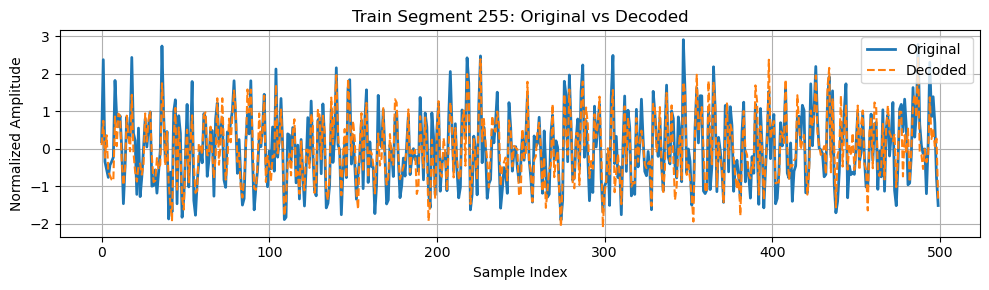

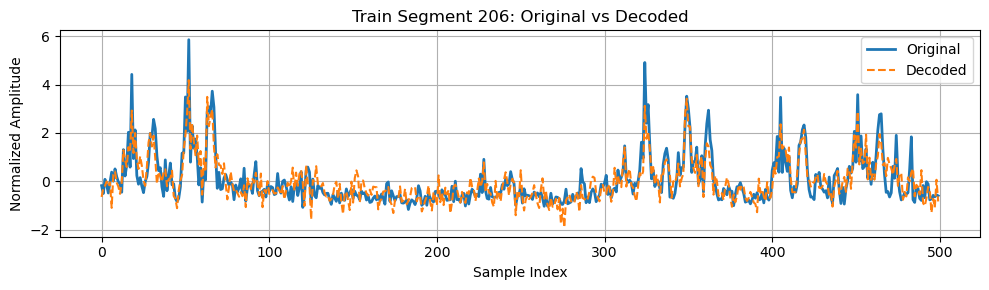

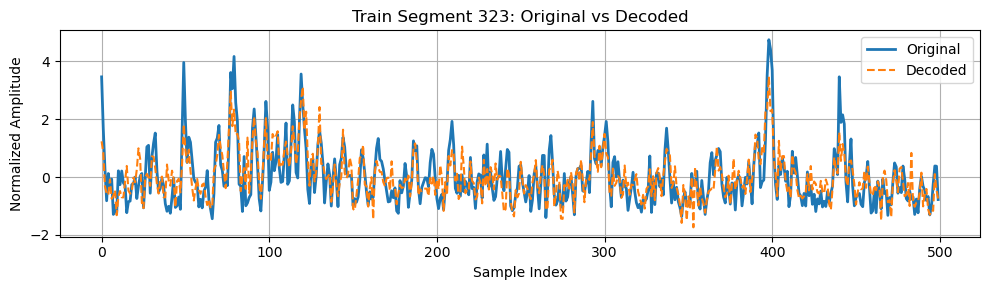

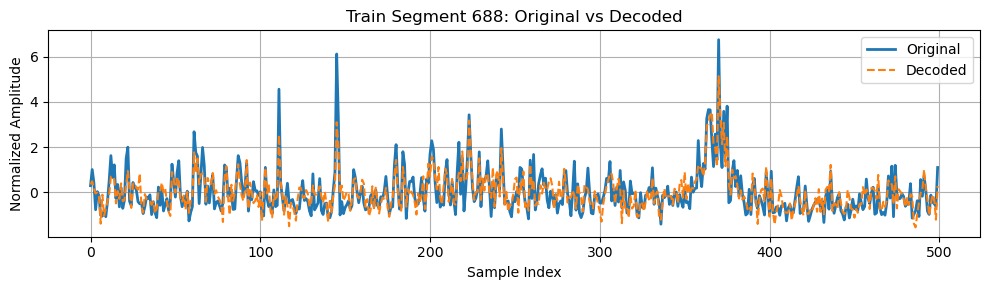

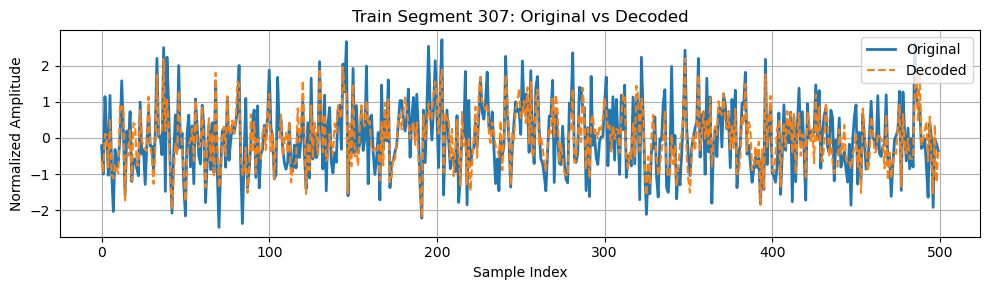

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


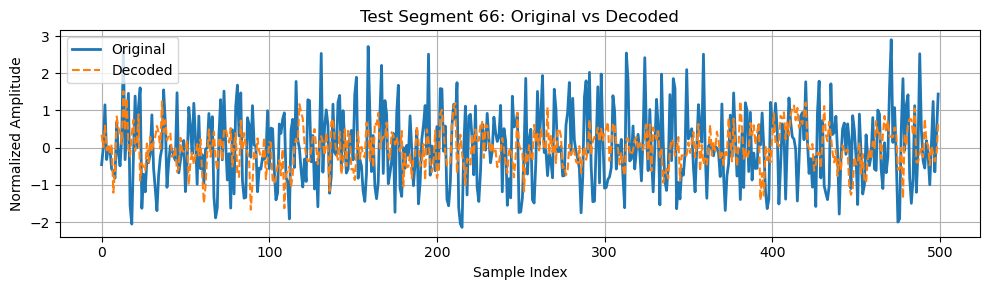

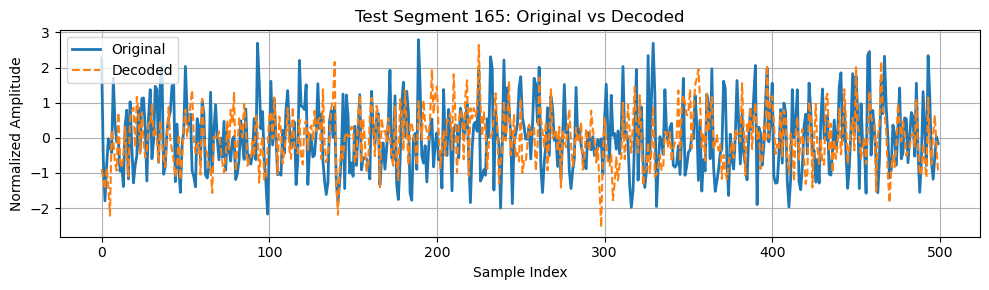

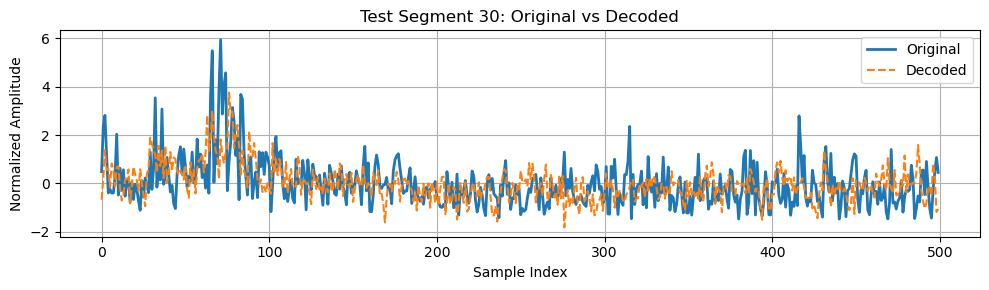

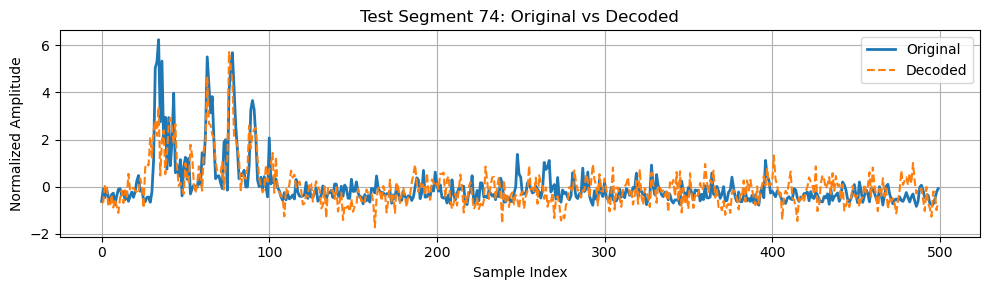

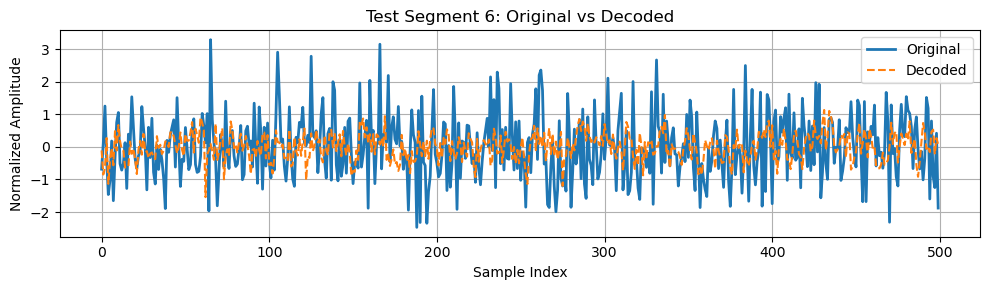

In [1403]:
plot_input_vs_decoded(X_train, autoencoder_std, n_samples=5, dataset_label="Train")
plot_input_vs_decoded(X_test, autoencoder_std, n_samples=5, dataset_label="Test")

#### Training and Validation Loss Curve

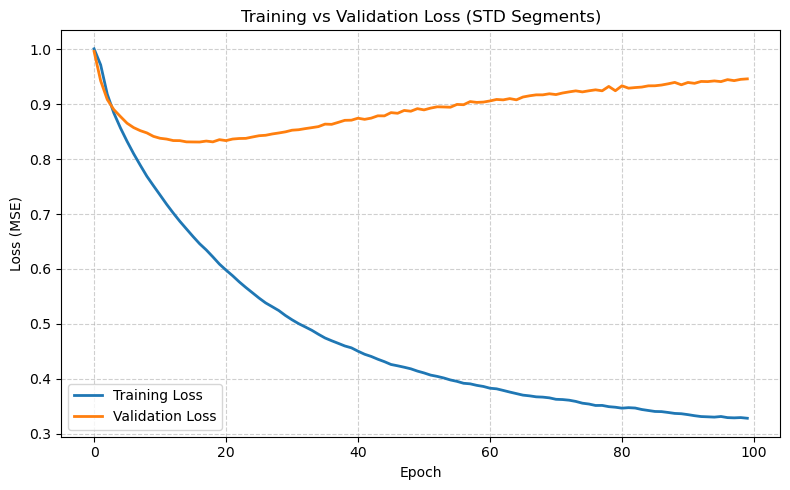

In [1407]:
plt.figure(figsize=(8, 5))
plt.plot(history_std.history['loss'], label='Training Loss', linewidth=2)
plt.plot(history_std.history['val_loss'], label='Validation Loss', linewidth=2)
plt.title("Training vs Validation Loss (STD Segments)")
plt.xlabel("Epoch")
plt.ylabel("Loss (MSE)")
plt.legend()
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

#### Compute Reconstruction error

In [1409]:
# Predict reconstructions for the test set using your trained model
X_Pred1 = autoencoder_std.predict(X_test)

# Compute Mean Squared Error (MSE) for each segment
reconstruction_errors = np.mean((X_test - X_Pred1) ** 2, axis=1)

# Summary statistics
mean_error = np.mean(reconstruction_errors)
std_error = np.std(reconstruction_errors)

# Define anomaly threshold as mean + 3 * std
threshold = mean_error + 3 * std_error

# Print results
print(" Reconstruction Error Summary:")
print(f"• Mean MSE: {mean_error:.4f}")
print(f"• Std Dev: {std_error:.4f}")
print(f"• Anomaly Threshold (mean + 3×std): {threshold:.4f}")

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
 Reconstruction Error Summary:
• Mean MSE: 0.9462
• Std Dev: 0.2102
• Anomaly Threshold (mean + 3×std): 1.5768


#### Plot Reconstruction Error Distribution

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


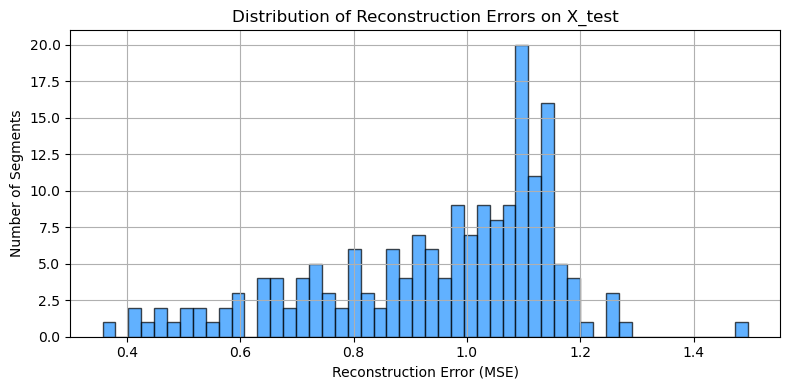

In [1411]:
# Predict and calculate MSE for each test segment
X_Pred1 = autoencoder_std.predict(X_test)
reconstruction_errors = np.mean((X_test - X_Pred1)**2, axis=1)

# Plot histogram
plt.figure(figsize=(8, 4))
plt.hist(reconstruction_errors, bins=50, color='dodgerblue', edgecolor='k', alpha=0.7)
plt.xlabel("Reconstruction Error (MSE)")
plt.ylabel("Number of Segments")
plt.title("Distribution of Reconstruction Errors on X_test")
plt.grid(True)
plt.tight_layout()
plt.show()

### Tunning

In [1513]:
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.regularizers import l2
from tensorflow.keras.callbacks import EarlyStopping

# Define the tuned autoencoder with L2 + Dropout
def build_tuned_autoencoder(input_dim=500, bottleneck_dim=32, l2_strength=1e-3,dropout_rate=0.4):
    model = Sequential([
        Dense(256, activation='relu', input_shape=(input_dim,), kernel_regularizer=l2(l2_strength)),
        Dropout(dropout_rate),
        Dense(128, activation='relu', kernel_regularizer=l2(l2_strength)),
        Dropout(dropout_rate),
        Dense(bottleneck_dim, activation='relu', kernel_regularizer=l2(l2_strength)),
        Dense(128, activation='relu', kernel_regularizer=l2(l2_strength)),
        Dropout(dropout_rate),
        Dense(256, activation='relu', kernel_regularizer=l2(l2_strength)),
        Dropout(dropout_rate),
        Dense(input_dim, activation='linear')
    ])
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    return model

# Build and compile
autoencoder_std_tuned = build_tuned_autoencoder()

# Train with early stopping
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

history_std_tuned = autoencoder_std_tuned.fit(X_train, X_train, epochs=200, batch_size=64,
    validation_data=(X_test, X_test), callbacks=[early_stop],verbose=1)

Epoch 1/200
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 1.8193 - val_loss: 1.6888
Epoch 2/200
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6634 - val_loss: 1.5777
Epoch 3/200
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5508 - val_loss: 1.4709
Epoch 4/200
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4464 - val_loss: 1.3770
Epoch 5/200
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3560 - val_loss: 1.2983
Epoch 6/200
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.2810 - val_loss: 1.2344
Epoch 7/200
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.2203 - val_loss: 1.1835
Epoch 8/200
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.1723 - val_loss: 1.1436
Epoch 9/200
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.1344 - val_loss: 1.1122
Epoch 10/200
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.1044 - val_loss: 1.0870
Epoch 11/200
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.0800 - val_loss: 1.0640
Epoch 12/200
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.

#### Training and Validation Loss Curve

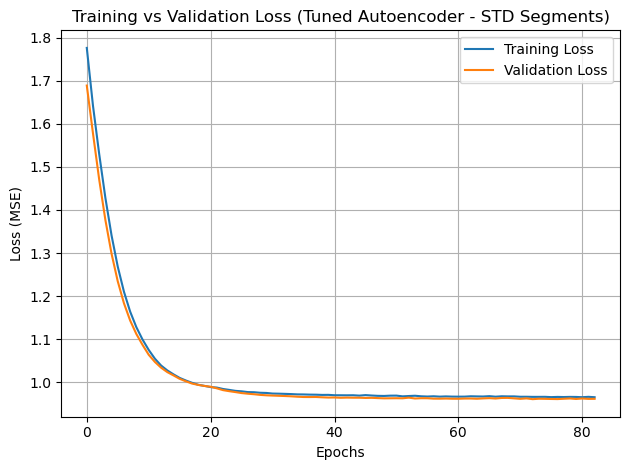

In [1515]:
# Plot the loss curves
plt.plot(history_std_tuned.history['loss'], label='Training Loss')
plt.plot(history_std_tuned.history['val_loss'], label='Validation Loss')
plt.title("Training vs Validation Loss (Tuned Autoencoder - STD Segments)")
plt.xlabel("Epochs")
plt.ylabel("Loss (MSE)")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

#### Compute Reconstruction error

In [1519]:
# Predict reconstructions for X_test using tuned model
X_Pred2 = autoencoder_std_tuned.predict(X_test)

# Compute reconstruction MSE per segment
reconstruction_errors2 = np.mean((X_test - X_Pred2) ** 2, axis=1)

# Summary statistics
mean_error = np.mean(reconstruction_errors2)
std_error = np.std(reconstruction_errors2)
threshold = mean_error + 3 * std_error 

print(" Reconstruction Error Summary:")
print(f"• Mean MSE: {mean_error:.4f}")
print(f"• Std Dev: {std_error:.4f}")
print(f"• Anomaly Threshold (mean + 3×std): {threshold:.4f}")

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
 Reconstruction Error Summary:
• Mean MSE: 0.9552
• Std Dev: 0.0668
• Anomaly Threshold (mean + 3×std): 1.1556


#### Reconstruction Error Distribution

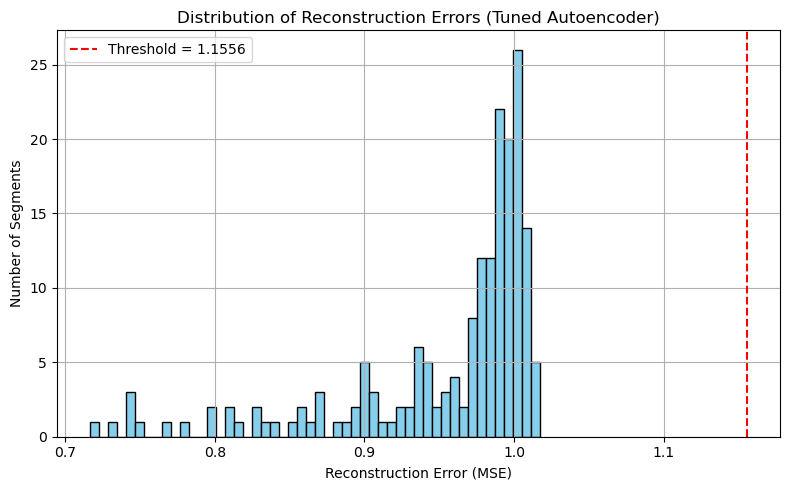

In [1521]:
# Plot distribution of reconstruction errors (tuned)
plt.figure(figsize=(8, 5))
plt.hist(reconstruction_errors2, bins=50, color='skyblue', edgecolor='black')
plt.axvline(threshold, color='red', linestyle='--', label=f'Threshold = {threshold:.4f}')
plt.title("Distribution of Reconstruction Errors (Tuned Autoencoder)")
plt.xlabel("Reconstruction Error (MSE)")
plt.ylabel("Number of Segments")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

#### Original vs Decoded for Random Segments

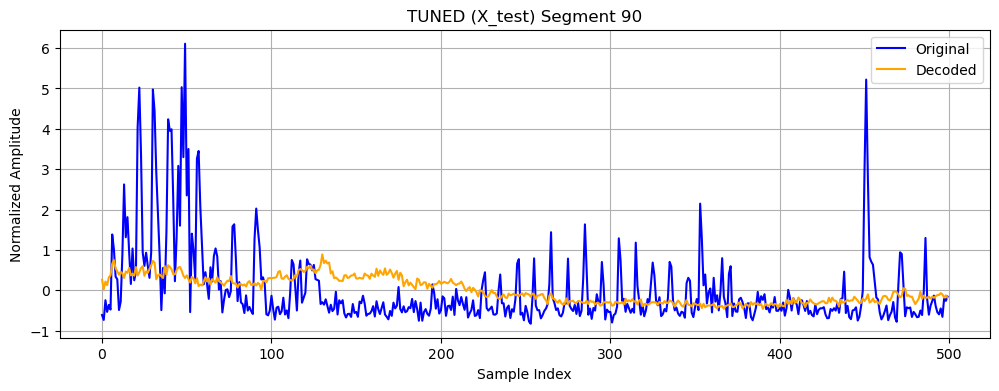

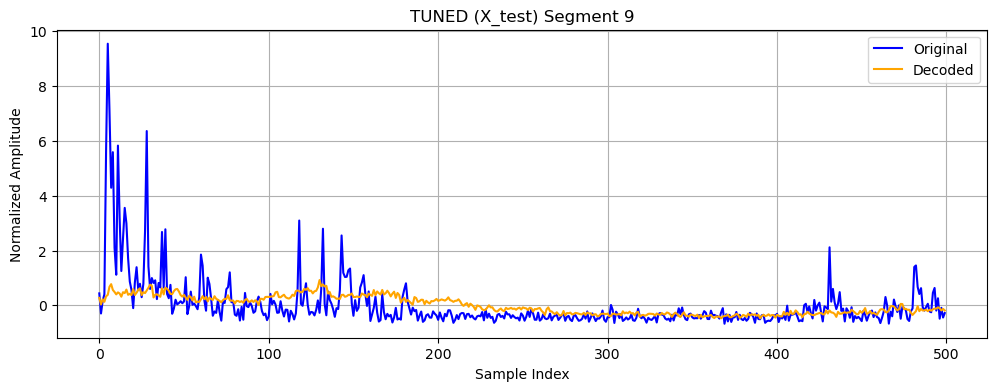

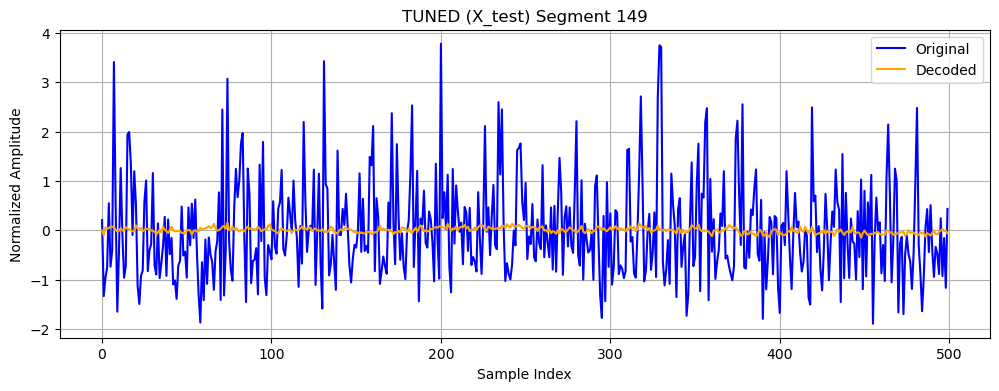

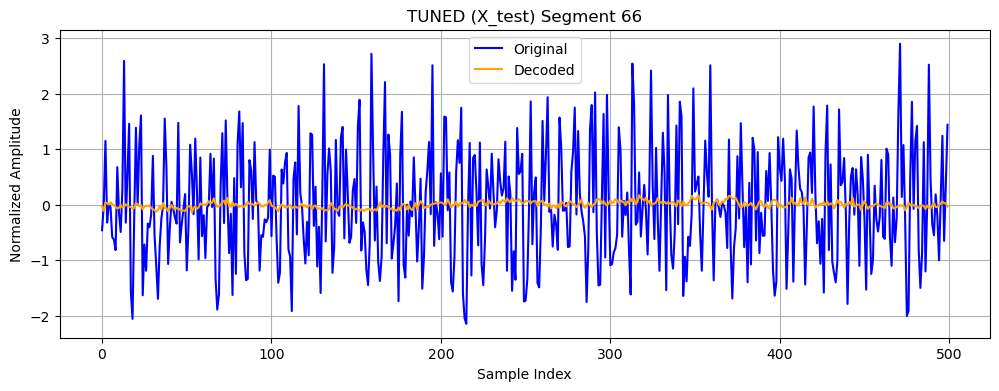

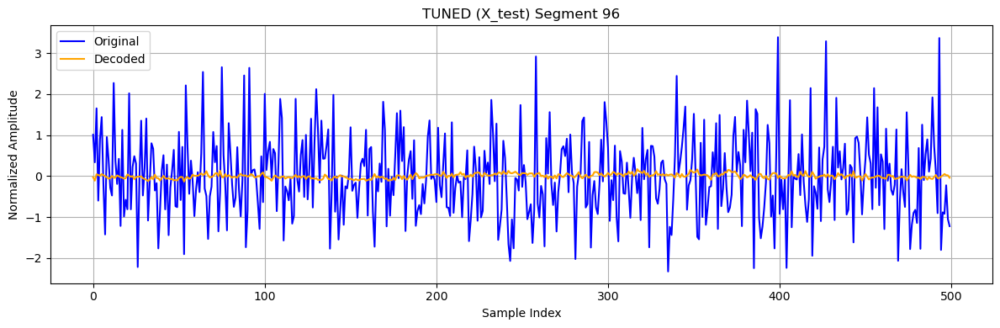

In [1549]:
def plot_random_reconstructions(X_data, decoded_data, n=5, label="TUNED"):
    """
    Plots random original vs decoded segments from test data.

    Parameters:
    - X_data: Original input (X_test)
    - decoded_data: Autoencoder output
    - n: Number of segments to plot
    - label: Title label for plot context
    """
    # Get indices of original vs decoded random segment
    indices = np.random.choice(len(X_data), n, replace=False)
    
    for i, idx in enumerate(indices):
        plt.figure(figsize=(12, 4))
        plt.plot(X_data[idx], label='Original', color='blue')
        plt.plot(decoded_data[idx], label='Decoded', color='orange')
        plt.title(f'{label} Segment {idx}')
        plt.xlabel("Sample Index")
        plt.ylabel("Normalized Amplitude")
        plt.legend()
        plt.grid(True)
    plt.tight_layout()
    plt.show()

# Call for test data
plot_random_reconstructions(X_test, X_Pred2, n=5, label="TUNED (X_test)")

#### High-Error Segments

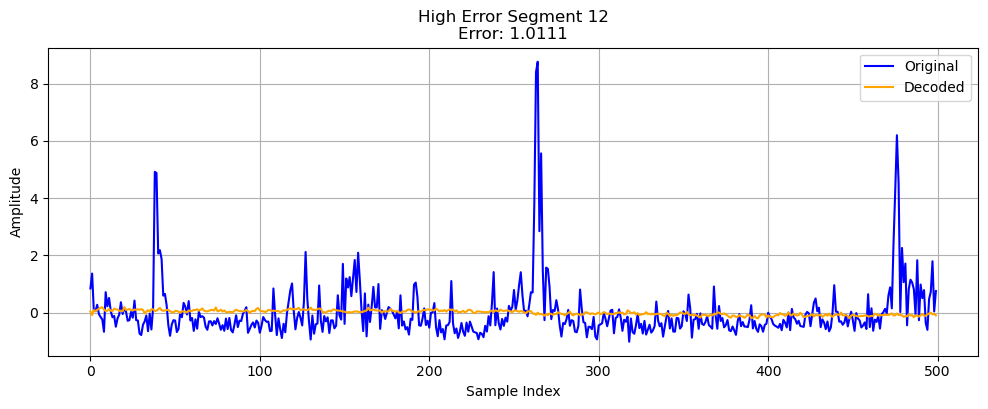

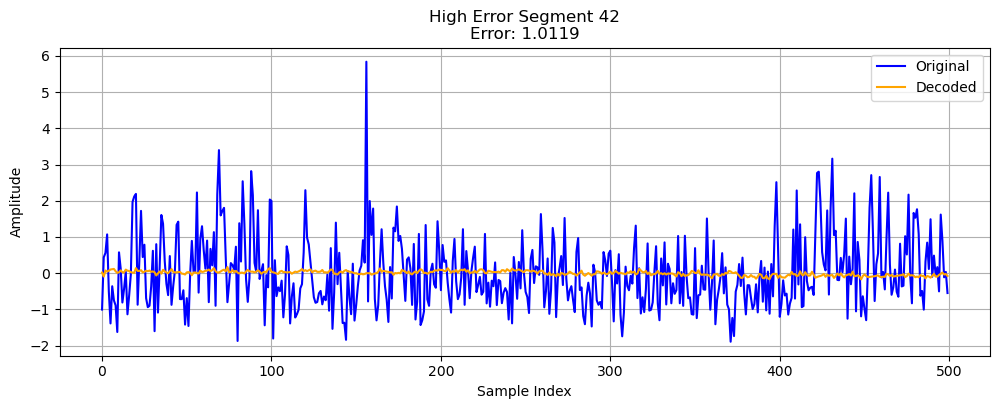

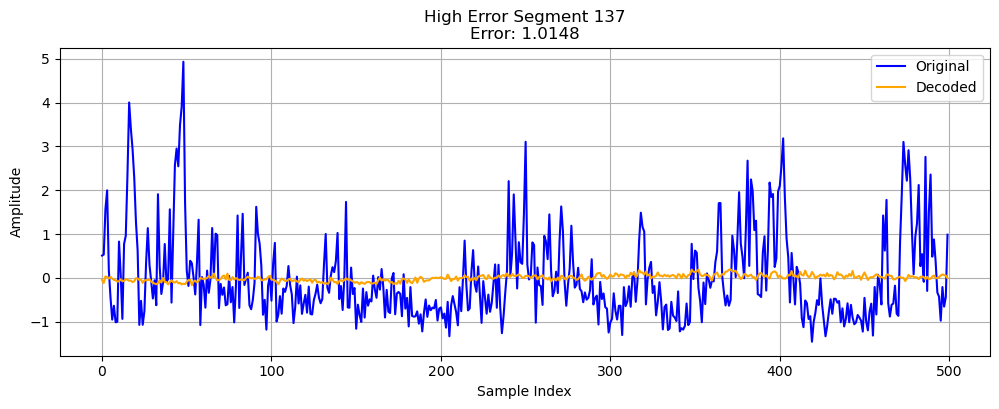

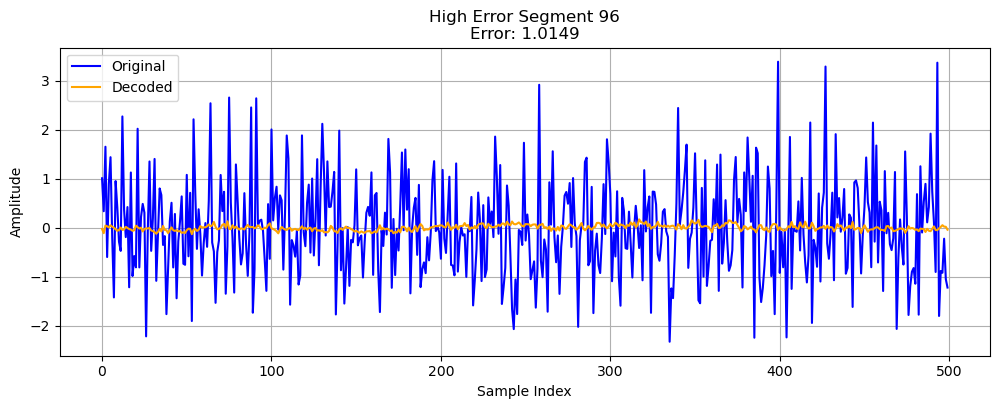

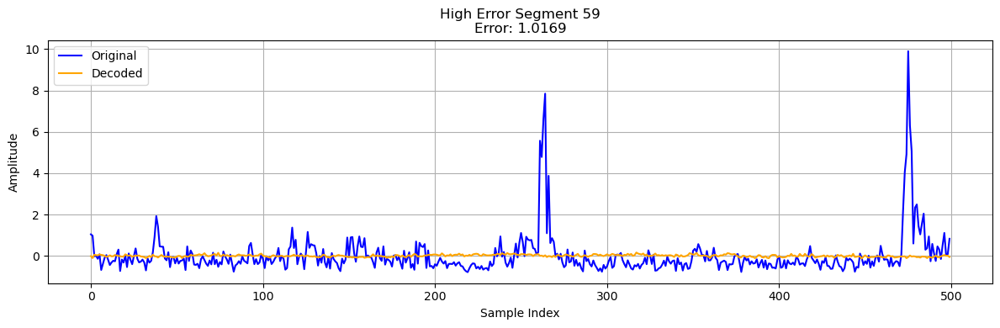

In [1551]:
def plot_high_error_segments(X_data, decoded_data, errors, top_n=5):
    """
    Plots the segments with the highest reconstruction error.

    Parameters:
    - X_data: Original input data
    - decoded_data: Reconstructed data from autoencoder
    - errors: Reconstruction MSEs
    - top_n: Number of top high-error segments to visualize
    """
    # Get indices of top N highest errors
    worst_indices = np.argsort(errors)[-top_n:]
    
    for i, idx in enumerate(worst_indices):
        plt.figure(figsize=(12, 4))
        plt.plot(X_data[idx], label='Original', color='blue')
        plt.plot(decoded_data[idx], label='Decoded', color='orange')
        plt.title(f"High Error Segment {idx}\nError: {errors[idx]:.4f}")
        plt.xlabel("Sample Index")
        plt.ylabel("Amplitude")
        plt.legend()
        plt.grid(True)
    plt.tight_layout()
    plt.show()

# Call 
plot_high_error_segments(X_test, X_Pred2, reconstruction_errors2, top_n=5)

##### Detect Anomalies in Test and Train Sets

In [1553]:
# Mask segments that exceed the threshold
anomalies_test = reconstruction_errors2 > threshold
num_anomalies_test = np.sum(anomalies_test)
print(f" Test Set: {num_anomalies_test} anomalous segments out of {len(X_test)}")

# Also check train set 
decoded_train = autoencoder_std_tuned.predict(X_train)
train_errors = np.mean((X_train - decoded_train) ** 2, axis=1)
anomalies_train = train_errors > threshold
num_anomalies_train = np.sum(anomalies_train)
print(f" Train Set: {num_anomalies_train} anomalous segments out of {len(X_train)}")

 Test Set: 0 anomalous segments out of 183
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
 Train Set: 0 anomalous segments out of 729


##### Plot to show threshold comparison

 High Reconstruction Error Summary:
• 99% of max → cutoff = 1.0067 → 11 segments (6.01%)
• 95% of max → cutoff = 0.9661 → 121 segments (66.12%)
• 90% of max → cutoff = 0.9152 → 146 segments (79.78%)
• 85% of max → cutoff = 0.8644 → 163 segments (89.07%)
• 80% of max → cutoff = 0.8135 → 171 segments (93.44%)


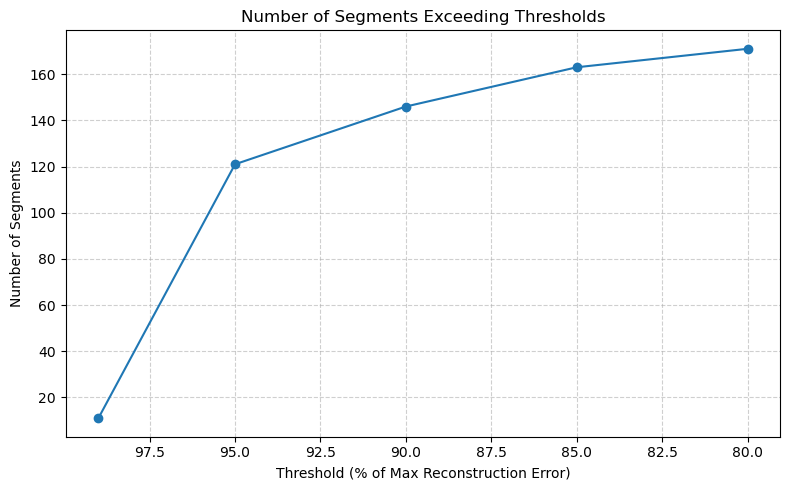

In [1572]:
# reconstruction_errors2 
max_error = np.max(reconstruction_errors2)

# Define thresholds as percentages of max error
percentiles = [99, 95, 90, 85, 80]
cutoffs = [max_error * (p / 100) for p in percentiles]
counts = [np.sum(reconstruction_errors2 >= cutoff) for cutoff in cutoffs]

# Print details
print(" High Reconstruction Error Summary:")
for p, cutoff, count in zip(percentiles, cutoffs, counts):
    print(f"• {p}% of max → cutoff = {cutoff:.4f} → {count} segments ({100 * count / len(reconstruction_errors2):.2f}%)")

# Plot
plt.figure(figsize=(8, 5))
plt.plot(percentiles, counts, marker='o', linestyle='-')
plt.gca().invert_xaxis()  # Higher thresholds on the left
plt.title("Number of Segments Exceeding Thresholds")
plt.xlabel("Threshold (% of Max Reconstruction Error)")
plt.ylabel("Number of Segments")
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

##### Count all segments above a high error threshold

In [1565]:
# Get the maximum reconstruction error
max_error = np.max(reconstruction_errors2)

# Decide what counts as "high"
high_error_cutoff = max_error * 0.95

# Count how many segments are above that
high_error_mask = reconstruction_errors2 >= high_error_cutoff
num_high_error = np.sum(high_error_mask)

# Percentage
percentage_high_error = (num_high_error / len(reconstruction_errors2)) * 100

print(f"Maximum reconstruction error: {max_error:.4f}")
print(f"High error cutoff : {high_error_cutoff:.4f}")
print(f"Number of high-error segments: {num_high_error}")
print(f"Percentage of total: {percentage_high_error:.2f}%")

Maximum reconstruction error: 1.0169
High error cutoff : 0.9661
Number of high-error segments: 121
Percentage of total: 66.12%


##### Show high-error indices and plot

Maximum reconstruction error: 1.0169
High error cutoff (95% of max): 0.9661
Number of high-error segments: 121
High-error indices: [  0   1   2   3   4   6   7  11  12  14  15  16  18  20  23  24  25  26
  28  29  32  33  36  38  39  41  42  43  44  45  46  47  48  49  50  52
  53  54  55  57  59  60  61  66  67  69  70  71  73  76  78  79  80  81
  83  84  88  89  91  92  93  94  95  96  97  98 100 101 102 103 104 105
 106 108 109 111 112 114 115 116 119 120 121 123 124 125 126 127 128 130
 132 133 134 135 136 137 141 143 147 148 149 150 155 156 158 159 161 162
 164 165 167 169 170 174 175 176 177 178 179 181 182]


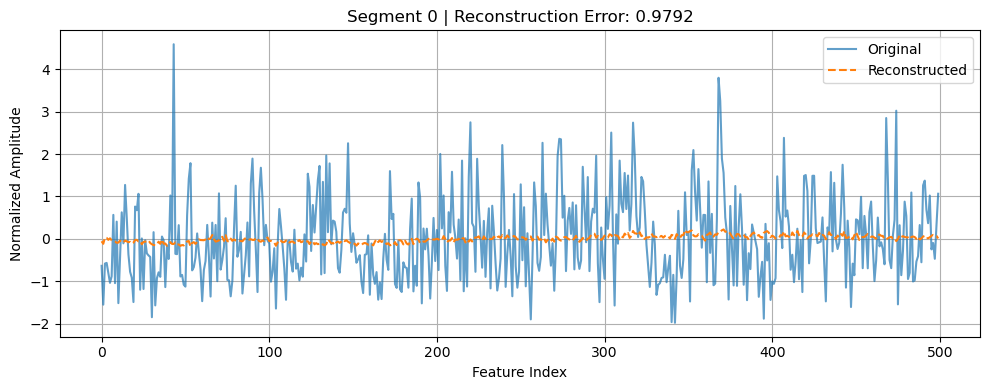

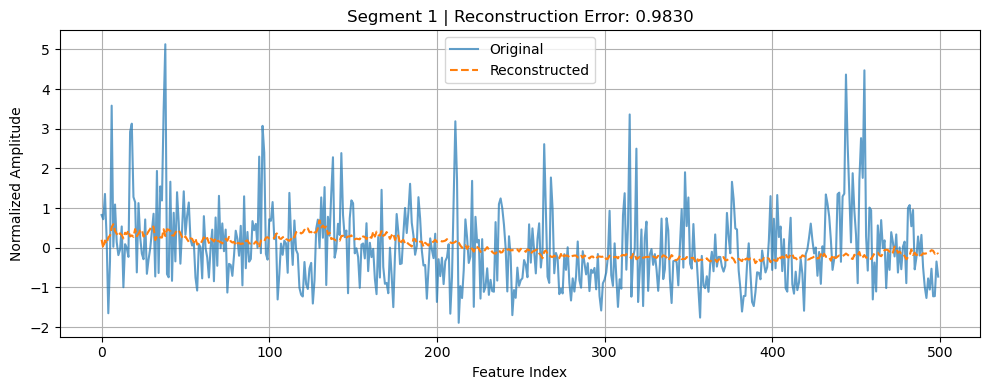

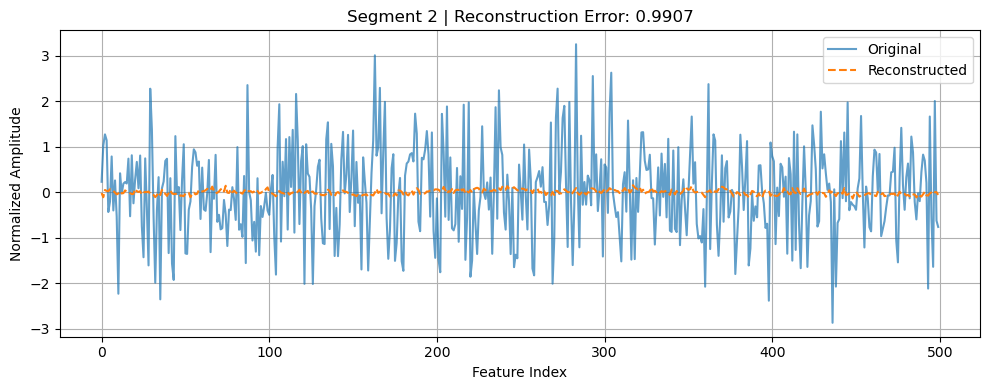

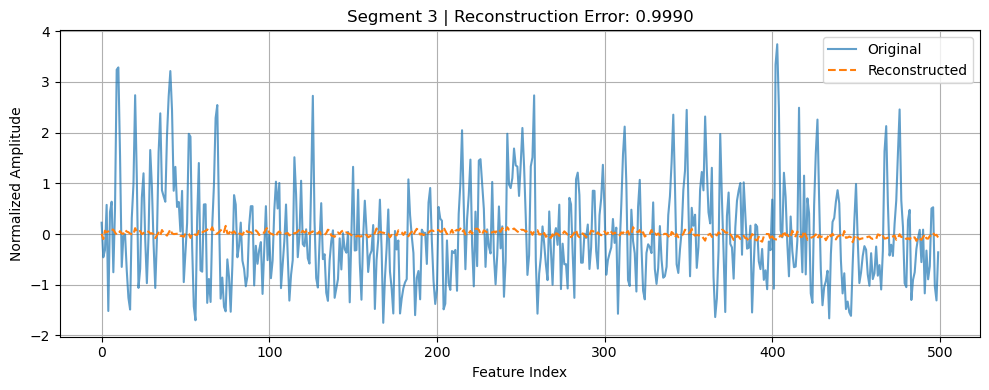

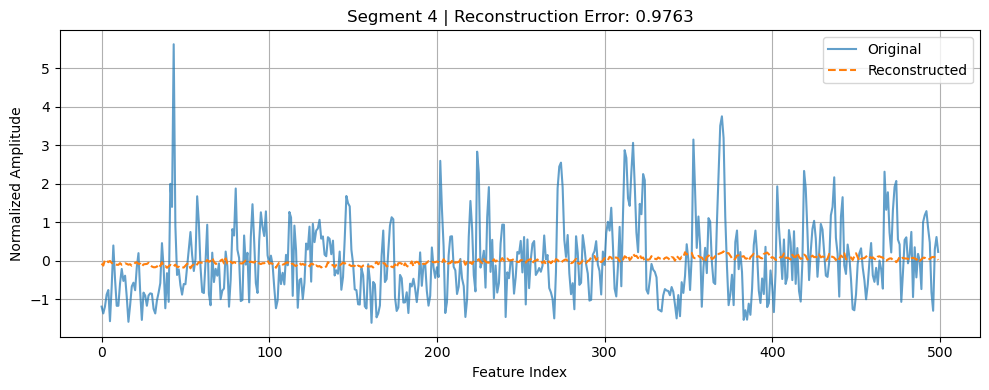

...

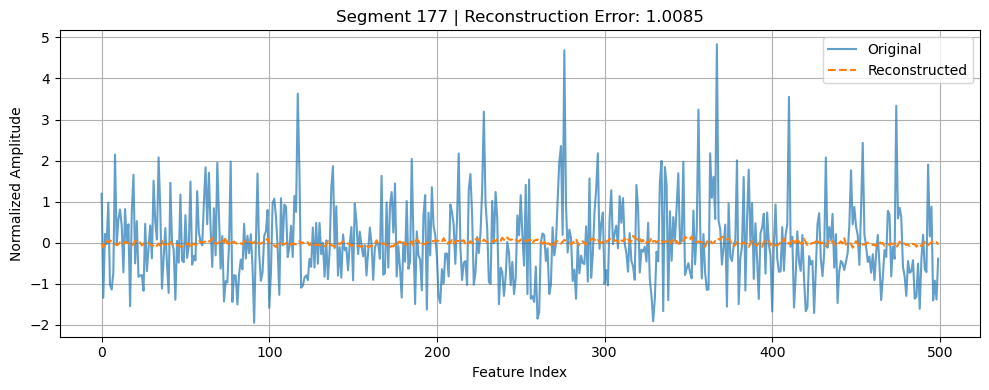

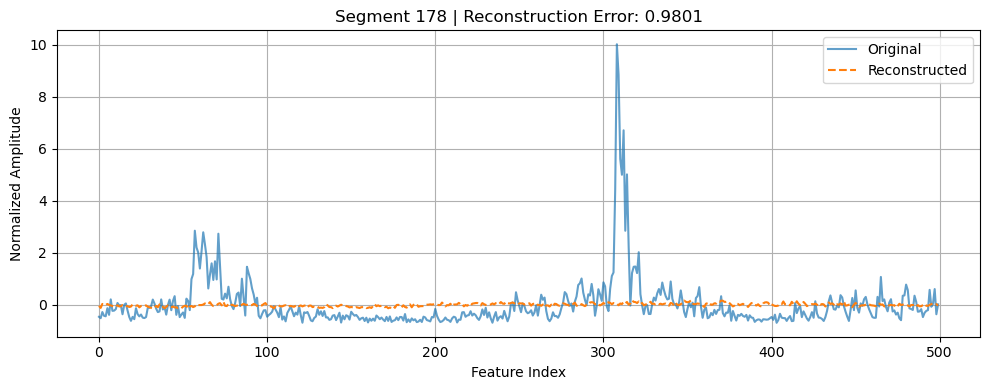

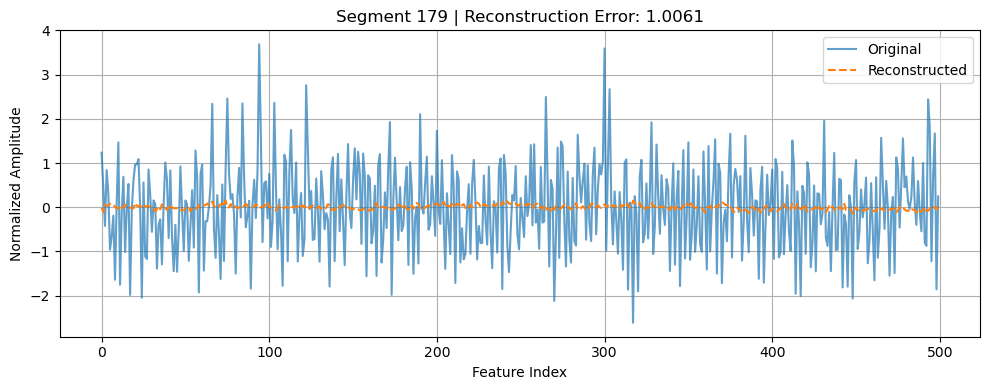

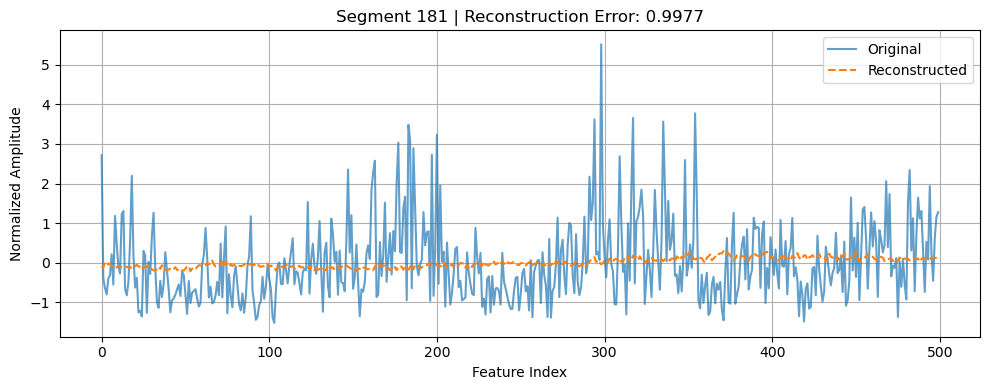

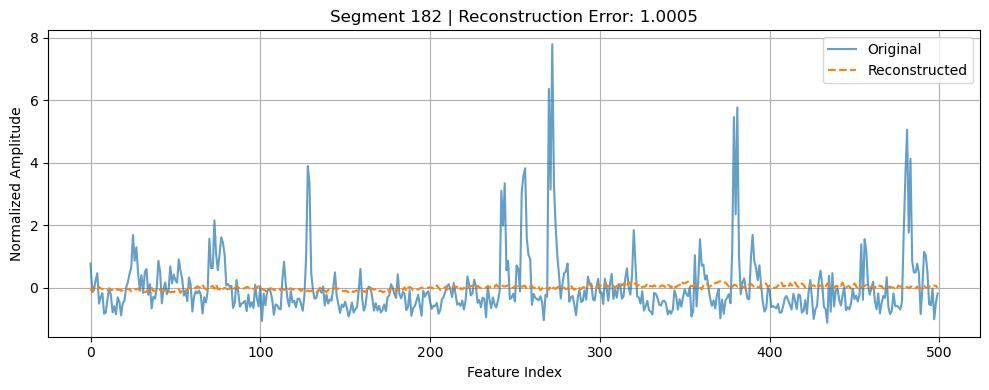

In [1570]:
# Assume reconstruction_errors2 already computed from X_test and X_Pred2
max_error = np.max(reconstruction_errors2)
high_error_cutoff = max_error * 0.95

# Find indices of segments with very high error
high_error_indices = np.where(reconstruction_errors2 > high_error_cutoff)[0]

print(f"Maximum reconstruction error: {max_error:.4f}")
print(f"High error cutoff (95% of max): {high_error_cutoff:.4f}")
print(f"Number of high-error segments: {len(high_error_indices)}")
print(f"High-error indices: {high_error_indices}")

# Plot them
for i, idx in enumerate(high_error_indices):
    plt.figure(figsize=(10, 4))
    plt.plot(X_test[idx], label="Original", alpha=0.7)
    plt.plot(X_Pred2[idx], label="Reconstructed", linestyle="--")
    plt.title(f"Segment {idx} | Reconstruction Error: {reconstruction_errors2[idx]:.4f}")
    plt.xlabel("Feature Index")
    plt.ylabel("Normalized Amplitude")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

##### Save and view summary of reconstruction error

In [1582]:
# 95% of max error threshold
max_error = np.max(reconstruction_errors2)
cutoff_95 = max_error * 0.95

# Get indices and segments above the cutoff
high_error_indices_95 = np.where(reconstruction_errors2 >= cutoff_95)[0]
high_error_segments_95 = X_test[high_error_indices_95]

# Save segments and indices 
np.save("high_error_segments_95.npy", high_error_segments_95)
np.save("high_error_indices_95.npy", high_error_indices_95)

# Create and view a summary DataFrame
summary_df = pd.DataFrame({
    "Segment_Index": high_error_indices_95,
    "Reconstruction_Error": reconstruction_errors2[high_error_indices_95]
}).sort_values(by="Reconstruction_Error", ascending=False).reset_index(drop=True)

# Show top 10 worst segments
summary_df.head(10)

,Segment_Index,Reconstruction_Error
0,59,1.016916
1,96,1.014945
2,137,1.014773
3,42,1.011941
4,12,1.011086
5,66,1.009160
6,121,1.008479
7,177,1.008477
8,69,1.008343
9,52,1.007461


### Evaluate Earthquake Segments on Trained Tunned Autoencoder


###### Sort Eartquake files to prepare for evaluation

In [1594]:
# Folder name
base_dir = "segments_2500_std"

# Earthquake base names 
earthquake_bases = [
    "RE992_EQ_20240601T111409_10min",
    "RE992_EQ_20240814T022653_10min",
    "R5C62_EQ_trimmed_10min",
    "R77F9_EQ_trimmed_10min",
    "R853C_EQ_20240712T063946_10min",
    "R74A7_EQ_20220430T090645_10min",
    "R30A2_EQ_20250228T193324_10min",
    "R5156_EQ_20230222T060119_10min",
    "R47BB_EQ_20230722T164652_10min",
    "R5E3B_EQ_20250312T131039_10min"
]

# Find all matching .npy files
all_files = os.listdir(base_dir)
earthquake_files = []

for base in earthquake_bases:
    matches = [f for f in all_files if f.startswith(base) and f.endswith(".npy")]
    earthquake_files.extend(matches)

# Sort the result for clarity
earthquake_files = sorted(earthquake_files)

# Preview the list
print(f"Total earthquake files found: {len(earthquake_files)}")
for f in earthquake_files:
    print(f)

Total earthquake files found: 32
R30A2_EQ_20250228T193324_10min_EHE_segments.npy
R30A2_EQ_20250228T193324_10min_EHN_segments.npy
R30A2_EQ_20250228T193324_10min_EHZ_segments.npy
R47BB_EQ_20230722T164652_10min_EHZ_segments.npy
R47BB_EQ_20230722T164652_10min_ENE_segments.npy
R47BB_EQ_20230722T164652_10min_ENN_segments.npy
R47BB_EQ_20230722T164652_10min_ENZ_segments.npy
R5156_EQ_20230222T060119_10min_EHE_segments.npy
R5156_EQ_20230222T060119_10min_EHN_segments.npy
R5156_EQ_20230222T060119_10min_EHZ_segments.npy
R5C62_EQ_trimmed_10min_EHE_segments.npy
R5C62_EQ_trimmed_10min_EHN_segments.npy
R5C62_EQ_trimmed_10min_EHZ_segments.npy
R5E3B_EQ_20250312T131039_10min_EHZ_segments.npy
R5E3B_EQ_20250312T131039_10min_ENE_segments.npy
R5E3B_EQ_20250312T131039_10min_ENN_segments.npy
R5E3B_EQ_20250312T131039_10min_ENZ_segments.npy
R74A7_EQ_20220430T090645_10min_EHE_segments.npy
R74A7_EQ_20220430T090645_10min_EHN_segments.npy
R74A7_EQ_20220430T090645_10min_EHZ_segments.npy
R77F9_EQ_trimmed_10min_EHE_segm

 Evaluating Earthquake Segment Files (Normalized)...

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
R30A2_EQ_20250228T193324_10min_EHE_segments.npy: 0 anomalies out of 24 segments
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
R30A2_EQ_20250228T193324_10min_EHN_segments.npy: 0 anomalies out of 24 segments
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
R30A2_EQ_20250228T193324_10min_EHZ_segments.npy: 0 anomalies out of 24 segments
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
R47BB_EQ_20230722T164652_10min_EHZ_segments.npy: 0 anomalies out of 24 segments
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
R47BB_EQ_20230722T164652_10min_ENE_segments.npy: 0 anomalies out of 24 segments
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
R47BB_EQ_20230722T164652_10min_ENN_segments.npy: 0 anomalies out of 24 segments
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
R47BB_EQ_20230722T164652_10min_ENZ_segments.npy: 0 anomalies out of 24 segments
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
R5156_EQ_20230222T060119_10min_EHE_segments.npy: 0 anomalies out of 24 segments
1/

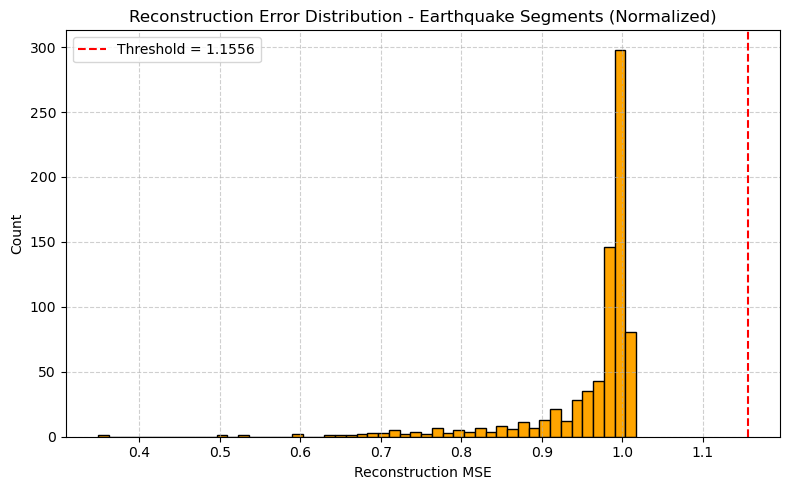

In [1626]:
# Parameters
base_dir = "segments_2500_std"
threshold = 1.1556  # Tuned model's threshold
model = autoencoder_std_tuned  # Trained autoencoder

# List of earthquake file bases
earthquake_bases = [
    "RE992_EQ_20240601T111409_10min",
    "RE992_EQ_20240814T022653_10min",
    "R5C62_EQ_trimmed_10min",
    "R77F9_EQ_trimmed_10min",
    "R853C_EQ_20240712T063946_10min",
    "R74A7_EQ_20220430T090645_10min",
    "R30A2_EQ_20250228T193324_10min",
    "R5156_EQ_20230222T060119_10min",
    "R47BB_EQ_20230722T164652_10min",
    "R5E3B_EQ_20250312T131039_10min"
]

# Find all matching earthquake .npy files
all_files = os.listdir(base_dir)
earthquake_files = []
for base in earthquake_bases:
    matches = [f for f in all_files if f.startswith(base) and f.endswith(".npy")]
    earthquake_files.extend(matches)

earthquake_files = sorted(earthquake_files)

# Evaluate
total_segments = 0
total_anomalies = 0
all_errors = []

print(" Evaluating Earthquake Segment Files (Normalized)...\n")

for fname in earthquake_files:
    path = os.path.join(base_dir, fname)
    data = np.load(path).astype("float32")

    #  Per-segment normalization 
    means = data.mean(axis=1, keepdims=True)
    stds = data.std(axis=1, keepdims=True) + 1e-8
    data_norm = (data - means) / stds

    # Predict and compute error
    preds = model.predict(data_norm)
    errors = np.mean((data_norm - preds) ** 2, axis=1)
    all_errors.extend(errors)

    anomalies = np.sum(errors > threshold)
    total_segments += len(data)
    total_anomalies += anomalies

    print(f"{fname}: {anomalies} anomalies out of {len(data)} segments")

# Summary
print("\n Earthquake Detection Summary (Normalized):")
print(f"• Total segments analyzed: {total_segments}")
print(f"• Total anomalies detected: {total_anomalies}")
print(f"• Detection rate: {(total_anomalies / total_segments) * 100:.2f}%")

# Histogram
plt.figure(figsize=(8, 5))
plt.hist(all_errors, bins=50, color='orange', edgecolor='black')
plt.axvline(threshold, color='red', linestyle='--', label=f"Threshold = {threshold:.4f}")
plt.title("Reconstruction Error Distribution - Earthquake Segments (Normalized)")
plt.xlabel("Reconstruction MSE")
plt.ylabel("Count")
plt.legend()
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

##### Reconstruction Error Comparison

In [1628]:
# Split EQ and Non-EQ error arrays
eq_errors = np.array(all_errors)
non_eq_errors = reconstruction_errors2  # from earlier non-earthquake test set

# Compare basic stats
print("\n Reconstruction Error Comparison:")
print(f"• EQ Segments - Mean MSE: {eq_errors.mean():.4f}, Std: {eq_errors.std():.4f}")
print(f"• Non-EQ Segments - Mean MSE: {non_eq_errors.mean():.4f}, Std: {non_eq_errors.std():.4f}")


 Reconstruction Error Comparison:
• EQ Segments - Mean MSE: 0.9611, Std: 0.0755
• Non-EQ Segments - Mean MSE: 0.9552, Std: 0.0668


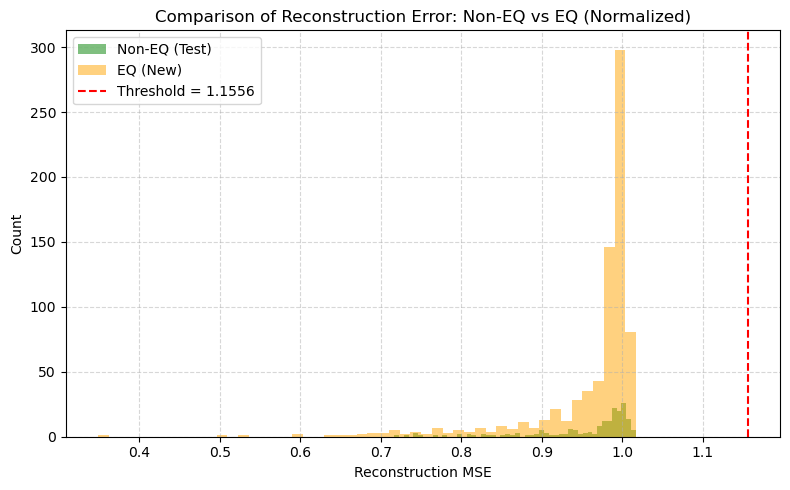

In [1618]:
plt.figure(figsize=(8, 5))
plt.hist(reconstruction_errors2, bins=50, alpha=0.5, label='Non-EQ (Test)', color='green')
plt.hist(all_errors, bins=50, alpha=0.5, label='EQ (New)', color='orange')
plt.axvline(threshold, color='red', linestyle='--', label=f"Threshold = {threshold:.4f}")
plt.xlabel("Reconstruction MSE")
plt.ylabel("Count")
plt.legend()
plt.title("Comparison of Reconstruction Error: Non-EQ vs EQ (Normalized)")
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

##### Identify segments that are most anomalous within the earthquake group.


 95th Percentile Threshold (based on EQ errors): 1.0065
 Anomalous EQ segments: 39 / 768


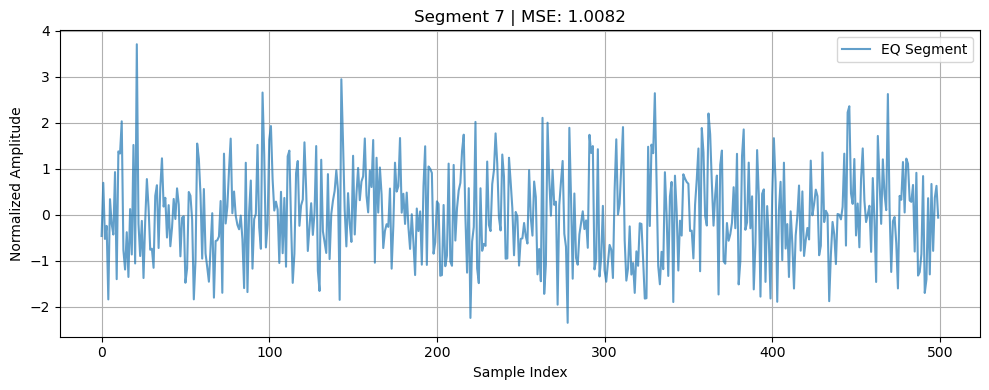

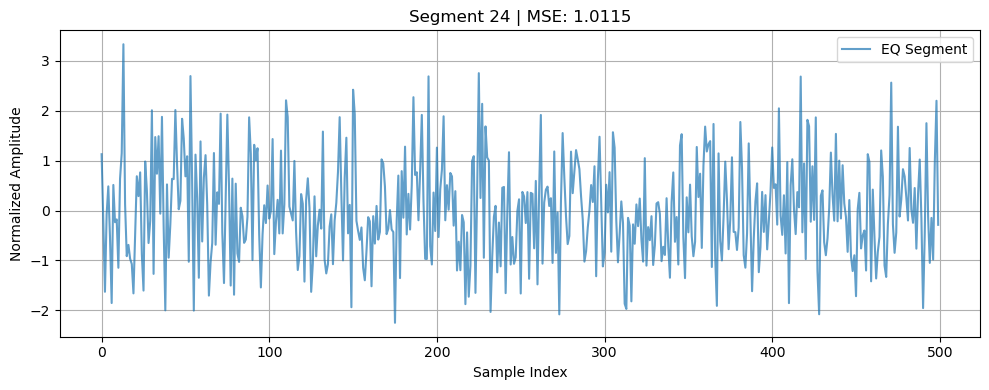

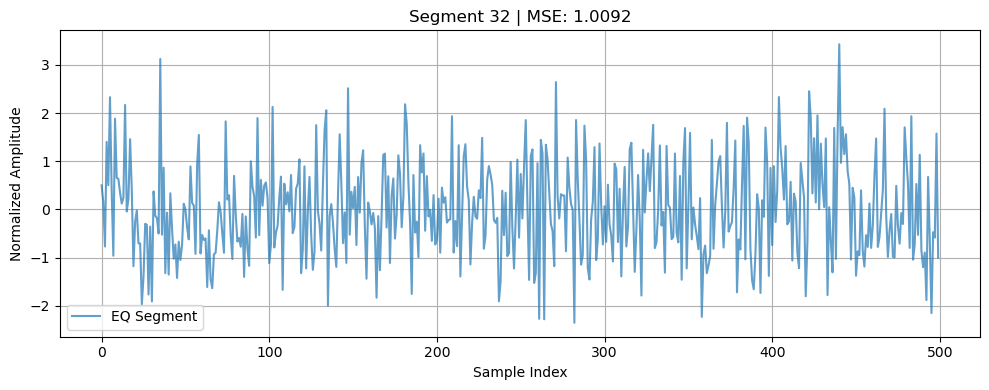

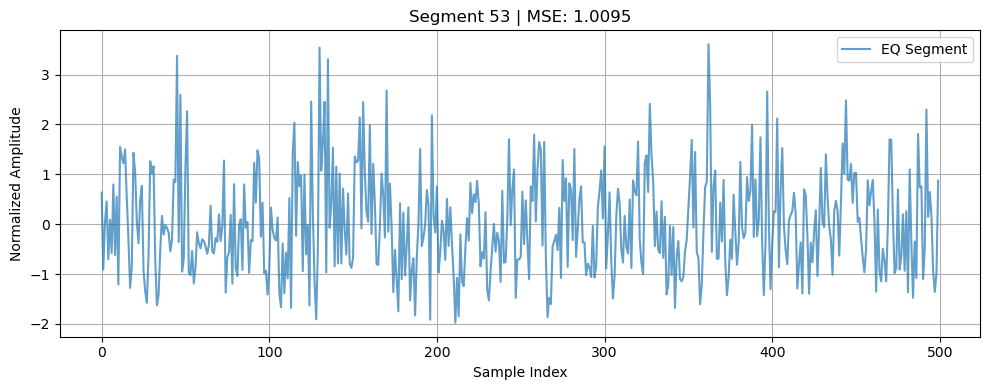

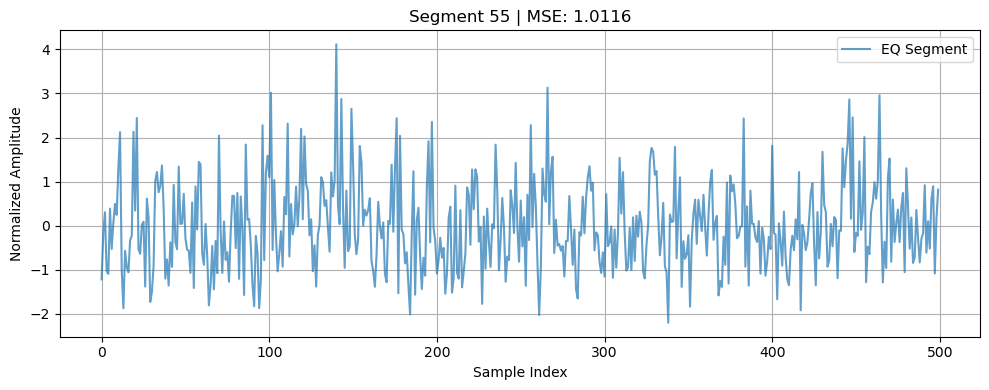

In [1624]:
# Convert all_errors to a NumPy array
all_errors_eq = np.array(all_errors)

# Stack all EQ segments into one array for use
all_eq_segments = np.vstack([np.load(os.path.join(base_dir, f)).astype("float32") for f in earthquake_files])

# Re-normalize all segments 
means = all_eq_segments.mean(axis=1, keepdims=True)
stds = all_eq_segments.std(axis=1, keepdims=True) + 1e-8
all_eq_segments_norm = (all_eq_segments - means) / stds

# Apply 95th percentile threshold
threshold_95 = np.percentile(all_errors_eq, 95)
print(f"\n 95th Percentile Threshold (based on EQ errors): {threshold_95:.4f}")

# Identify "anomalous" segments
anomalous_indices_95 = np.where(all_errors_eq > threshold_95)[0]
print(f" Anomalous EQ segments: {len(anomalous_indices_95)} / {len(all_errors_eq)}")

# Save for later analysis
np.save("eq_anomalous_indices_95.npy", anomalous_indices_95)
np.save("eq_anomalous_segments_95.npy", all_eq_segments_norm[anomalous_indices_95])

# Plot top 5 of them 
for i, idx in enumerate(anomalous_indices_95[:5]):
    plt.figure(figsize=(10, 4))
    plt.plot(all_eq_segments_norm[idx], label="EQ Segment", alpha=0.7)
    plt.title(f"Segment {idx} | MSE: {all_errors_eq[idx]:.4f}")
    plt.xlabel("Sample Index")
    plt.ylabel("Normalized Amplitude")
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

##### Run a loop to test thresholds from 0.95 to 1.15 (Guiding Threshold Selection)

In [1638]:
# Get non-EQ train reconstruction errors
decoded_train = autoencoder_std_tuned.predict(X_train)
train_errors = np.mean((X_train - decoded_train) ** 2, axis=1)

# Sweep thresholds from 0.95 to 1.15
sweep_thresholds = np.linspace(0.95, 1.15, 25)
anomaly_counts = []

# Evaluate on EQ segments
all_eq_errors = []

for fname in earthquake_files:
    path = os.path.join(base_dir, fname)
    data = np.load(path).astype("float32")

    # Normalize each segment
    means = data.mean(axis=1, keepdims=True)
    stds = data.std(axis=1, keepdims=True) + 1e-8
    data_norm = (data - means) / stds

    preds = autoencoder_std_tuned.predict(data_norm)
    errors = np.mean((data_norm - preds) ** 2, axis=1)
    all_eq_errors.extend(errors)

all_eq_errors = np.array(all_eq_errors)

# Count anomalies at each threshold
for t in sweep_thresholds:
    count = np.sum(all_eq_errors > t)
    anomaly_counts.append(count)

# Print summary
for t, count in zip(sweep_thresholds, anomaly_counts):
    print(f"Threshold = {t:.4f} → {count} anomalies ({100*count/len(all_eq_errors):.2f}%)")

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━

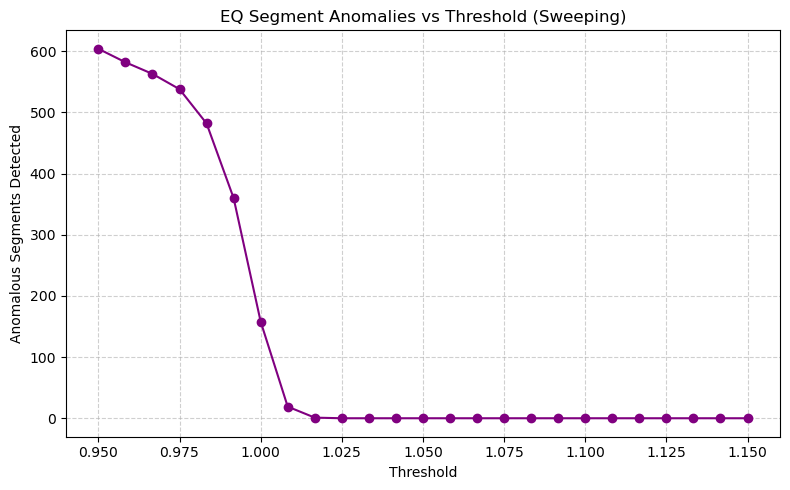

In [1640]:
# Plot sweep result
plt.figure(figsize=(8, 5))
plt.plot(sweep_thresholds, anomaly_counts, marker='o', color='purple')
plt.title("EQ Segment Anomalies vs Threshold (Sweeping)")
plt.xlabel("Threshold")
plt.ylabel("Anomalous Segments Detected")
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

##### Detect Earthquake Anomalies Using New Threshold (1.0070)

In [1645]:
# Parameters
base_dir = "segments_2500_std"
threshold = 1.000  # From Guiding Threshold Selection
model = autoencoder_std_tuned  # trained model

# EQ base filenames
earthquake_bases = [
    "RE992_EQ_20240601T111409_10min",
    "RE992_EQ_20240814T022653_10min",
    "R5C62_EQ_trimmed_10min",
    "R77F9_EQ_trimmed_10min",
    "R853C_EQ_20240712T063946_10min",
    "R74A7_EQ_20220430T090645_10min",
    "R30A2_EQ_20250228T193324_10min",
    "R5156_EQ_20230222T060119_10min",
    "R47BB_EQ_20230722T164652_10min",
    "R5E3B_EQ_20250312T131039_10min"
]

# Collect all EQ .npy segment files
all_files = os.listdir(base_dir)
earthquake_files = []
for base in earthquake_bases:
    matches = [f for f in all_files if f.startswith(base) and f.endswith(".npy")]
    earthquake_files.extend(matches)

earthquake_files = sorted(earthquake_files)

# Evaluate
total_segments = 0
total_anomalies = 0
all_errors = []

print("\n Evaluating Earthquake Segment Files (with Tighter Threshold)...\n")

for fname in earthquake_files:
    path = os.path.join(base_dir, fname)
    data = np.load(path).astype("float32")

    # Per-segment normalization
    means = data.mean(axis=1, keepdims=True)
    stds = data.std(axis=1, keepdims=True) + 1e-8
    data_norm = (data - means) / stds

    # Predict and calculate errors
    preds = model.predict(data_norm)
    errors = np.mean((data_norm - preds) ** 2, axis=1)
    all_errors.extend(errors)

    # Count anomalies above new threshold
    anomalies = np.sum(errors > threshold)
    total_segments += len(data)
    total_anomalies += anomalies

    print(f"{fname}: {anomalies} anomalies out of {len(data)} segments")

# Summary
print("\n Earthquake Detection Summary (Tighter Threshold):")
print(f"• Total segments analyzed: {total_segments}")
print(f"• Total anomalies detected: {total_anomalies}")
print(f"• Detection rate: {(total_anomalies / total_segments) * 100:.2f}%")


 Evaluating Earthquake Segment Files (with Tighter Threshold)...

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
R30A2_EQ_20250228T193324_10min_EHE_segments.npy: 7 anomalies out of 24 segments
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
R30A2_EQ_20250228T193324_10min_EHN_segments.npy: 6 anomalies out of 24 segments
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
R30A2_EQ_20250228T193324_10min_EHZ_segments.npy: 10 anomalies out of 24 segments
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
R47BB_EQ_20230722T164652_10min_EHZ_segments.npy: 2 anomalies out of 24 segments
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
R47BB_EQ_20230722T164652_10min_ENE_segments.npy: 16 anomalies out of 24 segments
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
R47BB_EQ_20230722T164652_10min_ENN_segments.npy: 13 anomalies out of 24 segments
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
R47BB_EQ_20230722T164652_10min_ENZ_segments.npy: 15 anomalies out of 24 segments
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
R5156_EQ_20230222T060119_10min_EHE_segments.npy: 2 anomalies out 

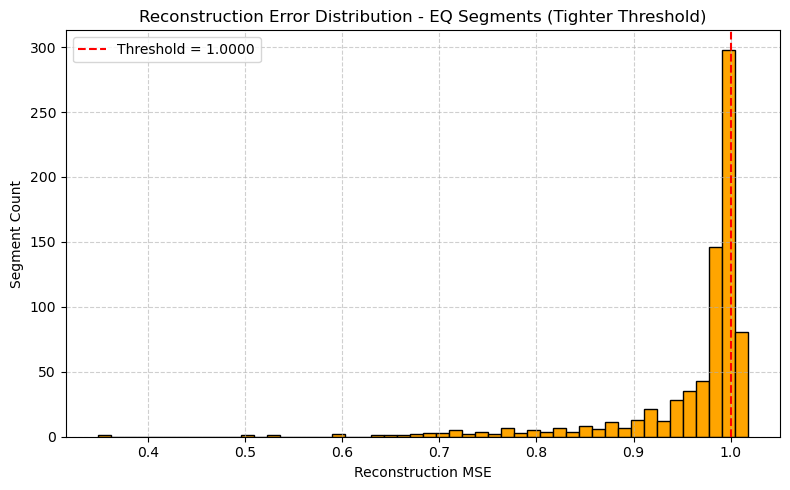

In [1647]:
# Plot histogram
plt.figure(figsize=(8, 5))
plt.hist(all_errors, bins=50, color='orange', edgecolor='black')
plt.axvline(threshold, color='red', linestyle='--', label=f"Threshold = {threshold:.4f}")
plt.title("Reconstruction Error Distribution - EQ Segments (Tighter Threshold)")
plt.xlabel("Reconstruction MSE")
plt.ylabel("Segment Count")
plt.legend()
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

##### Save Reconstruction errors for evaluation

In [1650]:
# Save the EQ segment reconstruction errors from threshold 1.000 evaluation
np.save("eq_errors_threshold_1.000.npy", all_eq_errors)

# Save the Non-EQ reconstruction errors (from X_test predictions)
np.save("non_eq_errors_threshold_1.000.npy", reconstruction_errors2)

print(" EQ and Non-EQ reconstruction error files saved.")

 EQ and Non-EQ reconstruction error files saved.


##### Evaluation of autoencoder’s performance using the saved EQ and Non-EQ reconstruction errors

In [1653]:
from sklearn.metrics import roc_curve, auc, precision_recall_fscore_support, confusion_matrix
import seaborn as sns

# Load the saved reconstruction errors
eq_errors = np.load("eq_errors_threshold_1.000.npy")
non_eq_errors = np.load("non_eq_errors_threshold_1.000.npy")

# Combine and label
y_true = np.concatenate([np.ones_like(eq_errors), np.zeros_like(non_eq_errors)])  # 1 = EQ, 0 = Non-EQ
y_scores = np.concatenate([eq_errors, non_eq_errors])  # MSE scores from autoencoder

# ROC Curve
fpr, tpr, thresholds = roc_curve(y_true, y_scores)
roc_auc = auc(fpr, tpr)

# Optimal threshold (picking the one that maximizes TPR - FPR)
optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]

# Predictions using optimal threshold
y_pred = (y_scores > optimal_threshold).astype(int)

# Precision, Recall, F1
precision, recall, f1, _ = precision_recall_fscore_support(y_true, y_pred, average='binary')

# Confusion Matrix
cm = confusion_matrix(y_true, y_pred)

# Print metrics
print(" Evaluation Metrics (Autoencoder Anomaly Detection):")
print(f"• ROC-AUC: {roc_auc:.4f}")
print(f"• Optimal Threshold: {optimal_threshold:.4f}")
print(f"• Precision: {precision:.4f}")
print(f"• Recall: {recall:.4f}")
print(f"• F1-Score: {f1:.4f}")

 Evaluation Metrics (Autoencoder Anomaly Detection):
• ROC-AUC: 0.5434
• Optimal Threshold: 0.9841
• Precision: 0.8418
• Recall: 0.6237
• F1-Score: 0.7165


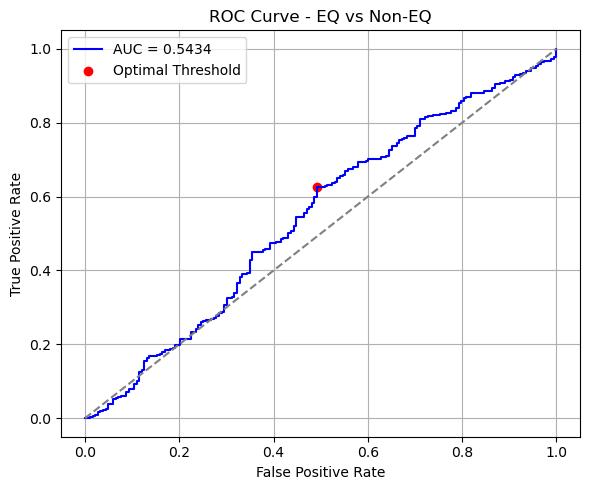

In [1655]:
# Plot ROC Curve
plt.figure(figsize=(6, 5))
plt.plot(fpr, tpr, label=f"AUC = {roc_auc:.4f}", color='blue')
plt.plot([0, 1], [0, 1], linestyle="--", color="gray")
plt.scatter(fpr[optimal_idx], tpr[optimal_idx], color="red", label="Optimal Threshold")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve - EQ vs Non-EQ")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

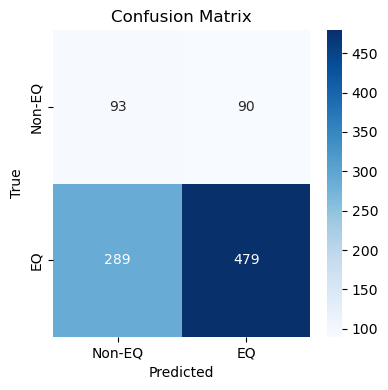

In [1657]:
# Plot Confusion Matrix 
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["Non-EQ", "EQ"], yticklabels=["Non-EQ", "EQ"])
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.tight_layout()
plt.show()

##### Exploring top 5 thresholds sorted descending by computing TPR - FPR for each threshold

In [1670]:
# Compute TPR - FPR for each threshold
separation_scores = tpr - fpr

# Get top 5 best thresholds
top_indices = np.argsort(separation_scores)[-5:][::-1] # Top 5, sorted descending
print("\nTop 5 Thresholds Based on TPR - FPR:")
for i in top_indices:
    print(f"Threshold: {thresholds[i]:.4f} | TPR: {tpr[i]:.3f} | FPR: {fpr[i]:.3f} | TPR - FPR: {separation_scores[i]:.3f}")


Top 5 Thresholds Based on TPR - FPR:
Threshold: 0.9841 | TPR: 0.625 | FPR: 0.492 | TPR - FPR: 0.133
Threshold: 0.9837 | TPR: 0.626 | FPR: 0.497 | TPR - FPR: 0.129
Threshold: 0.9840 | TPR: 0.625 | FPR: 0.497 | TPR - FPR: 0.128
Threshold: 0.9835 | TPR: 0.628 | FPR: 0.508 | TPR - FPR: 0.119
Threshold: 0.9835 | TPR: 0.626 | FPR: 0.508 | TPR - FPR: 0.118


##### Precision-Recall (PR) curve using saved EQ and Non-EQ reconstruction error files.

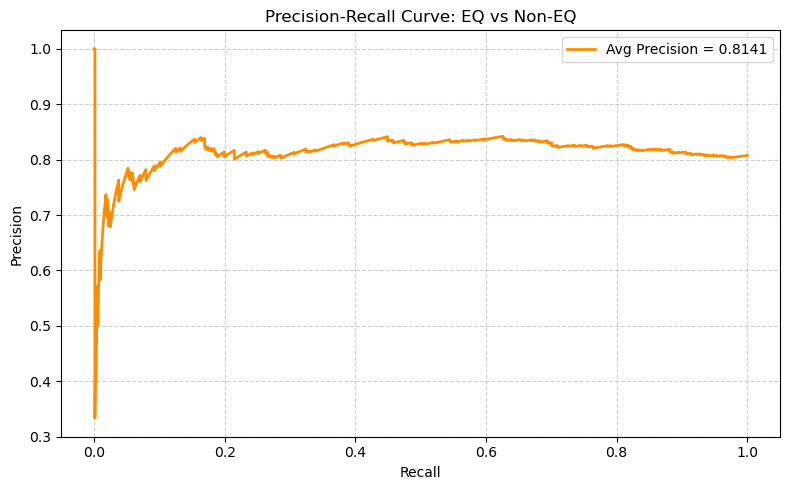

In [1672]:
from sklearn.metrics import precision_recall_curve, average_precision_score

# Load EQ and Non-EQ reconstruction errors
eq_errors = np.load("eq_errors_threshold_1.000.npy")
non_eq_errors = np.load("non_eq_errors_threshold_1.000.npy")

# Combine errors and create true labels
all_errors = np.concatenate([non_eq_errors, eq_errors])
labels = np.concatenate([np.zeros_like(non_eq_errors), np.ones_like(eq_errors)])

# Compute precision-recall values
precision, recall, thresholds = precision_recall_curve(labels, all_errors)
avg_precision = average_precision_score(labels, all_errors)

# Plot PR Curve
plt.figure(figsize=(8, 5))
plt.plot(recall, precision, color='darkorange', lw=2, label=f"Avg Precision = {avg_precision:.4f}")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-Recall Curve: EQ vs Non-EQ")
plt.legend(loc="best")
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()